<a href="https://colab.research.google.com/github/amiramomen/numerical-optimization/blob/master/Lab_4_Trainees_Adagrad_RMSProp_Adam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Practical Work 4

For this practical work, the student will have to develop a Python program that is able to implement the accelerated gradient descent methods with adaptive learning rate <b>(Adagrad, RMSProp, and Adam)</b> in order to achieve the linear regression of a set of datapoints.
##### Please notice that we will apply these algorithm to single variable LR.

#### Import numpy, matplotlib.pyplot and make it inline

In [ ]:
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline

To have a dataset or set of data points, the student must generate a pair of arrays <b>X</b> and <b>y</b> with the values in <b>X</b> equally distributed between <b>0</b> and <b>20</b> and the values in <b>y</b> such that: 
<b>yi = a*xi + b (and a = -1, b = 2)</b>


In [ ]:
x = np.array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])
x

array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])

In [ ]:
a=-1
b=2
y=a*x+b
y

array([  2.        ,   1.59183673,   1.18367347,   0.7755102 ,
         0.36734694,  -0.04081633,  -0.44897959,  -0.85714286,
        -1.26530612,  -1.67346939,  -2.08163265,  -2.48979592,
        -2.89795918,  -3.30612245,  -3.71428571,  -4.12244898,
        -4.53061224,  -4.93877551,  -5.34693878,  -5.75510204,
        -6.16326531,  -6.57142857,  -6.97959184,  -7.3877551 ,
        -7.79591837,  -8.20408163,  -8.6122449 ,  -9.02040816,
        -9.42857143,  -9.83673469, -10.24489796, -10.65306122,
       -11.06122449, -11.46938776, -11.87755102, -12.28571429,
       -12.69387755, -13.10204082, -13.51020408, -13.91836735,
       -14.32653061, -14.73469388, -15.14285714, -15.55102041,
       -15.95918367, -16.36734694, -16.7755102 , -17.18367347,
       -17.59183673, -18.        ])

#### Plot X vs. y

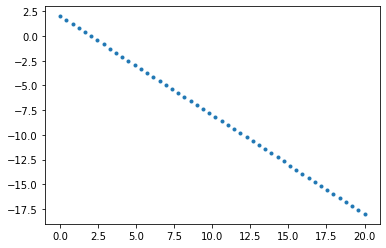

In [ ]:
plt.plot(x,y,'.')

## Adagrad

### For a single variable linear regression ML model, build a function to find the optimum Theta_0 and Theta_1 parameters using Adagrad optimization algorithm.
#### The funtion should have the following input parameters:
##### 1. Input data as a matrix (or vector based on your data).
##### 2. Target label as a vector.
##### 3. Learning rate.
##### 4. Epsilon.
##### 5. Maximum number of iterations (Epochs).
#### The funtion should return the following outputs:
##### 1. All predicted Theta_0 in all iterations.
##### 2. All predicted Theta_1 in all iterations.
##### 3. Corresponding loss for each Theta_0 and Theta_1 predictions.
##### 4.All hypothesis outputs (prdicted labels) for each Theta_0 and Theta_1 predictions.
##### 5.Final Optimum values of Theta_0 and Theta_1.
#### Choose the suitable number of iterations, learning rate, Epsilon, and stop criteria.
#### Calculate r2 score. Shouldn't below 0.9
#### Plot the required curves (loss-epochs, loss-theta0, loss-theta1, all fitted lines per epoch (single graph), best fit line)
#### Try different values of the huperparameters and see the differnce in your results.

In [ ]:
m=len(x)
def Adagrad (x,y,lr,E,it):
    theta_0s=[0]
    theta_1s=[0]
    vt0=0.0
    vt1=0.0
    th0=0
    th1=0
    costs=[]
    h_yhat=[]
    
    for i in range (it):
        print(f'****************** Iteration {i} ********************\n')
    

        h_yhat.append(theta_0s[i] + theta_1s[i]*x) # calculate y predict (y hat)
        print (f'h(x):{h_yhat[i]}\n')

        errs=( h_yhat[i]-y) # sub y pre from y orginal
        print(f'Error Vector:{errs}\n') 
        
        costs.append(errs@errs/(m*2)) # j or loss or cost with MSE 
        print(f'j(mse):{costs[i]}\n')
        
        theta_0drv = (errs.sum())/m #j/theta0
        theta_1drv= ((errs*x).sum())/m # j/th1
        gradient_vec = np.array([[theta_0drv],[theta_1drv]])
        print(f'Gradient Vector:{gradient_vec}\n')

        gradient_vector_norm=np.linalg.norm(gradient_vec,2)
        print(f'Gradient Vector Norm:{gradient_vector_norm}\n') 
        
       
        
        if (gradient_vector_norm<.001  ):
            print('norm')
            break


        if i!=0 and abs(costs[i]-costs[i-1])< 0.001 :
            print('cost')
            break
            
        
        
        vt0 = vt0 + (theta_0drv)**2  
        vt1 = vt1 + (theta_1drv)**2  
        th0=th0 -((lr/(np.sqrt(vt0)+E))*theta_0drv)
        th1=th1 -((lr/(np.sqrt(vt1)+E))*theta_1drv)
            
        print(f'Vt0:{vt0}\nVt1: {vt1}')
        print(f'theta_0_new :{th0} \ntheta_1_new :{th1}')    
            
            
        if i!= (it-1) :

            theta_0s.append(th0) #update eq with nag
            theta_1s.append(th1)        
       
            
    if i != it-1:        #do not print if iter finshed
        print(f'\n\nGradient Descent converged after {i+1} epochs\n')
        print ((f'theta_0_Opt :{theta_0s[-1]} \ntheta_1_Opt:{theta_1s[-1]}\n'))
        print(f'Error Vector:{errs}\n')
        print(f'Cost :{costs[-1]}\n')
        print(f'h(x) = y_predict:{h_yhat[-1]}')
        print(f'y_actual:{y}')
    
    return theta_0s,theta_1s ,costs,h_yhat,lr


def plot(theta_0s,theta_1s ,costs,h_yhat,lr):
    plt.plot(costs,'.m-')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(theta_0s,costs,'.m-')
    plt.title(f'Learning Rate = {lr} ')
    plt.xlabel('theta0')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(theta_1s,costs,'.m-')
    plt.title(f'Learning Rate = {lr} ')
    plt.xlabel('theta1')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(x,y,'.b')
    for i in range( len(h_yhat)):
        plt.plot(x,h_yhat[i],'r')
    plt.title('regression lines till converge')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()
    
    plt.plot(x,y,'.b')
    plt.plot(x,h_yhat[-1],'r')
    plt.title('best lines till converge')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()

##### The following results uses alpha = 0.05, epsilon =  1e-08, and max. iterations = 500.

In [ ]:
theta_0s1,theta_1s1,costs1,h_yhat1,lr1= Adagrad(x,y,0.05,1e-08,300)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

Vt0:64.00000000000003
Vt1: 13154.685546639828
th


Error Vector:[-2.4681755  -2.25644097 -2.04470643 -1.8329719  -1.62123737 -1.40950283
 -1.1977683  -0.98603376 -0.77429923 -0.56256469 -0.35083016 -0.13909562
  0.07263891  0.28437345  0.49610798  0.70784252  0.91957705  1.13131159
  1.34304612  1.55478066  1.76651519  1.97824972  2.18998426  2.40171879
  2.61345333  2.82518786  3.0369224   3.24865693  3.46039147  3.672126
  3.88386054  4.09559507  4.30732961  4.51906414  4.73079868  4.94253321
  5.15426775  5.36600228  5.57773681  5.78947135  6.00120588  6.21294042
  6.42467495  6.63640949  6.84814402  7.05987856  7.27161309  7.48334763
  7.69508216  7.9068167 ]

j(mse):8.365433563987967

Gradient Vector:[[ 2.7193206 ]
 [45.19064141]]

Gradient Vector Norm:45.27238425320731

Vt0:945.8692506637449
Vt1: 215426.59131987736
theta_0_new :-0.4725964463496829 
theta_1_new :-0.4861185949149223
****************** Iteration 43 ********************

h(x):[ -0.47259645  -0.6710122   -0.86942795  -1.06784371  -1.26625946
  -1.46467521  -1.6630909


Error Vector:[-2.60425331 -2.45988079 -2.31550828 -2.17113576 -2.02676325 -1.88239073
 -1.73801822 -1.5936457  -1.44927319 -1.30490067 -1.16052816 -1.01615564
 -0.87178313 -0.72741061 -0.5830381  -0.43866558 -0.29429307 -0.14992055
 -0.00554803  0.13882448  0.283197    0.42756951  0.57194203  0.71631454
  0.86068706  1.00505957  1.14943209  1.2938046   1.43817712  1.58254963
  1.72692215  1.87129467  2.01566718  2.1600397   2.30441221  2.44878473
  2.59315724  2.73752976  2.88190227  3.02627479  3.1706473   3.31501982
  3.45939233  3.60376485  3.74813737  3.89250988  4.0368824   4.18125491
  4.32562743  4.46999994]

j(mse):2.6054477523627737

Gradient Vector:[[ 0.93287332]
 [21.60039697]]

Gradient Vector Norm:21.620531953884154

Vt0:1102.9560443035093
Vt1: 268253.4911731321
theta_0_new :-0.6056577834843683 
theta_1_new :-0.6483725917366953
****************** Iteration 94 ********************

h(x):[ -0.60565778  -0.87029966  -1.13494153  -1.39958341  -1.66422528
  -1.92886716  -2.193


j(mse):1.353968816955341

Gradient Vector:[[ 0.14184675]
 [11.07511283]]

Gradient Vector Norm:11.076021162651225

Vt0:1117.0837554694424
Vt1: 280874.8628078016
theta_0_new :-0.6417514459514795 
theta_1_new :-0.7227062688415143
****************** Iteration 144 ********************

h(x):[ -0.64175145  -0.9367336   -1.23171575  -1.5266979   -1.82168005
  -2.1166622   -2.41164435  -2.7066265   -3.00160865  -3.2965908
  -3.59157295  -3.8865551   -4.18153725  -4.4765194   -4.77150155
  -5.0664837   -5.36146585  -5.65644801  -5.95143016  -6.24641231
  -6.54139446  -6.83637661  -7.13135876  -7.42634091  -7.72132306
  -8.01630521  -8.31128736  -8.60626951  -8.90125166  -9.19623381
  -9.49121596  -9.78619811 -10.08118026 -10.37616242 -10.67114456
 -10.96612672 -11.26110886 -11.55609102 -11.85107317 -12.14605532
 -12.44103747 -12.73601962 -13.03100177 -13.32598392 -13.62096607
 -13.91594822 -14.21093037 -14.50591252 -14.80089467 -15.09587682]

Error Vector:[-2.64175145 -2.52857033 -2.41538922 


Error Vector:[-2.63957438 -2.53936711 -2.43915984 -2.33895257 -2.2387453  -2.13853803
 -2.03833076 -1.93812349 -1.83791622 -1.73770895 -1.63750169 -1.53729441
 -1.43708715 -1.33687988 -1.23667261 -1.13646534 -1.03625807 -0.9360508
 -0.83584353 -0.73563626 -0.63542899 -0.53522172 -0.43501445 -0.33480718
 -0.23459991 -0.13439264 -0.03418537  0.0660219   0.16622917  0.26643644
  0.36664371  0.46685098  0.56705825  0.66726552  0.76747279  0.86768006
  0.96788733  1.0680946   1.16830187  1.26850914  1.36871641  1.46892368
  1.56913095  1.66933822  1.76954549  1.86975276  1.96996002  2.0701673
  2.17037456  2.27058183]

j(mse):1.0625903027364128

Gradient Vector:[[-0.18449627]
 [ 6.67265519]]

Gradient Vector Norm:6.675205325384758

Vt0:1117.4987561331247
Vt1: 283906.5250176851
theta_0_new :-0.6392984297311148 
theta_1_new :-0.7551183429387601
****************** Iteration 184 ********************

h(x):[ -0.63929843  -0.94751     -1.25572157  -1.56393314  -1.8721447
  -2.18035628  -2.488567


j(mse):0.9535386959000831

Gradient Vector:[[-0.36054145]
 [ 4.2465946 ]]

Gradient Vector Norm:4.261872338745645

Vt0:1120.6364412398923
Vt1: 285001.02670897526
theta_0_new :-0.6232291086576521 
theta_1_new :-0.7740751129452558
****************** Iteration 222 ********************

h(x):[ -0.62322911  -0.93917814  -1.25512716  -1.57107619  -1.88702521
  -2.20297424  -2.51892326  -2.83487229  -3.15082131  -3.46677034
  -3.78271936  -4.09866839  -4.41461741  -4.73056644  -5.04651547
  -5.36246449  -5.67841352  -5.99436255  -6.31031157  -6.6262606
  -6.94220963  -7.25815865  -7.57410768  -7.8900567   -8.20600573
  -8.52195475  -8.83790378  -9.1538528   -9.46980183  -9.78575085
 -10.10169988 -10.4176489  -10.73359793 -11.04954696 -11.36549598
 -11.68144501 -11.99739403 -12.31334306 -12.62929208 -12.94524111
 -13.26119013 -13.57713916 -13.89308819 -14.20903721 -14.52498624
 -14.84093527 -15.15688429 -15.47283332 -15.78878234 -16.10473137]

Error Vector:[-2.62322911 -2.53101487 -2.43880063


Gradient Vector:[[-0.45708468]
 [ 2.86949791]]

Gradient Vector Norm:2.9056745644663944

Vt0:1126.8479731976495
Vt1: 285443.1706378643
theta_0_new :-0.6009738207651305 
theta_1_new :-0.78581154848212
****************** Iteration 258 ********************

h(x):[ -0.60097382  -0.92171323  -1.24245264  -1.56319205  -1.88393145
  -2.20467086  -2.52541026  -2.84614968  -3.16688908  -3.48762849
  -3.80836789  -4.12910731  -4.44984671  -4.77058612  -5.09132552
  -5.41206493  -5.73280434  -6.05354375  -6.37428316  -6.69502256
  -7.01576197  -7.33650138  -7.65724079  -7.97798019  -8.2987196
  -8.61945901  -8.94019842  -9.26093782  -9.58167723  -9.90241664
 -10.22315605 -10.54389545 -10.86463486 -11.18537427 -11.50611368
 -11.82685309 -12.14759249 -12.4683319  -12.78907131 -13.10981072
 -13.43055012 -13.75128953 -14.07202894 -14.39276835 -14.71350775
 -15.03424716 -15.35498656 -15.67572598 -15.99646538 -16.31720479]

Error Vector:[-2.60097382 -2.51354996 -2.42612611 -2.33870225 -2.25127839 -2.1

In [ ]:
len(theta_0s1),len(costs1)

(266, 266)

In [ ]:
from sklearn.metrics import r2_score

In [ ]:
r2_score(y,h_yhat1[-1])

0.9484638125769862

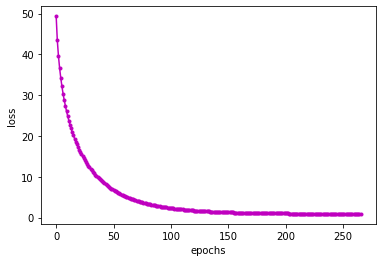

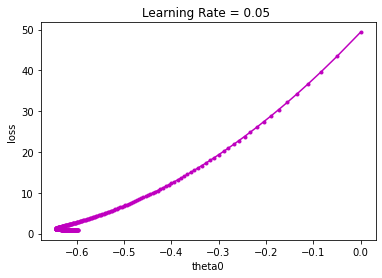

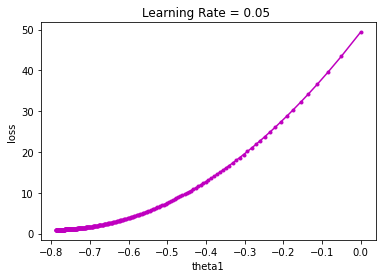

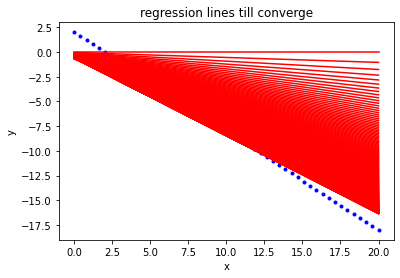

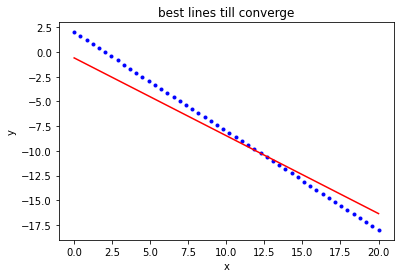

In [ ]:
r2_score(y,h_yhat1[-1])
plot(theta_0s1,theta_1s1,costs1,h_yhat1,lr1)

##### The following results uses alpha = 0.005, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s2,theta_1s2,costs2,h_yhat2,lr2= Adagrad(x,y,0.005,1e-08,5000)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

Vt0:64.00000000000003
Vt1: 13154.685546639828
th


Error Vector:[-2.05773425 -1.67316802 -1.28860179 -0.90403556 -0.51946933 -0.1349031
  0.24966313  0.63422936  1.01879559  1.40336182  1.78792804  2.17249428
  2.5570605   2.94162674  3.32619296  3.7107592   4.09532542  4.47989166
  4.86445789  5.24902411  5.63359035  6.01815657  6.40272281  6.78728903
  7.17185527  7.55642149  7.94098772  8.32555395  8.71012018  9.09468641
  9.47925264  9.86381887 10.2483851  10.63295134 11.01751756 11.40208379
 11.78665002 12.17121625 12.55578248 12.94034871 13.32491494 13.70948117
 14.0940474  14.47861363 14.86317985 15.24774609 15.63231231 16.01687855
 16.40144477 16.78601101]

j(mse):42.51443666764391

Gradient Vector:[[  7.36413838]
 [106.32951331]]

Gradient Vector Norm:106.58421990979751

Vt0:2541.359384067945
Vt1: 526881.8217759834
theta_0_new :-0.058464646045469415 
theta_1_new :-0.05854516908521929
****************** Iteration 44 ********************

h(x):[-0.05846465 -0.08236063 -0.10625662 -0.13015261 -0.1540486  -0.17794458
 -0.20184057


j(mse):38.946119083909046

Gradient Vector:[[  7.01117674]
 [101.68629412]]

Gradient Vector Norm:101.92771463391124

Vt0:5371.079224037096
Vt1: 1119612.7954136638
theta_0_new :-0.09019457363012019 
theta_1_new :-0.09039120717434068
****************** Iteration 99 ********************

h(x):[-0.09019457 -0.12708894 -0.16398331 -0.20087768 -0.23777205 -0.27466643
 -0.3115608  -0.34845517 -0.38534954 -0.42224391 -0.45913828 -0.49603265
 -0.53292702 -0.56982139 -0.60671576 -0.64361013 -0.6805045  -0.71739887
 -0.75429324 -0.79118761 -0.82808198 -0.86497635 -0.90187072 -0.93876509
 -0.97565946 -1.01255383 -1.0494482  -1.08634257 -1.12323694 -1.16013131
 -1.19702568 -1.23392005 -1.27081442 -1.30770879 -1.34460316 -1.38149753
 -1.4183919  -1.45528627 -1.49218064 -1.52907501 -1.56596938 -1.60286376
 -1.63975812 -1.6766525  -1.71354687 -1.75044124 -1.78733561 -1.82422998
 -1.86112435 -1.89801872]

Error Vector:[-2.09019457 -1.71892567 -1.34765678 -0.97638788 -0.60511899 -0.2338501
  0.1374187

h(x):[-0.11033437 -0.15549161 -0.20064885 -0.24580608 -0.29096332 -0.33612056
 -0.3812778  -0.42643504 -0.47159228 -0.51674952 -0.56190675 -0.60706399
 -0.65222123 -0.69737847 -0.74253571 -0.78769295 -0.83285019 -0.87800743
 -0.92316467 -0.9683219  -1.01347914 -1.05863638 -1.10379362 -1.14895086
 -1.1941081  -1.23926534 -1.28442257 -1.32957981 -1.37473705 -1.41989429
 -1.46505153 -1.51020877 -1.55536601 -1.60052325 -1.64568048 -1.69083772
 -1.73599496 -1.7811522  -1.82630944 -1.87146668 -1.91662392 -1.96178116
 -2.00693839 -2.05209563 -2.09725287 -2.14241011 -2.18756735 -2.23272459
 -2.27788183 -2.32303906]

Error Vector:[-2.11033437 -1.74732834 -1.38432232 -1.02131628 -0.65831026 -0.29530423
  0.06770179  0.43070782  0.79371384  1.15671987  1.5197259   1.88273193
  2.24573795  2.60874398  2.97175     3.33475603  3.69776205  4.06076808
  4.42377411  4.78678014  5.14978617  5.51279219  5.87579822  6.23880424
  6.60181027  6.96481629  7.32782233  7.69082835  8.05383438  8.4168404
  8.779

Gradient Vector Norm:96.50336395123472

Vt0:9707.888129234247
Vt1: 2037308.310024979
theta_0_new :-0.12723542342109517 
theta_1_new :-0.12764421183028934
****************** Iteration 193 ********************

h(x):[-0.12723542 -0.1793351  -0.23143478 -0.28353446 -0.33563414 -0.38773382
 -0.43983349 -0.49193317 -0.54403285 -0.59613253 -0.64823221 -0.70033188
 -0.75243156 -0.80453124 -0.85663092 -0.9087306  -0.96083028 -1.01292995
 -1.06502963 -1.11712931 -1.16922899 -1.22132867 -1.27342835 -1.32552802
 -1.3776277  -1.42972738 -1.48182706 -1.53392674 -1.58602642 -1.63812609
 -1.69022577 -1.74232545 -1.79442513 -1.84652481 -1.89862449 -1.95072416
 -2.00282384 -2.05492352 -2.1070232  -2.15912288 -2.21122256 -2.26332223
 -2.31542191 -2.36752159 -2.41962127 -2.47172095 -2.52382062 -2.5759203
 -2.62801998 -2.68011966]

Error Vector:[-2.12723542e+00 -1.77117183e+00 -1.41510825e+00 -1.05904466e+00
 -7.02981076e-01 -3.46917485e-01  9.14609702e-03  3.65209688e-01
  7.21273271e-01  1.07733686e+00 


Error Vector:[-2.13932818 -1.788237   -1.43714583 -1.08605465 -0.73496348 -0.3838723
 -0.03278113  0.31831005  0.66940123  1.02049241  1.37158358  1.72267476
  2.07376593  2.42485711  2.77594828  3.12703946  3.47813063  3.82922181
  4.18031299  4.53140416  4.88249534  5.23358651  5.58467769  5.93576886
  6.28686004  6.63795121  6.98904239  7.34013356  7.69122474  8.04231592
  8.3934071   8.74449827  9.09558945  9.44668063  9.7977718  10.14886298
 10.49995415 10.85104533 11.2021365  11.55322768 11.90431885 12.25541003
 12.6065012  12.95759238 13.30868355 13.65977473 14.0108659  14.36195708
 14.71304826 15.06413943]

j(mse):33.716312802740845

Gradient Vector:[[ 6.46240563]
 [94.46680622]]

Gradient Vector Norm:94.6875924490705

Vt0:11370.085819017939
Vt1: 2391772.4981112806
theta_0_new :-0.13963120627142764 
theta_1_new :-0.14013203358221288
****************** Iteration 232 ********************

h(x):[-0.13963121 -0.19682796 -0.2540247  -0.31122145 -0.3684182  -0.42561495
 -0.4828117  

j(mse):32.68610007911607

Gradient Vector:[[ 6.34925241]
 [92.97812411]]

Gradient Vector Norm:93.19465955682726

Vt0:12805.28778771083
Vt1: 2699013.7706453362
theta_0_new :-0.14981871523243057 
theta_1_new :-0.15040391652637536
****************** Iteration 267 ********************

h(x):[-0.14981872 -0.21120807 -0.27259742 -0.33398678 -0.39537613 -0.45676548
 -0.51815484 -0.57954419 -0.64093354 -0.7023229  -0.76371225 -0.82510161
 -0.88649096 -0.94788031 -1.00926967 -1.07065902 -1.13204837 -1.19343773
 -1.25482708 -1.31621644 -1.37760579 -1.43899514 -1.5003845  -1.56177385
 -1.6231632  -1.68455256 -1.74594191 -1.80733126 -1.86872062 -1.93010997
 -1.99149933 -2.05288868 -2.11427803 -2.17566739 -2.23705674 -2.29844609
 -2.35983545 -2.4212248  -2.48261415 -2.54400351 -2.60539286 -2.66678222
 -2.72817157 -2.78956092 -2.85095028 -2.91233963 -2.97372898 -3.03511834
 -3.09650769 -3.15789705]

Error Vector:[-2.14981872 -1.8030448  -1.45627089 -1.10949698 -0.76272307 -0.41594915
 -0.06917525  


j(mse):31.639040348136827

Gradient Vector:[[ 6.23235029]
 [91.44009257]]

Gradient Vector Norm:91.65223794028395

Vt0:14347.63280729051
Vt1: 3030409.061355078
theta_0_new :-0.1603386721498631 
theta_1_new :-0.161019756817833
****************** Iteration 306 ********************

h(x):[-0.16033867 -0.22606102 -0.29178337 -0.35750572 -0.42322807 -0.48895042
 -0.55467277 -0.62039512 -0.68611747 -0.75183982 -0.81756217 -0.88328452
 -0.94900687 -1.01472922 -1.08045157 -1.14617392 -1.21189627 -1.27761862
 -1.34334097 -1.40906332 -1.47478567 -1.54050802 -1.60623037 -1.67195272
 -1.73767507 -1.80339741 -1.86911977 -1.93484211 -2.00056446 -2.06628681
 -2.13200916 -2.19773151 -2.26345386 -2.32917621 -2.39489856 -2.46062091
 -2.52634326 -2.59206561 -2.65778796 -2.72351031 -2.78923266 -2.85495501
 -2.92067736 -2.98639971 -3.05212206 -3.11784441 -3.18356676 -3.24928911
 -3.31501146 -3.38073381]

Error Vector:[-2.16033867 -1.81789775 -1.47545684 -1.13301592 -0.79057501 -0.44813409
 -0.10569318  0.


j(mse):30.79775545368523

Gradient Vector:[[ 6.1369696]
 [90.1851877]]

Gradient Vector Norm:90.3937524158521

Vt0:15647.375042679
Vt1: 3310657.8503493834
theta_0_new :-0.16891744452238008 
theta_1_new :-0.1696836529583633
****************** Iteration 340 ********************

h(x):[-0.16891744 -0.23817608 -0.30743471 -0.37669335 -0.44595198 -0.51521061
 -0.58446925 -0.65372788 -0.72298651 -0.79224515 -0.86150378 -0.93076242
 -1.00002105 -1.06927968 -1.13853832 -1.20779695 -1.27705559 -1.34631422
 -1.41557285 -1.48483149 -1.55409012 -1.62334876 -1.69260739 -1.76186602
 -1.83112466 -1.90038329 -1.96964193 -2.03890056 -2.10815919 -2.17741783
 -2.24667646 -2.31593509 -2.38519373 -2.45445236 -2.523711   -2.59296963
 -2.66222826 -2.7314869  -2.80074553 -2.87000417 -2.9392628  -3.00852143
 -3.07778007 -3.1470387  -3.21629733 -3.28555597 -3.3548146  -3.42407324
 -3.49333187 -3.5625905 ]

Error Vector:[-2.16891744 -1.83001281 -1.49110818 -1.15220355 -0.81329892 -0.47439428
 -0.13548966  0.203


j(mse):30.035034528953574

Gradient Vector:[[ 6.04932729]
 [89.03207724]]

Gradient Vector Norm:89.23735282053956

Vt0:16871.884262449064
Vt1: 3575509.3002966265
theta_0_new :-0.17679621487928163 
theta_1_new :-0.17764635731603093
****************** Iteration 373 ********************

h(x):[-0.17679621 -0.24930493 -0.32181365 -0.39432237 -0.46683108 -0.5393398
 -0.61184852 -0.68435724 -0.75686595 -0.82937467 -0.90188339 -0.97439211
 -1.04690082 -1.11940954 -1.19191826 -1.26442697 -1.33693569 -1.40944441
 -1.48195313 -1.55446184 -1.62697056 -1.69947928 -1.771988   -1.84449671
 -1.91700543 -1.98951415 -2.06202286 -2.13453158 -2.2070403  -2.27954902
 -2.35205773 -2.42456645 -2.49707517 -2.56958389 -2.6420926  -2.71460132
 -2.78711004 -2.85961875 -2.93212747 -3.00463619 -3.07714491 -3.14965362
 -3.22216234 -3.29467106 -3.36717977 -3.43968849 -3.51219721 -3.58470593
 -3.65721464 -3.72972336]

Error Vector:[-2.17679621 -1.84114166 -1.50548712 -1.16983257 -0.83417802 -0.49852347
 -0.16286893


j(mse):29.23419831617886

Gradient Vector:[[ 5.9560592 ]
 [87.80492834]]

Gradient Vector Norm:88.00670475096814

Vt0:18204.364890640456
Vt1: 3864629.871469292
theta_0_new :-0.18517612422701935 
theta_1_new :-0.1861218636461593
****************** Iteration 410 ********************

h(x):[-0.18517612 -0.26114423 -0.33711234 -0.41308045 -0.48904855 -0.56501666
 -0.64098477 -0.71695288 -0.79292098 -0.86888909 -0.9448572  -1.02082531
 -1.09679341 -1.17276152 -1.24872963 -1.32469774 -1.40066585 -1.47663395
 -1.55260206 -1.62857017 -1.70453828 -1.78050638 -1.85647449 -1.9324426
 -2.00841071 -2.08437881 -2.16034692 -2.23631503 -2.31228314 -2.38825124
 -2.46421935 -2.54018746 -2.61615557 -2.69212368 -2.76809178 -2.84405989
 -2.920028   -2.99599611 -3.07196421 -3.14793232 -3.22390043 -3.29986854
 -3.37583664 -3.45180475 -3.52777286 -3.60374097 -3.67970907 -3.75567718
 -3.83164529 -3.9076134 ]

Error Vector:[-2.18517612 -1.85298096 -1.52078581 -1.18859065 -0.85639549 -0.52420033
 -0.19200518  0


Error Vector:[-2.19313687 -1.86423063 -1.5353244  -1.20641816 -0.87751194 -0.5486057
 -0.21969947  0.10920676  0.43811299  0.76701923  1.09592546  1.42483169
  1.75373792  2.08264416  2.41155039  2.74045662  3.06936285  3.39826909
  3.72717532  4.05608155  4.38498779  4.71389402  5.04280025  5.37170648
  5.70061272  6.02951895  6.35842518  6.68733141  7.01623765  7.34514388
  7.67405011  8.00295634  8.33186258  8.66076881  8.98967504  9.31858128
  9.64748751  9.97639374 10.30529997 10.63420621 10.96311244 11.29201867
 11.6209249  11.94983114 12.27873737 12.6076436  12.93654983 13.26545607
 13.59436229 13.92326853]

j(mse):28.463669244784597

Gradient Vector:[[ 5.86506583]
 [86.60768809]]

Gradient Vector Norm:86.80605182652404

Vt0:19531.203983444706
Vt1: 4153484.783168783
theta_0_new :-0.1933467011367394 
theta_1_new :-0.19439221117785582
****************** Iteration 448 ********************

h(x):[-0.1933467  -0.27269046 -0.35203422 -0.43137798 -0.51072174 -0.5900655
 -0.66940926 -0


Gradient Vector Norm:85.31083968163412

Vt0:21217.15080083919
Vt1: 4521917.999448577
theta_0_new :-0.203514195700245 
theta_1_new :-0.20469336324268436
****************** Iteration 498 ********************

h(x):[-0.2035142  -0.28706251 -0.37061082 -0.45415913 -0.53770744 -0.62125575
 -0.70480406 -0.78835238 -0.87190069 -0.955449   -1.03899731 -1.12254562
 -1.20609393 -1.28964225 -1.37319056 -1.45673887 -1.54028718 -1.62383549
 -1.7073838  -1.79093211 -1.87448043 -1.95802874 -2.04157705 -2.12512536
 -2.20867367 -2.29222198 -2.3757703  -2.45931861 -2.54286692 -2.62641523
 -2.70996354 -2.79351185 -2.87706016 -2.96060848 -3.04415679 -3.1277051
 -3.21125341 -3.29480172 -3.37835003 -3.46189835 -3.54544666 -3.62899497
 -3.71254328 -3.79609159 -3.8796399  -3.96318821 -4.04673653 -4.13028484
 -4.21383315 -4.29738146]

Error Vector:[-2.2035142  -1.87889924 -1.55428429 -1.22966933 -0.90505438 -0.58043942
 -0.25582447  0.06879048  0.39340543  0.71802039  1.04263534  1.3672503
  1.69186525  2.016


Error Vector:[-2.21198377 -1.89087468 -1.5697656  -1.24865651 -0.92754742 -0.60643833
 -0.28532925  0.03577984  0.35688893  0.67799802  0.9991071   1.32021619
  1.64132527  1.96243437  2.28354345  2.60465254  2.92576162  3.24687072
  3.56797981  3.88908889  4.21019798  4.53130707  4.85241616  5.17352524
  5.49463433  5.81574342  6.13685251  6.45796159  6.77907068  7.10017977
  7.42128886  7.74239794  8.06350703  8.38461612  8.70572521  9.0268343
  9.34794338  9.66905247  9.99016156 10.31127065 10.63237973 10.95348882
 11.27459791 11.595707   11.91681608 12.23792517 12.55903426 12.88014335
 13.20125243 13.52236152]

j(mse):26.727018283942094

Gradient Vector:[[ 5.65518887]
 [83.84616119]]

Gradient Vector Norm:84.03665811667237

Vt0:22680.261500157678
Vt1: 4842947.080394305
theta_0_new :-0.21217153027893823 
theta_1_new :-0.21347323661706083
****************** Iteration 543 ********************

h(x):[-0.21217153 -0.29930346 -0.3864354  -0.47356733 -0.56069926 -0.6478312
 -0.73496313 -

theta_1_new :-0.2209344266872351
****************** Iteration 583 ********************

h(x):[-0.21952206 -0.30969937 -0.39987669 -0.49005401 -0.58023132 -0.67040864
 -0.76058596 -0.85076328 -0.94094059 -1.03111791 -1.12129523 -1.21147254
 -1.30164986 -1.39182718 -1.48200449 -1.57218181 -1.66235913 -1.75253644
 -1.84271376 -1.93289108 -2.0230684  -2.11324571 -2.20342303 -2.29360035
 -2.38377766 -2.47395498 -2.5641323  -2.65430961 -2.74448693 -2.83466425
 -2.92484157 -3.01501888 -3.1051962  -3.19537352 -3.28555083 -3.37572815
 -3.46590547 -3.55608279 -3.6462601  -3.73643742 -3.82661474 -3.91679205
 -4.00696937 -4.09714669 -4.187324   -4.27750132 -4.36767864 -4.45785596
 -4.54803327 -4.63821059]

Error Vector:[-2.21952206e+00 -1.90153610e+00 -1.58355016e+00 -1.26556421e+00
 -9.47578263e-01 -6.29592312e-01 -3.11606367e-01  6.37958457e-03
  3.24365529e-01  6.42351481e-01  9.60337425e-01  1.27832338e+00
  1.59630932e+00  1.91429527e+00  2.23228122e+00  2.55026717e+00
  2.86825311e+00  3.186


Error Vector:[-2.22778939 -1.91323177 -1.59867416 -1.28411654 -0.96955892 -0.6550013
 -0.34044369 -0.02588607  0.28867154  0.60322916  0.91778677  1.2323444
  1.54690201  1.86145963  2.17601724  2.49057486  2.80513247  3.11969009
  3.43424771  3.74880533  4.06336295  4.37792056  4.69247818  5.00703579
  5.32159341  5.63615103  5.95070865  6.26526626  6.57982388  6.89438149
  7.20893911  7.52349672  7.83805434  8.15261196  8.46716958  8.7817272
  9.09628481  9.41084243  9.72540004 10.03995766 10.35451528 10.6690729
 10.98363051 11.29818813 11.61274574 11.92730336 12.24186097 12.5564186
 12.87097621 13.18553383]

j(mse):25.311824106540307

Gradient Vector:[[ 5.47887222]
 [81.52611961]]

Gradient Vector Norm:81.71001296696116

Vt0:25405.539952208444
Vt1: 5444206.545573648
theta_0_new :-0.2279612585700517 
theta_1_new :-0.22950854174363614
****************** Iteration 631 ********************

h(x):[-0.22796126 -0.32163822 -0.41531517 -0.50899213 -0.60266908 -0.69634604
 -0.79002299 -0.88


j(mse):24.820449397738685

Gradient Vector:[[ 5.41645979]
 [80.70485058]]

Gradient Vector Norm:80.88640765748407

Vt0:26384.49823548837
Vt1: 5661261.723617339
theta_0_new :-0.2335444915386422 
theta_1_new :-0.23518584010860805
****************** Iteration 664 ********************

h(x):[-0.23354449 -0.32953871 -0.42553293 -0.52152715 -0.61752137 -0.71351559
 -0.80950981 -0.90550404 -1.00149825 -1.09749248 -1.1934867  -1.28948092
 -1.38547514 -1.48146936 -1.57746358 -1.6734578  -1.76945202 -1.86544624
 -1.96144046 -2.05743468 -2.1534289  -2.24942312 -2.34541734 -2.44141156
 -2.53740578 -2.6334     -2.72939422 -2.82538844 -2.92138266 -3.01737688
 -3.11337111 -3.20936532 -3.30535955 -3.40135377 -3.49734799 -3.59334221
 -3.68933643 -3.78533065 -3.88132487 -3.97731909 -4.07331331 -4.16930753
 -4.26530175 -4.36129597 -4.45729019 -4.55328441 -4.64927863 -4.74527285
 -4.84126707 -4.93726129]

Error Vector:[-2.23354449 -1.92137544 -1.6092064  -1.29703735 -0.98486831 -0.67269926
 -0.36053022 -


Error Vector:[-2.24025502 -1.93087326 -1.62149151 -1.31210976 -1.00272801 -0.69334625
 -0.3839645  -0.07458274  0.23479901  0.54418077  0.85356252  1.16294427
  1.47232602  1.78170778  2.09108953  2.40047129  2.70985304  3.0192348
  3.32861655  3.6379983   3.94738006  4.25676181  4.56614357  4.87552532
  5.18490707  5.49428882  5.80367058  6.11305233  6.42243409  6.73181584
  7.0411976   7.35057935  7.6599611   7.96934286  8.27872461  8.58810637
  8.89748812  9.20686988  9.51625163  9.82563338 10.13501513 10.44439689
 10.75377864 11.0631604  11.37254215 11.68192391 11.99130566 12.30068741
 12.61006916 12.91945092]

j(mse):24.222193007757824

Gradient Vector:[[ 5.33959795]
 [79.69342858]]

Gradient Vector Norm:79.8721094274919

Vt0:27598.775603058766
Vt1: 5931303.652211816
theta_0_new :-0.24041572676202877 
theta_1_new :-0.24217831585058497
****************** Iteration 706 ********************

h(x):[-0.24041573 -0.33926402 -0.43811231 -0.5369606  -0.6358089  -0.73465719
 -0.83350548 -

h(x):[-0.24673463 -0.34820984 -0.44968504 -0.55116024 -0.65263545 -0.75411065
 -0.85558585 -0.95706106 -1.05853626 -1.16001146 -1.26148666 -1.36296187
 -1.46443707 -1.56591228 -1.66738748 -1.76886268 -1.87033788 -1.97181309
 -2.07328829 -2.1747635  -2.2762387  -2.3777139  -2.47918911 -2.58066431
 -2.68213951 -2.78361472 -2.88508992 -2.98656512 -3.08804033 -3.18951553
 -3.29099073 -3.39246594 -3.49394114 -3.59541634 -3.69689155 -3.79836675
 -3.89984195 -4.00131716 -4.10279236 -4.20426756 -4.30574277 -4.40721797
 -4.50869317 -4.61016838 -4.71164358 -4.81311878 -4.91459399 -5.01606919
 -5.11754439 -5.2190196 ]

Error Vector:[-2.24673463 -1.94004657 -1.63335851 -1.32667044 -1.01998239 -0.71329432
 -0.40660626 -0.0999182   0.20676986  0.51345793  0.82014599  1.12683405
  1.43352211  1.74021017  2.04689823  2.3535863   2.66027436  2.96696242
  3.27365049  3.58033854  3.88702661  4.19371467  4.50040273  4.80709079
  5.11377886  5.42046691  5.72715498  6.03384304  6.3405311   6.64721916
  6.95


j(mse):23.170368931406248

Gradient Vector:[[ 5.20202802]
 [77.88310199]]

Gradient Vector Norm:78.0566375880672

Vt0:29792.311261630748
Vt1: 6421464.321657307
theta_0_new :-0.2527007061249299 
theta_1_new :-0.2546958687816705
****************** Iteration 785 ********************

h(x):[-0.25270071 -0.3566582  -0.4606157  -0.5645732  -0.6685307  -0.77248819
 -0.87644569 -0.98040319 -1.08436069 -1.18831818 -1.29227568 -1.39623318
 -1.50019067 -1.60414817 -1.70810567 -1.81206317 -1.91602066 -2.01997816
 -2.12393566 -2.22789316 -2.33185066 -2.43580815 -2.53976565 -2.64372315
 -2.74768065 -2.85163814 -2.95559564 -3.05955314 -3.16351064 -3.26746813
 -3.37142563 -3.47538313 -3.57934062 -3.68329812 -3.78725562 -3.89121312
 -3.99517061 -4.09912811 -4.20308561 -4.30704311 -4.4110006  -4.5149581
 -4.6189156  -4.7228731  -4.82683059 -4.93078809 -5.03474559 -5.13870309
 -5.24266058 -5.34661808]

Error Vector:[-2.25270071 -1.94849493 -1.64428917 -1.3400834  -1.03587764 -0.73167186
 -0.4274661  -0.


Error Vector:[-2.2583421  -1.95648544 -1.65462879 -1.35277213 -1.05091548 -0.74905883
 -0.44720218 -0.14534552  0.15651113  0.45836779  0.76022444  1.06208109
  1.36393774  1.6657944   1.96765105  2.26950771  2.57136436  2.87322101
  3.17507767  3.47693432  3.77879098  4.08064763  4.38250428  4.68436093
  4.98621759  5.28807424  5.5899309   5.89178755  6.1936442   6.49550085
  6.79735751  7.09921416  7.40107082  7.70292748  8.00478413  8.30664078
  8.60849743  8.91035409  9.21221074  9.5140674   9.81592405 10.1177807
 10.41963735 10.72149401 11.02335066 11.32520732 11.62706397 11.92892062
 12.23077727 12.53263393]

j(mse):22.68273745305155

Gradient Vector:[[ 5.13714592]
 [77.02927472]]

Gradient Vector Norm:77.20038491952198

Vt0:30834.18691071679
Vt1: 6655367.092678882
theta_0_new :-0.25848837527758495 
theta_1_new :-0.26060049167525456
****************** Iteration 824 ********************

h(x):[-0.25848838 -0.36485592 -0.47122347 -0.57759102 -0.68395857 -0.79032611
 -0.89669366 -1


Error Vector:[-2.2632554  -1.96344624 -1.66363708 -1.36382792 -1.06401877 -0.7642096
 -0.46440045 -0.16459129  0.13521787  0.43502703  0.73483618  1.03464534
  1.3344545   1.63426366  1.93407281  2.23388198  2.53369113  2.83350029
  3.13330945  3.43311861  3.73292777  4.03273692  4.33254609  4.63235524
  4.9321644   5.23197356  5.53178272  5.83159187  6.13140103  6.43121019
  6.73101935  7.0308285   7.33063767  7.63044683  7.93025598  8.23006514
  8.5298743   8.82968346  9.12949261  9.42930178  9.72911093 10.02892009
 10.32872925 10.62853841 10.92834756 11.22815672 11.52796588 11.82777504
 12.1275842  12.42739336]

j(mse):22.27304350873851

Gradient Vector:[[ 5.08206898]
 [76.30446824]]

Gradient Vector Norm:76.47352024593121

Vt0:31721.550351969516
Vt1: 6855150.881080792
theta_0_new :-0.26339806839826624 
theta_1_new :-0.26561327967108145
****************** Iteration 858 ********************

h(x):[-0.26339807 -0.37181165 -0.48022524 -0.58863882 -0.6970524  -0.80546599
 -0.91387957 -


j(mse):21.899739431121933

Gradient Vector:[[ 5.03142156]
 [75.63794374]]

Gradient Vector Norm:75.80510362620394

Vt0:32539.53241896366
Vt1: 7039787.4361984385
theta_0_new :-0.26791011791457847 
theta_1_new :-0.2702233158214125
****************** Iteration 890 ********************

h(x):[-0.26791012 -0.37820535 -0.48850058 -0.59879581 -0.70909104 -0.81938627
 -0.9296815  -1.03997674 -1.15027196 -1.2605672  -1.37086243 -1.48115766
 -1.59145289 -1.70174812 -1.81204335 -1.92233858 -2.03263381 -2.14292904
 -2.25322428 -2.36351951 -2.47381474 -2.58410997 -2.6944052  -2.80470043
 -2.91499566 -3.02529089 -3.13558612 -3.24588135 -3.35617658 -3.46647181
 -3.57676705 -3.68706228 -3.79735751 -3.90765274 -4.01794797 -4.1282432
 -4.23853843 -4.34883366 -4.45912889 -4.56942413 -4.67971936 -4.79001459
 -4.90030982 -5.01060505 -5.12090028 -5.23119551 -5.34149074 -5.45178597
 -5.5620812  -5.67237643]

Error Vector:[-2.26791012 -1.97004208 -1.67217405 -1.37430601 -1.07643798 -0.77856994
 -0.48070191 -


Error Vector:[-2.27395207 -1.97860574 -1.68325942 -1.38791309 -1.09256677 -0.79722044
 -0.50187411 -0.20652778  0.08881854  0.38416487  0.67951119  0.97485752
  1.27020384  1.56555017  1.8608965   2.15624283  2.45158915  2.74693548
  3.04228181  3.33762813  3.63297446  3.92832078  4.22366711  4.51901344
  4.81435977  5.10970609  5.40505242  5.70039874  5.99574507  6.29109139
  6.58643772  6.88178405  7.17713038  7.47247671  7.76782303  8.06316936
  8.35851568  8.65386201  8.94920833  9.24455466  9.53990099  9.83524732
 10.13059364 10.42593997 10.72128629 11.01663262 11.31197894 11.60732527
 11.9026716  12.19801793]

j(mse):21.393652136003833

Gradient Vector:[[ 4.96203293]
 [74.72476703]]

Gradient Vector Norm:74.88933554130915

Vt0:33662.653581557286
Vt1: 7294057.119564618
theta_0_new :-0.27408729625406947 
theta_1_new :-0.2765398407736144
****************** Iteration 935 ********************

h(x):[-0.2740873  -0.3869607  -0.4998341  -0.61270751 -0.72558091 -0.83845432
 -0.95132772 


Error Vector:[-2.28086642 -1.98840889 -1.69595136 -1.40349383 -1.11103631 -0.81857878
 -0.52612126 -0.23366373  0.0587938   0.35125133  0.64370885  0.93616638
  1.22862391  1.52108144  1.81353896  2.10599649  2.39845401  2.69091154
  2.98336907  3.2758266   3.56828413  3.86074165  4.15319918  4.4456567
  4.73811423  5.03057176  5.32302929  5.61548681  5.90794434  6.20040187
  6.4928594   6.78531692  7.07777445  7.37023198  7.6626895   7.95514703
  8.24760456  8.54006209  8.83251961  9.12497714  9.41743467  9.7098922
 10.00234972 10.29480725 10.58726477 10.8797223  11.17217983 11.46463736
 11.75709488 12.04955241]

j(mse):20.83436081489807

Gradient Vector:[[ 4.884343  ]
 [73.70231977]]

Gradient Vector Norm:73.86398814957244

Vt0:34922.5520022981
Vt1: 7580361.804451416
theta_0_new :-0.2809971017393525 
theta_1_new :-0.28361290484228213
****************** Iteration 987 ********************

h(x):[-0.2809971  -0.39675747 -0.51251784 -0.62827821 -0.74403858 -0.85979895
 -0.97555932 -1.09


Gradient Vector Norm:73.02200248681841

Vt0:35958.23026840898
Vt1: 7816585.145214073
theta_0_new :-0.2866658728251895 
theta_1_new :-0.2894216692286696
****************** Iteration 1031 ********************

h(x):[-0.28666587 -0.40479717 -0.52292846 -0.64105975 -0.75919105 -0.87732234
 -0.99545363 -1.11358493 -1.23171622 -1.34984752 -1.46797881 -1.5861101
 -1.70424139 -1.82237269 -1.94050398 -2.05863528 -2.17676657 -2.29489786
 -2.41302916 -2.53116045 -2.64929175 -2.76742304 -2.88555433 -3.00368562
 -3.12181692 -3.23994821 -3.35807951 -3.4762108  -3.59434209 -3.71247339
 -3.83060468 -3.94873597 -4.06686727 -4.18499856 -4.30312985 -4.42126115
 -4.53939244 -4.65752374 -4.77565503 -4.89378632 -5.01191761 -5.13004891
 -5.2481802  -5.3663115  -5.48444279 -5.60257408 -5.72070538 -5.83883667
 -5.95696796 -6.07509926]

Error Vector:[-2.28666587 -1.9966339  -1.70660193 -1.41656995 -1.12653799 -0.83650601
 -0.54647404 -0.25644207  0.0335899   0.32362187  0.61365384  0.90368582
  1.19371779  1.4


Vt0:36967.212100021105
Vt1: 8047497.733050923
theta_0_new :-0.2921821495739356 
theta_1_new :-0.29507961884215217
****************** Iteration 1075 ********************

h(x):[-0.29218215 -0.41262281 -0.53306347 -0.65350413 -0.77394479 -0.89438545
 -1.01482611 -1.13526678 -1.25570743 -1.3761481  -1.49658876 -1.61702942
 -1.73747008 -1.85791074 -1.9783514  -2.09879206 -2.21923272 -2.33967338
 -2.46011404 -2.5805547  -2.70099537 -2.82143602 -2.94187669 -3.06231735
 -3.18275801 -3.30319867 -3.42363933 -3.54407999 -3.66452065 -3.78496131
 -3.90540197 -4.02584263 -4.14628329 -4.26672396 -4.38716462 -4.50760528
 -4.62804594 -4.7484866  -4.86892726 -4.98936792 -5.10980858 -5.23024924
 -5.3506899  -5.47113056 -5.59157122 -5.71201188 -5.83245254 -5.95289321
 -6.07333386 -6.19377453]

Error Vector:[-2.29218215e+00 -2.00445954e+00 -1.71673694e+00 -1.42901433e+00
 -1.14129173e+00 -8.53569124e-01 -5.65846524e-01 -2.78123916e-01
  9.59868513e-03  2.97321293e-01  5.85043894e-01  8.72766502e-01
  1.1


Error Vector:[-2.29622473e+00 -2.01019596e+00 -1.72416721e+00 -1.43813845e+00
 -1.15210969e+00 -8.66080932e-01 -5.80052177e-01 -2.94023415e-01
 -7.99466084e-03  2.78034101e-01  5.64062855e-01  8.50091617e-01
  1.13612037e+00  1.42214913e+00  1.70817789e+00  1.99420665e+00
  2.28023540e+00  2.56626417e+00  2.85229293e+00  3.13832168e+00
  3.42435044e+00  3.71037920e+00  3.99640796e+00  4.28243671e+00
  4.56846548e+00  4.85449423e+00  5.14052299e+00  5.42655175e+00
  5.71258051e+00  5.99860926e+00  6.28463802e+00  6.57066678e+00
  6.85669554e+00  7.14272430e+00  7.42875306e+00  7.71478182e+00
  8.00081057e+00  8.28683933e+00  8.57286809e+00  8.85889685e+00
  9.14492560e+00  9.43095437e+00  9.71698312e+00  1.00030119e+01
  1.02890406e+01  1.05750694e+01  1.08610982e+01  1.11471269e+01
  1.14331557e+01  1.17191844e+01]

j(mse):19.61774261388637

Gradient Vector:[[ 4.71147985]
 [71.42724298]]

Gradient Vector Norm:71.58246350509332

Vt0:37729.242419092676
Vt1: 8222415.997111681
theta_0_new


Error Vector:[-2.30102158 -2.01700433 -1.73298709 -1.44896985 -1.16495261 -0.88093537
 -0.59691813 -0.31290088 -0.02888365  0.2551336   0.53915084  0.82316808
  1.10718532  1.39120256  1.6752198   1.95923705  2.24325428  2.52727153
  2.81128877  3.09530601  3.37932325  3.66334049  3.94735774  4.23137497
  4.51539222  4.79940946  5.0834267   5.36744394  5.65146118  5.93547842
  6.21949567  6.5035129   6.78753015  7.07154739  7.35556463  7.63958188
  7.92359911  8.20761636  8.4916336   8.77565084  9.05966808  9.34368532
  9.62770256  9.91171981 10.19573704 10.47975429 10.76377153 11.04778877
 11.33180601 11.61582325]

j(mse):19.245017026316553

Gradient Vector:[[ 4.65740084]
 [70.71547391]]

Gradient Vector Norm:70.86867878152792

Vt0:38606.72057364771
Vt1: 8424405.133309465
theta_0_new :-0.3011400943993411 
theta_1_new :-0.3042795773940304
****************** Iteration 1149 ********************

h(x):[-0.30114009 -0.42533584 -0.54953159 -0.67372733 -0.79792308 -0.92211882
 -1.04631457 -


Vt0:39294.327610757406
Vt1: 8583123.886572681
theta_0_new :-0.30489758927732546 
theta_1_new :-0.3081431679309191
****************** Iteration 1181 ********************

h(x):[-0.30489759 -0.43067031 -0.55644303 -0.68221576 -0.80798848 -0.9337612
 -1.05953392 -1.18530664 -1.31107936 -1.43685208 -1.5626248  -1.68839753
 -1.81417025 -1.93994297 -2.06571569 -2.19148841 -2.31726113 -2.44303386
 -2.56880658 -2.6945793  -2.82035202 -2.94612474 -3.07189747 -3.19767019
 -3.32344291 -3.44921563 -3.57498835 -3.70076107 -3.82653379 -3.95230651
 -4.07807924 -4.20385196 -4.32962468 -4.4553974  -4.58117012 -4.70694285
 -4.83271557 -4.95848829 -5.08426101 -5.21003373 -5.33580645 -5.46157918
 -5.5873519  -5.71312462 -5.83889734 -5.96467006 -6.09044278 -6.2162155
 -6.34198822 -6.46776095]

Error Vector:[-2.30489759 -2.02250704 -1.7401165  -1.45772596 -1.17533542 -0.89294487
 -0.61055433 -0.32816378 -0.04577324  0.23661731  0.51900785  0.80139839
  1.08378893  1.36617948  1.64857002  1.93096057  2.2133


Vt0:39969.518321745745
Vt1: 8739358.235354971
theta_0_new :-0.308588873629216 
theta_1_new :-0.311941410782597
****************** Iteration 1213 ********************

h(x):[-0.30858887 -0.4359119  -0.56323492 -0.69055795 -0.81788097 -0.945204
 -1.07252702 -1.19985005 -1.32717307 -1.4544961  -1.58181912 -1.70914215
 -1.83646517 -1.9637882  -2.09111122 -2.21843425 -2.34575727 -2.4730803
 -2.60040332 -2.72772634 -2.85504937 -2.98237239 -3.10969542 -3.23701844
 -3.36434147 -3.49166449 -3.61898752 -3.74631054 -3.87363357 -4.00095659
 -4.12827962 -4.25560264 -4.38292567 -4.51024869 -4.63757172 -4.76489474
 -4.89221777 -5.01954079 -5.14686382 -5.27418684 -5.40150987 -5.52883289
 -5.65615591 -5.78347894 -5.91080196 -6.03812499 -6.16544801 -6.29277104
 -6.42009406 -6.54741709]

Error Vector:[-2.30858887 -2.02774863 -1.74690839 -1.46606815 -1.18522791 -0.90438767
 -0.62354743 -0.34270719 -0.06186695  0.21897329  0.49981353  0.78065377
  1.06149401  1.34233425  1.62317449  1.90401473  2.18485497


j(mse):18.34615261924932

Gradient Vector:[[ 4.52467285]
 [68.96849556]]

Gradient Vector Norm:69.1167566110631

Vt0:40755.61975928591
Vt1: 8921743.449828295
theta_0_new :-0.3128897342475262 
theta_1_new :-0.31637039878549056
****************** Iteration 1251 ********************

h(x):[-0.31288973 -0.44202051 -0.57115128 -0.70028206 -0.82941283 -0.95854361
 -1.08767438 -1.21680516 -1.34593593 -1.47506671 -1.60419748 -1.73332826
 -1.86245903 -1.99158981 -2.12072058 -2.24985136 -2.37898213 -2.50811291
 -2.63724369 -2.76637446 -2.89550524 -3.02463601 -3.15376679 -3.28289756
 -3.41202834 -3.54115911 -3.67028989 -3.79942066 -3.92855144 -4.05768221
 -4.18681298 -4.31594376 -4.44507453 -4.57420531 -4.70333608 -4.83246686
 -4.96159763 -5.09072841 -5.21985918 -5.34898996 -5.47812073 -5.60725151
 -5.73638228 -5.86551306 -5.99464383 -6.12377461 -6.25290538 -6.38203616
 -6.51116693 -6.64029771]

Error Vector:[-2.31288973 -2.03385724 -1.75482475 -1.47579226 -1.19675977 -0.91772728
 -0.63869479 -0


Error Vector:[-2.31677496 -2.03937687 -1.7619788  -1.48458071 -1.20718263 -0.92978455
 -0.65238647 -0.37498838 -0.0975903   0.17980778  0.45720586  0.73460394
  1.01200202  1.28940011  1.56679819  1.84419627  2.12159435  2.39899243
  2.67639052  2.9537886   3.23118668  3.50858476  3.78598285  4.06338092
  4.34077901  4.61817709  4.89557517  5.17297325  5.45037134  5.72776941
  6.0051675   6.28256558  6.55996366  6.83736175  7.11475983  7.39215791
  7.66955599  7.94695407  8.22435215  8.50175024  8.77914832  9.0565464
  9.33394448  9.61134257  9.88874064 10.16613873 10.44353681 10.72093489
 10.99833297 11.27573106]

j(mse):18.0452488727815

Gradient Vector:[[ 4.47947805]
 [68.37361744]]

Gradient Vector Norm:68.5201961906511

Vt0:41485.072868750125
Vt1: 9091464.921980858
theta_0_new :-0.3168849228866528 
theta_1_new :-0.32048808064542006
****************** Iteration 1287 ********************

h(x):[-0.31688492 -0.44769639 -0.57850785 -0.70931931 -0.84013077 -0.97094223
 -1.10175369 -1.


h(x):[-0.32102183 -0.45357508 -0.58612832 -0.71868157 -0.85123481 -0.98378806
 -1.1163413  -1.24889455 -1.38144779 -1.51400104 -1.64655428 -1.77910753
 -1.91166077 -2.04421402 -2.17676727 -2.30932051 -2.44187376 -2.574427
 -2.70698025 -2.83953349 -2.97208674 -3.10463998 -3.23719323 -3.36974647
 -3.50229972 -3.63485297 -3.76740621 -3.89995946 -4.0325127  -4.16506595
 -4.29761919 -4.43017244 -4.56272568 -4.69527893 -4.82783217 -4.96038542
 -5.09293867 -5.22549191 -5.35804516 -5.4905984  -5.62315165 -5.75570489
 -5.88825814 -6.02081138 -6.15336463 -6.28591787 -6.41847112 -6.55102437
 -6.68357761 -6.81613086]

Error Vector:[-2.32102183 -2.04541181 -1.76980179 -1.49419177 -1.21858175 -0.94297173
 -0.66736171 -0.39175169 -0.11614167  0.15946835  0.43507837  0.71068839
  0.98629841  1.26190843  1.53751844  1.81312847  2.08873848  2.36434851
  2.63995853  2.91556855  3.19117857  3.46678859  3.74239861  4.01800863
  4.29361865  4.56922866  4.84483869  5.1204487   5.39605873  5.67166874
  5.947


Error Vector:[-2.32592417 -2.0523802  -1.77883625 -1.50529229 -1.23174834 -0.95820437
 -0.68466042 -0.41111646 -0.13757251  0.13597146  0.40951541  0.68305937
  0.95660332  1.23014728  1.50369124  1.7772352   2.05077915  2.32432311
  2.59786708  2.87141103  3.14495499  3.41849894  3.69204291  3.96558686
  4.23913082  4.51267477  4.78621873  5.05976269  5.33330665  5.6068506
  5.88039456  6.15393852  6.42748248  6.70102644  6.97457039  7.24811436
  7.52165831  7.79520227  8.06874622  8.34229018  8.61583414  8.8893781
  9.16292205  9.43646601  9.71000997  9.98355393 10.25709788 10.53064184
 10.8041858  11.07772976]

j(mse):17.365550794088467

Gradient Vector:[[ 4.3759028 ]
 [67.01026437]]

Gradient Vector Norm:67.1529899251278

Vt0:43150.79966209726
Vt1: 9480818.783603974
theta_0_new :-0.32602949285804933 
theta_1_new :-0.329926118698473
****************** Iteration 1372 ********************

h(x):[-0.32602949 -0.46069322 -0.59535694 -0.73002066 -0.86468438 -0.9993481
 -1.13401182 -1.26


Error Vector:[-2.33051004 -2.05890081 -1.78729158 -1.51568234 -1.24407312 -0.97246388
 -0.70085465 -0.42924542 -0.15763619  0.11397304  0.38558227  0.65719151
  0.92880073  1.20040997  1.4720192   1.74362843  2.01523766  2.28684689
  2.55845613  2.83006535  3.10167459  3.37328382  3.64489305  3.91650228
  4.18811151  4.45972074  4.73132998  5.0029392   5.27454844  5.54615767
  5.8177669   6.08937613  6.36098536  6.6325946   6.90420383  7.17581306
  7.44742229  7.71903152  7.99064075  8.26224999  8.53385921  8.80546845
  9.07707768  9.34868691  9.62029614  9.89190537 10.1635146  10.43512384
 10.70673306 10.9783423 ]

j(mse):17.029590545890148

Gradient Vector:[[ 4.32391613]
 [66.32594595]]

Gradient Vector Norm:66.46673872660945

Vt0:43983.10469715968
Vt1: 9676332.004819281
theta_0_new :-0.3306131287576703 
theta_1_new :-0.33466399304029304
****************** Iteration 1416 ********************

h(x):[-0.33061313 -0.46721068 -0.60380822 -0.74040577 -0.87700332 -1.01360087
 -1.15019842 

theta_0_new :-0.33459520325318026 
theta_1_new :-0.3387840949090945
****************** Iteration 1455 ********************

h(x):[-0.3345952  -0.47287443 -0.61115365 -0.74943287 -0.88771209 -1.02599132
 -1.16427054 -1.30254976 -1.44082898 -1.57910821 -1.71738743 -1.85566665
 -1.99394587 -2.13222509 -2.27050432 -2.40878354 -2.54706276 -2.68534198
 -2.82362121 -2.96190043 -3.10017965 -3.23845887 -3.3767381  -3.51501732
 -3.65329654 -3.79157576 -3.92985499 -4.06813421 -4.20641343 -4.34469265
 -4.48297188 -4.6212511  -4.75953032 -4.89780954 -5.03608877 -5.17436799
 -5.31264721 -5.45092643 -5.58920565 -5.72748488 -5.8657641  -6.00404332
 -6.14232254 -6.28060177 -6.41888099 -6.55716021 -6.69543943 -6.83371866
 -6.97199788 -7.1102771 ]

Error Vector:[-2.3345952  -2.06471116 -1.79482712 -1.52494307 -1.25505903 -0.98517499
 -0.71529095 -0.4454069  -0.17552286  0.09436118  0.36424522  0.63412927
  0.90401331  1.17389736  1.44378139  1.71366544  1.98354948  2.25343353
  2.52331757  2.79320161  3.


Gradient Vector Norm:65.35829990481365

Vt0:45321.094783990615
Vt1: 9992044.712414194
theta_0_new :-0.33800725673063575 
theta_1_new :-0.3423174838845084
****************** Iteration 1489 ********************

h(x):[-0.33800726 -0.47772868 -0.6174501  -0.75717152 -0.89689294 -1.03661437
 -1.17633579 -1.31605721 -1.45577863 -1.59550006 -1.73522148 -1.8749429
 -2.01466432 -2.15438574 -2.29410716 -2.43382859 -2.57355001 -2.71327143
 -2.85299285 -2.99271427 -3.1324357  -3.27215712 -3.41187854 -3.55159996
 -3.69132139 -3.83104281 -3.97076423 -4.11048565 -4.25020707 -4.38992849
 -4.52964992 -4.66937134 -4.80909276 -4.94881418 -5.0885356  -5.22825703
 -5.36797845 -5.50769987 -5.64742129 -5.78714272 -5.92686414 -6.06658556
 -6.20630698 -6.3460284  -6.48574982 -6.62547125 -6.76519267 -6.90491409
 -7.04463551 -7.18435693]

Error Vector:[-2.33800726 -2.06956541 -1.80112357 -1.53268172 -1.26423988 -0.99579804
 -0.7273562  -0.45891435 -0.19047251  0.07796933  0.34641117  0.61485302
  0.88329486  1


Error Vector:[-2.34156171 -2.07462352 -1.80768533 -1.54074713 -1.27380894 -1.00687075
 -0.73993256 -0.47299436 -0.20605617  0.06088202  0.32782021  0.59475841
  0.8616966   1.12863479  1.39557298  1.66251118  1.92944937  2.19638757
  2.46332576  2.73026395  2.99720215  3.26414034  3.53107853  3.79801672
  4.06495492  4.33189311  4.5988313   4.86576949  5.13270769  5.39964588
  5.66658407  5.93352226  6.20046046  6.46739865  6.73433684  7.00127504
  7.26821323  7.53515142  7.80208961  8.06902781  8.335966    8.60290419
  8.86984238  9.13678058  9.40371877  9.67065697  9.93759515 10.20453335
 10.47147154 10.73840974]

j(mse):16.232912963477332

Gradient Vector:[[ 4.19842401]
 [64.6739865 ]]

Gradient Vector Norm:64.81011722213177

Vt0:45979.56417204375
Vt1: 10148078.23046196
theta_0_new :-0.3416596108725026 
theta_1_new :-0.3461029373068477
****************** Iteration 1526 ********************

h(x):[-0.34165961 -0.48292612 -0.62419262 -0.76545913 -0.90672563 -1.04799214
 -1.18925864 -


Error Vector:[-2.34573147 -2.08055891 -1.81538635 -1.55021378 -1.28504122 -1.01986865
 -0.75469609 -0.48952352 -0.22435096  0.04082161  0.30599417  0.57116674
  0.8363393   1.10151187  1.36668443  1.631857    1.89702956  2.16220213
  2.42737469  2.69254725  2.95771982  3.22289238  3.48806495  3.75323751
  4.01841008  4.28358264  4.54875521  4.81392777  5.07910034  5.3442729
  5.60944547  5.87461803  6.1397906   6.40496316  6.67013573  6.93530829
  7.20048085  7.46565342  7.73082598  7.99599855  8.26117111  8.52634368
  8.79151624  9.05668881  9.32186137  9.58703394  9.8522065  10.11737907
 10.38255163 10.6477242 ]

j(mse):15.93708981773974

Gradient Vector:[[ 4.15099636]
 [64.04963161]]

Gradient Vector Norm:64.18400174197072

Vt0:46728.76083560246
Vt1: 10326159.153065465
theta_0_new :-0.3458274875439242 
theta_1_new :-0.35042687562749775
****************** Iteration 1569 ********************

h(x):[-0.34582749 -0.48885887 -0.63189024 -0.77492162 -0.917953   -1.06098438
 -1.20401575 -

Gradient Vector Norm:63.696983274656105

Vt0:47309.25114089567
Vt1: 10464550.813440261
theta_0_new :-0.3490666254423424 
theta_1_new :-0.35379045572882756
****************** Iteration 1603 ********************

h(x):[-0.34906663 -0.49347089 -0.63787516 -0.78227943 -0.9266837  -1.07108796
 -1.21549223 -1.3598965  -1.50430077 -1.64870504 -1.7931093  -1.93751357
 -2.08191784 -2.22632211 -2.37072637 -2.51513064 -2.65953491 -2.80393918
 -2.94834344 -3.09274771 -3.23715198 -3.38155625 -3.52596051 -3.67036478
 -3.81476905 -3.95917332 -4.10357758 -4.24798185 -4.39238612 -4.53679039
 -4.68119466 -4.82559892 -4.97000319 -5.11440746 -5.25881173 -5.40321599
 -5.54762026 -5.69202453 -5.8364288  -5.98083306 -6.12523733 -6.2696416
 -6.41404587 -6.55845013 -6.7028544  -6.84725867 -6.99166294 -7.1360672
 -7.28047147 -7.42487574]

Error Vector:[-2.34906663 -2.08530762 -1.82154863 -1.55778963 -1.29403064 -1.03027163
 -0.76651264 -0.50275364 -0.23899465  0.02476435  0.28852335  0.55228235
  0.81604134  1.


j(mse):15.511825230984805

Gradient Vector:[[ 4.08198868]
 [63.14116434]]

Gradient Vector Norm:63.27297421363738

Vt0:47812.93366037025
Vt1: 10584929.265685309
theta_0_new :-0.3518846433291801 
theta_1_new :-0.3567190385967724
****************** Iteration 1633 ********************

h(x):[-0.35188464 -0.49748425 -0.64308386 -0.78868347 -0.93428307 -1.07988268
 -1.22548229 -1.3710819  -1.5166815  -1.66228111 -1.80788072 -1.95348033
 -2.09907993 -2.24467954 -2.39027915 -2.53587876 -2.68147836 -2.82707797
 -2.97267758 -3.11827719 -3.2638768  -3.4094764  -3.55507601 -3.70067562
 -3.84627523 -3.99187483 -4.13747444 -4.28307405 -4.42867366 -4.57427326
 -4.71987287 -4.86547248 -5.01107209 -5.1566717  -5.3022713  -5.44787091
 -5.59347052 -5.73907013 -5.88466973 -6.03026934 -6.17586895 -6.32146856
 -6.46706816 -6.61266777 -6.75826738 -6.90386699 -7.04946659 -7.1950662
 -7.34066581 -7.48626542]

Error Vector:[-2.35188464 -2.08932098 -1.82675733 -1.56419367 -1.30163001 -1.03906635
 -0.7765027  -


Error Vector:[-2.35512624e+00 -2.09393870e+00 -1.83275117e+00 -1.57156363e+00
 -1.31037609e+00 -1.04918855e+00 -7.88001017e-01 -5.26813476e-01
 -2.65625942e-01 -4.43840080e-03  2.56749134e-01  5.17936675e-01
  7.79124209e-01  1.04031175e+00  1.30149928e+00  1.56268683e+00
  1.82387436e+00  2.08506190e+00  2.34624944e+00  2.60743698e+00
  2.86862452e+00  3.12981205e+00  3.39099959e+00  3.65218713e+00
  3.91337467e+00  4.17456220e+00  4.43574974e+00  4.69693728e+00
  4.95812482e+00  5.21931235e+00  5.48049989e+00  5.74168743e+00
  6.00287497e+00  6.26406251e+00  6.52525005e+00  6.78643759e+00
  7.04762512e+00  7.30881266e+00  7.57000020e+00  7.83118774e+00
  8.09237527e+00  8.35356281e+00  8.61475035e+00  8.87593789e+00
  9.13712542e+00  9.39831296e+00  9.65950050e+00  9.92068804e+00
  1.01818756e+01  1.04430631e+01]

j(mse):15.280136434984007

Gradient Vector:[[ 4.04396844]
 [62.64062507]]

Gradient Vector Norm:62.77102508683822

Vt0:48407.050507174245
Vt1: 10727285.29143218
theta_0_ne


Error Vector:[-2.35850067 -2.09874692 -1.83899318 -1.57923943 -1.31948569 -1.05973195
 -0.79997821 -0.54022446 -0.28047072 -0.02071697  0.23903677  0.49879052
  0.75854426  1.01829801  1.27805175  1.5378055   1.79755924  2.05731298
  2.31706673  2.57682047  2.83657422  3.09632796  3.35608171  3.61583545
  3.8755892   4.13534294  4.39509669  4.65485043  4.91460417  5.17435792
  5.43411166  5.6938654   5.95361915  6.2133729   6.47312664  6.73288039
  6.99263413  7.25238788  7.51214162  7.77189536  8.0316491   8.29140285
  8.55115659  8.81091034  9.07066408  9.33041783  9.59017157  9.84992532
 10.10967906 10.36943281]

j(mse):15.04740201417944

Gradient Vector:[[ 4.00546607]
 [62.13372895]]

Gradient Vector Norm:62.26270176811315

Vt0:49006.22483022927
Vt1: 10871261.480646009
theta_0_new :-0.35859113910129964 
theta_1_new :-0.36369754929417686
****************** Iteration 1706 ********************

h(x):[-0.35859114 -0.50703912 -0.6554871  -0.80393508 -0.95238306 -1.10083104
 -1.24927901

j(mse):14.79565548655681

Gradient Vector:[[ 3.9634591 ]
 [61.58068217]]

Gradient Vector Norm:61.70809853094891

Vt0:49656.958602123756
Vt1: 11028103.407073025
theta_0_new :-0.3622678877886405 
theta_1_new :-0.36752891268944393
****************** Iteration 1747 ********************

h(x):[-0.36226789 -0.51227969 -0.66229149 -0.81230329 -0.96231509 -1.11232689
 -1.26233869 -1.4123505  -1.5623623  -1.7123741  -1.8623859  -2.0123977
 -2.1624095  -2.3124213  -2.4624331  -2.6124449  -2.7624567  -2.91246851
 -3.06248031 -3.21249211 -3.36250391 -3.51251571 -3.66252751 -3.81253931
 -3.96255112 -4.11256291 -4.26257472 -4.41258652 -4.56259832 -4.71261012
 -4.86262192 -5.01263372 -5.16264552 -5.31265733 -5.46266912 -5.61268093
 -5.76269273 -5.91270453 -6.06271633 -6.21272813 -6.36273993 -6.51275173
 -6.66276353 -6.81277534 -6.96278713 -7.11279894 -7.26281074 -7.41282254
 -7.56283434 -7.71284614]

Error Vector:[-2.36226789 -2.10411642 -1.84596496 -1.58781349 -1.32966203 -1.07151056
 -0.8133591  -

Vt1: 11178450.28881057
theta_0_new :-0.36579523404784053 
theta_1_new :-0.37120837098361836
****************** Iteration 1787 ********************

h(x):[-0.36579523 -0.51730886 -0.66882248 -0.8203361  -0.97184972 -1.12336334
 -1.27487696 -1.42639058 -1.5779042  -1.72941782 -1.88093144 -2.03244506
 -2.18395868 -2.3354723  -2.48698592 -2.63849955 -2.79001317 -2.94152679
 -3.09304041 -3.24455403 -3.39606765 -3.54758127 -3.69909489 -3.85060851
 -4.00212213 -4.15363575 -4.30514938 -4.45666299 -4.60817662 -4.75969024
 -4.91120386 -5.06271748 -5.2142311  -5.36574472 -5.51725834 -5.66877196
 -5.82028558 -5.97179921 -6.12331282 -6.27482645 -6.42634007 -6.57785369
 -6.72936731 -6.88088093 -7.03239455 -7.18390817 -7.33542179 -7.48693541
 -7.63844903 -7.78996265]

Error Vector:[-2.36579523 -2.10914559 -1.85249595 -1.5958463  -1.33919666 -1.08254701
 -0.82589737 -0.56924772 -0.31259808 -0.05594843  0.20070121  0.45735086
  0.7140005   0.97065015  1.22729979  1.48394943  1.74059907  1.99724872
  2.


Gradient Vector Norm:60.53416789201352

Vt0:51023.40572908197
Vt1: 11359124.67058461
theta_0_new :-0.37003859339248585 
theta_1_new :-0.3756397677908986
****************** Iteration 1836 ********************

h(x):[-0.37003859 -0.52336095 -0.6766833  -0.83000566 -0.98332801 -1.13665037
 -1.28997272 -1.44329507 -1.59661743 -1.74993978 -1.90326213 -2.05658449
 -2.20990684 -2.3632292  -2.51655155 -2.66987391 -2.82319626 -2.97651861
 -3.12984097 -3.28316332 -3.43648568 -3.58980803 -3.74313039 -3.89645274
 -4.0497751  -4.20309745 -4.3564198  -4.50974216 -4.66306451 -4.81638686
 -4.96970922 -5.12303157 -5.27635393 -5.42967628 -5.58299864 -5.73632099
 -5.88964334 -6.0429657  -6.19628805 -6.34961041 -6.50293276 -6.65625512
 -6.80957747 -6.96289982 -7.11622218 -7.26954453 -7.42286689 -7.57618924
 -7.72951159 -7.88283395]

Error Vector:[-2.37003859 -2.11519768 -1.86035677 -1.60551586 -1.35067495 -1.09583404
 -0.84099313 -0.58615221 -0.33131131 -0.07647039  0.17837052  0.43321143
  0.68805234  0


Error Vector:[-2.37470346 -2.12185363 -1.86900381 -1.61615397 -1.36330415 -1.11045432
 -0.85760449 -0.60475466 -0.35190483 -0.099055    0.15379482  0.40664466
  0.65949448  0.91234431  1.16519414  1.41804397  1.6708938   1.92374363
  2.17659346  2.42944328  2.68229312  2.93514294  3.18799277  3.4408426
  3.69369243  3.94654226  4.19939209  4.45224191  4.70509174  4.95794157
  5.2107914   5.46364123  5.71649106  5.96934089  6.22219072  6.47504055
  6.72789037  6.9807402   7.23359003  7.48643986  7.73928969  7.99213952
  8.24498934  8.49783918  8.750689    9.00353883  9.25638866  9.50923849
  9.76208832 10.01493815]

j(mse):13.95367561953236

Gradient Vector:[[ 3.82011734]
 [59.69340887]]

Gradient Vector Norm:59.81551938292762

Vt0:51852.07912486143
Vt1: 11561023.414703863
theta_0_new :-0.37478734341991293 
theta_1_new :-0.38060570003026456
****************** Iteration 1892 ********************

h(x):[-0.37478734 -0.53013661 -0.68548587 -0.84083514 -0.9961844  -1.15153367
 -1.30688293 


j(mse):13.717492497255552

Gradient Vector:[[ 3.77908144]
 [59.15309205]]

Gradient Vector Norm:59.27368518757163

Vt0:52472.700780941785
Vt1: 11712827.021355897
theta_0_new :-0.37836341661903794 
theta_1_new :-0.38435018322703657
****************** Iteration 1935 ********************

h(x):[-0.37836342 -0.53524104 -0.69211867 -0.8489963  -1.00587392 -1.16275155
 -1.31962917 -1.4765068  -1.63338442 -1.79026205 -1.94713967 -2.1040173
 -2.26089492 -2.41777255 -2.57465018 -2.7315278  -2.88840543 -3.04528306
 -3.20216068 -3.35903831 -3.51591593 -3.67279356 -3.82967119 -3.98654881
 -4.14342644 -4.30030406 -4.45718169 -4.61405931 -4.77093694 -4.92781456
 -5.08469219 -5.24156981 -5.39844744 -5.55532507 -5.71220269 -5.86908032
 -6.02595795 -6.18283557 -6.3397132  -6.49659082 -6.65346845 -6.81034608
 -6.9672237  -7.12410133 -7.28097895 -7.43785658 -7.5947342  -7.75161183
 -7.90848945 -8.06536708]

Error Vector:[-2.37836342 -2.12707777 -1.87579214 -1.6245065  -1.37322086 -1.12193522
 -0.8706495


Error Vector:[-2.38147454 -2.13151997 -1.88156541 -1.63161085 -1.38165629 -1.13170172
 -0.88174716 -0.63179259 -0.38183803 -0.13188347  0.11807109  0.36802566
  0.61798022  0.86793479  1.11788935  1.36784391  1.61779847  1.86775304
  2.11770761  2.36766217  2.61761673  2.8675713   3.11752586  3.36748042
  3.61743499  3.86738955  4.11734412  4.36729868  4.61725324  4.8672078
  5.11716237  5.36711693  5.6170715   5.86702606  6.11698062  6.36693519
  6.61688975  6.86684432  7.11679888  7.36675344  7.616708    7.86666257
  8.11661713  8.3665717   8.61652626  8.86648082  9.11643538  9.36638995
  9.61634451  9.86629908]

j(mse):13.508271977874656

Gradient Vector:[[ 3.74241227]
 [58.67026059]]

Gradient Vector Norm:58.78949844741262

Vt0:53024.14014295863
Vt1: 11848149.585565265
theta_0_new :-0.3815558017294684 
theta_1_new :-0.38769654326656006
****************** Iteration 1974 ********************

h(x):[-0.3815558  -0.53979929 -0.69804278 -0.85628626 -1.01452975 -1.17277324
 -1.33101672 


j(mse):13.282902183447145

Gradient Vector:[[ 3.70256958]
 [58.14563071]]

Gradient Vector Norm:58.263396678550414

Vt0:53619.829700320246
Vt1: 11994810.580382815
theta_0_new :-0.3850210178242046 
theta_1_new :-0.3913328791374354
****************** Iteration 2017 ********************

h(x):[-0.38502102 -0.54474873 -0.70447643 -0.86420414 -1.02393184 -1.18365955
 -1.34338725 -1.50311496 -1.66284266 -1.82257037 -1.98229807 -2.14202578
 -2.30175349 -2.46148119 -2.6212089  -2.7809366  -2.94066431 -3.10039202
 -3.26011972 -3.41984743 -3.57957513 -3.73930284 -3.89903055 -4.05875825
 -4.21848596 -4.37821366 -4.53794137 -4.69766907 -4.85739678 -5.01712448
 -5.17685219 -5.33657989 -5.4963076  -5.65603531 -5.81576301 -5.97549072
 -6.13521843 -6.29494613 -6.45467384 -6.61440154 -6.77412925 -6.93385696
 -7.09358466 -7.25331237 -7.41304007 -7.57276778 -7.73249548 -7.89222319
 -8.05195089 -8.2116786 ]

Error Vector:[-2.38502102 -2.13658546 -1.8881499  -1.63971434 -1.39127878 -1.14284322
 -0.8944076


Vt0:54095.385751231806
Vt1: 12112261.308819253
theta_0_new :-0.38780042563455447 
theta_1_new :-0.3942526144016463
****************** Iteration 2052 ********************

h(x):[-0.38780043 -0.54871986 -0.70963929 -0.87055873 -1.03147816 -1.1923976
 -1.35331703 -1.51423647 -1.6751559  -1.83607534 -1.99699477 -2.15791421
 -2.31883364 -2.47975307 -2.64067251 -2.80159194 -2.96251137 -3.12343081
 -3.28435025 -3.44526968 -3.60618912 -3.76710855 -3.92802798 -4.08894742
 -4.24986685 -4.41078629 -4.57170572 -4.73262515 -4.89354459 -5.05446402
 -5.21538346 -5.37630289 -5.53722233 -5.69814176 -5.8590612  -6.01998063
 -6.18090007 -6.3418195  -6.50273893 -6.66365837 -6.8245778  -6.98549724
 -7.14641667 -7.30733611 -7.46825554 -7.62917498 -7.79009441 -7.95101385
 -8.11193328 -8.27285271]

Error Vector:[-2.38780043 -2.14055659 -1.89331276 -1.64606893 -1.3988251  -1.15158127
 -0.90433744 -0.65709361 -0.40984978 -0.16260595  0.08463788  0.33188171
  0.57912554  0.82636938  1.0736132   1.32085704  1.56


Gradient Vector:[[ 3.63091525]
 [57.20208746]]

Gradient Vector Norm:57.31720819882507

Vt0:54681.66105262813
Vt1: 12257518.087822728
theta_0_new :-0.3912436413503573 
theta_1_new :-0.3978735667078881
****************** Iteration 2096 ********************

h(x):[-0.39124364 -0.55364102 -0.71603839 -0.87843577 -1.04083314 -1.20323051
 -1.36562789 -1.52802526 -1.69042263 -1.85282001 -2.01521738 -2.17761476
 -2.34001213 -2.50240951 -2.66480688 -2.82720425 -2.98960163 -3.151999
 -3.31439638 -3.47679375 -3.63919113 -3.8015885  -3.96398587 -4.12638325
 -4.28878062 -4.45117799 -4.61357537 -4.77597274 -4.93837012 -5.10076749
 -5.26316487 -5.42556224 -5.58795961 -5.75035699 -5.91275436 -6.07515174
 -6.23754911 -6.39994649 -6.56234386 -6.72474124 -6.88713861 -7.04953598
 -7.21193336 -7.37433073 -7.5367281  -7.69912548 -7.86152285 -8.02392023
 -8.1863176  -8.34871498]

Error Vector:[-2.39124364 -2.14547775 -1.89971186 -1.65394597 -1.40818008 -1.16241418
 -0.9166483  -0.6708824  -0.42511651 -0.17


j(mse):12.67695488209732

Gradient Vector:[[ 3.59360459]
 [56.71076408]]

Gradient Vector Norm:56.82450840941098

Vt0:55229.55142534693
Vt1: 12393737.609857667
theta_0_new :-0.3944788870382814 
theta_1_new :-0.4012798425792177
****************** Iteration 2138 ********************

h(x):[-0.39447889 -0.55826658 -0.72205427 -0.88584196 -1.04962965 -1.21341734
 -1.37720503 -1.54099272 -1.70478041 -1.86856811 -2.03235579 -2.19614349
 -2.35993118 -2.52371887 -2.68750656 -2.85129425 -3.01508194 -3.17886963
 -3.34265732 -3.50644501 -3.67023271 -3.83402039 -3.99780809 -4.16159578
 -4.32538347 -4.48917116 -4.65295885 -4.81674654 -4.98053423 -5.14432192
 -5.30810961 -5.4718973  -5.63568499 -5.79947269 -5.96326038 -6.12704807
 -6.29083576 -6.45462345 -6.61841114 -6.78219883 -6.94598652 -7.10977421
 -7.2735619  -7.43734959 -7.60113728 -7.76492498 -7.92871266 -8.09250036
 -8.25628805 -8.42007574]

Error Vector:[-2.39447889 -2.15010331 -1.90572774 -1.66135216 -1.41697659 -1.17260101
 -0.92822544 -


j(mse):12.513790170592138

Gradient Vector:[[ 3.56378549]
 [56.31808438]]

Gradient Vector Norm:56.43072917350326

Vt0:55664.88033025496
Vt1: 12502306.3513521
theta_0_new :-0.3970620491965744 
theta_1_new :-0.40400243671003744
****************** Iteration 2172 ********************

h(x):[-0.39706205 -0.561961   -0.72685996 -0.89175891 -1.05665786 -1.22155682
 -1.38645577 -1.55135473 -1.71625368 -1.88115263 -2.04605159 -2.21095054
 -2.37584949 -2.54074845 -2.7056474  -2.87054636 -3.03544531 -3.20034426
 -3.36524322 -3.53014217 -3.69504113 -3.85994008 -4.02483903 -4.18973798
 -4.35463694 -4.51953589 -4.68443485 -4.8493338  -5.01423276 -5.17913171
 -5.34403066 -5.50892961 -5.67382857 -5.83872753 -6.00362648 -6.16852543
 -6.33342438 -6.49832334 -6.66322229 -6.82812125 -6.9930202  -7.15791915
 -7.32281811 -7.48771706 -7.65261601 -7.81751497 -7.98241392 -8.14731288
 -8.31221183 -8.47711078]

Error Vector:[-2.39706205 -2.15379773 -1.91053343 -1.66726911 -1.4240048  -1.18074049
 -0.93747618 -


j(mse):12.334929768147017

Gradient Vector:[[ 3.53085547]
 [55.88442853]]

Gradient Vector Norm:55.99585959767823

Vt0:56142.929990855824
Vt1: 12621880.021964936
theta_0_new :-0.3999120881927518 
theta_1_new :-0.40700934512262477
****************** Iteration 2210 ********************

h(x):[-0.39991209 -0.56603835 -0.73216461 -0.89829088 -1.06441714 -1.23054341
 -1.39666967 -1.56279593 -1.72892219 -1.89504846 -2.06117472 -2.22730099
 -2.39342725 -2.55955351 -2.72567977 -2.89180604 -3.0579323  -3.22405856
 -3.39018483 -3.55631109 -3.72243736 -3.88856362 -4.05468988 -4.22081614
 -4.38694241 -4.55306867 -4.71919494 -4.8853212  -5.05144746 -5.21757372
 -5.38369999 -5.54982625 -5.71595251 -5.88207878 -6.04820504 -6.21433131
 -6.38045757 -6.54658383 -6.71271009 -6.87883636 -7.04496262 -7.21108889
 -7.37721515 -7.54334141 -7.70946767 -7.87559394 -8.0417202  -8.20784646
 -8.37397273 -8.54009899]

Error Vector:[-2.39991209 -2.15787508 -1.91583808 -1.67380108 -1.43176408 -1.18972708
 -0.9476900


Error Vector:[-2.40265044e+00 -2.16179390e+00 -1.92093736e+00 -1.68008082e+00
 -1.43922429e+00 -1.19836775e+00 -9.57511212e-01 -7.16654671e-01
 -4.75798136e-01 -2.34941595e-01  5.91493946e-03  2.46771480e-01
  4.87628015e-01  7.28484556e-01  9.69341090e-01  1.21019763e+00
  1.45105417e+00  1.69191071e+00  1.93276725e+00  2.17362378e+00
  2.41448032e+00  2.65533686e+00  2.89619340e+00  3.13704993e+00
  3.37790647e+00  3.61876301e+00  3.85961955e+00  4.10047608e+00
  4.34133263e+00  4.58218916e+00  4.82304570e+00  5.06390224e+00
  5.30475878e+00  5.54561532e+00  5.78647185e+00  6.02732839e+00
  6.26818493e+00  6.50904147e+00  6.74989800e+00  6.99075454e+00
  7.23161108e+00  7.47246762e+00  7.71332415e+00  7.95418069e+00
  8.19503723e+00  8.43589377e+00  8.67675030e+00  8.91760685e+00
  9.15846338e+00  9.39931992e+00]

j(mse):12.159659138982061

Gradient Vector:[[ 3.49833474]
 [55.45615314]]

Gradient Vector Norm:55.56638612178999

Vt0:56612.20044760209
Vt1: 12739623.77767058
theta_0_new


j(mse):11.97445768946931

Gradient Vector:[[ 3.46369423]
 [54.999951  ]]

Gradient Vector Norm:55.108908423524596

Vt0:57108.88899548121
Vt1: 12864652.666437577
theta_0_new :-0.4057160320865168 
theta_1_new :-0.4131428919013133
****************** Iteration 2289 ********************

h(x):[-0.40571603 -0.57434579 -0.74297554 -0.91160529 -1.08023504 -1.24886479
 -1.41749454 -1.5861243  -1.75475405 -1.9233838  -2.09201355 -2.2606433
 -2.42927305 -2.59790281 -2.76653256 -2.93516231 -3.10379206 -3.27242181
 -3.44105157 -3.60968132 -3.77831107 -3.94694082 -4.11557057 -4.28420032
 -4.45283008 -4.62145983 -4.79008958 -4.95871933 -5.12734908 -5.29597883
 -5.46460859 -5.63323834 -5.80186809 -5.97049784 -6.13912759 -6.30775735
 -6.4763871  -6.64501685 -6.8136466  -6.98227635 -7.1509061  -7.31953586
 -7.48816561 -7.65679536 -7.82542511 -7.99405486 -8.16268461 -8.33131437
 -8.49994412 -8.66857387]

Error Vector:[-2.40571603 -2.16618252 -1.92664901 -1.68711549 -1.44758198 -1.20804846
 -0.96851495 -


Error Vector:[-2.40866581 -2.17040685 -1.93214791 -1.69388896 -1.45563001 -1.21737106
 -0.97911211 -0.74085316 -0.50259421 -0.26433526 -0.02607631  0.21218264
  0.45044159  0.68870054  0.92695949  1.16521844  1.40347739  1.64173634
  1.8799953   2.11825424  2.3565132   2.59477214  2.83303109  3.07129004
  3.30954899  3.54780794  3.78606689  4.02432584  4.26258479  4.50084374
  4.73910269  4.97736164  5.21562059  5.45387955  5.69213849  5.93039745
  6.16865639  6.40691535  6.64517429  6.88343324  7.12169219  7.35995114
  7.59821009  7.83646904  8.07472799  8.31298694  8.55124589  8.78950484
  9.02776379  9.26602274]

j(mse):11.788815968285663

Gradient Vector:[[ 3.42867847]
 [54.53879543]]

Gradient Vector Norm:54.64646413689309

Vt0:57607.561724626
Vt1: 12990612.52949337
theta_0_new :-0.4087372335891353 
theta_1_new :-0.41634123149051083
****************** Iteration 2331 ********************

h(x):[-0.40873723 -0.57867243 -0.74860763 -0.91854282 -1.08847802 -1.25841322
 -1.42834841 -1


Error Vector:[-2.4118559  -2.17497708 -1.93809826 -1.70121944 -1.46434062 -1.2274618
 -0.99058298 -0.75370416 -0.51682534 -0.27994652 -0.0430677   0.19381113
  0.43068994  0.66756877  0.90444759  1.14132641  1.37820523  1.61508405
  1.85196287  2.08884169  2.32572051  2.56259933  2.79947816  3.03635697
  3.2732358   3.51011461  3.74699344  3.98387226  4.22075108  4.4576299
  4.69450872  4.93138754  5.16826636  5.40514519  5.642024    5.87890283
  6.11578164  6.35266047  6.58953929  6.82641811  7.06329693  7.30017575
  7.53705457  7.77393339  8.01081221  8.24769103  8.48456985  8.72144867
  8.95832749  9.19520632]

j(mse):11.594348175852845

Gradient Vector:[[ 3.39167521]
 [54.05145183]]

Gradient Vector Norm:54.15775941929044

Vt0:58130.74604509814
Vt1: 13123242.37553516
theta_0_new :-0.41192624040110587 
theta_1_new :-0.41972149209761267
****************** Iteration 2376 ********************

h(x):[-0.41192624 -0.58324114 -0.75455603 -0.92587093 -1.09718582 -1.26850072
 -1.43981561 -


Error Vector:[-2.41437307 -2.17858455 -1.94279603 -1.70700751 -1.47121899 -1.23543046
 -0.99964195 -0.76385342 -0.5280649  -0.29227638 -0.05648786  0.17930066
  0.41508918  0.65087771  0.88666622  1.12245475  1.35824327  1.59403179
  1.82982032  2.06560883  2.30139736  2.53718588  2.7729744   3.00876292
  3.24455144  3.48033996  3.71612849  3.95191701  4.18770553  4.42349405
  4.65928257  4.89507109  5.13085961  5.36664814  5.60243666  5.83822518
  6.0740137   6.30980222  6.54559074  6.78137927  7.01716779  7.25295631
  7.48874483  7.72453335  7.96032187  8.1961104   8.43189891  8.66768744
  8.90347596  9.13926448]

j(mse):11.441977676497654

Gradient Vector:[[ 3.3624457 ]
 [53.66648136]]

Gradient Vector Norm:53.77171433441533

Vt0:58541.20661563504
Vt1: 13227649.074979927
theta_0_new :-0.4144425596348109 
theta_1_new :-0.42239190111083913
****************** Iteration 2412 ********************

h(x):[-0.41444256 -0.58684742 -0.75925227 -0.93165713 -1.10406199 -1.27646685
 -1.4488717 


Error Vector:[-2.4170658  -2.18244492 -1.94782404 -1.71320316 -1.47858228 -1.24396139
 -1.00934052 -0.77471963 -0.54009875 -0.30547787 -0.07085699  0.16376389
  0.39838477  0.63300566  0.86762653  1.10224742  1.3368683   1.57148918
  1.80611006  2.04073094  2.27535183  2.50997271  2.74459359  2.97921447
  3.21383535  3.44845623  3.68307711  3.91769799  4.15231888  4.38693976
  4.62156064  4.85618152  5.0908024   5.32542329  5.56004416  5.79466505
  6.02928593  6.26390681  6.49852769  6.73314857  6.96776945  7.20239034
  7.43701121  7.6716321   7.90625298  8.14087386  8.37549474  8.61011562
  8.8447365   9.07935739]

j(mse):11.280030641907024

Gradient Vector:[[ 3.33114579]
 [53.25423283]]

Gradient Vector Norm:53.35831562768016

Vt0:58977.937507858725
Vt1: 13339088.254970687
theta_0_new :-0.41713438679960835 
theta_1_new :-0.4252517461613067
****************** Iteration 2451 ********************

h(x):[-0.41713439 -0.59070653 -0.76427867 -0.93785081 -1.11142295 -1.28499509
 -1.4585672


Error Vector:[-2.41958826 -2.18606242 -1.95253659 -1.71901076 -1.48548493 -1.2519591
 -1.01843327 -0.78490743 -0.55138161 -0.31785577 -0.08432994  0.14919589
  0.38272172  0.61624756  0.84977338  1.08329922  1.31682505  1.55035088
  1.78387672  2.01740254  2.25092838  2.48445421  2.71798004  2.95150587
  3.18503171  3.41855753  3.65208337  3.8856092   4.11913503  4.35266086
  4.58618669  4.81971252  5.05323836  5.28676419  5.52029002  5.75381586
  5.98734168  6.22086752  6.45439335  6.68791918  6.92144501  7.15497084
  7.38849667  7.62202251  7.85554834  8.08907417  8.3226      8.55612583
  8.78965166  9.0231775 ]

j(mse):11.129309309517645

Gradient Vector:[[ 3.30179462]
 [52.86764189]]

Gradient Vector Norm:52.97064665468617

Vt0:59384.79812555289
Vt1: 13443238.91542198
theta_0_new :-0.419656003926339 
theta_1_new :-0.4279338076904309
****************** Iteration 2488 ********************

h(x):[-0.419656   -0.59432287 -0.76898972 -0.94365659 -1.11832344 -1.29299031
 -1.46765716 -1.


Error Vector:[-2.42248126 -2.19021285 -1.95794445 -1.72567605 -1.49340765 -1.26113925
 -1.02887085 -0.79660244 -0.56433404 -0.33206564 -0.09979724  0.13247116
  0.36473956  0.59700797  0.82927637  1.06154477  1.29381317  1.52608157
  1.75834998  1.99061838  2.22288678  2.45515518  2.68742359  2.91969199
  3.15196039  3.38422879  3.61649719  3.84876559  4.081034    4.3133024
  4.5455708   4.7778392   5.0101076   5.24237601  5.47464441  5.70691281
  5.93918121  6.17144962  6.40371801  6.63598642  6.86825482  7.10052322
  7.33279162  7.56506003  7.79732843  8.02959683  8.26186523  8.49413363
  8.72640203  8.95867044]

j(mse):10.957620194423367

Gradient Vector:[[ 3.26809459]
 [52.42376006]]

Gradient Vector Norm:52.525527705451644

Vt0:59848.68824765254
Vt1: 13562391.592131699
theta_0_new :-0.4225480519348792 
theta_1_new :-0.43101359067512046
****************** Iteration 2531 ********************

h(x):[-0.42254805 -0.59847197 -0.77439588 -0.9503198  -1.12624371 -1.30216763
 -1.47809154

j(mse):10.785692972438778

Gradient Vector:[[ 3.23405731]
 [51.97542379]]

Gradient Vector Norm:52.07594266810817

Vt0:60313.6289845053
Vt1: 13682257.769076658
theta_0_new :-0.4254655075799991 
theta_1_new :-0.4341245597418701
****************** Iteration 2575 ********************

h(x):[-0.42546551 -0.60265921 -0.7798529  -0.9570466  -1.1342403  -1.311434
 -1.48862769 -1.66582139 -1.84301509 -2.02020879 -2.19740248 -2.37459618
 -2.55178988 -2.72898358 -2.90617728 -3.08337098 -3.26056467 -3.43775837
 -3.61495207 -3.79214577 -3.96933947 -4.14653316 -4.32372686 -4.50092056
 -4.67811426 -4.85530795 -5.03250165 -5.20969535 -5.38688905 -5.56408274
 -5.74127644 -5.91847014 -6.09566384 -6.27285754 -6.45005123 -6.62724493
 -6.80443863 -6.98163233 -7.15882603 -7.33601973 -7.51321342 -7.69040712
 -7.86760082 -8.04479452 -8.22198821 -8.39918191 -8.57637561 -8.75356931
 -8.930763   -9.1079567 ]

Error Vector:[-2.42546551 -2.19449594 -1.96352637 -1.7325568  -1.50158724 -1.27061767
 -1.0396481  -0.8


Gradient Vector:[[ 3.20121944]
 [51.54287413]]

Gradient Vector Norm:51.642188949180785

Vt0:60758.70506606427
Vt1: 13797431.433947619
theta_0_new :-0.4282767146022224 
theta_1_new :-0.4371262589669122
****************** Iteration 2618 ********************

h(x):[-0.42827671 -0.6066956  -0.78511448 -0.96353336 -1.14195224 -1.32037112
 -1.49879    -1.67720888 -1.85562776 -2.03404665 -2.21246553 -2.39088441
 -2.56930329 -2.74772217 -2.92614105 -3.10455993 -3.28297881 -3.4613977
 -3.63981658 -3.81823546 -3.99665434 -4.17507322 -4.3534921  -4.53191098
 -4.71032986 -4.88874874 -5.06716763 -5.24558651 -5.42400539 -5.60242427
 -5.78084315 -5.95926203 -6.13768091 -6.3160998  -6.49451868 -6.67293756
 -6.85135644 -7.02977532 -7.2081942  -7.38661308 -7.56503196 -7.74345085
 -7.92186972 -8.10028861 -8.27870749 -8.45712637 -8.63554525 -8.81396413
 -8.99238301 -9.17080189]

Error Vector:[-2.42827671 -2.19853233 -1.96878795 -1.73904356 -1.50929918 -1.27955479
 -1.04981041 -0.82006602 -0.59032164 -0.


j(mse):10.449081083352066

Gradient Vector:[[ 3.16654532]
 [51.08612385]]

Gradient Vector Norm:51.18416804958641

Vt0:61224.89487162386
Vt1: 13918532.575050086
theta_0_new :-0.43124136633134036 
theta_1_new :-0.44029619582689566
****************** Iteration 2664 ********************

h(x):[-0.43124137 -0.6109541  -0.79066683 -0.97037957 -1.1500923  -1.32980503
 -1.50951776 -1.6892305  -1.86894323 -2.04865596 -2.22836869 -2.40808143
 -2.58779416 -2.7675069  -2.94721963 -3.12693236 -3.30664509 -3.48635783
 -3.66607056 -3.84578329 -4.02549603 -4.20520876 -4.38492149 -4.56463422
 -4.74434696 -4.92405969 -5.10377242 -5.28348516 -5.46319789 -5.64291062
 -5.82262336 -6.00233609 -6.18204882 -6.36176156 -6.54147429 -6.72118702
 -6.90089975 -7.08061249 -7.26032522 -7.44003795 -7.61975068 -7.79946342
 -7.97917615 -8.15888889 -8.33860162 -8.51831435 -8.69802708 -8.87773982
 -9.05745255 -9.23716528]

Error Vector:[-2.43124137 -2.20279083 -1.9743403  -1.74588977 -1.51743924 -1.2889887
 -1.06053817


Error Vector:[-2.43422597 -2.2070799  -1.97993384 -1.75278777 -1.52564171 -1.29849565
 -1.07134959 -0.84420352 -0.61705746 -0.38991139 -0.16276533  0.06438073
  0.29152679  0.51867286  0.74581892  0.97296499  1.20011105  1.42725711
  1.65440318  1.88154924  2.10869531  2.33584137  2.56298743  2.79013349
  3.01727956  3.24442562  3.47157169  3.69871775  3.92586381  4.15300988
  4.38015594  4.607302    4.83444807  5.06159413  5.2887402   5.51588626
  5.74303232  5.97017839  6.19732445  6.42447051  6.65161658  6.87876264
  7.1059087   7.33305477  7.56020083  7.7873469   8.01449296  8.24163902
  8.46878508  8.69593115]

j(mse):10.273483147089278

Gradient Vector:[[ 3.13085259]
 [50.61594131]]

Gradient Vector Norm:50.71267842549577

Vt0:61700.661815973515
Vt1: 14042626.636018103
theta_0_new :-0.43428898800618415 
theta_1_new :-0.44355967987359773
****************** Iteration 2712 ********************

h(x):[-0.43428899 -0.61533376 -0.79637852 -0.97742329 -1.15846806 -1.33951283
 -1.520557


j(mse):10.056079504196164

Gradient Vector:[[ 3.0861941 ]
 [50.02763125]]

Gradient Vector Norm:50.122734184401125

Vt0:62289.94664718309
Vt1: 14197062.80201071
theta_0_new :-0.43809610530576887 
theta_1_new :-0.4476435491955441
****************** Iteration 2773 ********************

h(x):[-0.43809611 -0.62080776 -0.80351941 -0.98623107 -1.16894272 -1.35165437
 -1.53436602 -1.71707768 -1.89978933 -2.08250098 -2.26521263 -2.44792429
 -2.63063594 -2.81334759 -2.99605924 -3.1787709  -3.36148255 -3.5441942
 -3.72690586 -3.90961751 -4.09232916 -4.27504081 -4.45775247 -4.64046412
 -4.82317577 -5.00588742 -5.18859908 -5.37131073 -5.55402238 -5.73673403
 -5.91944569 -6.10215734 -6.28486899 -6.46758065 -6.6502923  -6.83300395
 -7.0157156  -7.19842726 -7.38113891 -7.56385056 -7.74656221 -7.92927387
 -8.11198552 -8.29469717 -8.47740882 -8.66012048 -8.84283213 -9.02554378
 -9.20825543 -9.39096709]

Error Vector:[-2.43809611 -2.21264449 -1.98719288 -1.76174127 -1.53628966 -1.31083804
 -1.08538643 


Error Vector:[-2.441224   -2.21714436 -1.99306473 -1.7689851  -1.54490547 -1.32082583
 -1.09674621 -0.87266657 -0.64858694 -0.42450731 -0.20042768  0.02365196
  0.24773159  0.47181122  0.69589085  0.91997048  1.14405011  1.36812975
  1.59220938  1.81628901  2.04036865  2.26444828  2.48852791  2.71260754
  2.93668717  3.1607668   3.38484644  3.60892607  3.8330057   4.05708533
  4.28116496  4.50524459  4.72932423  4.95340386  5.17748349  5.40156313
  5.62564276  5.84972239  6.07380202  6.29788165  6.52196128  6.74604092
  6.97012055  7.19420018  7.41827981  7.64235944  7.86643907  8.09051871
  8.31459834  8.53867797]

j(mse):9.875659456838717

Gradient Vector:[[ 3.04872699]
 [49.5340386 ]]

Gradient Vector Norm:49.62777162028175

Vt0:62779.10762809641
Vt1: 14325899.030512441
theta_0_new :-0.4412848350672134 
theta_1_new :-0.4510703369915629
****************** Iteration 2825 ********************

h(x):[-0.44128484 -0.62539518 -0.80950552 -0.99361586 -1.1777262  -1.36183654
 -1.54594688 -

Gradient Vector:[[ 3.0245216 ]
 [49.21514703]]

Gradient Vector Norm:49.30799557835726

Vt0:63092.54882210892
Vt1: 14408769.648740493
theta_0_new :-0.4433422462197613 
theta_1_new :-0.4532844626149615
****************** Iteration 2859 ********************

h(x):[-0.44334225 -0.62835631 -0.81337038 -0.99838445 -1.18339851 -1.36841258
 -1.55342664 -1.73844071 -1.92345478 -2.10846884 -2.29348291 -2.47849698
 -2.66351104 -2.84852511 -3.03353917 -3.21855324 -3.40356731 -3.58858137
 -3.77359544 -3.95860951 -4.14362358 -4.32863764 -4.51365171 -4.69866577
 -4.88367984 -5.0686939  -5.25370797 -5.43872204 -5.62373611 -5.80875017
 -5.99376424 -6.1787783  -6.36379237 -6.54880644 -6.7338205  -6.91883457
 -7.10384864 -7.2888627  -7.47387677 -7.65889084 -7.8439049  -8.02891897
 -8.21393303 -8.3989471  -8.58396117 -8.76897523 -8.9539893  -9.13900337
 -9.32401743 -9.5090315 ]

Error Vector:[-2.44334225 -2.22019304 -1.99704385 -1.77389465 -1.55074545 -1.32759625
 -1.10444705 -0.88129785 -0.65814866 -0.4


Error Vector:[-2.44585432e+00 -2.22380995e+00 -2.00176557e+00 -1.77972120e+00
 -1.55767683e+00 -1.33563245e+00 -1.11358808e+00 -8.91543700e-01
 -6.69499329e-01 -4.47454952e-01 -2.25410581e-01 -3.36620375e-03
  2.18678168e-01  4.40722545e-01  6.62766916e-01  8.84811293e-01
  1.10685566e+00  1.32890004e+00  1.55094442e+00  1.77298879e+00
  1.99503317e+00  2.21707754e+00  2.43912191e+00  2.66116629e+00
  2.88321066e+00  3.10525503e+00  3.32729941e+00  3.54934378e+00
  3.77138816e+00  3.99343253e+00  4.21547691e+00  4.43752128e+00
  4.65956566e+00  4.88161003e+00  5.10365440e+00  5.32569878e+00
  5.54774315e+00  5.76978753e+00  5.99183190e+00  6.21387628e+00
  6.43592065e+00  6.65796503e+00  6.88000940e+00  7.10205378e+00
  7.32409815e+00  7.54614252e+00  7.76818689e+00  7.99023127e+00
  8.21227564e+00  8.43432002e+00]

j(mse):9.616463373211158

Gradient Vector:[[ 2.99423285]
 [48.81610031]]

Gradient Vector Norm:48.907842718267375

Vt0:63481.876340989475
Vt1: 14512057.855037898
theta_0_n


Error Vector:[-2.44815837 -2.22712869 -2.00609902 -1.78506935 -1.56403968 -1.34301001
 -1.12198034 -0.90095066 -0.67992099 -0.45889132 -0.23786165 -0.01683198
  0.20419769  0.42522737  0.64625704  0.86728671  1.08831638  1.30934606
  1.53037573  1.7514054   1.97243507  2.19346474  2.41449442  2.63552409
  2.85655376  3.07758343  3.2986131   3.51964277  3.74067245  3.96170212
  4.18273179  4.40376146  4.62479114  4.84582081  5.06685048  5.28788015
  5.50890982  5.7299395   5.95096917  6.17199884  6.39302851  6.61405818
  6.83508785  7.05611753  7.2771472   7.49817687  7.71920654  7.94023622
  8.16126589  8.38229556]

j(mse):9.488682843529023

Gradient Vector:[[ 2.9670686 ]
 [48.45820807]]

Gradient Vector Norm:48.548959060688475

Vt0:63828.27905038229
Vt1: 14604297.003078384
theta_0_new :-0.4482170885673579 
theta_1_new :-0.45854070476190456
****************** Iteration 2941 ********************

h(x):[-0.44821709 -0.63537656 -0.82253603 -1.0096955  -1.19685497 -1.38401445
 -1.57117392


Error Vector:[-2.45089918 -2.23107831 -2.01125745 -1.79143658 -1.57161571 -1.35179484
 -1.13197398 -0.91215311 -0.69233224 -0.47251137 -0.25269051 -0.03286964
  0.18695122  0.40677209  0.62659296  0.84641383  1.06623469  1.28605556
  1.50587643  1.7256973   1.94551817  2.16533903  2.3851599   2.60498076
  2.82480163  3.0446225   3.26444337  3.48426423  3.7040851   3.92390597
  4.14372684  4.3635477   4.58336857  4.80318944  5.0230103   5.24283117
  5.46265204  5.68247291  5.90229377  6.12211464  6.34193551  6.56175638
  6.78157724  7.00139811  7.22121897  7.44103984  7.66086071  7.88068158
  8.10050244  8.32032331]

j(mse):9.33771382590648

Gradient Vector:[[ 2.93471207]
 [48.03189437]]

Gradient Vector Norm:48.12146518629239

Vt0:64237.44260321688
Vt1: 14713671.600995803
theta_0_new :-0.45095707430286003 
theta_1_new :-0.46150148479113934
****************** Iteration 2988 ********************

h(x):[-0.45095707 -0.63932503 -0.82769298 -1.01606094 -1.20442889 -1.39279684
 -1.58116479 


j(mse):9.202411664306455

Gradient Vector:[[ 2.90546554]
 [47.64654449]]

Gradient Vector Norm:47.73504930086811

Vt0:64604.01072690547
Vt1: 14812061.591910014
theta_0_new :-0.4534302330708767 
theta_1_new :-0.4641780385767444
****************** Iteration 3031 ********************

h(x):[-0.45343023 -0.64289066 -0.83235108 -1.02181151 -1.21127193 -1.40073235
 -1.59019278 -1.7796532  -1.96911362 -2.15857405 -2.34803447 -2.5374949
 -2.72695532 -2.91641574 -3.10587617 -3.29533659 -3.48479701 -3.67425744
 -3.86371787 -4.05317829 -4.24263871 -4.43209913 -4.62155956 -4.81101998
 -5.00048041 -5.18994083 -5.37940126 -5.56886168 -5.7583221  -5.94778252
 -6.13724295 -6.32670337 -6.5161638  -6.70562422 -6.89508465 -7.08454507
 -7.27400549 -7.46346592 -7.65292634 -7.84238677 -8.03184719 -8.22130761
 -8.41076804 -8.60022846 -8.78968888 -8.97914931 -9.16860973 -9.35807016
 -9.54753058 -9.736991  ]

Error Vector:[-2.45343023 -2.23472739 -2.01602455 -1.79732171 -1.57861887 -1.35991602
 -1.14121319 -0


Error Vector:[-2.45581547 -2.2381678  -2.02052014 -1.80287247 -1.5852248  -1.36757714
 -1.14992947 -0.9322818  -0.71463414 -0.49698647 -0.27933881 -0.06169114
  0.15595652  0.37360419  0.59125185  0.80889952  1.02654718  1.24419485
  1.46184252  1.67949018  1.89713785  2.11478551  2.33243318  2.55008085
  2.76772851  2.98537618  3.20302385  3.42067151  3.63831918  3.85596684
  4.07361451  4.29126217  4.50890984  4.72655751  4.94420517  5.16185284
  5.3795005   5.59714817  5.81479583  6.0324435   6.25009117  6.46773883
  6.6853865   6.90303416  7.12068183  7.3383295   7.55597716  7.77362483
  7.99127249  8.20892016]

j(mse):9.069730682432905

Gradient Vector:[[ 2.87655235]
 [47.26557505]]

Gradient Vector Norm:47.35302670861252

Vt0:64963.31441105409
Vt1: 14908881.896467619
theta_0_new :-0.45587189718202764 
theta_1_new :-0.46682442445213007
****************** Iteration 3074 ********************

h(x):[-0.4558719  -0.64641248 -0.83695306 -1.02749364 -1.21803422 -1.40857481
 -1.59911538


j(mse):8.966631435743444

Gradient Vector:[[ 2.85392235]
 [46.96738693]]

Gradient Vector Norm:47.05401479026571

Vt0:65242.37362918297
Vt1: 14984346.123459384
theta_0_new :-0.4577806183511944 
theta_1_new :-0.46889595593694444
****************** Iteration 3108 ********************

h(x):[-0.45778062 -0.64916673 -0.84055283 -1.03193893 -1.22332504 -1.41471114
 -1.60609724 -1.79748335 -1.98886945 -2.18025556 -2.37164166 -2.56302777
 -2.75441387 -2.94579998 -3.13718608 -3.32857219 -3.51995829 -3.71134439
 -3.9027305  -4.0941166  -4.28550271 -4.47688881 -4.66827492 -4.85966102
 -5.05104713 -5.24243323 -5.43381934 -5.62520544 -5.81659154 -6.00797765
 -6.19936375 -6.39074985 -6.58213596 -6.77352207 -6.96490817 -7.15629428
 -7.34768038 -7.53906649 -7.73045259 -7.92183869 -8.1132248  -8.3046109
 -8.495997   -8.68738311 -8.87876921 -9.07015532 -9.26154142 -9.45292753
 -9.64431363 -9.83569974]

Error Vector:[-2.45778062 -2.24100346 -2.0242263  -1.80744913 -1.59067198 -1.37389481
 -1.15711765 -


Vt0:65557.09272102566
Vt1: 15069741.628113758
theta_0_new :-0.4599466286290194 
theta_1_new :-0.47124973644148105
****************** Iteration 3147 ********************

h(x):[-0.45994663 -0.65229346 -0.84464029 -1.03698712 -1.22933395 -1.42168079
 -1.61402761 -1.80637445 -1.99872128 -2.19106811 -2.38341494 -2.57576177
 -2.7681086  -2.96045543 -3.15280226 -3.3451491  -3.53749593 -3.72984276
 -3.92218959 -4.11453642 -4.30688325 -4.49923008 -4.69157692 -4.88392375
 -5.07627058 -5.26861741 -5.46096424 -5.65331107 -5.8456579  -6.03800473
 -6.23035157 -6.42269839 -6.61504523 -6.80739206 -6.99973889 -7.19208572
 -7.38443255 -7.57677938 -7.76912621 -7.96147305 -8.15381988 -8.34616671
 -8.53851354 -8.73086037 -8.9232072  -9.11555403 -9.30790086 -9.5002477
 -9.69259452 -9.88494136]

Error Vector:[-2.45994663 -2.24413019 -2.02831376 -1.81249732 -1.59668089 -1.38086446
 -1.16504802 -0.94923159 -0.73341516 -0.51759872 -0.30178229 -0.08596585
  0.12985058  0.34566702  0.56148345  0.77729988  0.993


j(mse):8.735970308733341

Gradient Vector:[[ 2.80276116]
 [46.29322545]]

Gradient Vector Norm:46.37799254566086

Vt0:65866.1700638917
Vt1: 15153911.428487344
theta_0_new :-0.46208803814075383 
theta_1_new :-0.47358000095976316
****************** Iteration 3186 ********************

h(x):[-0.46208804 -0.655386   -0.84868396 -1.04198192 -1.23527988 -1.42857784
 -1.62187579 -1.81517376 -2.00847171 -2.20176968 -2.39506763 -2.58836559
 -2.78166355 -2.97496151 -3.16825947 -3.36155743 -3.55485539 -3.74815335
 -3.94145131 -4.13474927 -4.32804723 -4.52134519 -4.71464315 -4.90794111
 -5.10123907 -5.29453703 -5.48783499 -5.68113295 -5.87443091 -6.06772886
 -6.26102683 -6.45432478 -6.64762274 -6.84092071 -7.03421866 -7.22751663
 -7.42081458 -7.61411254 -7.8074105  -8.00070846 -8.19400642 -8.38730438
 -8.58060234 -8.7739003  -8.96719826 -9.16049622 -9.35379418 -9.54709214
 -9.7403901  -9.93368806]

Error Vector:[-2.46208804 -2.24722273 -2.03235743 -1.81749212 -1.60262682 -1.38776151
 -1.1728962  


Gradient Vector Norm:46.00261587445317

Vt0:66208.23357094685
Vt1: 15247427.052377626
theta_0_new :-0.46447497062120724 
theta_1_new :-0.4761813001939876
****************** Iteration 3230 ********************

h(x):[-0.46447497 -0.65883469 -0.8531944  -1.04755412 -1.24191383 -1.43627354
 -1.63063326 -1.82499297 -2.01935268 -2.2137124  -2.40807211 -2.60243183
 -2.79679154 -2.99115126 -3.18551097 -3.37987069 -3.5742304  -3.76859011
 -3.96294983 -4.15730954 -4.35166926 -4.54602897 -4.74038869 -4.9347484
 -5.12910812 -5.32346783 -5.51782755 -5.71218726 -5.90654697 -6.10090669
 -6.2952664  -6.48962611 -6.68398583 -6.87834555 -7.07270526 -7.26706498
 -7.46142469 -7.6557844  -7.85014412 -8.04450383 -8.23886354 -8.43322326
 -8.62758297 -8.82194269 -9.0163024  -9.21066212 -9.40502183 -9.59938155
 -9.79374126 -9.98810097]

Error Vector:[-2.46447497 -2.25067142 -2.03686787 -1.82306432 -1.60926077 -1.39545721
 -1.18165367 -0.96785011 -0.75404656 -0.54024301 -0.32643946 -0.11263591
  0.10116764  0


j(mse):8.479572941437333

Gradient Vector:[[ 2.74499612]
 [45.53199747]]

Gradient Vector Norm:45.614666470843396

Vt0:66558.4756540173
Vt1: 15343585.874954458
theta_0_new :-0.46693810637686156 
theta_1_new :-0.47887001660893497
****************** Iteration 3276 ********************

h(x):[ -0.46693811  -0.66239526  -0.85785241  -1.05330956  -1.2487667
  -1.44422386  -1.639681    -1.83513816  -2.0305953   -2.22605245
  -2.4215096   -2.61696675  -2.8124239   -3.00788105  -3.2033382
  -3.39879535  -3.5942525   -3.78970965  -3.9851668   -4.18062395
  -4.3760811   -4.57153825  -4.7669954   -4.96245255  -5.1579097
  -5.35336685  -5.548824    -5.74428114  -5.9397383   -6.13519544
  -6.3306526   -6.52610974  -6.72156689  -6.91702405  -7.11248119
  -7.30793835  -7.50339549  -7.69885264  -7.89430979  -8.08976694
  -8.28522409  -8.48068124  -8.67613839  -8.87159554  -9.06705269
  -9.26250984  -9.45796699  -9.65342414  -9.84888129 -10.04433844]

Error Vector:[-2.46693811 -2.25423199 -2.04152588 


Error Vector:[-2.46952627 -2.2579753  -2.04642434 -1.83487336 -1.6233224  -1.41177143
 -1.20022046 -0.98866949 -0.77711852 -0.56556755 -0.35401658 -0.14246561
  0.06908535  0.28063632  0.49218729  0.70373826  0.91528923  1.1268402
  1.33839117  1.54994214  1.76149311  1.97304408  2.18459505  2.39614601
  2.60769699  2.81924795  3.03079892  3.24234989  3.45390086  3.66545183
  3.8770028   4.08855377  4.30010474  4.51165571  4.72320667  4.93475765
  5.14630861  5.35785958  5.56941055  5.78096152  5.99251249  6.20406346
  6.41561443  6.6271654   6.83871636  7.05026734  7.2618183   7.47336927
  7.68492024  7.89647121]

j(mse):8.341457146112647

Gradient Vector:[[ 2.71347247]
 [45.11655705]]

Gradient Vector Norm:45.19808240542089

Vt0:66930.82068410299
Vt1: 15446280.291242747
theta_0_new :-0.46957871655350475 
theta_1_new :-0.4817575233855787
****************** Iteration 3326 ********************

h(x):[ -0.46957872  -0.66621444  -0.86285016  -1.05948589  -1.25612161
  -1.45275734  -1.649


Error Vector:[-2.47166419 -2.26106899 -2.0504738  -1.83987861 -1.62928342 -1.41868823
 -1.20809304 -0.99749785 -0.78690266 -0.57630747 -0.36571228 -0.15511709
  0.0554781   0.2660733   0.47666848  0.68726368  0.89785886  1.10845406
  1.31904925  1.52964444  1.74023963  1.95083482  2.16143001  2.3720252
  2.5826204   2.79321558  3.00381078  3.21440596  3.42500116  3.63559635
  3.84619154  4.05678673  4.26738192  4.47797711  4.6885723   4.8991675
  5.10976268  5.32035788  5.53095306  5.74154826  5.95214345  6.16273864
  6.37333383  6.58392902  6.79452421  7.0051194   7.21571459  7.42630978
  7.63690497  7.84750016]

j(mse):8.230430126851353

Gradient Vector:[[ 2.68791799]
 [44.77977111]]

Gradient Vector Norm:44.860370079874826

Vt0:67229.79299436462
Vt1: 15529098.315841557
theta_0_new :-0.47171601899168714 
theta_1_new :-0.48409859953372203
****************** Iteration 3367 ********************

h(x):[ -0.47171602  -0.66930729  -0.86689855  -1.06448982  -1.26208108
  -1.45967235  -1.65


j(mse):8.145137806105032

Gradient Vector:[[ 2.66815447]
 [44.51929788]]

Gradient Vector Norm:44.59918084536806

Vt0:67459.23895670353
Vt1: 15592880.963642249
theta_0_new :-0.47336692080266957 
theta_1_new :-0.4859093680389036
****************** Iteration 3399 ********************

h(x):[ -0.47336692  -0.67169728  -0.87002763  -1.06835799  -1.26668834
  -1.46501869  -1.66334905  -1.8616794   -2.06000975  -2.25834011
  -2.45667046  -2.65500082  -2.85333117  -3.05166153  -3.24999188
  -3.44832224  -3.64665259  -3.84498294  -4.0433133   -4.24164365
  -4.43997401  -4.63830436  -4.83663472  -5.03496507  -5.23329543
  -5.43162578  -5.62995613  -5.82828649  -6.02661684  -6.22494719
  -6.42327755  -6.6216079   -6.81993826  -7.01826862  -7.21659897
  -7.41492932  -7.61325968  -7.81159003  -8.00992038  -8.20825074
  -8.40658109  -8.60491145  -8.8032418   -9.00157216  -9.19990251
  -9.39823286  -9.59656322  -9.79489357  -9.99322392 -10.19155428]

Error Vector:[-2.47336692 -2.26353401 -2.0537011


Error Vector:[-2.47530803 -2.26634528 -2.05738253 -1.84841977 -1.63945702 -1.43049427
 -1.22153152 -1.01256876 -0.80360602 -0.59464326 -0.38568051 -0.17671776
  0.03224499  0.24120775  0.4501705   0.65913325  0.868096    1.07705876
  1.28602151  1.49498426  1.70394701  1.91290976  2.12187252  2.33083527
  2.53979802  2.74876077  2.95772353  3.16668628  3.37564903  3.58461178
  3.79357454  4.00253729  4.21150004  4.42046279  4.62942554  4.8383883
  5.04735105  5.2563138   5.46527655  5.67423931  5.88320206  6.09216481
  6.30112756  6.51009032  6.71905306  6.92801582  7.13697857  7.34594132
  7.55490407  7.76386683]

j(mse):8.042769855027341

Gradient Vector:[[ 2.6442794 ]
 [44.20462792]]

Gradient Vector Norm:44.28364644907243

Vt0:67734.33745795408
Vt1: 15669617.818523537
theta_0_new :-0.47535883286581493 
theta_1_new :-0.48809709228535736
****************** Iteration 3438 ********************

h(x):[ -0.47535883  -0.67458214  -0.87380544  -1.07302874  -1.27225204
  -1.47147535  -1.67


Gradient Vector:[[ 2.62003005]
 [43.8850154 ]]

Gradient Vector Norm:43.963156552975256

Vt0:68011.40094137652
Vt1: 15747201.013438877
theta_0_new :-0.4773791915170803 
theta_1_new :-0.4903193941401681
****************** Iteration 3478 ********************

h(x):[ -0.47737919  -0.67750956  -0.87763992  -1.07777029  -1.27790065
  -1.47803102  -1.67816138  -1.87829175  -2.07842211  -2.27855248
  -2.47868284  -2.67881321  -2.87894357  -3.07907394  -3.2792043
  -3.47933467  -3.67946503  -3.8795954   -4.07972576  -4.27985613
  -4.47998649  -4.68011685  -4.88024722  -5.08037758  -5.28050795
  -5.48063831  -5.68076868  -5.88089904  -6.08102941  -6.28115977
  -6.48129014  -6.6814205   -6.88155087  -7.08168124  -7.2818116
  -7.48194197  -7.68207233  -7.8822027   -8.08233306  -8.28246343
  -8.48259379  -8.68272416  -8.88285452  -9.08298489  -9.28311525
  -9.48324562  -9.68337598  -9.88350634 -10.08363671 -10.28376707]

Error Vector:[-2.47737919 -2.26934629 -2.06131339 -1.85328049 -1.64524759 -1

Error Vector:[-2.47902899 -2.27173782 -2.06444666 -1.85715549 -1.64986432 -1.44257315
 -1.23528199 -1.02799082 -0.82069966 -0.61340849 -0.40611732 -0.19882615
  0.00846501  0.21575618  0.42304734  0.63033851  0.83762968  1.04492085
  1.25221201  1.45950318  1.66679435  1.87408551  2.08137668  2.28866785
  2.49595902  2.70325018  2.91054135  3.11783251  3.32512368  3.53241485
  3.73970602  3.94699718  4.15428835  4.36157952  4.56887068  4.77616185
  4.98345302  5.19074418  5.39803535  5.60532652  5.81261768  6.01990885
  6.22720002  6.43449118  6.64178235  6.84907352  7.05636468  7.26365585
  7.47094702  7.67823818]

j(mse):7.8531845304889645

Gradient Vector:[[ 2.5996046 ]
 [43.61579515]]

Gradient Vector Norm:43.693197762961

Vt0:68242.92528576244
Vt1: 15812268.21794215
theta_0_new :-0.47907874704353776 
theta_1_new :-0.49219148364872234
****************** Iteration 3512 ********************

h(x):[ -0.47907875  -0.67997323  -0.88086771  -1.0817622   -1.28265668
  -1.48355116  -1.6844


j(mse):7.750693661710136

Gradient Vector:[[ 2.5751983 ]
 [43.29409544]]

Gradient Vector Norm:43.37061616528135

Vt0:68517.34036751358
Vt1: 15889675.266065234
theta_0_new :-0.48110684182884556 
theta_1_new :-0.4944287103122936
****************** Iteration 3553 ********************

h(x):[ -0.48110684  -0.68291448  -0.88472212  -1.08652975  -1.28833739
  -1.49014503  -1.69195266  -1.8937603   -2.09556794  -2.29737557
  -2.49918321  -2.70099085  -2.90279848  -3.10460612  -3.30641376
  -3.50822139  -3.71002903  -3.91183667  -4.11364431  -4.31545194
  -4.51725958  -4.71906722  -4.92087485  -5.12268249  -5.32449013
  -5.52629776  -5.7281054   -5.92991304  -6.13172067  -6.33352831
  -6.53533595  -6.73714358  -6.93895122  -7.14075886  -7.34256649
  -7.54437413  -7.74618177  -7.94798941  -8.14979704  -8.35160468
  -8.55341232  -8.75521995  -8.95702759  -9.15883523  -9.36064286
  -9.5624505   -9.76425814  -9.96606577 -10.16787341 -10.36968105]

Error Vector:[-2.48110684e+00 -2.27475121e+00 -2


Error Vector:[-2.48267373 -2.27702461 -2.07137548 -1.86572636 -1.66007724 -1.45442811
 -1.24877899 -1.04312986 -0.83748074 -0.63183161 -0.42618249 -0.22053336
 -0.01488424  0.19076489  0.39641401  0.60206314  0.80771226  1.01336139
  1.21901052  1.42465964  1.63030877  1.83595789  2.04160702  2.24725614
  2.45290527  2.65855439  2.86420351  3.06985264  3.27550176  3.48115089
  3.68680001  3.89244914  4.09809826  4.30374739  4.50939651  4.71504564
  4.92069476  5.12634389  5.33199301  5.53764214  5.74329126  5.94894039
  6.15458951  6.36023864  6.56588776  6.77153689  6.97718601  7.18283514
  7.38848426  7.59413339]

j(mse):7.669486426699282

Gradient Vector:[[ 2.55572983]
 [43.03747388]]

Gradient Vector Norm:43.113291605679585

Vt0:68734.48226802953
Vt1: 15951152.289696334
theta_0_new :-0.4827224758118383 
theta_1_new :-0.4962135230593927
****************** Iteration 3586 ********************

h(x):[ -0.48272248  -0.68525861  -0.88779474  -1.09033087  -1.292867
  -1.49540314  -1.6979


Error Vector:[-2.48509434 -2.28053842 -2.0759825  -1.87142658 -1.66687066 -1.46231474
 -1.25775882 -1.0532029  -0.84864698 -0.64409105 -0.43953514 -0.23497921
 -0.0304233   0.17413263  0.37868855  0.58324447  0.78780039  0.99235631
  1.19691223  1.40146815  1.60602407  1.81057999  2.01513591  2.21969183
  2.42424776  2.62880367  2.8333596   3.03791551  3.24247144  3.44702735
  3.65158328  3.8561392   4.06069512  4.26525104  4.46980696  4.67436288
  4.8789188   5.08347472  5.28803064  5.49258656  5.69714248  5.90169841
  6.10625432  6.31081025  6.51536616  6.71992209  6.92447801  7.12903393
  7.33358985  7.53814577]

j(mse):7.548581447324473

Gradient Vector:[[ 2.52652571]
 [42.65251039]]

Gradient Vector Norm:42.72727436837476

Vt0:69057.27070080367
Vt1: 16042919.43567227
theta_0_new :-0.48514241322664964 
theta_1_new :-0.4988912387109498
****************** Iteration 3636 ********************

h(x):[ -0.48514241  -0.68877149  -0.89240057  -1.09602965  -1.29965872
  -1.5032878   -1.706


j(mse):7.4138119807017935

Gradient Vector:[[ 2.4936566 ]
 [42.21921697]]

Gradient Vector Norm:42.292796129724394

Vt0:69416.31446709139
Vt1: 16145545.31978861
theta_0_new :-0.4878607221680068 
theta_1_new :-0.5019055360904623
****************** Iteration 3693 ********************

h(x):[ -0.48786072  -0.69272013  -0.89757953  -1.10243893  -1.30729833
  -1.51215774  -1.71701714  -1.92187654  -2.12673594  -2.33159535
  -2.53645475  -2.74131415  -2.94617355  -3.15103295  -3.35589235
  -3.56075176  -3.76561116  -3.97047056  -4.17532997  -4.38018937
  -4.58504877  -4.78990817  -4.99476758  -5.19962698  -5.40448638
  -5.60934578  -5.81420519  -6.01906459  -6.22392399  -6.42878339
  -6.6336428   -6.8385022   -7.0433616   -7.24822101  -7.45308041
  -7.65793981  -7.86279921  -8.06765862  -8.27251802  -8.47737742
  -8.68223682  -8.88709623  -9.09195563  -9.29681503  -9.50167443
  -9.70653383  -9.91139323 -10.11625264 -10.32111204 -10.52597144]

Error Vector:[-2.48786072 -2.28455686 -2.081253 


j(mse):7.295918071641133

Gradient Vector:[[ 2.46462214]
 [41.83645684]]

Gradient Vector Norm:41.90899048413245

Vt0:69729.6914278934
Vt1: 16235611.506276099
theta_0_new :-0.490257101143993 
theta_1_new :-0.5045686574503137
****************** Iteration 3744 ********************

h(x):[ -0.4902571   -0.69620349  -0.90214988  -1.10809628  -1.31404266
  -1.51998906  -1.72593544  -1.93188184  -2.13782823  -2.34377462
  -2.54972101  -2.7556674   -2.96161379  -3.16756018  -3.37350657
  -3.57945296  -3.78539935  -3.99134574  -4.19729214  -4.40323853
  -4.60918492  -4.81513131  -5.0210777   -5.22702409  -5.43297048
  -5.63891687  -5.84486326  -6.05080965  -6.25675604  -6.46270243
  -6.66864883  -6.87459521  -7.08054161  -7.286488    -7.49243439
  -7.69838078  -7.90432717  -8.11027356  -8.31621995  -8.52216634
  -8.72811273  -8.93405913  -9.14000551  -9.34595191  -9.55189829
  -9.75784469  -9.96379108 -10.16973747 -10.37568386 -10.58163025]

Error Vector:[-2.4902571  -2.28804022 -2.08582335 -


Error Vector:[-2.49225179 -2.29094144 -2.0896311  -1.88832075 -1.68701041 -1.48570006
 -1.28438971 -1.08307936 -0.88176902 -0.68045867 -0.47914832 -0.27783797
 -0.07652763  0.12478272  0.32609306  0.52740341  0.72871376  0.93002411
  1.13133446  1.3326448   1.53395515  1.73526549  1.93657584  2.13788619
  2.33919654  2.54050688  2.74181723  2.94312758  3.14443793  3.34574827
  3.54705862  3.74836896  3.94967931  4.15098966  4.35230001  4.55361036
  4.7549207   4.95623105  5.1575414   5.35885175  5.56016209  5.76147244
  5.96278278  6.16409313  6.36540348  6.56671383  6.76802417  6.96933452
  7.17064487  7.37195522]

j(mse):7.196192925661819

Gradient Vector:[[ 2.43985171]
 [41.50989661]]

Gradient Vector Norm:41.58153908691672

Vt0:69994.2208374948
Vt1: 16312010.022732513
theta_0_new :-0.49229790500344905 
theta_1_new :-0.5068410382618403
****************** Iteration 3788 ********************

h(x):[ -0.49229791  -0.6991718   -0.90604569  -1.11291959  -1.31979348
  -1.52666737  -1.733


Error Vector:[-2.49426886 -2.29387686 -2.09348486 -1.89309286 -1.69270086 -1.49230886
 -1.29191686 -1.09152486 -0.89113287 -0.69074086 -0.49034887 -0.28995686
 -0.08956487  0.11082714  0.31121913  0.51161113  0.71200313  0.91239513
  1.11278714  1.31317913  1.51357114  1.71396313  1.91435513  2.11474713
  2.31513913  2.51553113  2.71592313  2.91631513  3.11670713  3.31709913
  3.51749113  3.71788313  3.91827513  4.11866713  4.31905913  4.51945113
  4.71984313  4.92023513  5.12062713  5.32101913  5.52141113  5.72180313
  5.92219513  6.12258713  6.32297913  6.52337113  6.72376313  6.92415513
  7.12454712  7.32493913]

j(mse):7.098264691104565

Gradient Vector:[[ 2.41533513]
 [41.1866713 ]]

Gradient Vector Norm:41.257432503258556

Vt0:70253.46028002535
Vt1: 16387221.984850368
theta_0_new :-0.494314425210232 
theta_1_new :-0.5090904719944075
****************** Iteration 3832 ********************

h(x):[ -0.49431443  -0.70210646  -0.90989848  -1.11769052  -1.32548254
  -1.53327457  -1.741


j(mse):7.006426872912264

Gradient Vector:[[ 2.39216593]
 [40.88119881]]

Gradient Vector Norm:40.95112786742758

Vt0:70496.07936967416
Vt1: 16457927.846464874
theta_0_new :-0.49621698190835056 
theta_1_new :-0.5112165993384524
****************** Iteration 3874 ********************

h(x):[ -0.49621698  -0.70487682  -0.91353665  -1.12219649  -1.33085633
  -1.53951617  -1.748176    -1.95683584  -2.16549567  -2.37415551
  -2.58281534  -2.79147518  -3.00013502  -3.20879486  -3.41745469
  -3.62611453  -3.83477436  -4.0434342   -4.25209404  -4.46075387
  -4.66941371  -4.87807355  -5.08673339  -5.29539322  -5.50405306
  -5.71271289  -5.92137273  -6.13003256  -6.3386924   -6.54735224
  -6.75601208  -6.96467191  -7.17333175  -7.38199159  -7.59065142
  -7.79931126  -8.00797109  -8.21663093  -8.42529077  -8.63395061
  -8.84261044  -9.05127028  -9.25993011  -9.46858995  -9.67724978
  -9.88590962 -10.09456946 -10.3032293  -10.51188913 -10.72054897]

Error Vector:[-2.49621698 -2.29671355 -2.0972101


Vt0:70745.28500424119
Vt1: 16530881.480568301
theta_0_new :-0.498187127358648 
theta_1_new :-0.5134222621430138
****************** Iteration 3918 ********************

h(x):[ -0.49818713  -0.70774724  -0.91730734  -1.12686745  -1.33642755
  -1.54598766  -1.75554777  -1.96510788  -2.17466798  -2.38422809
  -2.5937882   -2.80334831  -3.01290841  -3.22246852  -3.43202862
  -3.64158873  -3.85114884  -4.06070895  -4.27026906  -4.47982916
  -4.68938927  -4.89894937  -5.10850948  -5.31806959  -5.5276297
  -5.7371898   -5.94674991  -6.15631001  -6.36587012  -6.57543023
  -6.78499034  -6.99455044  -7.20411055  -7.41367066  -7.62323077
  -7.83279087  -8.04235098  -8.25191109  -8.46147119  -8.6710313
  -8.88059141  -9.09015152  -9.29971162  -9.50927173  -9.71883183
  -9.92839194 -10.13795205 -10.34751216 -10.55707226 -10.76663237]

Error Vector:[-2.49818713 -2.29958397 -2.10098081 -1.90237765 -1.70377449 -1.50517133
 -1.30656818 -1.10796502 -0.90936186 -0.7107587  -0.51215555 -0.31355239
 -0.114


j(mse):6.819044692418138

Gradient Vector:[[ 2.34434319]
 [40.25064942]]

Gradient Vector Norm:40.31886312698722

Vt0:70989.5086958041
Vt1: 16602709.912185095
theta_0_new :-0.5001340835625339 
theta_1_new :-0.5156060635119518
****************** Iteration 3962 ********************

h(x):[ -0.50013408  -0.71058554  -0.92103699  -1.13148845  -1.3419399
  -1.55239136  -1.76284281  -1.97329427  -2.18374572  -2.39419718
  -2.60464863  -2.81510008  -3.02555154  -3.23600299  -3.44645444
  -3.6569059   -3.86735735  -4.07780881  -4.28826027  -4.49871172
  -4.70916318  -4.91961463  -5.13006608  -5.34051754  -5.55096899
  -5.76142044  -5.9718719   -6.18232335  -6.39277481  -6.60322626
  -6.81367772  -7.02412917  -7.23458063  -7.44503208  -7.65548354
  -7.86593499  -8.07638644  -8.2868379   -8.49728935  -8.70774081
  -8.91819226  -9.12864372  -9.33909517  -9.54954663  -9.75999808
  -9.97044954 -10.18090099 -10.39135245 -10.6018039  -10.81225535]

Error Vector:[-2.50013408 -2.30242227 -2.10471046 -

j(mse):6.731948760575139

Gradient Vector:[[ 2.32185628]
 [39.95413994]]

Gradient Vector Norm:40.02154813117274

Vt0:71218.07537331892
Vt1: 16670242.0226231
theta_0_new :-0.5019712322875335 
theta_1_new :-0.517670527638082
****************** Iteration 4004 ********************

h(x):[ -0.50197123  -0.71326533  -0.92455942  -1.13585351  -1.3471476
  -1.5584417   -1.76973579  -1.98102988  -2.19232397  -2.40361807
  -2.61491216  -2.82620626  -3.03750035  -3.24879444  -3.46008853
  -3.67138263  -3.88267672  -4.09397081  -4.30526491  -4.516559
  -4.72785309  -4.93914718  -5.15044128  -5.36173537  -5.57302946
  -5.78432355  -5.99561765  -6.20691174  -6.41820583  -6.62949992
  -6.84079402  -7.05208811  -7.26338221  -7.4746763   -7.68597039
  -7.89726449  -8.10855858  -8.31985267  -8.53114676  -8.74244086
  -8.95373495  -9.16502904  -9.37632313  -9.58761723  -9.79891132
 -10.01020541 -10.2214995  -10.4327936  -10.64408769 -10.85538179]

Error Vector:[-2.50197123 -2.30510206 -2.10823289 -1.911


j(mse):6.6402585216500825

Gradient Vector:[[ 2.29800016]
 [39.63956462]]

Gradient Vector Norm:39.7061190256809

Vt0:71458.12776803439
Vt1: 16741499.446804706
theta_0_new :-0.5039168521248407 
theta_1_new :-0.5198610363172328
****************** Iteration 4049 ********************

h(x):[ -0.50391685  -0.71610503  -0.92829321  -1.14048139  -1.35266956
  -1.56485774  -1.77704592  -1.9892341   -2.20142228  -2.41361046
  -2.62579863  -2.83798681  -3.05017499  -3.26236317  -3.47455134
  -3.68673952  -3.8989277   -4.11111588  -4.32330406  -4.53549224
  -4.74768042  -4.95986859  -5.17205677  -5.38424495  -5.59643313
  -5.8086213   -6.02080948  -6.23299766  -6.44518584  -6.65737401
  -6.8695622   -7.08175037  -7.29393855  -7.50612673  -7.71831491
  -7.93050309  -8.14269126  -8.35487944  -8.56706762  -8.7792558
  -8.99144397  -9.20363216  -9.41582033  -9.62800851  -9.84019669
 -10.05238487 -10.26457304 -10.47676122 -10.6889494  -10.90113758]

Error Vector:[-2.50391685 -2.30794176 -2.11196668 

theta_1_new :-0.5215016038175446
****************** Iteration 4083 ********************

h(x):[ -0.50537148  -0.71822928  -0.93108707  -1.14394487  -1.35680267
  -1.56966047  -1.78251826  -1.99537606  -2.20823386  -2.42109166
  -2.63394945  -2.84680725  -3.05966505  -3.27252285  -3.48538064
  -3.69823844  -3.91109623  -4.12395403  -4.33681183  -4.54966963
  -4.76252743  -4.97538522  -5.18824302  -5.40110082  -5.61395862
  -5.82681641  -6.03967421  -6.25253201  -6.46538981  -6.6782476
  -6.8911054   -7.1039632   -7.316821    -7.5296788   -7.74253659
  -7.95539439  -8.16825219  -8.38110999  -8.59396778  -8.80682558
  -9.01968338  -9.23254118  -9.44539897  -9.65825677  -9.87111456
 -10.08397236 -10.29683016 -10.50968796 -10.72254575 -10.93540355]

Error Vector:[-2.50537148 -2.31006601 -2.11476054 -1.91945507 -1.72414961 -1.52884414
 -1.33353867 -1.1382332  -0.94292774 -0.74762227 -0.5523168  -0.35701133
 -0.16170587  0.0335996   0.22890507  0.42421054  0.61951601  0.81482148
  1.01012695 


Gradient Vector:[[ 2.25204227]
 [39.0335122 ]]

Gradient Vector Norm:39.098424120041855

Vt0:71913.4718785046
Vt1: 16877639.380259544
theta_0_new :-0.5076549239259419 
theta_1_new :-0.5240819858329135
****************** Iteration 4137 ********************

h(x):[ -0.50765492  -0.72156594  -0.93547695  -1.14938797  -1.36329898
  -1.57721     -1.79112101  -2.00503203  -2.21894304  -2.43285406
  -2.64676507  -2.86067609  -3.0745871   -3.28849811  -3.50240913
  -3.71632014  -3.93023116  -4.14414217  -4.35805319  -4.5719642
  -4.78587522  -4.99978623  -5.21369725  -5.42760826  -5.64151928
  -5.85543029  -6.06934131  -6.28325232  -6.49716333  -6.71107435
  -6.92498536  -7.13889637  -7.35280739  -7.56671841  -7.78062942
  -7.99454044  -8.20845145  -8.42236247  -8.63627348  -8.8501845
  -9.06409551  -9.27800652  -9.49191754  -9.70582855  -9.91973957
 -10.13365058 -10.34756159 -10.56147261 -10.77538362 -10.98929464]

Error Vector:[-2.50765492 -2.31340267 -2.11915042 -1.92489817 -1.73064592 -1.


Error Vector:[-2.50994733e+00 -2.31675502e+00 -2.12356272e+00 -1.93037041e+00
 -1.73717811e+00 -1.54398580e+00 -1.35079350e+00 -1.15760120e+00
 -9.64408896e-01 -7.71216590e-01 -5.78024288e-01 -3.84831982e-01
 -1.91639681e-01  1.55262562e-03  1.94744927e-01  3.87937233e-01
  5.81129535e-01  7.74321841e-01  9.67514147e-01  1.16070645e+00
  1.35389875e+00  1.54709106e+00  1.74028336e+00  1.93347566e+00
  2.12666797e+00  2.31986027e+00  2.51305258e+00  2.70624488e+00
  2.89943719e+00  3.09262949e+00  3.28582179e+00  3.47901409e+00
  3.67220640e+00  3.86539871e+00  4.05859101e+00  4.25178331e+00
  4.44497562e+00  4.63816792e+00  4.83136022e+00  5.02455253e+00
  5.21774483e+00  5.41093714e+00  5.60412944e+00  5.79732174e+00
  5.99051405e+00  6.18370635e+00  6.37689865e+00  6.57009096e+00
  6.76328326e+00  6.95647557e+00]

j(mse):6.357736778553314

Gradient Vector:[[ 2.22326412]
 [38.65398704]]

Gradient Vector Norm:38.71787206708651

Vt0:72193.80099784257
Vt1: 16962118.46730196
theta_0_new 


Error Vector:[-2.51155279 -2.31910441 -2.12665602 -1.93420764 -1.74175926 -1.54931087
 -1.35686249 -1.1644141  -0.97196572 -0.77951733 -0.58706895 -0.39462056
 -0.20217218 -0.00972379  0.18272459  0.37517298  0.56762136  0.76006975
  0.95251813  1.14496652  1.3374149   1.52986328  1.72231167  1.91476005
  2.10720844  2.29965682  2.49210521  2.68455359  2.87700198  3.06945036
  3.26189875  3.45434713  3.64679552  3.8392439   4.03169229  4.22414067
  4.41658905  4.60903744  4.80148582  4.99393421  5.18638259  5.37883098
  5.57127936  5.76372775  5.95617613  6.14862452  6.3410729   6.53352129
  6.72596967  6.91841806]

j(mse):6.283970827563691

Gradient Vector:[[ 2.20343263]
 [38.39243901]]

Gradient Vector Norm:38.45561712533604

Vt0:72384.81345124566
Vt1: 17019985.530948933
theta_0_new :-0.5115937428034286 
theta_1_new :-0.5285479878389642
****************** Iteration 4232 ********************

h(x):[ -0.51159374  -0.72732762  -0.94306149  -1.15879536  -1.37452923
  -1.59026311  -1.805


Vt0:72605.75354790788
Vt1: 17087237.679478023
theta_0_new :-0.5134658108989262 
theta_1_new :-0.5306775140783397
****************** Iteration 4278 ********************

h(x):[ -0.51346581  -0.73006888  -0.94667194  -1.16327501  -1.37987808
  -1.59648115  -1.81308421  -2.02968728  -2.24629035  -2.46289341
  -2.67949648  -2.89609955  -3.11270261  -3.32930568  -3.54590875
  -3.76251182  -3.97911488  -4.19571795  -4.41232102  -4.62892408
  -4.84552715  -5.06213022  -5.27873329  -5.49533635  -5.71193942
  -5.92854248  -6.14514555  -6.36174862  -6.57835169  -6.79495475
  -7.01155782  -7.22816088  -7.44476395  -7.66136702  -7.87797009
  -8.09457316  -8.31117622  -8.52777929  -8.74438235  -8.96098542
  -9.17758849  -9.39419156  -9.61079462  -9.82739769 -10.04400076
 -10.26060383 -10.47720689 -10.69380996 -10.91041302 -11.12701609]

Error Vector:[-2.51346581 -2.32190561 -2.13034541 -1.93878521 -1.74722502 -1.55566482
 -1.36410462 -1.17254442 -0.98098423 -0.78942402 -0.59786383 -0.40630363
 -0.


Error Vector:[-2.51555501 -2.32496704 -2.13437907 -1.94379109 -1.75320313 -1.56261515
 -1.37202718 -1.18143921 -0.99085124 -0.80026327 -0.6096753  -0.41908732
 -0.22849935 -0.03791138  0.15267659  0.34326456  0.53385253  0.7244405
  0.91502848  1.10561645  1.29620442  1.48679239  1.67738036  1.86796833
  2.05855631  2.24914428  2.43973225  2.63032022  2.82090819  3.01149616
  3.20208414  3.3926721   3.58326008  3.77384805  3.96443602  4.155024
  4.34561196  4.53619994  4.72678791  4.91737588  5.10796385  5.29855182
  5.48913979  5.67972777  5.87031574  6.06090371  6.25149168  6.44207965
  6.63266762  6.82325559]

j(mse):6.101748600910733

Gradient Vector:[[ 2.15385029]
 [37.7384805 ]]

Gradient Vector Norm:37.79989393308978

Vt0:72854.58833690062
Vt1: 17163404.214640457
theta_0_new :-0.5155949100796247 
theta_1_new :-0.5331050159330292
****************** Iteration 4331 ********************

h(x):[ -0.51559491  -0.7331888   -0.95078268  -1.16837656  -1.38597045
  -1.60356433  -1.821158


Error Vector:[-2.517419   -2.32770048 -2.13798197 -1.94826345 -1.75854493 -1.56882641
 -1.3791079  -1.18938938 -0.99967086 -0.80995234 -0.62023382 -0.4305153
 -0.24079679 -0.05107827  0.13864025  0.32835877  0.51807728  0.7077958
  0.89751432  1.08723284  1.27695136  1.46666988  1.6563884   1.84610691
  2.03582543  2.22554395  2.41526247  2.60498099  2.79469951  2.98441802
  3.17413654  3.36385506  3.55357358  3.7432921   3.93301061  4.12272913
  4.31244765  4.50216617  4.69188469  4.88160321  5.07132172  5.26104024
  5.45075876  5.64047728  5.83019579  6.01991431  6.20963283  6.39935135
  6.58906987  6.77878839]

j(mse):6.0176918446636805

Gradient Vector:[[ 2.13068469]
 [37.43292096]]

Gradient Vector Norm:37.493511285616755

Vt0:73070.23440505426
Vt1: 17229788.369347602
theta_0_new :-0.5174584157287061 
theta_1_new :-0.5352347207919057
****************** Iteration 4378 ********************

h(x):[ -0.51745842  -0.73592157  -0.95438472  -1.17284787  -1.39131102
  -1.60977417  -1.828


j(mse):5.938647598360415

Gradient Vector:[[ 2.10872549]
 [37.14326173]]

Gradient Vector Norm:37.20307265303387

Vt0:73272.37799970318
Vt1: 17292345.176096547
theta_0_new :-0.5192213122822517 
theta_1_new :-0.5372538753527439
****************** Iteration 4423 ********************

h(x):[ -0.51922131  -0.73850861  -0.9577959   -1.1770832   -1.3963705
  -1.61565779  -1.83494509  -2.05423239  -2.27351968  -2.49280698
  -2.71209427  -2.93138157  -3.15066886  -3.36995616  -3.58924345
  -3.80853075  -4.02781805  -4.24710535  -4.46639264  -4.68567994
  -4.90496724  -5.12425453  -5.34354183  -5.56282912  -5.78211642
  -6.00140371  -6.22069101  -6.4399783   -6.6592656   -6.8785529
  -7.09784019  -7.31712749  -7.53641479  -7.75570208  -7.97498938
  -8.19427668  -8.41356397  -8.63285127  -8.85213856  -9.07142586
  -9.29071315  -9.51000045  -9.72928775  -9.94857504 -10.16786234
 -10.38714964 -10.60643693 -10.82572423 -11.04501152 -11.26429882]

Error Vector:[-2.51922131 -2.33034534 -2.14146937 -


Vt0:73474.72858308896
Vt1: 17355296.457202744
theta_0_new :-0.5210021420607879 
theta_1_new :-0.5392980561789321
****************** Iteration 4469 ********************

h(x):[ -0.52100214  -0.7411238   -0.96124545  -1.18136711  -1.40148876
  -1.62161042  -1.84173207  -2.06185373  -2.28197539  -2.50209704
  -2.7222187   -2.94234035  -3.16246201  -3.38258367  -3.60270532
  -3.82282698  -4.04294863  -4.26307029  -4.48319194  -4.7033136
  -4.92343526  -5.14355691  -5.36367857  -5.58380022  -5.80392188
  -6.02404353  -6.24416519  -6.46428684  -6.6844085   -6.90453015
  -7.12465181  -7.34477346  -7.56489512  -7.78501678  -8.00513843
  -8.22526009  -8.44538174  -8.6655034   -8.88562505  -9.10574671
  -9.32586836  -9.54599002  -9.76611168  -9.98623333 -10.20635499
 -10.42647664 -10.6465983  -10.86671995 -11.08684161 -11.30696327]

Error Vector:[-2.52100214 -2.33296053 -2.14491892 -1.95687731 -1.7688357  -1.58079409
 -1.39275248 -1.20471087 -1.01666927 -0.82862765 -0.64058605 -0.45254443
 -0.2


j(mse):5.801499973156754

Gradient Vector:[[ 2.07020996]
 [36.63518171]]

Gradient Vector Norm:36.69362762540156

Vt0:73621.55896758796
Vt1: 17401189.044558667
theta_0_new :-0.5223047804062408 
theta_1_new :-0.5407962519570937
****************** Iteration 4503 ********************

h(x):[ -0.52230478  -0.74303795  -0.96377111  -1.18450427  -1.40523744
  -1.6259706   -1.84670376  -2.06743693  -2.28817009  -2.50890326
  -2.72963642  -2.95036959  -3.17110275  -3.39183591  -3.61256907
  -3.83330224  -4.0540354   -4.27476857  -4.49550174  -4.7162349
  -4.93696806  -5.15770122  -5.37843439  -5.59916755  -5.81990072
  -6.04063388  -6.26136705  -6.48210021  -6.70283337  -6.92356654
  -7.1442997   -7.36503286  -7.58576603  -7.8064992   -8.02723236
  -8.24796552  -8.46869869  -8.68943185  -8.91016501  -9.13089818
  -9.35163134  -9.57236451  -9.79309767 -10.01383084 -10.234564
 -10.45529716 -10.67603033 -10.89676349 -11.11749665 -11.33822982]

Error Vector:[-2.52230478 -2.33487468 -2.14744458 -1

h(x):[ -0.52363377  -0.74499188  -0.96634998  -1.18770809  -1.40906619
  -1.6304243   -1.8517824   -2.07314051  -2.29449861  -2.51585672
  -2.73721482  -2.95857293  -3.17993103  -3.40128914  -3.62264724
  -3.84400535  -4.06536345  -4.28672156  -4.50807966  -4.72943777
  -4.95079587  -5.17215398  -5.39351208  -5.61487019  -5.83622829
  -6.0575864   -6.2789445   -6.50030261  -6.72166071  -6.94301881
  -7.16437692  -7.38573502  -7.60709313  -7.82845124  -8.04980934
  -8.27116745  -8.49252555  -8.71388366  -8.93524176  -9.15659987
  -9.37795797  -9.59931608  -9.82067418 -10.04203229 -10.26339039
 -10.4847485  -10.7061066  -10.92746471 -11.14882281 -11.37018092]

Error Vector:[-2.52363377 -2.33682861 -2.15002345 -1.96321829 -1.77641313 -1.58960797
 -1.40280281 -1.21599765 -1.02919249 -0.84238733 -0.65558217 -0.46877701
 -0.28197185 -0.09516669  0.09163847  0.27844363  0.46524879  0.65205395
  0.83885912  1.02566427  1.21246944  1.39927459  1.58607976  1.77288491
  1.95969008  2.14649523  2.


Gradient Vector Norm:36.230077185961925

Vt0:73933.28175074393
Vt1: 17499238.99991335
theta_0_new :-0.525100514535461 
theta_1_new :-0.5440202677522123
****************** Iteration 4577 ********************

h(x):[ -0.52510051  -0.74714961  -0.96919869  -1.19124778  -1.41329687
  -1.63534596  -1.85739505  -2.07944414  -2.30149322  -2.52354232
  -2.7455914   -2.96764049  -3.18968958  -3.41173867  -3.63378776
  -3.85583685  -4.07788593  -4.29993503  -4.52198412  -4.7440332
  -4.96608229  -5.18813138  -5.41018047  -5.63222956  -5.85427865
  -6.07632774  -6.29837683  -6.52042591  -6.742475    -6.96452409
  -7.18657318  -7.40862227  -7.63067136  -7.85272045  -8.07476954
  -8.29681863  -8.51886771  -8.74091681  -8.96296589  -9.18501498
  -9.40706407  -9.62911316  -9.85116225 -10.07321134 -10.29526042
 -10.51730951 -10.7393586  -10.96140769 -11.18345678 -11.40550587]

Error Vector:[-2.52510051 -2.33898634 -2.15287216 -1.96675798 -1.78064381 -1.59452963
 -1.40841546 -1.22230128 -1.0361871  -0


Error Vector:[-2.52688553 -2.34161411 -2.15634269 -1.97107127 -1.78579986 -1.60052844
 -1.41525702 -1.2299856  -1.04471419 -0.85944277 -0.67417135 -0.48889993
 -0.30362852 -0.1183571   0.06691432  0.25218574  0.43745716  0.62272858
  0.808       0.99327141  1.17854283  1.36381425  1.54908567  1.73435708
  1.9196285   2.10489992  2.29017134  2.47544275  2.66071417  2.84598559
  3.03125701  3.21652842  3.40179984  3.58707126  3.77234268  3.9576141
  4.14288551  4.32815693  4.51342835  4.69869977  4.88397118  5.0692426
  5.25451402  5.43978544  5.62505685  5.81032827  5.99559969  6.18087111
  6.36614253  6.55141395]

j(mse):5.59874612892865

Gradient Vector:[[ 2.01226421]
 [35.8707126 ]]

Gradient Vector Norm:35.92710995530103

Vt0:74133.90938903789
Vt1: 17562808.473645113
theta_0_new :-0.5269224803627917 
theta_1_new :-0.5461278233214105
****************** Iteration 4626 ********************

h(x):[ -0.52692248  -0.7498318   -0.97274111  -1.19565043  -1.41855974
  -1.64146906  -1.864378


Error Vector:[-2.52850245 -2.34399622 -2.15948998 -1.97498375 -1.79047751 -1.60597128
 -1.42146505 -1.23695881 -1.05245258 -0.86794634 -0.68344011 -0.49893387
 -0.31442764 -0.1299214   0.05458483  0.23909107  0.4235973   0.60810354
  0.79260978  0.97711601  1.16162225  1.34612848  1.53063472  1.71514095
  1.89964719  2.08415342  2.26865966  2.45316589  2.63767213  2.82217836
  3.0066846   3.19119083  3.37569707  3.5602033   3.74470953  3.92921577
  4.113722    4.29822824  4.48273447  4.66724071  4.85174694  5.03625318
  5.22075941  5.40526565  5.58977188  5.77427812  5.95878435  6.14329059
  6.32779682  6.51230306]

j(mse):5.528514004391971

Gradient Vector:[[ 1.9919003]
 [35.602033 ]]

Gradient Vector Norm:35.657711936306136

Vt0:74310.23403144727
Vt1: 17618990.372946728
theta_0_new :-0.528538989703578 
theta_1_new :-0.548002132919448
****************** Iteration 4670 ********************

h(x):[ -0.52853899  -0.75221333  -0.97588767  -1.19956201  -1.42323635
  -1.64691069  -1.870585


j(mse):5.4766105304993244

Gradient Vector:[[ 1.97675087]
 [35.40214517]]

Gradient Vector Norm:35.45729018118946

Vt0:74440.14254058881
Vt1: 17660576.261956263
theta_0_new :-0.5297393862418337 
theta_1_new :-0.5493967174780955
****************** Iteration 4703 ********************

h(x):[ -0.52973939  -0.75398295  -0.9782265   -1.20247006  -1.42671362
  -1.65095718  -1.87520073  -2.09944429  -2.32368785  -2.54793141
  -2.77217497  -2.99641853  -3.22066208  -3.44490564  -3.6691492
  -3.89339276  -4.11763631  -4.34187987  -4.56612344  -4.79036699
  -5.01461055  -5.23885411  -5.46309767  -5.68734122  -5.91158478
  -6.13582834  -6.3600719   -6.58431545  -6.80855902  -7.03280257
  -7.25704613  -7.48128969  -7.70553325  -7.92977681  -8.15402036
  -8.37826392  -8.60250748  -8.82675104  -9.0509946   -9.27523816
  -9.49948171  -9.72372527  -9.94796883 -10.17221239 -10.39645594
 -10.6206995  -10.84494306 -11.06918662 -11.29343018 -11.51767374]

Error Vector:[-2.52973939 -2.34581968 -2.16189997


Error Vector:[-2.53114494 -2.34789298 -2.16464101 -1.98138905 -1.79813709 -1.61488512
 -1.43163316 -1.2483812  -1.06512924 -0.88187727 -0.69862531 -0.51537335
 -0.33212139 -0.14886942  0.03438254  0.2176345   0.40088647  0.58413843
  0.7673904   0.95064236  1.13389432  1.31714628  1.50039825  1.68365021
  1.86690217  2.05015413  2.2334061   2.41665806  2.59991002  2.78316198
  2.96641395  3.14966591  3.33291788  3.51616984  3.6994218   3.88267377
  4.06592573  4.24917769  4.43242965  4.61568162  4.79893358  4.98218554
  5.1654375   5.34868947  5.53194143  5.7151934   5.89844536  6.08169732
  6.26494928  6.44820125]

j(mse):5.414567245295712

Gradient Vector:[[ 1.95852815]
 [35.16169838]]

Gradient Vector Norm:35.21620175124745

Vt0:74594.96999965013
Vt1: 17710360.05985962
theta_0_new :-0.5311807951801919 
theta_1_new :-0.5510744665686772
****************** Iteration 4743 ********************

h(x):[ -0.5311808   -0.75610915  -0.9810375   -1.20596586  -1.43089421
  -1.65582257  -1.8807


h(x):[ -0.53239438  -0.75790041  -0.98340643  -1.20891246  -1.43441849
  -1.65992452  -1.88543054  -2.11093657  -2.3364426   -2.56194863
  -2.78745465  -3.01296068  -3.23846671  -3.46397274  -3.68947876
  -3.91498479  -4.14049081  -4.36599684  -4.59150287  -4.8170089
  -5.04251493  -5.26802095  -5.49352698  -5.71903301  -5.94453904
  -6.17004506  -6.39555109  -6.62105712  -6.84656315  -7.07206917
  -7.2975752   -7.52308123  -7.74858725  -7.97409328  -8.19959931
  -8.42510534  -8.65061136  -8.87611739  -9.10162342  -9.32712945
  -9.55263547  -9.7781415  -10.00364753 -10.22915356 -10.45465958
 -10.68016561 -10.90567164 -11.13117767 -11.35668369 -11.58218972]

Error Vector:[-2.53239438 -2.34973714 -2.1670799  -1.98442266 -1.80176543 -1.61910819
 -1.43645095 -1.25379371 -1.07113648 -0.88847924 -0.705822   -0.52316476
 -0.34050753 -0.15785029  0.02480695  0.20746419  0.39012143  0.57277867
  0.75543591  0.93809314  1.12075038  1.30340762  1.48606486  1.66872209
  1.85137933  2.03403657  2.


Vt0:74859.10776415392
Vt1: 17795867.346258912
theta_0_new :-0.5336678437777915 
theta_1_new :-0.5539776372116557
****************** Iteration 4813 ********************

h(x):[ -0.53366784  -0.75978117  -0.98589449  -1.21200781  -1.43812113
  -1.66423445  -1.89034777  -2.11646109  -2.34257441  -2.56868774
  -2.79480106  -3.02091438  -3.2470277   -3.47314102  -3.69925434
  -3.92536766  -4.15148098  -4.37759431  -4.60370763  -4.82982095
  -5.05593427  -5.28204759  -5.50816091  -5.73427423  -5.96038756
  -6.18650088  -6.4126142   -6.63872752  -6.86484084  -7.09095416
  -7.31706748  -7.5431808   -7.76929413  -7.99540745  -8.22152077
  -8.44763409  -8.67374741  -8.89986073  -9.12597405  -9.35208738
  -9.57820069  -9.80431402 -10.03042734 -10.25654066 -10.48265398
 -10.7087673  -10.93488062 -11.16099395 -11.38710726 -11.61322059]

Error Vector:[-2.53366784 -2.3516179  -2.16956796 -1.98751801 -1.80546807 -1.62341812
 -1.44136818 -1.25931823 -1.07726829 -0.89521835 -0.71316841 -0.53111846
 -0.


Vt0:74991.64655095164
Vt1: 17839057.041055024
theta_0_new :-0.5349295883898404 
theta_1_new :-0.5554546362954647
****************** Iteration 4849 ********************

h(x):[ -0.53492959  -0.76164577  -0.98836194  -1.21507812  -1.4417943
  -1.66851048  -1.89522666  -2.12194284  -2.34865901  -2.57537519
  -2.80209137  -3.02880755  -3.25552372  -3.4822399   -3.70895608
  -3.93567226  -4.16238843  -4.38910462  -4.6158208   -4.84253697
  -5.06925315  -5.29596933  -5.52268551  -5.74940168  -5.97611786
  -6.20283404  -6.42955022  -6.65626639  -6.88298258  -7.10969875
  -7.33641493  -7.56313111  -7.78984729  -8.01656347  -8.24327964
  -8.46999582  -8.696712    -8.92342818  -9.15014435  -9.37686054
  -9.60357671  -9.83029289 -10.05700907 -10.28372525 -10.51044142
 -10.7371576  -10.96387378 -11.19058996 -11.41730613 -11.64402231]

Error Vector:[-2.53492959e+00 -2.35348250e+00 -2.17203541e+00 -1.99058832e+00
 -1.80914124e+00 -1.62769415e+00 -1.44624707e+00 -1.26479998e+00
 -1.08335289e+00 -9.0


Gradient Vector Norm:34.399655798724744

Vt0:75107.61283250572
Vt1: 17877007.67441608
theta_0_new :-0.5360413973390239 
theta_1_new :-0.5567584928535394
****************** Iteration 4881 ********************

h(x):[ -0.5360414   -0.76328976  -0.99053813  -1.21778649  -1.44503485
  -1.67228322  -1.89953158  -2.12677995  -2.35402831  -2.58127668
  -2.80852504  -3.03577341  -3.26302177  -3.49027014  -3.7175185
  -3.94476686  -4.17201523  -4.39926359  -4.62651196  -4.85376032
  -5.08100869  -5.30825705  -5.53550542  -5.76275378  -5.99000215
  -6.21725051  -6.44449887  -6.67174724  -6.8989956   -7.12624396
  -7.35349233  -7.58074069  -7.80798906  -8.03523743  -8.26248579
  -8.48973415  -8.71698252  -8.94423088  -9.17147924  -9.39872761
  -9.62597597  -9.85322434 -10.0804727  -10.30772107 -10.53496943
 -10.7622178  -10.98946616 -11.21671453 -11.44396289 -11.67121125]

Error Vector:[-2.53604140e+00 -2.35512649e+00 -2.17421160e+00 -1.99329669e+00
 -1.81238179e+00 -1.63146689e+00 -1.45055199e+


Error Vector:[-2.53724704 -2.35691028 -2.17657353 -1.99623678 -1.81590003 -1.63556327
 -1.45522652 -1.27488976 -1.09455301 -0.91421625 -0.7338795  -0.55354275
 -0.37320599 -0.19286924 -0.01253249  0.16780427  0.34814102  0.52847778
  0.70881453  0.88915129  1.06948804  1.24982479  1.43016155  1.6104983
  1.79083506  1.97117181  2.15150857  2.33184532  2.51218207  2.69251882
  2.87285558  3.05319233  3.23352909  3.41386584  3.5942026   3.77453935
  3.9548761   4.13521286  4.31554961  4.49588637  4.67622312  4.85655988
  5.03689663  5.21723338  5.39757014  5.57790689  5.75824364  5.9385804
  6.11891715  6.29925391]

j(mse):5.155371990567142

Gradient Vector:[[ 1.88100343]
 [34.13865842]]

Gradient Vector Norm:34.190439786313476

Vt0:75236.02956048484
Vt1: 17919213.307072345
theta_0_new :-0.5372813293740055 
theta_1_new :-0.558215275978441
****************** Iteration 4917 ********************

h(x):[ -0.53728133  -0.7651243   -0.99296727  -1.22081024  -1.44865321
  -1.67649618  -1.90433


j(mse):5.115229172541088

Gradient Vector:[[ 1.86878678]
 [33.97742694]]

Gradient Vector Norm:34.028780550007326

Vt0:75334.43287624091
Vt1: 17951686.33759641
theta_0_new :-0.5382378471062318 
theta_1_new :-0.5593410384261134
****************** Iteration 4945 ********************

h(x):[ -0.53823785  -0.76654031  -0.99484278  -1.22314524  -1.45144771
  -1.67975017  -1.90805263  -2.1363551   -2.36465756  -2.59296003
  -2.82126249  -3.04956496  -3.27786742  -3.50616989  -3.73447235
  -3.96277482  -4.19107728  -4.41937975  -4.64768221  -4.87598468
  -5.10428714  -5.3325896   -5.56089207  -5.78919453  -6.017497
  -6.24579946  -6.47410193  -6.70240439  -6.93070686  -7.15900932
  -7.38731179  -7.61561425  -7.84391672  -8.07221918  -8.30052165
  -8.52882411  -8.75712657  -8.98542904  -9.2137315   -9.44203397
  -9.67033643  -9.8986389  -10.12694136 -10.35524383 -10.58354629
 -10.81184876 -11.04015122 -11.26845369 -11.49675615 -11.72505862]

Error Vector:[-2.53823785 -2.35837704 -2.17851625 -


Error Vector:[-2.53965983 -2.36048344 -2.18130705 -2.00213066 -1.82295427 -1.64377788
 -1.46460149 -1.2854251  -1.10624871 -0.92707232 -0.74789593 -0.56871954
 -0.38954315 -0.21036676 -0.03119037  0.14798602  0.32716241  0.5063388
  0.68551519  0.86469158  1.04386797  1.22304436  1.40222075  1.58139714
  1.76057353  1.93974992  2.11892631  2.2981027   2.47727909  2.65645548
  2.83563187  3.01480826  3.19398465  3.37316104  3.55233743  3.73151382
  3.91069021  4.0898666   4.26904299  4.44821938  4.62739577  4.80657216
  4.98574855  5.16492494  5.34410133  5.52327772  5.70245411  5.8816305
  6.06080689  6.23998328]

j(mse):5.05439681043155

Gradient Vector:[[ 1.85016172]
 [33.73161038]]

Gradient Vector Norm:33.7823124874683

Vt0:75483.07601355888
Vt1: 18000961.232097358
theta_0_new :-0.5396935028683636 
theta_1_new :-0.5610575965362278
****************** Iteration 4988 ********************

h(x):[ -0.5396935   -0.76869661  -0.9976997   -1.22670281  -1.4557059
  -1.68470901  -1.91371211

In [ ]:
r2_score(y,h_yhat2[-1])

0.7095974929737516

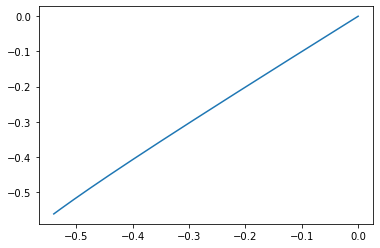

In [ ]:
plt.plot(theta_0s2,theta_1s2)

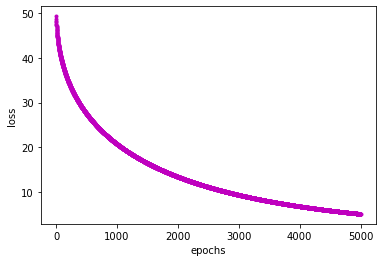

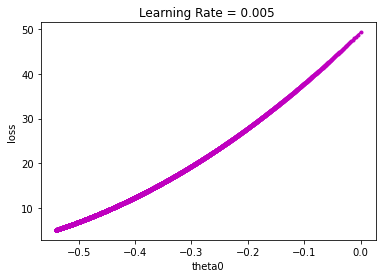

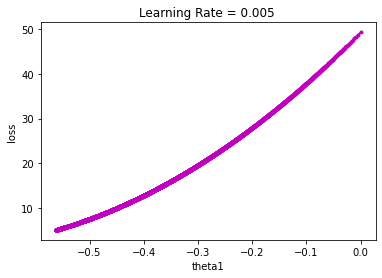

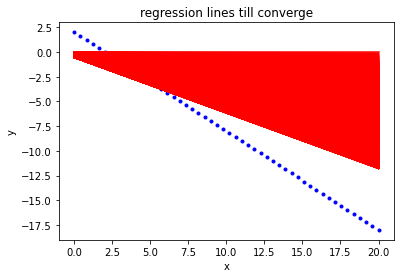

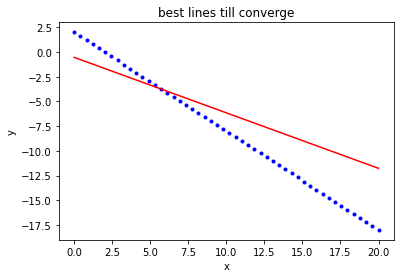

In [ ]:
r2_score(y,h_yhat2[-1])
plot(theta_0s2,theta_1s2,costs2,h_yhat2,lr2)

##### The following results uses alpha = 0.0005, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s3,theta_1s3,costs3,h_yhat3,lr3= Adagrad(x,y,0.0005,1e-08,5000)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

Vt0:64.00000000000003
Vt1: 13154.685546639828
th


j(mse):48.60383408887872

Gradient Vector:[[  7.9331199 ]
 [113.81413491]]

Gradient Vector Norm:114.09027871653504

Vt0:2976.3495459946835
Vt1: 612299.8670286473
theta_0_new :-0.0061519880787353955 
theta_1_new :-0.006152807021378553
****************** Iteration 47 ********************

h(x):[-0.00615199 -0.00866334 -0.01117469 -0.01368604 -0.01619739 -0.01870874
 -0.02122009 -0.02373144 -0.02624279 -0.02875414 -0.03126549 -0.03377684
 -0.03628819 -0.03879954 -0.04131089 -0.04382224 -0.04633358 -0.04884493
 -0.05135628 -0.05386763 -0.05637898 -0.05889033 -0.06140168 -0.06391303
 -0.06642438 -0.06893573 -0.07144708 -0.07395843 -0.07646978 -0.07898113
 -0.08149248 -0.08400383 -0.08651518 -0.08902653 -0.09153788 -0.09404923
 -0.09656058 -0.09907193 -0.10158328 -0.10409463 -0.10660598 -0.10911733
 -0.11162868 -0.11414003 -0.11665138 -0.11916273 -0.12167408 -0.12418543
 -0.12669678 -0.12920813]

Error Vector:[-2.00615199 -1.60050007 -1.19484816 -0.78919624 -0.38354433  0.02210759
  0.4277


Error Vector:[-2.00871083e+00 -1.60410366e+00 -1.19949650e+00 -7.94889328e-01
 -3.90282167e-01  1.43250036e-02  4.18932164e-01  8.23539335e-01
  1.22814650e+00  1.63275367e+00  2.03736083e+00  2.44196800e+00
  2.84657516e+00  3.25118233e+00  3.65578949e+00  4.06039666e+00
  4.46500382e+00  4.86961099e+00  5.27421816e+00  5.67882532e+00
  6.08343250e+00  6.48803966e+00  6.89264683e+00  7.29725399e+00
  7.70186116e+00  8.10646832e+00  8.51107549e+00  8.91568265e+00
  9.32028982e+00  9.72489698e+00  1.01295042e+01  1.05341113e+01
  1.09387185e+01  1.13433257e+01  1.17479328e+01  1.21525400e+01
  1.25571471e+01  1.29617543e+01  1.33663615e+01  1.37709687e+01
  1.41755758e+01  1.45801830e+01  1.49847901e+01  1.53893973e+01
  1.57940045e+01  1.61986116e+01  1.66032188e+01  1.70078260e+01
  1.74124331e+01  1.78170403e+01]

j(mse):48.283897197200716

Gradient Vector:[[  7.90416474]
 [113.4332565 ]]

Gradient Vector Norm:113.70830884632953

Vt0:5671.899007542079
Vt1: 1167300.972273273
theta_0_

theta_1_new :-0.010447115918120527
****************** Iteration 125 ********************

h(x):[-0.01044482 -0.01470895 -0.01897307 -0.0232372  -0.02750133 -0.03176546
 -0.03602959 -0.04029372 -0.04455785 -0.04882198 -0.05308611 -0.05735024
 -0.06161436 -0.06587849 -0.07014262 -0.07440675 -0.07867088 -0.08293501
 -0.08719914 -0.09146327 -0.0957274  -0.09999152 -0.10425565 -0.10851978
 -0.11278391 -0.11704804 -0.12131217 -0.1255763  -0.12984043 -0.13410456
 -0.13836869 -0.14263281 -0.14689694 -0.15116107 -0.1554252  -0.15968933
 -0.16395346 -0.16821759 -0.17248172 -0.17674585 -0.18100997 -0.1852741
 -0.18953823 -0.19380236 -0.19806649 -0.20233062 -0.20659475 -0.21085888
 -0.21512301 -0.21938714]

Error Vector:[-2.01044482e+00 -1.60654568e+00 -1.20264654e+00 -7.98747404e-01
 -3.94848273e-01  9.05086820e-03  4.12949999e-01  8.16849140e-01
  1.22074827e+00  1.62464741e+00  2.02854654e+00  2.43244568e+00
  2.83634482e+00  3.24024396e+00  3.64414309e+00  4.04804223e+00
  4.45194136e+00  4.85


Error Vector:[-2.01232737e+00 -1.60919698e+00 -1.20606659e+00 -8.02936201e-01
 -3.99805818e-01  3.32457475e-03  4.06454958e-01  8.09585350e-01
  1.21271573e+00  1.61584613e+00  2.01897651e+00  2.42210690e+00
  2.82523728e+00  3.22836768e+00  3.63149806e+00  4.03462845e+00
  4.43775884e+00  4.84088923e+00  5.24401962e+00  5.64715000e+00
  6.05028040e+00  6.45341078e+00  6.85654117e+00  7.25967156e+00
  7.66280195e+00  8.06593233e+00  8.46906272e+00  8.87219311e+00
  9.27532350e+00  9.67845388e+00  1.00815843e+01  1.04847147e+01
  1.08878451e+01  1.12909754e+01  1.16941058e+01  1.20972362e+01
  1.25003666e+01  1.29034970e+01  1.33066274e+01  1.37097578e+01
  1.41128882e+01  1.45160185e+01  1.49191489e+01  1.53222793e+01
  1.57254097e+01  1.61285401e+01  1.65316705e+01  1.69348009e+01
  1.73379313e+01  1.77410616e+01]

j(mse):47.84591693394142

Gradient Vector:[[  7.86436714]
 [112.90975438]]

Gradient Vector Norm:113.1833066504943

Vt0:10767.46249644639
Vt1: 2217220.1240260066
theta_0_n


Error Vector:[-2.01383353e+00 -1.61131823e+00 -1.20880294e+00 -8.06287638e-01
 -4.03772346e-01 -1.25704379e-03  4.01258248e-01  8.03773550e-01
  1.20628884e+00  1.60880414e+00  2.01131944e+00  2.41383474e+00
  2.81635003e+00  3.21886533e+00  3.62138062e+00  4.02389593e+00
  4.42641122e+00  4.82892652e+00  5.23144182e+00  5.63395711e+00
  6.03647242e+00  6.43898771e+00  6.84150301e+00  7.24401830e+00
  7.64653360e+00  8.04904890e+00  8.45156420e+00  8.85407949e+00
  9.25659479e+00  9.65911009e+00  1.00616254e+01  1.04641407e+01
  1.08666560e+01  1.12691713e+01  1.16716866e+01  1.20742019e+01
  1.24767172e+01  1.28792325e+01  1.32817478e+01  1.36842631e+01
  1.40867784e+01  1.44892937e+01  1.48918090e+01  1.52943243e+01
  1.56968395e+01  1.60993548e+01  1.65018701e+01  1.69043854e+01
  1.73069007e+01  1.77094160e+01]

j(mse):47.66409679489795

Gradient Vector:[[  7.84779125]
 [112.69171278]]

Gradient Vector Norm:112.96464029271756

Vt0:13359.388127428925
Vt1: 2751584.985577894
theta_0_

Vt0:15572.74730850175
Vt1: 3208045.8758651097
theta_0_new :-0.015040550659437301 
theta_1_new :-0.015045251907949093
****************** Iteration 250 ********************

h(x):[-0.01504055 -0.02118147 -0.02732239 -0.03346331 -0.03960423 -0.04574515
 -0.05188607 -0.05802698 -0.0641679  -0.07030882 -0.07644974 -0.08259066
 -0.08873158 -0.0948725  -0.10101342 -0.10715434 -0.11329526 -0.11943618
 -0.1255771  -0.13171801 -0.13785893 -0.14399985 -0.15014077 -0.15628169
 -0.16242261 -0.16856353 -0.17470445 -0.18084537 -0.18698629 -0.19312721
 -0.19926813 -0.20540904 -0.21154996 -0.21769088 -0.2238318  -0.22997272
 -0.23611364 -0.24225456 -0.24839548 -0.2545364  -0.26067732 -0.26681824
 -0.27295915 -0.27910007 -0.28524099 -0.29138191 -0.29752283 -0.30366375
 -0.30980467 -0.31594559]

Error Vector:[-2.01504055e+00 -1.61301820e+00 -1.21099586e+00 -8.08973508e-01
 -4.06951167e-01 -4.92881644e-03  3.97093524e-01  7.99115875e-01
  1.20113822e+00  1.60316057e+00  2.00518291e+00  2.40720526e+00
  2.

theta_0_new :-0.01618986876482353 
theta_1_new :-0.016195304725183206
****************** Iteration 288 ********************

h(x):[-0.01618987 -0.0228002  -0.02941053 -0.03602085 -0.04263118 -0.04924151
 -0.05585184 -0.06246217 -0.0690725  -0.07568282 -0.08229315 -0.08890348
 -0.09551381 -0.10212414 -0.10873447 -0.1153448  -0.12195512 -0.12856545
 -0.13517578 -0.14178611 -0.14839644 -0.15500677 -0.16161709 -0.16822742
 -0.17483775 -0.18144808 -0.18805841 -0.19466874 -0.20127907 -0.20788939
 -0.21449972 -0.22111005 -0.22772038 -0.23433071 -0.24094104 -0.24755136
 -0.25416169 -0.26077202 -0.26738235 -0.27399268 -0.28060301 -0.28721334
 -0.29382366 -0.30043399 -0.30704432 -0.31365465 -0.32026498 -0.32687531
 -0.33348563 -0.34009596]

Error Vector:[-2.01618987e+00 -1.61463693e+00 -1.21308400e+00 -8.11531054e-01
 -4.09978123e-01 -8.42518112e-03  3.93127751e-01  7.94680692e-01
  1.19623362e+00  1.59778657e+00  1.99933950e+00  2.40089244e+00
  2.80244537e+00  3.20399831e+00  3.60555124e+00  4


Error Vector:[-2.01731990e+00 -1.61622851e+00 -1.21513713e+00 -8.14045745e-01
 -4.12954367e-01 -1.18629784e-02  3.89228400e-01  7.90319788e-01
  1.19141117e+00  1.59250255e+00  1.99359393e+00  2.39468532e+00
  2.79577670e+00  3.19686809e+00  3.59795947e+00  3.99905085e+00
  4.40014223e+00  4.80123362e+00  5.20232501e+00  5.60341639e+00
  6.00450777e+00  6.40559915e+00  6.80669054e+00  7.20778192e+00
  7.60887331e+00  8.00996469e+00  8.41105607e+00  8.81214745e+00
  9.21323884e+00  9.61433022e+00  1.00154216e+01  1.04165130e+01
  1.08176044e+01  1.12186958e+01  1.16197871e+01  1.20208785e+01
  1.24219699e+01  1.28230613e+01  1.32241527e+01  1.36252441e+01
  1.40263354e+01  1.44274268e+01  1.48285182e+01  1.52296096e+01
  1.56307010e+01  1.60317924e+01  1.64328837e+01  1.68339751e+01
  1.72350665e+01  1.76361579e+01]

j(mse):47.244548800292876

Gradient Vector:[[  7.809419  ]
 [112.18695756]]

Gradient Vector Norm:112.45843886195918

Vt0:20405.869075529303
Vt1: 4205195.034401985
theta_0


Vt0:22537.505145972482
Vt1: 4645152.124351825
theta_0_new :-0.01827887938410548 
theta_1_new :-0.018285789517376402
****************** Iteration 364 ********************

h(x):[-0.01827888 -0.02574247 -0.03320605 -0.04066964 -0.04813323 -0.05559682
 -0.0630604  -0.07052399 -0.07798758 -0.08545117 -0.09291475 -0.10037834
 -0.10784193 -0.11530552 -0.12276911 -0.13023269 -0.13769628 -0.14515987
 -0.15262346 -0.16008704 -0.16755063 -0.17501422 -0.18247781 -0.18994139
 -0.19740498 -0.20486857 -0.21233216 -0.21979574 -0.22725933 -0.23472292
 -0.24218651 -0.24965009 -0.25711368 -0.26457727 -0.27204086 -0.27950444
 -0.28696803 -0.29443162 -0.30189521 -0.30935879 -0.31682238 -0.32428597
 -0.33174956 -0.33921314 -0.34667673 -0.35414032 -0.36160391 -0.36906749
 -0.37653108 -0.38399467]

Error Vector:[-2.01827888e+00 -1.61757920e+00 -1.21687952e+00 -8.16179842e-01
 -4.15480170e-01 -1.47804872e-02  3.85919185e-01  7.86618868e-01
  1.18731854e+00  1.58801822e+00  1.98871790e+00  2.38941758e+00
  2.


Vt0:24299.565206321804
Vt1: 5008903.192105451
theta_0_new :-0.019017111811904814 
theta_1_new :-0.019024585964120547
****************** Iteration 393 ********************

h(x):[-0.01901711 -0.02678225 -0.03454739 -0.04231252 -0.05007766 -0.0578428
 -0.06560793 -0.07337307 -0.08113821 -0.08890335 -0.09666848 -0.10443362
 -0.11219876 -0.11996389 -0.12772903 -0.13549417 -0.14325931 -0.15102444
 -0.15878958 -0.16655472 -0.17431985 -0.18208499 -0.18985013 -0.19761527
 -0.2053804  -0.21314554 -0.22091068 -0.22867581 -0.23644095 -0.24420609
 -0.25197123 -0.25973636 -0.2675015  -0.27526664 -0.28303177 -0.29079691
 -0.29856205 -0.30632719 -0.31409232 -0.32185746 -0.3296226  -0.33738773
 -0.34515287 -0.35291801 -0.36068315 -0.36844828 -0.37621342 -0.38397856
 -0.39174369 -0.39950883]

Error Vector:[-2.01901711e+00 -1.61861898e+00 -1.21822086e+00 -8.17822723e-01
 -4.17424600e-01 -1.70264675e-02  3.83371655e-01  7.83769788e-01
  1.18416791e+00  1.58456604e+00  1.98496417e+00  2.38536230e+00
  2.


Gradient Vector Norm:112.1192193776441

Vt0:25936.85952874825
Vt1: 5346954.778485106
theta_0_new :-0.019680114494257054 
theta_1_new :-0.01968811445761829
****************** Iteration 420 ********************

h(x):[-0.01968011 -0.02771608 -0.03575204 -0.04378801 -0.05182397 -0.05985994
 -0.0678959  -0.07593187 -0.08396784 -0.0920038  -0.10003977 -0.10807573
 -0.1161117  -0.12414766 -0.13218363 -0.14021959 -0.14825556 -0.15629152
 -0.16432749 -0.17236345 -0.18039942 -0.18843538 -0.19647135 -0.20450731
 -0.21254328 -0.22057924 -0.22861521 -0.23665117 -0.24468714 -0.2527231
 -0.26075907 -0.26879503 -0.276831   -0.28486696 -0.29290293 -0.30093889
 -0.30897486 -0.31701082 -0.32504679 -0.33308275 -0.34111872 -0.34915468
 -0.35719065 -0.36522661 -0.37326258 -0.38129854 -0.38933451 -0.39737047
 -0.40540644 -0.4134424 ]

Error Vector:[-2.01968011 -1.61955281 -1.21942551 -0.81929821 -0.41917091 -0.01904361
  0.38108369  0.78121099  1.18133828  1.58146559  1.98159288  2.38172019
  2.78184748  3


j(mse):46.86523786380034

Gradient Vector:[[  7.77457688]
 [111.72863695]]

Gradient Vector Norm:111.99880517794242

Vt0:28054.798146863515
Vt1: 5784322.987204292
theta_0_new :-0.020508344148500418 
theta_1_new :-0.02051702666378426
****************** Iteration 455 ********************

h(x):[-0.02050834 -0.02888264 -0.03725694 -0.04563123 -0.05400553 -0.06237983
 -0.07075412 -0.07912842 -0.08750272 -0.09587701 -0.10425131 -0.11262561
 -0.1209999  -0.1293742  -0.1377485  -0.14612279 -0.15449709 -0.16287139
 -0.17124568 -0.17961998 -0.18799428 -0.19636857 -0.20474287 -0.21311717
 -0.22149146 -0.22986576 -0.23824006 -0.24661435 -0.25498865 -0.26336295
 -0.27173724 -0.28011154 -0.28848584 -0.29686013 -0.30523443 -0.31360873
 -0.32198302 -0.33035732 -0.33873161 -0.34710591 -0.35548021 -0.3638545
 -0.3722288  -0.3806031  -0.38897739 -0.39735169 -0.40572599 -0.41410028
 -0.42247458 -0.43084888]

Error Vector:[-2.02050834 -1.62071937 -1.22093041 -0.82114143 -0.42135247 -0.0215635
  0.3782254


Error Vector:[-2.02148303 -1.62209223 -1.22270144 -0.82331064 -0.42391985 -0.02452905
  0.37486174  0.77425254  1.17364333  1.57303413  1.97242493  2.37181573
  2.77120652  3.17059732  3.56998811  3.96937891  4.3687697   4.7681605
  5.1675513   5.56694209  5.96633289  6.36572368  6.76511448  7.16450527
  7.56389607  7.96328686  8.36267766  8.76206845  9.16145925  9.56085004
  9.96024084 10.35963163 10.75902243 11.15841323 11.55780402 11.95719482
 12.35658561 12.75597641 13.1553672  13.554758   13.95414879 14.35353959
 14.75293039 15.15232119 15.55171198 15.95110278 16.35049357 16.74988437
 17.14927516 17.54866596]

j(mse):46.74596813160731

Gradient Vector:[[  7.76359146]
 [111.58413227]]

Gradient Vector Norm:111.85388650699328

Vt0:30710.465497512134
Vt1: 6332855.93544702
theta_0_new :-0.021505179051970535 
theta_1_new :-0.021514721073393764
****************** Iteration 499 ********************

h(x):[-0.02150518 -0.0302867  -0.03906822 -0.04784974 -0.05663125 -0.06541277
 -0.074194


Vt0:32998.08233994891
Vt1: 6805470.816196789
theta_0_new :-0.022330899033995766 
theta_1_new :-0.022341184585920937
****************** Iteration 537 ********************

h(x):[-0.0223309  -0.03144975 -0.0405686  -0.04968745 -0.0588063  -0.06792515
 -0.077044   -0.08616286 -0.09528171 -0.10440056 -0.11351941 -0.12263826
 -0.13175711 -0.14087596 -0.14999481 -0.15911366 -0.16823251 -0.17735136
 -0.18647021 -0.19558907 -0.20470792 -0.21382677 -0.22294562 -0.23206447
 -0.24118332 -0.25030217 -0.25942102 -0.26853987 -0.27765872 -0.28677757
 -0.29589642 -0.30501528 -0.31413413 -0.32325298 -0.33237183 -0.34149068
 -0.35060953 -0.35972838 -0.36884723 -0.37796608 -0.38708493 -0.39620378
 -0.40532263 -0.41444149 -0.42356034 -0.43267919 -0.44179804 -0.45091689
 -0.46003574 -0.46915459]

Error Vector:[-2.0223309  -1.62328648 -1.22424207 -0.82519765 -0.42615324 -0.02710882
  0.37193559  0.77098     1.17002441  1.56906883  1.96811324  2.36715766
  2.76620207  3.16524649  3.5642909   3.96333532  4.3


Error Vector:[-2.02304501 -1.62429234 -1.22553968 -0.82678701 -0.42803435 -0.02928167
  0.36947099  0.76822366  1.16697632  1.56572899  1.96448166  2.36323433
  2.76198699  3.16073966  3.55949232  3.95824499  4.35699766  4.75575033
  5.154503    5.55325566  5.95200833  6.350761    6.74951367  7.14826633
  7.547019    7.94577166  8.34452434  8.743277    9.14202967  9.54078233
  9.939535   10.33828766 10.73704034 11.13579301 11.53454567 11.93329834
 12.332051   12.73080368 13.12955634 13.52830901 13.92706167 14.32581434
 14.72456701 15.12331968 15.52207234 15.92082501 16.31957767 16.71833034
 17.11708301 17.51583568]

j(mse):46.55957950071797

Gradient Vector:[[  7.74639533]
 [111.35793003]]

Gradient Vector Norm:111.62703624899896

Vt0:35100.4363598683
Vt1: 7239892.595489583
theta_0_new :-0.023065687111504817 
theta_1_new :-0.023076658458607402
****************** Iteration 572 ********************

h(x):[-0.02306569 -0.03248473 -0.04190378 -0.05132282 -0.06074186 -0.07016091
 -0.079579


j(mse):46.45793728171176

Gradient Vector:[[  7.73700306]
 [111.23438153]]

Gradient Vector Norm:111.5031338134014

Vt0:37617.56979666487
Vt1: 7760122.491479765
theta_0_new :-0.02391805342435693 
theta_1_new :-0.02392984889888352
****************** Iteration 614 ********************

h(x):[-0.02391805 -0.03368534 -0.04345262 -0.05321991 -0.06298719 -0.07275448
 -0.08252176 -0.09228905 -0.10205634 -0.11182362 -0.12159091 -0.13135819
 -0.14112548 -0.15089276 -0.16066005 -0.17042733 -0.18019462 -0.1899619
 -0.19972919 -0.20949647 -0.21926376 -0.22903104 -0.23879833 -0.24856561
 -0.2583329  -0.26810018 -0.27786747 -0.28763476 -0.29740204 -0.30716933
 -0.31693661 -0.3267039  -0.33647118 -0.34623847 -0.35600575 -0.36577304
 -0.37554032 -0.38530761 -0.39507489 -0.40484218 -0.41460946 -0.42437675
 -0.43414403 -0.44391132 -0.4536786  -0.46344589 -0.47321318 -0.48298046
 -0.49274775 -0.50251503]

Error Vector:[-2.02391805 -1.62552207 -1.22712609 -0.82873011 -0.43033413 -0.03193815
  0.36645783 


j(mse):46.380596487471685

Gradient Vector:[[  7.72984933]
 [111.14027942]]

Gradient Vector Norm:111.40876213389566

Vt0:39591.10062498409
Vt1: 8168077.071293923
theta_0_new :-0.02456728148064767 
theta_1_new :-0.024579725350806613
****************** Iteration 647 ********************

h(x):[-0.02456728 -0.03459982 -0.04463236 -0.0546649  -0.06469745 -0.07472999
 -0.08476253 -0.09479507 -0.10482761 -0.11486015 -0.12489269 -0.13492523
 -0.14495777 -0.15499031 -0.16502285 -0.1750554  -0.18508794 -0.19512048
 -0.20515302 -0.21518556 -0.2252181  -0.23525064 -0.24528318 -0.25531572
 -0.26534826 -0.27538081 -0.28541335 -0.29544589 -0.30547843 -0.31551097
 -0.32554351 -0.33557605 -0.34560859 -0.35564113 -0.36567367 -0.37570622
 -0.38573876 -0.3957713  -0.40580384 -0.41583638 -0.42586892 -0.43590146
 -0.445934   -0.45596654 -0.46599908 -0.47603162 -0.48606417 -0.49609671
 -0.50612925 -0.51616179]

Error Vector:[-2.02456728 -1.62643655 -1.22830583 -0.8301751  -0.43204439 -0.03391366
  0.36421


Error Vector:[-2.0252189  -1.6273544  -1.22948992 -0.83162543 -0.43376095 -0.03589646
  0.36196802  0.75983251  1.15769699  1.55556149  1.95342597  2.35129046
  2.74915494  3.14701943  3.54488391  3.9427484   4.34061288  4.73847737
  5.13634187  5.53420635  5.93207084  6.32993532  6.72779981  7.12566429
  7.52352878  7.92139326  8.31925776  8.71712224  9.11498673  9.51285121
  9.9107157  10.30858018 10.70644467 11.10430916 11.50217365 11.90003814
 12.29790262 12.69576711 13.09363159 13.49149608 13.88936056 14.28722505
 14.68508953 15.08295403 15.48081851 15.878683   16.27654748 16.67441197
 17.07227645 17.47014094]

j(mse):46.30078870871493

Gradient Vector:[[  7.72246102]
 [111.04309159]]

Gradient Vector Norm:111.31129589229855

Vt0:41680.306413736325
Vt1: 8600012.314980721
theta_0_new :-0.025237808387098225 
theta_1_new :-0.025250940756553552
****************** Iteration 682 ********************

h(x):[-0.02523781 -0.03554431 -0.04585082 -0.05615733 -0.06646383 -0.07677034
 -0.0870


Error Vector:[-2.02576179 -1.62811912 -1.23047646 -0.83283379 -0.43519113 -0.03754846
  0.3600942   0.75773687  1.15537953  1.5530222   1.95066486  2.34830752
  2.74595018  3.14359285  3.54123551  3.93887818  4.33652084  4.73416351
  5.13180618  5.52944884  5.92709151  6.32473417  6.72237684  7.1200195
  7.51766217  7.91530482  8.31294749  8.71059015  9.10823282  9.50587548
  9.90351815 10.30116081 10.69880348 11.09644615 11.49408881 11.89173148
 12.28937414 12.68701681 13.08465947 13.48230213 13.87994479 14.27758746
 14.67523012 15.07287279 15.47051545 15.86815812 16.26580078 16.66344345
 17.06108611 17.45872878]

j(mse):46.23627135094554

Gradient Vector:[[  7.7164835 ]
 [110.96446144]]

Gradient Vector Norm:111.23244050141247

Vt0:43408.37296823121
Vt1: 8957336.02712828
theta_0_new :-0.025780306311681305 
theta_1_new :-0.02579400976459914
****************** Iteration 711 ********************

h(x):[-0.02578031 -0.03630847 -0.04683664 -0.05736481 -0.06789298 -0.07842114
 -0.08894931


Error Vector:[-2.02634797 -1.62894482 -1.23154168 -0.83413853 -0.43673539 -0.03933223
  0.35807091  0.75547406  1.1528772   1.55028035  1.9476835   2.34508665
  2.74248979  3.13989294  3.53729608  3.93469924  4.33210238  4.72950553
  5.12690868  5.52431183  5.92171498  6.31911812  6.71652127  7.11392441
  7.51132757  7.90873071  8.30613386  8.703537    9.10094015  9.4983433
  9.89574645 10.29314959 10.69055274 11.08795589 11.48535904 11.88276219
 12.28016533 12.67756848 13.07497162 13.47237478 13.86977792 14.26718107
 14.66458421 15.06198737 15.45939051 15.85679366 16.2541968  16.65159995
 17.0490031  17.44640625]

j(mse):46.166659001920706

Gradient Vector:[[  7.71002914]
 [110.87955889]]

Gradient Vector Norm:111.14729474507219

Vt0:45312.1357188041
Vt1: 9351043.66525666
theta_0_new :-0.026366084383690938 
theta_1_new :-0.026380418626016325
****************** Iteration 743 ********************

h(x):[-0.02636608 -0.0371336  -0.04790112 -0.05866864 -0.06943616 -0.08020367
 -0.0909711


Error Vector:[-2.02685047 -1.62965265 -1.23245483 -0.83525701 -0.43805919 -0.04086136
  0.35633645  0.75353428  1.15073209  1.54792992  1.94512773  2.34232556
  2.73952338  3.1367212   3.53391902  3.93111684  4.32831466  4.72551248
  5.12271031  5.51990812  5.91710595  6.31430377  6.71150159  7.10869941
  7.50589723  7.90309505  8.30029287  8.69749069  9.09468851  9.49188633
  9.88908416 10.28628197 10.6834798  11.08067762 11.47787544 11.87507326
 12.27227108 12.66946891 13.06666672 13.46386455 13.86106236 14.25826019
 14.655458   15.05265583 15.44985364 15.84705147 16.24424929 16.64144711
 17.03864493 17.43584275]

j(mse):46.107026477537765

Gradient Vector:[[  7.70449614]
 [110.80677617]]

Gradient Vector Norm:111.07430354037965

Vt0:46975.34254932277
Vt1: 9695048.72388067
theta_0_new :-0.026868245578823023 
theta_1_new :-0.026883132290874388
****************** Iteration 771 ********************

h(x):[-0.02686825 -0.03784095 -0.04881366 -0.05978637 -0.07075907 -0.08173178
 -0.09270


Error Vector:[-2.0273438  -1.63034756 -1.23335132 -0.83635508 -0.43935885 -0.04236261
  0.35463362  0.75162987  1.1486261   1.54562234  1.94261857  2.33961481
  2.73661105  3.13360729  3.53060352  3.92759976  4.32459599  4.72159224
  5.11858848  5.51558471  5.91258095  6.30957718  6.70657343  7.10356966
  7.5005659   7.89756213  8.29455837  8.69155461  9.08855085  9.48554708
  9.88254332 10.27953955 10.6765358  11.07353204 11.47052827 11.86752451
 12.26452074 12.66151699 13.05851322 13.45550946 13.85250569 14.24950193
 14.64649817 15.04349441 15.44049064 15.83748688 16.23448311 16.63147936
 17.02847559 17.42547183]

j(mse):46.04851940492128

Gradient Vector:[[  7.69906402]
 [110.73532033]]

Gradient Vector Norm:111.0026430078968

Vt0:48636.18491634008
Vt1: 10038606.45766606
theta_0_new :-0.027361253972406296 
theta_1_new :-0.027376693637749642
****************** Iteration 799 ********************

h(x):[-0.02736125 -0.03853541 -0.04970958 -0.06088374 -0.0720579  -0.08323206
 -0.094406


j(mse):45.98092992684114

Gradient Vector:[[  7.69278424]
 [110.65271417]]

Gradient Vector Norm:110.91980023071943

Vt0:50590.630441145884
Vt1: 10442950.762223048
theta_0_new :-0.02793119521694327 
theta_1_new :-0.027947287185710833
****************** Iteration 832 ********************

h(x):[-0.0279312  -0.03933825 -0.05074531 -0.06215236 -0.07355942 -0.08496648
 -0.09637353 -0.10778059 -0.11918764 -0.1305947  -0.14200176 -0.15340881
 -0.16481587 -0.17622292 -0.18762998 -0.19903704 -0.21044409 -0.22185115
 -0.2332582  -0.24466526 -0.25607232 -0.26747937 -0.27888643 -0.29029348
 -0.30170054 -0.31310759 -0.32451465 -0.33592171 -0.34732876 -0.35873582
 -0.37014288 -0.38154993 -0.39295699 -0.40436404 -0.4157711  -0.42717816
 -0.43858521 -0.44999227 -0.46139932 -0.47280638 -0.48421343 -0.49562049
 -0.50702755 -0.5184346  -0.52984166 -0.54124871 -0.55265577 -0.56406283
 -0.57546988 -0.58687694]

Error Vector:[-2.0279312  -1.63117498 -1.23441878 -0.83766256 -0.44090636 -0.04415015
  0.3526


Error Vector:[-2.02878993 -1.63238464 -1.23597935 -0.83957406 -0.44316877 -0.04676347
  0.34964181  0.74604711  1.1424524   1.53885769  1.93526298  2.33166827
  2.72807356  3.12447886  3.52088414  3.91728944  4.31369473  4.71010002
  5.10650532  5.5029106   5.8993159   6.29572119  6.69212648  7.08853177
  7.48493707  7.88134235  8.27774765  8.67415293  9.07055823  9.46696352
  9.86336881 10.2597741  10.6561794  11.05258469 11.44898998 11.84539527
 12.24180056 12.63820586 13.03461114 13.43101644 13.82742173 14.22382702
 14.62023231 15.0166376  15.41304289 15.80944819 16.20585347 16.60225877
 16.99866405 17.39506935]

j(mse):45.877224167754584

Gradient Vector:[[  7.68313971]
 [110.52584686]]

Gradient Vector Norm:110.79256951540204

Vt0:53663.984446615184
Vt1: 11078892.493723974
theta_0_new :-0.028806517549534352 
theta_1_new :-0.028823638694509175
****************** Iteration 884 ********************

h(x):[-0.02880652 -0.04057127 -0.05233602 -0.06410077 -0.07586552 -0.08763027
 -0.09


Vt0:56494.18529928163
Vt1: 11664639.964803858
theta_0_new :-0.029591616531263455 
theta_1_new :-0.029609689063715035
****************** Iteration 932 ********************

h(x):[-0.02959162 -0.0416772  -0.05376279 -0.06584838 -0.07793397 -0.09001955
 -0.10210514 -0.11419073 -0.12627632 -0.1383619  -0.15044749 -0.16253308
 -0.17461866 -0.18670425 -0.19878984 -0.21087543 -0.22296101 -0.2350466
 -0.24713219 -0.25921778 -0.27130336 -0.28338895 -0.29547454 -0.30756013
 -0.31964571 -0.3317313  -0.34381689 -0.35590248 -0.36798806 -0.38007365
 -0.39215924 -0.40424482 -0.41633041 -0.428416   -0.44050159 -0.45258717
 -0.46467276 -0.47675835 -0.48884394 -0.50092952 -0.51301511 -0.5251007
 -0.53718629 -0.54927187 -0.56135746 -0.57344305 -0.58552864 -0.59761422
 -0.60969981 -0.6217854 ]

Error Vector:[-2.02959162 -1.63351393 -1.23743626 -0.84135858 -0.44528091 -0.04920322
  0.34687445  0.74295213  1.1390298   1.53510749  1.93118516  2.32726284
  2.72334052  3.1194182   3.51549587  3.91157355  4.30


Error Vector:[-2.03040363 -1.63465779 -1.23891197 -0.84316613 -0.44742031 -0.05167447
  0.34407136  0.73981719  1.13556302  1.53130885  1.92705468  2.32280051
  2.71854634  3.11429218  3.510038    3.90578384  4.30152966  4.6972755
  5.09302133  5.48876716  5.88451299  6.28025882  6.67600466  7.07175048
  7.46749632  7.86324214  8.25898798  8.65473381  9.05047964  9.44622547
  9.8419713  10.23771713 10.63346296 11.0292088  11.42495463 11.82070046
 12.21644629 12.61219212 13.00793795 13.40368378 13.79942961 14.19517545
 14.59092127 14.98666711 15.38241293 15.77815877 16.17390459 16.56965043
 16.96539626 17.36114209]

j(mse):45.68645489387413

Gradient Vector:[[  7.66536923]
 [110.29208794]]

Gradient Vector Norm:110.55814102891102

Vt0:59553.14539149592
Vt1: 12297857.780621093
theta_0_new :-0.030419334668299606 
theta_1_new :-0.030438439321456862
****************** Iteration 984 ********************

h(x):[-0.03041933 -0.04284319 -0.05526704 -0.06769089 -0.08011475 -0.0925386
 -0.104962


Error Vector:[-2.0310718  -1.63559904 -1.24012628 -0.84465352 -0.44918077 -0.053708
  0.34176475  0.73723751  1.13271027  1.52818303  1.92365578  2.31912855
  2.7146013   3.11007406  3.50554682  3.90101958  4.29649233  4.6919651
  5.08743786  5.48291061  5.87838338  6.27385613  6.66932889  7.06480165
  7.46027441  7.85574716  8.25121993  8.64669268  9.04216545  9.4376382
  9.83311096 10.22858372 10.62405648 11.01952924 11.415002   11.81047476
 12.20594751 12.60142028 12.99689303 13.39236579 13.78783855 14.18331131
 14.57878406 14.97425683 15.36972958 15.76520234 16.1606751  16.55614786
 16.95162061 17.34709338]

j(mse):45.60757955390369

Gradient Vector:[[  7.65801079]
 [110.19529237]]

Gradient Vector Norm:110.46106820829714

Vt0:62077.244678467476
Vt1: 12820453.347043827
theta_0_new :-0.03108716975828528 
theta_1_new :-0.031107129006852335
****************** Iteration 1027 ********************

h(x):[-0.03108717 -0.04378396 -0.05648074 -0.06917753 -0.08187432 -0.09457111
 -0.1072678


Gradient Vector Norm:110.36603665982052

Vt0:64596.55047857421
Vt1: 13342141.576643402
theta_0_new :-0.03174095727217487 
theta_1_new :-0.0317617720986041
****************** Iteration 1070 ********************

h(x):[-0.03174096 -0.04470495 -0.05766893 -0.07063292 -0.08359691 -0.0965609
 -0.10952489 -0.12248888 -0.13545287 -0.14841685 -0.16138084 -0.17434483
 -0.18730882 -0.20027281 -0.2132368  -0.22620079 -0.23916477 -0.25212876
 -0.26509275 -0.27805674 -0.29102073 -0.30398472 -0.31694871 -0.3299127
 -0.34287668 -0.35584067 -0.36880466 -0.38176865 -0.39473264 -0.40769663
 -0.42066062 -0.4336246  -0.44658859 -0.45955258 -0.47251657 -0.48548056
 -0.49844455 -0.51140854 -0.52437252 -0.53733651 -0.5503005  -0.56326449
 -0.57622848 -0.58919247 -0.60215646 -0.61512044 -0.62808443 -0.64104842
 -0.65401241 -0.6669764 ]

Error Vector:[-2.03174096 -1.63654168 -1.2413424  -0.84614312 -0.45094385 -0.05574457
  0.3394547   0.73465398  1.12985325  1.52505254  1.92025181  2.31545109
  2.71065036  3


j(mse):45.435832530229426

Gradient Vector:[[  7.64196563]
 [109.9842285 ]]

Gradient Vector Norm:110.24939980830617

Vt0:67753.69813884437
Vt1: 13996029.537229598
theta_0_new :-0.03254337567800948 
theta_1_new :-0.03256526631168753
****************** Iteration 1124 ********************

h(x):[-0.03254338 -0.04583532 -0.05912727 -0.07241921 -0.08571116 -0.0990031
 -0.11229505 -0.12558699 -0.13887894 -0.15217088 -0.16546283 -0.17875478
 -0.19204672 -0.20533867 -0.21863061 -0.23192256 -0.2452145  -0.25850645
 -0.27179839 -0.28509034 -0.29838228 -0.31167423 -0.32496618 -0.33825812
 -0.35155007 -0.36484201 -0.37813396 -0.3914259  -0.40471785 -0.41800979
 -0.43130174 -0.44459368 -0.45788563 -0.47117758 -0.48446952 -0.49776147
 -0.51105341 -0.52434536 -0.5376373  -0.55092925 -0.56422119 -0.57751314
 -0.59080508 -0.60409703 -0.61738897 -0.63068092 -0.64397287 -0.65726481
 -0.67055676 -0.6838487 ]

Error Vector:[-2.03254338 -1.63767205 -1.24280074 -0.84792941 -0.4530581  -0.05818677
  0.33668

Vt0:71369.69538379046
Vt1: 14745109.379697293
theta_0_new :-0.03344088546310146 
theta_1_new :-0.033464013106393485
****************** Iteration 1186 ********************

h(x):[-0.03344089 -0.04709967 -0.06075845 -0.07441723 -0.08807601 -0.10173479
 -0.11539357 -0.12905235 -0.14271113 -0.15636991 -0.17002869 -0.18368747
 -0.19734626 -0.21100504 -0.22466382 -0.2383226  -0.25198138 -0.26564016
 -0.27929894 -0.29295772 -0.3066165  -0.32027528 -0.33393406 -0.34759285
 -0.36125163 -0.37491041 -0.38856919 -0.40222797 -0.41588675 -0.42954553
 -0.44320431 -0.45686309 -0.47052187 -0.48418065 -0.49783943 -0.51149822
 -0.525157   -0.53881578 -0.55247456 -0.56613334 -0.57979212 -0.5934509
 -0.60710968 -0.62076846 -0.63442724 -0.64808602 -0.6617448  -0.67540359
 -0.68906237 -0.70272115]

Error Vector:[-2.03344089 -1.6389364  -1.24443192 -0.84992743 -0.45542295 -0.06091846
  0.33358602  0.72809051  1.12259499  1.51709948  1.91160396  2.30610845
  2.70061292  3.09511741  3.48962189  3.88412638  4.27


j(mse):45.26846118171122

Gradient Vector:[[  7.62629943]
 [109.77814925]]

Gradient Vector Norm:110.04273031452738

Vt0:73523.21395604557
Vt1: 15191304.920065882
theta_0_new :-0.03396516264404452 
theta_1_new :-0.03398902941110205
****************** Iteration 1223 ********************

h(x):[-0.03396516 -0.04783824 -0.06171131 -0.07558438 -0.08945746 -0.10333053
 -0.1172036  -0.13107668 -0.14494975 -0.15882282 -0.17269589 -0.18656897
 -0.20044204 -0.21431511 -0.22818819 -0.24206126 -0.25593433 -0.26980741
 -0.28368048 -0.29755355 -0.31142663 -0.3252997  -0.33917277 -0.35304585
 -0.36691892 -0.38079199 -0.39466507 -0.40853814 -0.42241121 -0.43628429
 -0.45015736 -0.46403043 -0.47790351 -0.49177658 -0.50564965 -0.51952273
 -0.5333958  -0.54726887 -0.56114195 -0.57501502 -0.58888809 -0.60276117
 -0.61663424 -0.63050731 -0.64438038 -0.65825346 -0.67212653 -0.6859996
 -0.69987268 -0.71374575]

Error Vector:[-2.03396516 -1.63967497 -1.24538478 -0.85109458 -0.4568044  -0.0625142
  0.3317759


Error Vector:[-2.03460585 -1.64057753 -1.24654922 -0.8525209  -0.4584926  -0.06446428
  0.32956403  0.72359234  1.11762065  1.51164897  1.90567728  2.29970559
  2.6937339   3.08776222  3.48179053  3.87581884  4.26984715  4.66387547
  5.05790379  5.45193209  5.84596041  6.23998872  6.63401704  7.02804534
  7.42207366  7.81610197  8.21013029  8.60415859  8.99818691  9.39221522
  9.78624354 10.18027184 10.57430016 10.96832848 11.36235679 11.7563851
 12.15041341 12.54444173 12.93847004 13.33249835 13.72652666 14.12055498
 14.51458329 14.9086116  15.30263991 15.69666823 16.09069654 16.48472485
 16.87875316 17.27278148]

j(mse):45.191521228625035

Gradient Vector:[[  7.61908782]
 [109.68328474]]

Gradient Vector Norm:109.9475941060871

Vt0:76254.10747093675
Vt1: 15757212.005899299
theta_0_new :-0.03461964274722674 
theta_1_new :-0.034644449360690235
****************** Iteration 1270 ********************

h(x):[-0.03461964 -0.04876023 -0.06290083 -0.07704142 -0.09118201 -0.1053226
 -0.119463


Error Vector:[-2.03537007 -1.64165414 -1.24793822 -0.85422229 -0.46050637 -0.06679044
  0.32692548  0.72064141  1.11435734  1.50807327  1.90178919  2.29550512
  2.68922104  3.08293697  3.47665289  3.87036882  4.26408474  4.65780068
  5.05151661  5.44523253  5.83894846  6.23266438  6.62638031  7.02009623
  7.41381216  7.80752808  8.20124401  8.59495994  8.98867587  9.38239179
  9.77610772 10.16982364 10.56353957 10.9572555  11.35097142 11.74468735
 12.13840327 12.53211921 12.92583513 13.31955106 13.71326698 14.10698291
 14.50069883 14.89441476 15.28813068 15.68184661 16.07556254 16.46927847
 16.86299439 17.25671032]

j(mse):45.101798375172024

Gradient Vector:[[  7.61067012]
 [109.57255496]]

Gradient Vector Norm:109.83654720125733

Vt0:79501.26796079066
Vt1: 16430221.165412437
theta_0_new :-0.03538356869675313 
theta_1_new :-0.03540949650334262
****************** Iteration 1326 ********************

h(x):[-0.03538357 -0.04983642 -0.06428928 -0.07874214 -0.09319499 -0.10764785
 -0.1221


j(mse):45.04049861900681

Gradient Vector:[[  7.60491413]
 [109.49683825]]

Gradient Vector Norm:109.76061363683408

Vt0:81758.48162671879
Vt1: 16898128.23714271
theta_0_new :-0.035905932358609824 
theta_1_new :-0.035932641864288545
****************** Iteration 1365 ********************

h(x):[-0.03590593 -0.05057232 -0.0652387  -0.07990509 -0.09457147 -0.10923785
 -0.12390424 -0.13857062 -0.15323701 -0.16790339 -0.18256978 -0.19723616
 -0.21190255 -0.22656893 -0.24123531 -0.2559017  -0.27056808 -0.28523447
 -0.29990085 -0.31456724 -0.32923362 -0.34390001 -0.35856639 -0.37323277
 -0.38789916 -0.40256554 -0.41723193 -0.43189831 -0.4465647  -0.46123108
 -0.47589747 -0.49056385 -0.50523023 -0.51989662 -0.534563   -0.54922939
 -0.56389577 -0.57856216 -0.59322854 -0.60789493 -0.62256131 -0.63722769
 -0.65189408 -0.66656046 -0.68122685 -0.69589323 -0.71055962 -0.725226
 -0.73989239 -0.75455877]

Error Vector:[-2.03590593 -1.64240905 -1.24891217 -0.85541529 -0.46191841 -0.06842152
  0.325075

h(x):[-0.03642075 -0.05129759 -0.06617443 -0.08105126 -0.0959281  -0.11080493
 -0.12568177 -0.1405586  -0.15543544 -0.17031227 -0.18518911 -0.20006594
 -0.21494278 -0.22981961 -0.24469645 -0.25957328 -0.27445012 -0.28932696
 -0.30420379 -0.31908063 -0.33395746 -0.3488343  -0.36371113 -0.37858797
 -0.3934648  -0.40834164 -0.42321847 -0.43809531 -0.45297214 -0.46784898
 -0.48272581 -0.49760265 -0.51247949 -0.52735632 -0.54223316 -0.55710999
 -0.57198683 -0.58686366 -0.6017405  -0.61661733 -0.63149417 -0.646371
 -0.66124784 -0.67612467 -0.69100151 -0.70587834 -0.72075518 -0.73563201
 -0.75050885 -0.76538569]

Error Vector:[-2.03642075 -1.64313432 -1.2498479  -0.85656146 -0.46327504 -0.0699886
  0.32329782  0.71658426  1.10987068  1.50315712  1.89644354  2.28972998
  2.6830164   3.07630284  3.46958926  3.8628757   4.25616212  4.64944855
  5.04273499  5.43602141  5.82930785  6.22259427  6.61588071  7.00916713
  7.40245357  7.79573999  8.18902643  8.58231285  8.97559929  9.36888571
  9.76217


Gradient Vector Norm:109.55591528797959

Vt0:87991.69551327151
Vt1: 18190550.282944687
theta_0_new :-0.037314067530013685 
theta_1_new :-0.03734294537131522
****************** Iteration 1473 ********************

h(x):[-0.03731407 -0.05255609 -0.0677981  -0.08304012 -0.09828214 -0.11352416
 -0.12876618 -0.1440082  -0.15925022 -0.17449223 -0.18973425 -0.20497627
 -0.22021829 -0.23546031 -0.25070233 -0.26594435 -0.28118636 -0.29642838
 -0.3116704  -0.32691242 -0.34215444 -0.35739646 -0.37263848 -0.38788049
 -0.40312251 -0.41836453 -0.43360655 -0.44884857 -0.46409059 -0.4793326
 -0.49457462 -0.50981664 -0.52505866 -0.54030068 -0.5555427  -0.57078472
 -0.58602673 -0.60126875 -0.61651077 -0.63175279 -0.64699481 -0.66223683
 -0.67747885 -0.69272086 -0.70796288 -0.7232049  -0.73844692 -0.75368894
 -0.76893096 -0.78417297]

Error Vector:[-2.03731407 -1.64439282 -1.25147157 -0.85855032 -0.46562908 -0.07270783
  0.32021341  0.71313466  1.1060559   1.49897716  1.8918984   2.28481965
  2.67774089


j(mse):44.799774515834855

Gradient Vector:[[  7.58227154]
 [109.19898782]]

Gradient Vector Norm:109.46191018883573

Vt0:90926.42283273158
Vt1: 18799206.08414289
theta_0_new :-0.03796072008424499 
theta_1_new :-0.037990623674636854
****************** Iteration 1524 ********************

h(x):[-0.03796072 -0.0534671  -0.06897347 -0.08447985 -0.09998623 -0.11549261
 -0.13099898 -0.14650536 -0.16201174 -0.17751811 -0.19302449 -0.20853087
 -0.22403724 -0.23954362 -0.25505    -0.27055638 -0.28606275 -0.30156913
 -0.31707551 -0.33258188 -0.34808826 -0.36359464 -0.37910101 -0.39460739
 -0.41011377 -0.42562015 -0.44112652 -0.4566329  -0.47213928 -0.48764565
 -0.50315203 -0.51865841 -0.53416478 -0.54967116 -0.56517754 -0.58068392
 -0.59619029 -0.61169667 -0.62720305 -0.64270942 -0.6582158  -0.67372218
 -0.68922855 -0.70473493 -0.72024131 -0.73574769 -0.75125406 -0.76676044
 -0.78226682 -0.79777319]

Error Vector:[-2.03796072 -1.64530383 -1.25264694 -0.85999005 -0.46733317 -0.07467628
  0.3179


j(mse):44.7225404445009

Gradient Vector:[[  7.57499371]
 [109.10325197]]

Gradient Vector Norm:109.3659001711672

Vt0:93970.45007811382
Vt1: 19430634.318837397
theta_0_new :-0.03862115358021908 
theta_1_new :-0.0386521243492123
****************** Iteration 1577 ********************

h(x):[-0.03862115 -0.05439753 -0.07017391 -0.08595029 -0.10172666 -0.11750304
 -0.13327942 -0.14905579 -0.16483217 -0.18060855 -0.19638493 -0.2121613
 -0.22793768 -0.24371406 -0.25949044 -0.27526681 -0.29104319 -0.30681957
 -0.32259594 -0.33837232 -0.3541487  -0.36992508 -0.38570145 -0.40147783
 -0.41725421 -0.43303059 -0.44880696 -0.46458334 -0.48035972 -0.49613609
 -0.51191247 -0.52768885 -0.54346523 -0.5592416  -0.57501798 -0.59079436
 -0.60657074 -0.62234711 -0.63812349 -0.65389987 -0.66967624 -0.68545262
 -0.701229   -0.71700538 -0.73278175 -0.74855813 -0.76433451 -0.78011089
 -0.79588726 -0.81166364]

Error Vector:[-2.03862115 -1.64623426 -1.25384738 -0.86146049 -0.4690736  -0.07668671
  0.31570017 


Vt0:96607.73663197222
Vt1: 19977776.012140114
theta_0_new :-0.03918524647545031 
theta_1_new :-0.0392171444543258
****************** Iteration 1623 ********************

h(x):[-0.03918525 -0.05519224 -0.07119924 -0.08720624 -0.10321324 -0.11922024
 -0.13522723 -0.15123423 -0.16724123 -0.18324823 -0.19925522 -0.21526222
 -0.23126922 -0.24727622 -0.26328321 -0.27929021 -0.29529721 -0.31130421
 -0.32731121 -0.3433182  -0.3593252  -0.3753322  -0.3913392  -0.40734619
 -0.42335319 -0.43936019 -0.45536719 -0.47137419 -0.48738118 -0.50338818
 -0.51939518 -0.53540218 -0.55140917 -0.56741617 -0.58342317 -0.59943017
 -0.61543716 -0.63144416 -0.64745116 -0.66345816 -0.67946516 -0.69547215
 -0.71147915 -0.72748615 -0.74349315 -0.75950014 -0.77550714 -0.79151414
 -0.80752114 -0.82352814]

Error Vector:[-2.03918525 -1.64702897 -1.25487271 -0.86271644 -0.47056018 -0.07840391
  0.31375236  0.70590863  1.09806489  1.49022116  1.88237743  2.2745337
  2.66668996  3.05884623  3.4510025   3.84315877  4.235


Error Vector:[-2.03976524 -1.6478461  -1.25592696 -0.86400782 -0.47208868 -0.08016954
  0.31174959  0.70366874  1.09558787  1.48750702  1.87942615  2.2713453
  2.66326443  3.05518357  3.44710271  3.83902185  4.23094099  4.62286013
  5.01477928  5.40669841  5.79861755  6.19053669  6.58245583  6.97437497
  7.36629411  7.75821325  8.15013239  8.54205153  8.93397067  9.3258898
  9.71780895 10.10972808 10.50164723 10.89356637 11.28548551 11.67740465
 12.06932378 12.46124293 12.85316206 13.24508121 13.63700034 14.02891949
 14.42083862 14.81275776 15.2046769  15.59659604 15.98851518 16.38043432
 16.77235346 17.1642726 ]

j(mse):44.587504078820096

Gradient Vector:[[  7.56225368]
 [108.93566366]]

Gradient Vector Norm:109.19783192583336

Vt0:99412.29560536476
Vt1: 20559705.661711257
theta_0_new :-0.039777233720198785 
theta_1_new :-0.039810120365524546
****************** Iteration 1672 ********************

h(x):[-0.03977723 -0.05602626 -0.07227529 -0.08852432 -0.10477335 -0.12102238
 -0.1372


Error Vector:[-2.04013532 -1.64836748 -1.25659965 -0.86483181 -0.47306398 -0.08129615
  0.31047168  0.70223952  1.09400735  1.48577519  1.87754302  2.26931085
  2.66107868  3.05284652  3.44461435  3.83638219  4.22815001  4.61991785
  5.01168569  5.40345352  5.79522136  6.18698919  6.57875702  6.97052485
  7.36229269  7.75406052  8.14582836  8.53759618  8.92936402  9.32113185
  9.71289969 10.10466752 10.49643535 10.88820319 11.27997102 11.67173886
 12.06350669 12.45527452 12.84704235 13.23881019 13.63057802 14.02234586
 14.41411369 14.80588152 15.19764935 15.58941719 15.98118502 16.37295286
 16.76472068 17.15648852]

j(mse):44.54433370900016

Gradient Vector:[[  7.5581766 ]
 [108.88203187]]

Gradient Vector Norm:109.14404655337266

Vt0:101184.12577832492
Vt1: 20927394.796792597
theta_0_new :-0.040147196039565826 
theta_1_new :-0.0401807086868328
****************** Iteration 1703 ********************

h(x):[-0.0401472  -0.05654749 -0.07294777 -0.08934806 -0.10574835 -0.12214864
 -0.1385


Error Vector:[-2.04063126 -1.6490662  -1.25750115 -0.86593608 -0.47437103 -0.08280597
  0.30875909  0.70032415  1.09188921  1.48345427  1.87501932  2.26658439
  2.65814944  3.0497145   3.44127956  3.83284462  4.22440967  4.61597474
  5.0075398   5.39910486  5.79066992  6.18223497  6.57380004  6.96536509
  7.35693015  7.74849521  8.14006027  8.53162532  8.92319039  9.31475544
  9.70632051 10.09788556 10.48945062 10.88101569 11.27258074 11.6641458
 12.05571086 12.44727592 12.83884097 13.23040604 13.62197109 14.01353616
 14.40510121 14.79666627 15.18823133 15.57979639 15.97136144 16.36292651
 16.75449156 17.14605663]

j(mse):44.486512136268104

Gradient Vector:[[  7.55271268]
 [108.81015681]]

Gradient Vector Norm:109.07196566672572

Vt0:103581.64025190985
Vt1: 21424980.1467465
theta_0_new :-0.04064299793466765 
theta_1_new :-0.04067735934796664
****************** Iteration 1745 ********************

h(x):[-0.040643   -0.057246   -0.07384901 -0.09045201 -0.10705501 -0.12365802
 -0.140261


Error Vector:[-2.04134084 -1.6500659  -1.25879098 -0.86751604 -0.47624111 -0.08496618
  0.30630875  0.69758369  1.08885861  1.48013355  1.87140848  2.26268341
  2.65395834  3.04523328  3.43650821  3.82778314  4.21905807  4.61033301
  5.00160794  5.39288287  5.78415781  6.17543273  6.56670767  6.9579826
  7.34925753  7.74053246  8.1318074   8.52308233  8.91435726  9.30563219
  9.69690713 10.08818205 10.47945699 10.87073193 11.26200685 11.65328179
 12.04455672 12.43583165 12.82710658 13.21838152 13.60965645 14.00093138
 14.39220631 14.78348125 15.17475617 15.56603111 15.95730604 16.34858097
 16.7398559  17.13113084]

j(mse):44.40384882211383

Gradient Vector:[[  7.544895  ]
 [108.70731922]]

Gradient Vector Norm:108.96883357932641

Vt0:107057.62184711522
Vt1: 22146503.273924068
theta_0_new :-0.041352370503213144 
theta_1_new :-0.04138796593220962
****************** Iteration 1806 ********************

h(x):[-0.04135237 -0.05824542 -0.07513847 -0.09203151 -0.10892456 -0.12581761
 -0.1427


Error Vector:[-2.04192475 -1.65088857 -1.25985239 -0.86881621 -0.47778004 -0.08674385
  0.30429232  0.69532851  1.08636468  1.47740087  1.86843704  2.25947322
  2.6505094   3.04154558  3.43258176  3.82361794  4.21465412  4.6056903
  4.99672648  5.38776266  5.77879884  6.16983502  6.5608712   6.95190738
  7.34294356  7.73397973  8.12501592  8.51605209  8.90708828  9.29812445
  9.68916064 10.08019681 10.47123299 10.86226918 11.25330535 11.64434154
 12.03537771 12.42641389 12.81745007 13.20848625 13.59952243 13.99055861
 14.38159479 14.77263097 15.16366714 15.55470333 15.9457395  16.33677569
 16.72781186 17.11884805]

j(mse):44.335882205261335

Gradient Vector:[[  7.53846165]
 [108.62269172]]

Gradient Vector Norm:108.88396374760498

Vt0:109958.29015924138
Vt1: 22748705.25301778
theta_0_new :-0.04193611889635653 
theta_1_new :-0.04197274719483669
****************** Iteration 1857 ********************

h(x):[-0.04193612 -0.05906785 -0.07619959 -0.09333132 -0.11046305 -0.12759479
 -0.14472


j(mse):44.28458294971977

Gradient Vector:[[  7.5336026 ]
 [108.55877337]]

Gradient Vector Norm:108.81986235393641

Vt0:112173.13052277225
Vt1: 23208583.788058612
theta_0_new :-0.042377011856884694 
theta_1_new :-0.04241443069508288
****************** Iteration 1896 ********************

h(x):[-0.04237701 -0.05968902 -0.07700104 -0.09431305 -0.11162506 -0.12893707
 -0.14624909 -0.1635611  -0.18087311 -0.19818512 -0.21549714 -0.23280915
 -0.25012116 -0.26743317 -0.28474519 -0.3020572  -0.31936921 -0.33668122
 -0.35399324 -0.37130525 -0.38861726 -0.40592927 -0.42324129 -0.4405533
 -0.45786531 -0.47517732 -0.49248934 -0.50980135 -0.52711336 -0.54442538
 -0.56173739 -0.5790494  -0.59636141 -0.61367343 -0.63098544 -0.64829745
 -0.66560946 -0.68292148 -0.70023349 -0.7175455  -0.73485751 -0.75216953
 -0.76948154 -0.78679355 -0.80410556 -0.82141758 -0.83872959 -0.8560416
 -0.87335361 -0.89066563]

Error Vector:[-2.04237701 -1.65152575 -1.26067451 -0.86982325 -0.478972   -0.08812074
  0.30273


Error Vector:[-2.04267954 -1.65195198 -1.26122444 -0.87049689 -0.47976934 -0.08904179
  0.30168576  0.69241331  1.08314085  1.47386841  1.86459595  2.25532351
  2.64605105  3.0367786   3.42750615  3.8182337   4.20896125  4.5996888
  4.99041635  5.3811439   5.77187145  6.162599    6.55332655  6.94405409
  7.33478165  7.72550919  8.11623675  8.50696429  8.89769184  9.28841939
  9.67914694 10.06987449 10.46060204 10.85132959 11.24205714 11.63278469
 12.02351223 12.41423979 12.80496733 13.19569489 13.58642243 13.97714998
 14.36787753 14.75860508 15.14933263 15.54006018 15.93078772 16.32151528
 16.71224282 17.10297038]

j(mse):44.24810236539484

Gradient Vector:[[  7.53014542]
 [108.51329588]]

Gradient Vector Norm:108.7742546385159

Vt0:113761.51913457591
Vt1: 23538420.66764005
theta_0_new :-0.04269070066428834 
theta_1_new :-0.04272868743901003
****************** Iteration 1924 ********************

h(x):[-0.0426907  -0.06013098 -0.07757126 -0.09501154 -0.11245182 -0.1298921
 -0.14733238


j(mse):44.21190682459252

Gradient Vector:[[  7.52671381]
 [108.46815477]]

Gradient Vector Norm:108.72898427036004

Vt0:115348.4555095464
Vt1: 23867982.256253596
theta_0_new :-0.04300206620604265 
theta_1_new :-0.04304062122374624
****************** Iteration 1952 ********************

h(x):[-0.04300207 -0.06056967 -0.07813727 -0.09570487 -0.11327247 -0.13084007
 -0.14840767 -0.16597527 -0.18354287 -0.20111047 -0.21867807 -0.23624567
 -0.25381327 -0.27138087 -0.28894847 -0.30651607 -0.32408367 -0.34165127
 -0.35921888 -0.37678648 -0.39435408 -0.41192168 -0.42948928 -0.44705688
 -0.46462448 -0.48219208 -0.49975968 -0.51732728 -0.53489488 -0.55246248
 -0.57003008 -0.58759768 -0.60516528 -0.62273288 -0.64030048 -0.65786808
 -0.67543568 -0.69300328 -0.71057089 -0.72813849 -0.74570609 -0.76327369
 -0.78084129 -0.79840889 -0.81597649 -0.83354409 -0.85111169 -0.86867929
 -0.88624689 -0.90381449]

Error Vector:[-2.04300207 -1.6524064  -1.26181074 -0.87121507 -0.48061941 -0.09002374
  0.30057


Error Vector:[-2.04353057 -1.65315102 -1.26277147 -0.87239192 -0.48201237 -0.09163282
  0.29874672  0.68912628  1.07950582  1.46988538  1.86026492  2.25064448
  2.64102402  3.03140358  3.42178312  3.81216267  4.20254222  4.59292177
  4.98330133  5.37368087  5.76406043  6.15443997  6.54481953  6.93519907
  7.32557863  7.71595817  8.10633772  8.49671727  8.88709682  9.27747637
  9.66785592 10.05823547 10.44861502 10.83899458 11.22937412 11.61975368
 12.01013322 12.40051277 12.79089232 13.18127187 13.57165142 13.96203097
 14.35241052 14.74279007 15.13316962 15.52354917 15.91392872 16.30430827
 16.69468781 17.08506737]

j(mse):44.14923223540229

Gradient Vector:[[  7.5207684 ]
 [108.38994571]]

Gradient Vector Norm:108.65055125859257

Vt0:118122.1336334381
Vt1: 24444059.013250276
theta_0_new :-0.04354151427893468 
theta_1_new :-0.04358106445303136
****************** Iteration 2001 ********************

h(x):[-0.04354151 -0.0613297  -0.07911789 -0.09690608 -0.11469427 -0.13248246
 -0.15027


Error Vector:[-2.04405264 -1.65388657 -1.26372051 -0.87355444 -0.48338838 -0.09322231
  0.29694375  0.68710982  1.07727588  1.46744194  1.857608    2.24777407
  2.63794013  3.0281062   3.41827226  3.80843833  4.19860439  4.58877046
  4.97893653  5.36910259  5.75926865  6.14943471  6.53960078  6.92976684
  7.31993291  7.71009897  8.10026504  8.4904311   8.88059717  9.27076323
  9.66092929 10.05109535 10.44126142 10.83142749 11.22159355 11.61175962
 12.00192568 12.39209175 12.78225781 13.17242388 13.56258994 13.952756
 14.34292206 14.73308813 15.12325419 15.51342026 15.90358632 16.29375239
 16.68391845 17.07408452]

j(mse):44.08863498820958

Gradient Vector:[[  7.51501594]
 [108.31427486]]

Gradient Vector Norm:108.57466372816677

Vt0:120834.98406321488
Vt1: 25007578.674414974
theta_0_new :-0.04406344621698095 
theta_1_new :-0.04410397213155576
****************** Iteration 2049 ********************

h(x):[-0.04406345 -0.06206507 -0.08006669 -0.09806831 -0.11606993 -0.13407155
 -0.152073


Error Vector:[-2.04444009 -1.65443247 -1.26442485 -0.87441723 -0.48440961 -0.09440199
  0.29560563  0.68561325  1.07562087  1.46562849  1.85563611  2.24564373
  2.63565135  3.02565897  3.41566659  3.80567421  4.19568183  4.58568945
  4.97569708  5.36570469  5.75571232  6.14571993  6.53572756  6.92573517
  7.3157428   7.70575041  8.09575804  8.48576565  8.87577328  9.26578089
  9.65578852 10.04579613 10.43580376 10.82581138 11.215819   11.60582662
 11.99583424 12.38584186 12.77584948 13.1658571  13.55586472 13.94587235
 14.33587996 14.72588759 15.1158952  15.50590283 15.89591044 16.28591807
 16.67592568 17.06593331]

j(mse):44.043688705813366

Gradient Vector:[[  7.51074661]
 [108.25811379]]

Gradient Vector Norm:108.51834184466523

Vt0:122866.9121939995
Vt1: 25429704.673989937
theta_0_new :-0.044450805773986385 
theta_1_new :-0.04449206406821324
****************** Iteration 2085 ********************

h(x):[-0.04445081 -0.06261083 -0.08077086 -0.09893088 -0.11709091 -0.13525094
 -0.153


j(mse):44.000391430557976

Gradient Vector:[[  7.5066318 ]
 [108.20398545]]

Gradient Vector Norm:108.46405851118767

Vt0:124840.19429076383
Vt1: 25839687.13752497
theta_0_new :-0.04482414037114481 
theta_1_new :-0.04486611116883533
****************** Iteration 2120 ********************

h(x):[-0.04482414 -0.06313684 -0.08144954 -0.09976224 -0.11807493 -0.13638763
 -0.15470033 -0.17301303 -0.19132573 -0.20963843 -0.22795112 -0.24626382
 -0.26457652 -0.28288922 -0.30120192 -0.31951462 -0.33782732 -0.35614001
 -0.37445271 -0.39276541 -0.41107811 -0.42939081 -0.44770351 -0.4660162
 -0.4843289  -0.5026416  -0.5209543  -0.539267   -0.5575797  -0.57589239
 -0.59420509 -0.61251779 -0.63083049 -0.64914319 -0.66745589 -0.68576859
 -0.70408128 -0.72239398 -0.74070668 -0.75901938 -0.77733208 -0.79564478
 -0.81395747 -0.83227017 -0.85058287 -0.86889557 -0.88720827 -0.90552097
 -0.92383367 -0.94214636]

Error Vector:[-2.04482414 -1.65497357 -1.26512301 -0.87527244 -0.48542187 -0.0955713
  0.294279


Error Vector:[-2.04515218 -1.65543577 -1.26571936 -0.87600294 -0.48628653 -0.09657011
  0.2931463   0.68286271  1.07257912  1.46229554  1.85201195  2.24172837
  2.63144478  3.02116119  3.4108776   3.80059402  4.19031043  4.58002685
  4.96974326  5.35945967  5.74917609  6.1388925   6.52860892  6.91832533
  7.30804174  7.69775815  8.08747457  8.47719098  8.8669074   9.25662381
  9.64634022 10.03605663 10.42577305 10.81548947 11.20520588 11.5949223
 11.9846387  12.37435512 12.76407153 13.15378795 13.54350436 13.93322078
 14.32293718 14.7126536  15.10237001 15.49208643 15.88180284 16.27151926
 16.66123566 17.05095208]

j(mse):43.96114251505249

Gradient Vector:[[  7.50289995]
 [108.15489464]]

Gradient Vector Norm:108.41482713348738

Vt0:126642.45352660982
Vt1: 26214170.936820228
theta_0_new :-0.04516272608857361 
theta_1_new :-0.045205348718437115
****************** Iteration 2152 ********************

h(x):[-0.04516273 -0.06361389 -0.08206505 -0.10051621 -0.11896738 -0.13741854
 -0.1558

theta_1_new :-0.04555250139615446
****************** Iteration 2185 ********************

h(x):[-0.04550921 -0.06410206 -0.08269492 -0.10128778 -0.11988064 -0.13847349
 -0.15706635 -0.17565921 -0.19425207 -0.21284493 -0.23143778 -0.25003064
 -0.2686235  -0.28721636 -0.30580921 -0.32440207 -0.34299493 -0.36158779
 -0.38018065 -0.3987735  -0.41736636 -0.43595922 -0.45455208 -0.47314493
 -0.49173779 -0.51033065 -0.52892351 -0.54751636 -0.56610922 -0.58470208
 -0.60329494 -0.6218878  -0.64048065 -0.65907351 -0.67766637 -0.69625923
 -0.71485208 -0.73344494 -0.7520378  -0.77063066 -0.78922351 -0.80781637
 -0.82640923 -0.84500209 -0.86359495 -0.8821878  -0.90078066 -0.91937352
 -0.93796638 -0.95655923]

Error Vector:[-2.04550921 -1.65593879 -1.26636839 -0.87679798 -0.48722758 -0.09765716
  0.29191324  0.68148365  1.07105405  1.46062446  1.85019487  2.23976528
  2.62933568  3.01890609  3.4084765   3.79804691  4.18761731  4.57718772
  4.96675813  5.35632854  5.74589895  6.13546935  6.52503976  

theta_0_new :-0.04583225702201667 
theta_1_new :-0.045876184452860756
****************** Iteration 2216 ********************

h(x):[-0.04583226 -0.06455723 -0.0832822  -0.10200718 -0.12073215 -0.13945712
 -0.1581821  -0.17690707 -0.19563204 -0.21435702 -0.23308199 -0.25180696
 -0.27053194 -0.28925691 -0.30798188 -0.32670686 -0.34543183 -0.3641568
 -0.38288178 -0.40160675 -0.42033172 -0.4390567  -0.45778167 -0.47650664
 -0.49523162 -0.51395659 -0.53268156 -0.55140653 -0.57013151 -0.58885648
 -0.60758145 -0.62630643 -0.6450314  -0.66375637 -0.68248135 -0.70120632
 -0.71993129 -0.73865627 -0.75738124 -0.77610621 -0.79483119 -0.81355616
 -0.83228113 -0.85100611 -0.86973108 -0.88845605 -0.90718103 -0.925906
 -0.94463097 -0.96335595]

Error Vector:[-2.04583226 -1.65639396 -1.26695567 -0.87751738 -0.48807909 -0.09864079
  0.29079749  0.68023579  1.06967408  1.45911237  1.84855066  2.23798896
  2.62742724  3.01686554  3.40630383  3.79574212  4.18518041  4.57461871
  4.964057    5.35349529  5.7


j(mse):43.84883687091042

Gradient Vector:[[  7.49221232]
 [108.01430369]]

Gradient Vector Norm:108.273833626321

Vt0:131870.1888019737
Vt1: 27300602.89818055
theta_0_new :-0.04613237893232574 
theta_1_new :-0.04617689809562896
****************** Iteration 2245 ********************

h(x):[-0.04613238 -0.06498009 -0.08382781 -0.10267552 -0.12152323 -0.14037095
 -0.15921866 -0.17806637 -0.19691409 -0.2157618  -0.23460951 -0.25345723
 -0.27230494 -0.29115265 -0.31000037 -0.32884808 -0.34769579 -0.36654351
 -0.38539122 -0.40423894 -0.42308665 -0.44193436 -0.46078208 -0.47962979
 -0.4984775  -0.51732522 -0.53617293 -0.55502064 -0.57386836 -0.59271607
 -0.61156378 -0.6304115  -0.64925921 -0.66810692 -0.68695464 -0.70580235
 -0.72465007 -0.74349778 -0.76234549 -0.78119321 -0.80004092 -0.81888863
 -0.83773635 -0.85658406 -0.87543177 -0.89427949 -0.9131272  -0.93197491
 -0.95082263 -0.96967034]

Error Vector:[-2.04613238 -1.65681682 -1.26750128 -0.87818572 -0.48887017 -0.09955462
  0.28976093


Vt0:133609.47656429035
Vt1: 27662122.8360784
theta_0_new :-0.04645101304115512 
theta_1_new :-0.04649616508415052
****************** Iteration 2276 ********************

h(x):[-0.04645101 -0.06542904 -0.08440707 -0.10338509 -0.12236312 -0.14134115
 -0.16031917 -0.1792972  -0.19827523 -0.21725325 -0.23623128 -0.25520931
 -0.27418733 -0.29316536 -0.31214338 -0.33112141 -0.35009944 -0.36907746
 -0.38805549 -0.40703352 -0.42601154 -0.44498957 -0.4639676  -0.48294562
 -0.50192365 -0.52090168 -0.5398797  -0.55885773 -0.57783576 -0.59681378
 -0.61579181 -0.63476984 -0.65374786 -0.67272589 -0.69170392 -0.71068194
 -0.72965997 -0.748638   -0.76761602 -0.78659405 -0.80557208 -0.8245501
 -0.84352813 -0.86250616 -0.88148418 -0.90046221 -0.91944023 -0.93841826
 -0.95739629 -0.97637431]

Error Vector:[-2.04645101 -1.65726577 -1.26808054 -0.87889529 -0.48971006 -0.10052482
  0.28866042  0.67784566  1.06703089  1.45621614  1.84540137  2.23458661
  2.62377185  3.01295709  3.40214233  3.79132757  4.180


Error Vector:[-2.04674709 -1.65768293 -1.26861878 -0.87955463 -0.49049048 -0.10142633
  0.28763782  0.67670198  1.06576612  1.45483028  1.84389442  2.23295858
  2.62202273  3.01108688  3.40015103  3.78921518  4.17827933  4.56734349
  4.95640764  5.34547179  5.73453594  6.12360009  6.51266424  6.90172839
  7.29079255  7.67985669  8.06892085  8.45798499  8.84704915  9.2361133
  9.62517745 10.0142416  10.40330575 10.79236991 11.18143406 11.57049821
 11.95956236 12.34862651 12.73769066 13.12675482 13.51581896 13.90488312
 14.29394726 14.68301142 15.07207557 15.46113972 15.85020387 16.23926802
 16.62833217 17.01739632]

j(mse):43.77653872542315

Gradient Vector:[[  7.48532462]
 [107.92369905]]

Gradient Vector Norm:108.1829695501523

Vt0:135291.11112440232
Vt1: 28011687.415898822
theta_0_new :-0.04675726037665225 
theta_1_new :-0.04680302521446199
****************** Iteration 2306 ********************

h(x):[-0.04675726 -0.06586054 -0.08496381 -0.10406709 -0.12317036 -0.14227364
 -0.161376


Error Vector:[-2.04714226 -1.65823973 -1.2693372  -0.88043467 -0.49153214 -0.10262961
  0.28627292  0.67517545  1.06407798  1.45298051  1.84188304  2.23078557
  2.61968809  3.00859063  3.39749315  3.78639569  4.17529821  4.56420075
  4.95310328  5.34200581  5.73090834  6.11981087  6.5087134   6.89761593
  7.28651846  7.67542098  8.06432352  8.45322604  8.84212858  9.2310311
  9.61993364 10.00883616 10.3977387  10.78664123 11.17554376 11.56444629
 11.95334881 12.34225135 12.73115387 13.12005641 13.50895893 13.89786147
 14.28676399 14.67566653 15.06456905 15.45347159 15.84237411 16.23127664
 16.62017917 17.0090817 ]

j(mse):43.73085811993049

Gradient Vector:[[  7.48096972]
 [107.86641225]]

Gradient Vector Norm:108.12551872876122

Vt0:137474.97895454013
Vt1: 28465693.27973286
theta_0_new :-0.0471523485408187 
theta_1_new :-0.04719891049475151
****************** Iteration 2345 ********************

h(x):[-0.04715235 -0.06641721 -0.08568207 -0.10494693 -0.12421179 -0.14347666
 -0.1627415


j(mse):43.68558837181412

Gradient Vector:[[  7.4766517 ]
 [107.80961049]]

Gradient Vector Norm:108.0685543290853

Vt0:139656.31672793964
Vt1: 28919219.260469567
theta_0_new :-0.0475440862215878 
theta_1_new :-0.04759144583358503
****************** Iteration 2384 ********************

h(x):[-0.04754409 -0.06696917 -0.08639425 -0.10581933 -0.12524441 -0.14466949
 -0.16409457 -0.18351965 -0.20294473 -0.22236981 -0.24179489 -0.26121997
 -0.28064505 -0.30007013 -0.31949521 -0.33892029 -0.35834536 -0.37777045
 -0.39719553 -0.4166206  -0.43604569 -0.45547076 -0.47489584 -0.49432092
 -0.513746   -0.53317108 -0.55259616 -0.57202124 -0.59144632 -0.6108714
 -0.63029648 -0.64972156 -0.66914664 -0.68857172 -0.7079968  -0.72742188
 -0.74684696 -0.76627204 -0.78569712 -0.8051222  -0.82454728 -0.84397236
 -0.86339744 -0.88282252 -0.9022476  -0.92167268 -0.94109776 -0.96052284
 -0.97994792 -0.999373  ]

Error Vector:[-2.04754409 -1.6588059  -1.27006772 -0.88132953 -0.49259135 -0.10385316
  0.2848850


j(mse):43.63957412636883

Gradient Vector:[[  7.47226031]
 [107.75184371]]

Gradient Vector Norm:108.0106221447785

Vt0:141890.9818115135
Vt1: 29383880.09784923
theta_0_new :-0.04794247371399235 
theta_1_new :-0.04799065199546297
****************** Iteration 2424 ********************

h(x):[-0.04794247 -0.0675305  -0.08711852 -0.10670654 -0.12629456 -0.14588258
 -0.1654706  -0.18505862 -0.20464664 -0.22423466 -0.24382269 -0.26341071
 -0.28299873 -0.30258675 -0.32217477 -0.34176279 -0.36135081 -0.38093883
 -0.40052686 -0.42011488 -0.4397029  -0.45929092 -0.47887894 -0.49846696
 -0.51805498 -0.537643   -0.55723103 -0.57681905 -0.59640707 -0.61599509
 -0.63558311 -0.65517113 -0.67475915 -0.69434717 -0.7139352  -0.73352322
 -0.75311124 -0.77269926 -0.79228728 -0.8118753  -0.83146332 -0.85105134
 -0.87063936 -0.89022739 -0.90981541 -0.92940343 -0.94899145 -0.96857947
 -0.98816749 -1.00775551]

Error Vector:[-2.04794247 -1.65936723 -1.27079199 -0.88221674 -0.4936415  -0.10506625
  0.2835089


Error Vector:[-2.04821934 -1.65975734 -1.27129534 -0.88283334 -0.49437134 -0.10590933
  0.28255266  0.67101467  1.05947667  1.44793867  1.83640067  2.22486267
  2.61332467  3.00178668  3.39024867  3.77871068  4.16717268  4.55563468
  4.94409669  5.33255868  5.72102069  6.10948269  6.49794469  6.88640669
  7.27486869  7.66333069  8.0517927   8.44025469  8.8287167   9.2171787
  9.6056407   9.9941027  10.3825647  10.77102671 11.15948871 11.54795071
 11.93641271 12.32487472 12.71333671 13.10179872 13.49026071 13.87872272
 14.26718472 14.65564672 15.04410872 15.43257073 15.82103272 16.20949473
 16.59795672 16.98641873]

j(mse):43.60647151810436

Gradient Vector:[[  7.46909969]
 [107.71026705]]

Gradient Vector Norm:107.96892644996858

Vt0:143509.47826205162
Vt1: 29720448.919912707
theta_0_new :-0.048229202790761226 
theta_1_new :-0.04827797495889769
****************** Iteration 2453 ********************

h(x):[-0.0482292  -0.0679345  -0.08763979 -0.10734509 -0.12705039 -0.14675568
 -0.1664


Error Vector:[-2.04859252 -1.66028315 -1.27197379 -0.88366441 -0.49535505 -0.10704568
  0.28126368  0.66957305  1.05788242  1.44619179  1.83450115  2.22281052
  2.61111989  2.99942926  3.38773862  3.77604799  4.16435735  4.55266673
  4.9409761   5.32928546  5.71759483  6.10590419  6.49421357  6.88252293
  7.2708323   7.65914166  8.04745103  8.4357604   8.82406977  9.21237913
  9.6006885   9.98899787 10.37730724 10.76561661 11.15392597 11.54223534
 11.93054471 12.31885408 12.70716344 13.09547281 13.48378217 13.87209155
 14.26040091 14.64871028 15.03701964 15.42532901 15.81363838 16.20194775
 16.59025711 16.97856648]

j(mse):43.56341647286882

Gradient Vector:[[  7.46498698]
 [107.65616604]]

Gradient Vector Norm:107.91467053289009

Vt0:145628.202052914
Vt1: 30161078.468244568
theta_0_new :-0.04860230044341235 
theta_1_new :-0.04865185125183407
****************** Iteration 2491 ********************

h(x):[-0.0486023  -0.0684602  -0.0883181  -0.108176   -0.12803389 -0.14789179
 -0.167749


j(mse):43.531920106172805

Gradient Vector:[[  7.46197706]
 [107.6165718 ]]

Gradient Vector Norm:107.87496293289034

Vt0:147187.87880000778
Vt1: 30485470.55812919
theta_0_new :-0.0488753515918755 
theta_1_new :-0.048925476455592025
****************** Iteration 2519 ********************

h(x):[-0.04887535 -0.06884493 -0.08881452 -0.1087841  -0.12875368 -0.14872326
 -0.16869284 -0.18866243 -0.20863201 -0.22860159 -0.24857117 -0.26854076
 -0.28851034 -0.30847992 -0.3284495  -0.34841909 -0.36838867 -0.38835825
 -0.40832783 -0.42829741 -0.448267   -0.46823658 -0.48820616 -0.50817574
 -0.52814533 -0.54811491 -0.56808449 -0.58805407 -0.60802365 -0.62799324
 -0.64796282 -0.6679324  -0.68790198 -0.70787157 -0.72784115 -0.74781073
 -0.76778031 -0.78774989 -0.80771948 -0.82768906 -0.84765864 -0.86762822
 -0.8875978  -0.90756739 -0.92753697 -0.94750655 -0.96747613 -0.98744572
 -1.0074153  -1.02738488]

Error Vector:[-2.04887535 -1.66068166 -1.27248799 -0.8842943  -0.49610062 -0.10790693
  0.2802


Error Vector:[-2.04921449 -1.66115952 -1.27310455 -0.88504958 -0.49699462 -0.10893965
  0.27911532  0.66717029  1.05522525  1.44328022  1.83133518  2.21939016
  2.60744512  2.99550009  3.38355505  3.77161002  4.15966499  4.54771996
  4.93577493  5.32382989  5.71188486  6.09993983  6.4879948   6.87604976
  7.26410473  7.6521597   8.04021467  8.42826963  8.8163246   9.20437956
  9.59243454  9.9804895  10.36854447 10.75659944 11.1446544  11.53270938
 11.92076434 12.30881931 12.69687427 13.08492924 13.47298421 13.86103918
 14.24909414 14.63714911 15.02520407 15.41325905 15.80131401 16.18936898
 16.57742394 16.96547891]

j(mse):43.49170379257398

Gradient Vector:[[  7.45813221]
 [107.56599436]]

Gradient Vector Norm:107.82424068536275

Vt0:149191.33586056624
Vt1: 30902196.718254145
theta_0_new :-0.04922414155350625 
theta_1_new :-0.04927500488521699
****************** Iteration 2555 ********************

h(x):[-0.04922414 -0.06933639 -0.08944864 -0.10956088 -0.12967313 -0.14978538
 -0.1698


j(mse):43.45621453038699

Gradient Vector:[[  7.45473778]
 [107.52134195]]

Gradient Vector Norm:107.77946042617621

Vt0:150970.4592535924
Vt1: 31272292.2564445
theta_0_new :-0.04953206793973151 
theta_1_new :-0.04958358806011639
****************** Iteration 2587 ********************

h(x):[-0.04953207 -0.06977027 -0.09000847 -0.11024667 -0.13048486 -0.15072306
 -0.17096126 -0.19119946 -0.21143766 -0.23167586 -0.25191406 -0.27215226
 -0.29239046 -0.31262866 -0.33286686 -0.35310506 -0.37334326 -0.39358145
 -0.41381965 -0.43405785 -0.45429605 -0.47453425 -0.49477245 -0.51501065
 -0.53524885 -0.55548705 -0.57572525 -0.59596345 -0.61620165 -0.63643984
 -0.65667804 -0.67691624 -0.69715444 -0.71739264 -0.73763084 -0.75786904
 -0.77810724 -0.79834544 -0.81858364 -0.83882184 -0.85906004 -0.87929824
 -0.89953643 -0.91977463 -0.94001283 -0.96025103 -0.98048923 -1.00072743
 -1.02096563 -1.04120383]

Error Vector:[-2.04953207 -1.661607   -1.27368194 -0.88575687 -0.4978318  -0.10990673
  0.2780183


Error Vector:[-2.04980944 -1.66199783 -1.27418623 -0.88637461 -0.49856301 -0.1107514
  0.27706021  0.66487182  1.05268342  1.44049503  1.82830664  2.21611825
  2.60392985  2.99174147  3.37955307  3.76736468  4.15517629  4.5429879
  4.93079951  5.31861112  5.70642273  6.09423433  6.48204595  6.86985755
  7.25766916  7.64548077  8.03329238  8.42110398  8.80891559  9.1967272
  9.58453881  9.97235041 10.36016203 10.74797364 11.13578524 11.52359686
 11.91140846 12.29922007 12.68703168 13.07484329 13.46265489 13.85046651
 14.23827811 14.62608972 15.01390133 15.40171294 15.78952454 16.17733615
 16.56514776 16.95295937]

j(mse):43.42316018785159

Gradient Vector:[[  7.45157496]
 [107.47973635]]

Gradient Vector Norm:107.73773570808262

Vt0:152636.92120796716
Vt1: 31618978.633849926
theta_0_new :-0.049818980121649155 
theta_1_new :-0.0498711162981155
****************** Iteration 2617 ********************

h(x):[-0.04981898 -0.07017454 -0.0905301  -0.11088565 -0.13124121 -0.15159677
 -0.1719523


Gradient Vector Norm:107.70039231790383

Vt0:154135.53135159792
Vt1: 31930767.62157028
theta_0_new :-0.05007576235856255 
theta_1_new :-0.05012845324617438
****************** Iteration 2644 ********************

h(x):[-0.05007576 -0.07053636 -0.09099695 -0.11145754 -0.13191813 -0.15237873
 -0.17283932 -0.19329991 -0.21376051 -0.2342211  -0.25468169 -0.27514229
 -0.29560288 -0.31606347 -0.33652407 -0.35698466 -0.37744525 -0.39790585
 -0.41836644 -0.43882703 -0.45928763 -0.47974822 -0.50020881 -0.5206694
 -0.54113    -0.56159059 -0.58205118 -0.60251178 -0.62297237 -0.64343296
 -0.66389356 -0.68435415 -0.70481474 -0.72527534 -0.74573593 -0.76619652
 -0.78665712 -0.80711771 -0.8275783  -0.8480389  -0.86849949 -0.88896008
 -0.90942068 -0.92988127 -0.95034186 -0.97080245 -0.99126305 -1.01172364
 -1.03218423 -1.05264483]

Error Vector:[-2.05007576 -1.66237309 -1.27467042 -0.88696774 -0.49926507 -0.1115624
  0.27614027  0.66384295  1.05154561  1.43924829  1.82695096  2.21465363
  2.6023563   


Error Vector:[-2.0503312  -1.66273301 -1.27513484 -0.88753665 -0.49993847 -0.11234028
  0.2752579   0.66285609  1.05045427  1.43805246  1.82565063  2.21324882
  2.600847    2.98844519  3.37604337  3.76364156  4.15123974  4.53883793
  4.92643611  5.31403429  5.70163248  6.08923066  6.47682885  6.86442703
  7.25202522  7.6396234   8.02722158  8.41481976  8.80241795  9.19001613
  9.57761432  9.9652125  10.35281069 10.74040888 11.12800705 11.51560524
 11.90320342 12.29080161 12.67839979 13.06599798 13.45359616 13.84119435
 14.22879253 14.61639071 15.00398889 15.39158708 15.77918526 16.16678345
 16.55438163 16.94197982]

j(mse):43.36309348359837

Gradient Vector:[[  7.44582431]
 [107.40408871]]

Gradient Vector Norm:107.66187148140693

Vt0:155688.4462888867
Vt1: 32253876.7905475
theta_0_new :-0.050340638449756656 
theta_1_new :-0.050393904852924956
****************** Iteration 2672 ********************

h(x):[-0.05034064 -0.07090958 -0.09147852 -0.11204746 -0.1326164  -0.15318534
 -0.17375


Error Vector:[-2.05076337 -1.66334196 -1.27592056 -0.88849915 -0.50107775 -0.11365634
  0.27376506  0.66118647  1.04860787  1.43602928  1.82345068  2.21087209
  2.59829349  2.9857149   3.3731363   3.7605577   4.1479791   4.53540051
  4.92282192  5.31024332  5.69766473  6.08508613  6.47250754  6.85992894
  7.24735035  7.63477175  8.02219316  8.40961456  8.79703597  9.18445737
  9.57187878  9.95930018 10.34672158 10.73414299 11.12156439 11.5089858
 11.8964072  12.28382861 12.67125001 13.05867142 13.44609282 13.83351423
 14.22093563 14.60835704 14.99577844 15.38319985 15.77062125 16.15804266
 16.54546406 16.93288547]

j(mse):43.31337254938373

Gradient Vector:[[  7.44106105]
 [107.34142989]]

Gradient Vector Norm:107.59903326945246

Vt0:158237.03113539476
Vt1: 32784199.461346216
theta_0_new :-0.050772719523815145 
theta_1_new :-0.05082693198722262
****************** Iteration 2718 ********************

h(x):[-0.05077272 -0.07151841 -0.09226409 -0.11300978 -0.13375547 -0.15450115
 -0.1752


Error Vector:[-2.05111755 -1.66384102 -1.2765645  -0.88928798 -0.50201146 -0.11473493
  0.27254158  0.65981811  1.04709463  1.43437115  1.82164767  2.20892419
  2.59620071  2.98347724  3.37075375  3.75803028  4.1453068   4.53258332
  4.91985985  5.30713637  5.69441289  6.08168941  6.46896594  6.85624245
  7.24351898  7.6307955   8.01807202  8.40534854  8.79262507  9.17990158
  9.56717811  9.95445463 10.34173115 10.72900768 11.1162842  11.50356072
 11.89083724 12.27811377 12.66539028 13.05266681 13.43994333 13.82721985
 14.21449637 14.6017729  14.98904941 15.37632594 15.76360246 16.15087898
 16.5381555  16.92543202]

j(mse):43.27264463981806

Gradient Vector:[[  7.43715724]
 [107.29007674]]

Gradient Vector Norm:107.5475330963176

Vt0:160339.93394028855
Vt1: 33221827.20525225
theta_0_new :-0.05112683404064353 
theta_1_new :-0.051181828563564714
****************** Iteration 2756 ********************

h(x):[-0.05112683 -0.07201738 -0.09290792 -0.11379846 -0.134689   -0.15557955
 -0.17647


Error Vector:[-2.05145078 -1.66431057 -1.27717037 -0.89003016 -0.50288996 -0.11574975
  0.27139045  0.65853066  1.04567086  1.43281107  1.81995127  2.20709148
  2.59423168  2.98137189  3.36851209  3.7556523   4.1427925   4.52993271
  4.91707292  5.30421312  5.69135333  6.07849353  6.46563374  6.85277394
  7.23991415  7.62705435  8.01419456  8.40133476  8.78847497  9.17561517
  9.56275538  9.94989558 10.33703579 10.724176   11.1113162  11.49845641
 11.88559661 12.27273682 12.65987702 13.04701723 13.43415743 13.82129764
 14.20843784 14.59557805 14.98271825 15.36985845 15.75699866 16.14413886
 16.53127907 16.91841927]

j(mse):43.234342716087546

Gradient Vector:[[  7.43348425]
 [107.2417599 ]]

Gradient Vector Norm:107.49907792864788

Vt0:162330.12938595735
Vt1: 33636037.00335689
theta_0_new :-0.05146000683168842 
theta_1_new :-0.05151574269370909
****************** Iteration 2792 ********************

h(x):[-0.05146001 -0.07248684 -0.09351367 -0.11454051 -0.13556734 -0.15659418
 -0.1776


j(mse):43.20157655027606

Gradient Vector:[[  7.43034079]
 [107.20040889]]

Gradient Vector Norm:107.45760852429002

Vt0:164042.33840124676
Vt1: 33992419.63373114
theta_0_new :-0.05174514289194557 
theta_1_new :-0.05180151747084976
****************** Iteration 2823 ********************

h(x):[-0.05174514 -0.07288862 -0.0940321  -0.11517557 -0.13631905 -0.15746253
 -0.178606   -0.19974948 -0.22089295 -0.24203643 -0.26317991 -0.28432338
 -0.30546686 -0.32661034 -0.34775381 -0.36889729 -0.39004077 -0.41118424
 -0.43232772 -0.4534712  -0.47461467 -0.49575815 -0.51690163 -0.5380451
 -0.55918858 -0.58033206 -0.60147553 -0.62261901 -0.64376249 -0.66490596
 -0.68604944 -0.70719291 -0.72833639 -0.74947987 -0.77062334 -0.79176682
 -0.8129103  -0.83405377 -0.85519725 -0.87634073 -0.8974842  -0.91862768
 -0.93977116 -0.96091463 -0.98205811 -1.00320159 -1.02434506 -1.04548854
 -1.06663202 -1.08777549]

Error Vector:[-2.05174514 -1.66472535 -1.27770557 -0.89068577 -0.50366599 -0.1166462
  0.2703735


Vt0:166084.05327924236
Vt1: 34417420.95702984
theta_0_new :-0.05208337042046324 
theta_1_new :-0.05214050775028468
****************** Iteration 2860 ********************

h(x):[-0.05208337 -0.07336521 -0.09464705 -0.11592889 -0.13721073 -0.15849257
 -0.17977441 -0.20105625 -0.22233809 -0.24361993 -0.26490177 -0.28618361
 -0.30746545 -0.32874729 -0.35002913 -0.37131097 -0.39259281 -0.41387465
 -0.43515649 -0.45643833 -0.47772017 -0.49900201 -0.52028385 -0.54156569
 -0.56284753 -0.58412937 -0.60541121 -0.62669305 -0.64797489 -0.66925673
 -0.69053857 -0.71182041 -0.73310225 -0.75438409 -0.77566593 -0.79694777
 -0.81822961 -0.83951145 -0.86079329 -0.88207513 -0.90335697 -0.92463881
 -0.94592065 -0.96720249 -0.98848433 -1.00976617 -1.03104801 -1.05232985
 -1.07361169 -1.09489353]

Error Vector:[-2.05208337 -1.66520194 -1.27832052 -0.89143909 -0.50455767 -0.11767624
  0.26920518  0.65608661  1.04296803  1.42984946  1.81673088  2.20361231
  2.59049373  2.97737516  3.36425658  3.75113801  4.1


j(mse):43.122071285225104

Gradient Vector:[[  7.42270829]
 [107.10000618]]

Gradient Vector Norm:107.35691837592366

Vt0:168233.92058785682
Vt1: 34864975.77465021
theta_0_new :-0.05243745709574891 
theta_1_new :-0.052495398888167975
****************** Iteration 2899 ********************

h(x):[-0.05243746 -0.07386415 -0.09529084 -0.11671754 -0.13814423 -0.15957092
 -0.18099762 -0.20242431 -0.223851   -0.2452777  -0.26670439 -0.28813108
 -0.30955778 -0.33098447 -0.35241116 -0.37383786 -0.39526455 -0.41669125
 -0.43811794 -0.45954463 -0.48097133 -0.50239802 -0.52382471 -0.54525141
 -0.5666781  -0.58810479 -0.60953149 -0.63095818 -0.65238487 -0.67381157
 -0.69523826 -0.71666495 -0.73809165 -0.75951834 -0.78094503 -0.80237173
 -0.82379842 -0.84522511 -0.86665181 -0.8880785  -0.90950519 -0.93093189
 -0.95235858 -0.97378527 -0.99521197 -1.01663866 -1.03806535 -1.05949205
 -1.08091874 -1.10234543]

Error Vector:[-2.05243746 -1.66570088 -1.27896431 -0.89222774 -0.50549117 -0.11875459
  0.267

Vt1: 35254802.88884763
theta_0_new :-0.05274415709273063 
theta_1_new :-0.05280280061271567
****************** Iteration 2933 ********************

h(x):[-0.05274416 -0.07429632 -0.09584848 -0.11740065 -0.13895281 -0.16050497
 -0.18205714 -0.2036093  -0.22516147 -0.24671363 -0.26826579 -0.28981796
 -0.31137012 -0.33292228 -0.35447445 -0.37602661 -0.39757877 -0.41913094
 -0.4406831  -0.46223526 -0.48378743 -0.50533959 -0.52689175 -0.54844392
 -0.56999608 -0.59154824 -0.61310041 -0.63465257 -0.65620474 -0.6777569
 -0.69930906 -0.72086123 -0.74241339 -0.76396555 -0.78551772 -0.80706988
 -0.82862204 -0.85017421 -0.87172637 -0.89327853 -0.9148307  -0.93638286
 -0.95793502 -0.97948719 -1.00103935 -1.02259152 -1.04414368 -1.06569584
 -1.08724801 -1.10880017]

Error Vector:[-2.05274416 -1.66613305 -1.27952195 -0.89291085 -0.50629975 -0.11968864
  0.26692245  0.65353356  1.04014465  1.42675576  1.81336686  2.19997796
  2.58658906  2.97320017  3.35981126  3.74642237  4.13303347  4.51964457
  4.9


Error Vector:[-2.05300431 -1.66649964 -1.27999497 -0.8934903  -0.50698563 -0.12048096
  0.26602371  0.65252838  1.03903305  1.42553773  1.81204239  2.19854707
  2.58505173  2.97155641  3.35806107  3.74456575  4.13107042  4.51757509
  4.90407977  5.29058443  5.67708911  6.06359377  6.45009845  6.83660311
  7.22310779  7.60961246  7.99611713  8.3826218   8.76912647  9.15563114
  9.54213581  9.92864048 10.31514515 10.70164983 11.0881545  11.47465917
 11.86116384 12.24766851 12.63417318 13.02067785 13.40718252 13.79368719
 14.18019186 14.56669653 14.9532012  15.33970588 15.72621054 16.11271522
 16.49921988 16.88572456]

j(mse):43.05600146404089

Gradient Vector:[[  7.41636012]
 [107.01649824]]

Gradient Vector Norm:107.27317135827148

Vt0:171757.03530270446
Vt1: 35598499.84389333
theta_0_new :-0.053013261569945624 
theta_1_new :-0.053072524570006496
****************** Iteration 2963 ********************

h(x):[-0.05301326 -0.07467552 -0.09633777 -0.11800003 -0.13966228 -0.16132454
 -0.182


Error Vector:[-2.05328097 -1.66688948 -1.28049799 -0.8941065  -0.50771502 -0.12132352
  0.26506796  0.65145945  1.03785094  1.42424243  1.81063391  2.19702541
  2.58341689  2.96980838  3.35619987  3.74259136  4.12898284  4.51537434
  4.90176583  5.28815731  5.67454881  6.06094029  6.44733178  6.83372327
  7.22011476  7.60650625  7.99289774  8.37928922  8.76568072  9.1520722
  9.53846369  9.92485518 10.31124667 10.69763816 11.08402965 11.47042114
 11.85681262 12.24320412 12.6295956  13.01598709 13.40237858 13.78877007
 14.17516155 14.56155305 14.94794453 15.33433602 15.72072751 16.107119
 16.49351048 16.87990198]

j(mse):43.02428039236649

Gradient Vector:[[  7.4133105 ]
 [106.97638157]]

Gradient Vector Norm:107.23293984090495

Vt0:173461.38535572204
Vt1: 35953390.820223786
theta_0_new :-0.05328986969489531 
theta_1_new :-0.05334977312691685
****************** Iteration 2994 ********************

h(x):[-0.05328987 -0.07506529 -0.0968407  -0.11861612 -0.14039154 -0.16216696
 -0.1839423


j(mse):42.99375384889956

Gradient Vector:[[  7.41037464]
 [106.93776129]]

Gradient Vector Norm:107.19420899453685

Vt0:175109.42537056393
Vt1: 36296581.04163985
theta_0_new :-0.05355615727988138 
theta_1_new :-0.05361668077620509
****************** Iteration 3024 ********************

h(x):[-0.05355616 -0.07544052 -0.09732488 -0.11920924 -0.1410936  -0.16297795
 -0.18486231 -0.20674667 -0.22863103 -0.25051539 -0.27239975 -0.29428411
 -0.31616847 -0.33805283 -0.35993719 -0.38182155 -0.40370591 -0.42559027
 -0.44747463 -0.46935899 -0.49124335 -0.51312771 -0.53501207 -0.55689643
 -0.57878079 -0.60066514 -0.6225495  -0.64443386 -0.66631822 -0.68820258
 -0.71008694 -0.7319713  -0.75385566 -0.77574002 -0.79762438 -0.81950874
 -0.8413931  -0.86327746 -0.88516182 -0.90704618 -0.92893054 -0.9508149
 -0.97269926 -0.99458362 -1.01646798 -1.03835233 -1.06023669 -1.08212105
 -1.10400541 -1.12588977]

Error Vector:[-2.05355616 -1.66727725 -1.28099835 -0.89471944 -0.50844054 -0.12216162
  0.264117

theta_1_new :-0.05397926898342656
****************** Iteration 3065 ********************

h(x):[-0.0539179  -0.07595025 -0.09798261 -0.12001496 -0.14204732 -0.16407967
 -0.18611203 -0.20814438 -0.23017673 -0.25220909 -0.27424144 -0.2962738
 -0.31830615 -0.34033851 -0.36237086 -0.38440322 -0.40643557 -0.42846793
 -0.45050028 -0.47253264 -0.49456499 -0.51659735 -0.5386297  -0.56066206
 -0.58269441 -0.60472676 -0.62675912 -0.64879147 -0.67082383 -0.69285618
 -0.71488854 -0.73692089 -0.75895325 -0.7809856  -0.80301796 -0.82505031
 -0.84708267 -0.86911502 -0.89114738 -0.91317973 -0.93521208 -0.95724444
 -0.97927679 -1.00130915 -1.0233415  -1.04537386 -1.06740621 -1.08943857
 -1.11147092 -1.13350328]

Error Vector:[-2.0539179  -1.66778698 -1.28165608 -0.89552516 -0.50939426 -0.12326334
  0.26286756  0.64899848  1.03512939  1.4212603   1.80739121  2.19352212
  2.57965303  2.96578394  3.35191485  3.73804576  4.12417667  4.51030758
  4.8964385   5.2825694   5.66870032  6.05483122  6.44096214  6


Error Vector:[-2.05427716 -1.66829323 -1.28230931 -0.89632537 -0.51034145 -0.12435752
  0.2616264   0.64761033  1.03359425  1.41957819  1.80556211  2.19154604
  2.57752996  2.96351389  3.34949781  3.73548175  4.12146567  4.5074496
  4.89343353  5.27941745  5.66540138  6.05138531  6.43736924  6.82335316
  7.20933709  7.59532101  7.98130494  8.36728887  8.7532728   9.13925672
  9.52524065  9.91122457 10.2972085  10.68319244 11.06917636 11.45516029
 11.84114421 12.22712814 12.61311206 12.999096   13.38507992 13.77106385
 14.15704777 14.5430317  14.92901562 15.31499956 15.70098348 16.08696741
 16.47295133 16.85893526]

j(mse):42.91015419785754

Gradient Vector:[[  7.40232905]
 [106.83192431]]

Gradient Vector Norm:107.08806901936607

cost


Gradient Descent converged after 3107 epochs

theta_0_Opt :-0.054277159122417214 
theta_1_Opt:-0.054339378913335984

Error Vector:[-2.05427716 -1.66829323 -1.28230931 -0.89632537 -0.51034145 -0.12435752
  0.2616264   0.64761033  1.03359425  1.41957819 

In [ ]:
r2_score(y,h_yhat3[-1])


0.9978642786071015

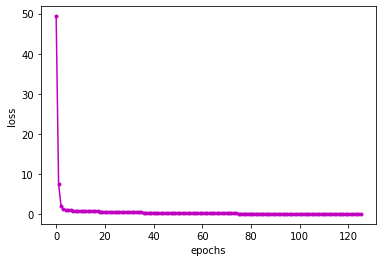

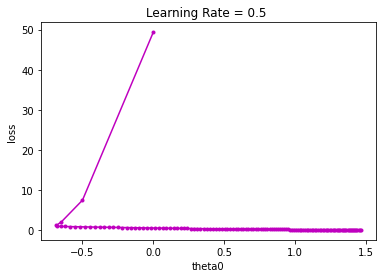

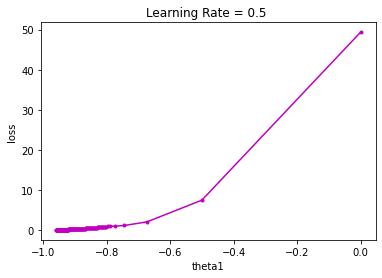

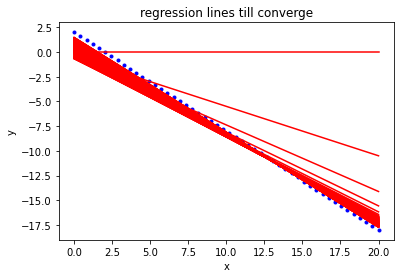

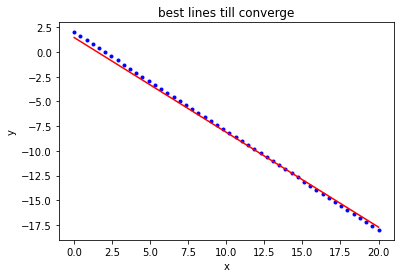

In [ ]:
r2_score(y,h_yhat3[-1])
plot(theta_0s3,theta_1s3,costs3,h_yhat3,lr3)

r2 score =  -1.4736441832884104


## RMSProp

### Update the previos implementation to be RMSProp.
#### Compare your results with Adagrad results.

In [ ]:
m=len(x)
def RMS (x,y,lr,E,it,beta):
    theta_0s=[0]
    theta_1s=[0]
    vt0=0.0
    vt1=0.0
    th0=0
    th1=0
    costs=[]
    h_yhat=[]
    
    for i in range (it):
        print(f'****************** Iteration {i} ********************\n')
    

        h_yhat.append(theta_0s[i] + theta_1s[i]*x) # calculate y predict (y hat)
        print (f'h(x):{h_yhat[i]}\n')

        errs=( h_yhat[i]-y) # sub y pre from y orginal
        print(f'Error Vector:{errs}\n') 
        
        costs.append(errs@errs/(m*2)) # j or loss or cost with MSE 
        print(f'j(mse):{costs[i]}\n')
        
        theta_0drv = (errs.sum())/m #j/theta0
        theta_1drv= ((errs*x).sum())/m # j/th1
        gradient_vec = np.array([[theta_0drv],[theta_1drv]])
        print(f'Gradient Vector:{gradient_vec}\n')

        gradient_vector_norm=np.linalg.norm(gradient_vec,2)
        print(f'Gradient Vector Norm:{gradient_vector_norm}\n') 
        
       
        
        if (gradient_vector_norm<.001  ):
            print('norm')
            break


        if i!=0 and abs(costs[i]-costs[i-1])< 0.001 :
            print('cost')
            break
            
        
        
        vt0 = beta*vt0 + (1-beta)*(theta_0drv)**2  
        vt1 = beta*vt1 + (1-beta)*(theta_1drv)**2  
        th0=th0 -((lr/(np.sqrt(vt0)+E))*theta_0drv)
        th1=th1 -((lr/(np.sqrt(vt1)+E))*theta_1drv)
            
        print(f'Vt0:{vt0}\nVt1: {vt1}')
        print(f'theta_0_new :{th0} \ntheta_1_new :{th1}')    
            
            
        if i!= (it-1) :

            theta_0s.append(th0) #update eq with nag
            theta_1s.append(th1)        
       
            
    if i != it-1:        #do not print if iter finshed
        print(f'\n\nGradient Descent converged after {i+1} epochs\n')
        print ((f'theta_0_Opt :{theta_0s[-1]} \ntheta_1_Opt:{theta_1s[-1]}\n'))
        print(f'Error Vector:{errs}\n')
        print(f'Cost :{costs[-1]}\n')
        print(f'h(x) = y_predict:{h_yhat[-1]}')
        print(f'y_actual:{y}')
    
    return theta_0s,theta_1s ,costs,h_yhat,lr


def plot(theta_0s,theta_1s ,costs,h_yhat,lr):
    plt.plot(costs,'.m-')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(theta_0s,costs,'.m-')
    plt.title(f'Learning Rate = {lr} ')
    plt.xlabel('theta0')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(theta_1s,costs,'.m-')
    plt.title(f'Learning Rate = {lr} ')
    plt.xlabel('theta1')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(x,y,'.b')
    for i in range( len(h_yhat)):
        plt.plot(x,h_yhat[i],'r')
    plt.title('regression lines till converge')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()
    
    plt.plot(x,y,'.b')
    plt.plot(x,h_yhat[-1],'r')
    plt.title('best lines till converge')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()

##### The following results uses alpha = 0.05, beta = 0.9, epsilon =  1e-08, and max. iterations = 500.

In [ ]:
theta_0s4,theta_1s4,costs4,h_yhat4,lr4= RMS(x,y,0.05,1e-08,500,.9)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

Vt0:6.400000000000001
Vt1: 1315.4685546639826
th


Error Vector:[-1.33507449 -1.29410752 -1.25314054 -1.21217356 -1.17120659 -1.13023961
 -1.08927264 -1.04830566 -1.00733869 -0.96637171 -0.92540474 -0.88443776
 -0.84347078 -0.80250381 -0.76153683 -0.72056986 -0.67960288 -0.63863591
 -0.59766893 -0.55670195 -0.51573498 -0.474768   -0.43380103 -0.39283405
 -0.35186708 -0.3109001  -0.26993312 -0.22896615 -0.18799917 -0.1470322
 -0.10606522 -0.06509825 -0.02413127  0.01683571  0.05780268  0.09876966
  0.13973663  0.18070361  0.22167058  0.26263756  0.30360454  0.34457151
  0.38553849  0.42650546  0.46747244  0.50843941  0.54940639  0.59037337
  0.63134034  0.67230732]

j(mse):0.22965980988639526

Gradient Vector:[[-0.33138359]
 [ 0.16835706]]

Gradient Vector Norm:0.3716977004059709

Vt0:0.19854437313994644
Vt1: 8.852365241560014
theta_0_new :0.7021108855200636 
theta_1_new :-0.9024601617528212
****************** Iteration 63 ********************

h(x):[  0.70211089   0.33375979  -0.03459129  -0.40294238  -0.77129346
  -1.13964455  -1.507

In [ ]:
r2_score(y,h_yhat4[-1])


0.9993224132935129

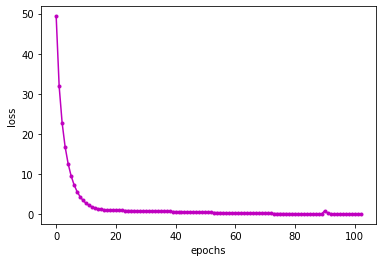

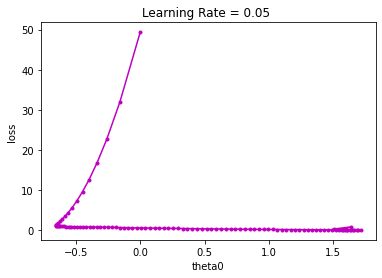

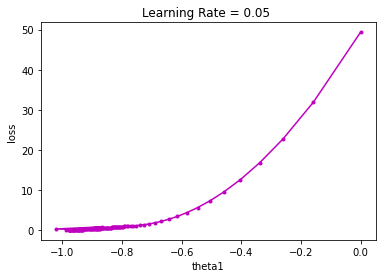

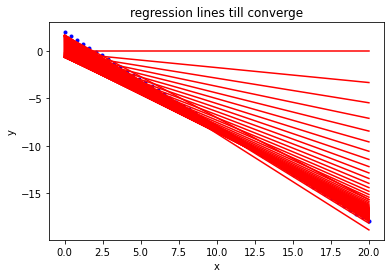

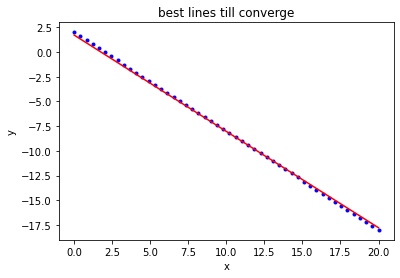

In [ ]:
r2_score(y,h_yhat4[-1])
plot(theta_0s4,theta_1s4,costs4,h_yhat4,lr4)

##### The following results uses alpha = 0.005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s5,theta_1s5,costs5,h_yhat5,lr5= RMS(x,y,0.005,1e-08,5000,.9)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

Vt0:6.400000000000001
Vt1: 1315.4685546639826
th


j(mse):13.559254496122117

Gradient Vector:[[ 3.75038435]
 [58.78443471]]

Gradient Vector Norm:58.903948479190646

Vt0:17.8644537574689
Vt1: 4224.731940662527
theta_0_new :-0.38786973627165744 
theta_1_new :-0.3911402754221205
****************** Iteration 74 ********************

h(x):[-0.38786974 -0.54751883 -0.70716792 -0.86681701 -1.0264661  -1.1861152
 -1.34576429 -1.50541338 -1.66506247 -1.82471157 -1.98436066 -2.14400975
 -2.30365884 -2.46330793 -2.62295702 -2.78260612 -2.94225521 -3.1019043
 -3.26155339 -3.42120248 -3.58085158 -3.74050067 -3.90014976 -4.05979885
 -4.21944795 -4.37909704 -4.53874613 -4.69839522 -4.85804431 -5.0176934
 -5.1773425  -5.33699159 -5.49664068 -5.65628977 -5.81593886 -5.97558796
 -6.13523705 -6.29488614 -6.45453523 -6.61418433 -6.77383342 -6.93348251
 -7.0931316  -7.25278069 -7.41242978 -7.57207888 -7.73172797 -7.89137706
 -8.05102615 -8.21067524]

Error Vector:[-2.38786974 -2.13935556 -1.89084139 -1.64232721 -1.39381304 -1.14529887
 -0.8967847  -0.64

Vt1: 367.95025012022825
theta_0_new :-0.671929685060395 
theta_1_new :-0.7046360269662327
****************** Iteration 149 ********************

h(x):[ -0.67192969  -0.95953623  -1.24714277  -1.53474931  -1.82235585
  -2.1099624   -2.39756893  -2.68517548  -2.97278202  -3.26038856
  -3.5479951   -3.83560164  -4.12320818  -4.41081473  -4.69842126
  -4.98602781  -5.27363435  -5.56124089  -5.84884744  -6.13645398
  -6.42406052  -6.71166706  -6.9992736   -7.28688014  -7.57448669
  -7.86209322  -8.14969977  -8.43730631  -8.72491285  -9.01251939
  -9.30012593  -9.58773247  -9.87533902 -10.16294556 -10.4505521
 -10.73815864 -11.02576518 -11.31337173 -11.60097827 -11.88858481
 -12.17619135 -12.46379789 -12.75140443 -13.03901098 -13.32661751
 -13.61422406 -13.9018306  -14.18943714 -14.47704368 -14.76465022]

Error Vector:[-2.67192969 -2.55137296 -2.43081624 -2.31025951 -2.18970279 -2.06914607
 -1.94858934 -1.82803262 -1.7074759  -1.58691917 -1.46636245 -1.34580572
 -1.225249   -1.10469228 -0.98


j(mse):0.706032636112794

Gradient Vector:[[-0.60005179]
 [ 0.04084514]]

Gradient Vector Norm:0.6014403352610037

Vt0:0.36733399372633385
Vt1: 0.28301917399389553
theta_0_new :-0.33643558337469537 
theta_1_new :-0.8262504806897709
****************** Iteration 228 ********************

h(x):[ -0.33643558  -0.67368068  -1.01092577  -1.34817087  -1.68541596
  -2.02266106  -2.35990615  -2.69715124  -3.03439633  -3.37164143
  -3.70888652  -4.04613162  -4.38337671  -4.72062181  -5.0578669
  -5.395112    -5.73235709  -6.06960218  -6.40684728  -6.74409237
  -7.08133747  -7.41858256  -7.75582766  -8.09307275  -8.43031785
  -8.76756294  -9.10480803  -9.44205312  -9.77929822 -10.11654331
 -10.45378841 -10.7910335  -11.1282786  -11.46552369 -11.80276878
 -12.14001388 -12.47725897 -12.81450407 -13.15174916 -13.48899426
 -13.82623935 -14.16348445 -14.50072954 -14.83797463 -15.17521972
 -15.51246482 -15.84970991 -16.18695501 -16.5242001  -16.8614452 ]

Error Vector:[-2.33643558 -2.26551741 -2.19459


Error Vector:[-2.09599309 -2.03235189 -1.9687107  -1.90506951 -1.84142832 -1.77778712
 -1.71414593 -1.65050474 -1.58686355 -1.52322235 -1.45958116 -1.39593997
 -1.33229878 -1.26865758 -1.20501639 -1.1413752  -1.077734   -1.01409281
 -0.95045162 -0.88681043 -0.82316923 -0.75952804 -0.69588685 -0.63224565
 -0.56860446 -0.50496327 -0.44132208 -0.37768088 -0.31403969 -0.2503985
 -0.18675731 -0.12311611 -0.05947492  0.00416627  0.06780747  0.13144866
  0.19508985  0.25873104  0.32237224  0.38601343  0.44965462  0.51329582
  0.57693701  0.6405782   0.70421939  0.76786059  0.83150178  0.89514297
  0.95878416  1.02242536]

j(mse):0.5657956814769133

Gradient Vector:[[-0.53678387]
 [ 0.04166273]]

Gradient Vector Norm:0.5383982737941987

Vt0:0.3009204478763768
Vt1: 0.07806788020441645
theta_0_new :-0.09110044425039465 
theta_1_new :-0.8448246358698135
****************** Iteration 278 ********************

h(x):[ -0.09110044  -0.43592683  -0.78075321  -1.12557959  -1.47040597
  -1.81523236  -2.


Vt0:0.23491606874158427
Vt1: 0.11842548036958514
theta_0_new :0.16789457360311566 
theta_1_new :-0.861339725004143
****************** Iteration 331 ********************

h(x):[  0.16789457  -0.18367267  -0.5352399   -0.88680713  -1.23837436
  -1.5899416   -1.94150883  -2.29307607  -2.6446433   -2.99621054
  -3.34777777  -3.69934501  -4.05091224  -4.40247948  -4.75404671
  -5.10561395  -5.45718118  -5.80874842  -6.16031565  -6.51188288
  -6.86345012  -7.21501735  -7.56658459  -7.91815182  -8.26971906
  -8.62128629  -8.97285353  -9.32442076  -9.675988   -10.02755523
 -10.37912247 -10.7306897  -11.08225694 -11.43382418 -11.78539141
 -12.13695864 -12.48852587 -12.84009311 -13.19166034 -13.54322758
 -13.89479481 -14.24636205 -14.59792928 -14.94949652 -15.30106375
 -15.65263099 -16.00419822 -16.35576546 -16.70733269 -17.05889993]

Error Vector:[-1.83210543 -1.7755094  -1.71891337 -1.66231733 -1.6057213  -1.54912527
 -1.49252924 -1.43593321 -1.37933718 -1.32274115 -1.26614512 -1.20954909
 -1


Error Vector:[-1.65227812 -1.60316651 -1.5540549  -1.50494329 -1.45583168 -1.40672007
 -1.35760847 -1.30849686 -1.25938525 -1.21027364 -1.16116203 -1.11205042
 -1.06293881 -1.0138272  -0.96471559 -0.91560398 -0.86649238 -0.81738077
 -0.76826916 -0.71915755 -0.67004594 -0.62093433 -0.57182272 -0.52271111
 -0.4735995  -0.42448789 -0.37537628 -0.32626468 -0.27715307 -0.22804146
 -0.17892985 -0.12981824 -0.08070663 -0.03159502  0.01751659  0.0666282
  0.11573981  0.16485142  0.21396302  0.26307463  0.31218624  0.36129785
  0.41040946  0.45952107  0.50863268  0.55774429  0.6068559   0.65596751
  0.70507911  0.75419072]

j(mse):0.35196443026691726

Gradient Vector:[[-0.4490437 ]
 [-0.31595021]]

Gradient Vector Norm:0.5490580848684542

Vt0:0.19105283829282277
Vt1: 0.11344355077667631
theta_0_new :0.3528585519126012 
theta_1_new :-0.8749862781346446
****************** Iteration 369 ********************

h(x):[ 3.52858552e-01 -4.27870858e-03 -3.61415960e-01 -7.18553221e-01
 -1.07569047e+00 -1


Gradient Vector:[[-0.34481992]
 [ 0.36331486]]

Gradient Vector Norm:0.5008976604638407

Vt0:0.1450746515814445
Vt1: 0.11535602828728349
theta_0_new :0.5610937534206993 
theta_1_new :-0.8954872253454157
****************** Iteration 412 ********************

h(x):[  0.56109375   0.19558876  -0.16991623  -0.53542122  -0.90092621
  -1.2664312   -1.63193618  -1.99744118  -2.36294616  -2.72845116
  -3.09395614  -3.45946114  -3.82496612  -4.19047112  -4.5559761
  -4.9214811   -5.28698608  -5.65249108  -6.01799607  -6.38350105
  -6.74900605  -7.11451103  -7.48001603  -7.84552101  -8.21102601
  -8.57653099  -8.94203599  -9.30754097  -9.67304597 -10.03855095
 -10.40405595 -10.76956093 -11.13506592 -11.50057092 -11.8660759
 -12.2315809  -12.59708588 -12.96259088 -13.32809586 -13.69360086
 -14.05910584 -14.42461084 -14.79011582 -15.15562082 -15.5211258
 -15.88663079 -16.25213578 -16.61764077 -16.98314576 -17.34865075]

Error Vector:[-1.43890625 -1.39624797 -1.3535897  -1.31093142 -1.26827315 -1.


Error Vector:[-1.17339753e+00 -1.13673960e+00 -1.10008167e+00 -1.06342374e+00
 -1.02676581e+00 -9.90107883e-01 -9.53449955e-01 -9.16792025e-01
 -8.80134097e-01 -8.43476168e-01 -8.06818240e-01 -7.70160311e-01
 -7.33502383e-01 -6.96844453e-01 -6.60186525e-01 -6.23528596e-01
 -5.86870668e-01 -5.50212739e-01 -5.13554810e-01 -4.76896881e-01
 -4.40238952e-01 -4.03581024e-01 -3.66923095e-01 -3.30265167e-01
 -2.93607238e-01 -2.56949309e-01 -2.20291380e-01 -1.83633452e-01
 -1.46975523e-01 -1.10317595e-01 -7.36596656e-02 -3.70017374e-02
 -3.43808289e-04  3.63141208e-02  7.29720490e-02  1.09629978e-01
  1.46287906e-01  1.82945836e-01  2.19603764e-01  2.56261693e-01
  2.92919621e-01  3.29577550e-01  3.66235478e-01  4.02893408e-01
  4.39551336e-01  4.76209265e-01  5.12867193e-01  5.49525122e-01
  5.86183050e-01  6.22840980e-01]

j(mse):0.1778126279661458

Gradient Vector:[[-0.27527827]
 [ 0.3631412 ]]

Gradient Vector Norm:0.45568592423547966

Vt0:0.09703440266004425
Vt1: 0.11552763694644927
theta

****************** Iteration 531 ********************

h(x):[ 1.13184958e+00  7.51095491e-01  3.70341409e-01 -1.04126825e-02
 -3.91166765e-01 -7.71920856e-01 -1.15267494e+00 -1.53342903e+00
 -1.91418311e+00 -2.29493720e+00 -2.67569129e+00 -3.05644538e+00
 -3.43719946e+00 -3.81795355e+00 -4.19870763e+00 -4.57946172e+00
 -4.96021581e+00 -5.34096990e+00 -5.72172399e+00 -6.10247807e+00
 -6.48323216e+00 -6.86398625e+00 -7.24474034e+00 -7.62549442e+00
 -8.00624851e+00 -8.38700259e+00 -8.76775668e+00 -9.14851077e+00
 -9.52926486e+00 -9.91001894e+00 -1.02907730e+01 -1.06715271e+01
 -1.10522812e+01 -1.14330353e+01 -1.18137894e+01 -1.21945435e+01
 -1.25752976e+01 -1.29560516e+01 -1.33368057e+01 -1.37175598e+01
 -1.40983139e+01 -1.44790680e+01 -1.48598221e+01 -1.52405762e+01
 -1.56213302e+01 -1.60020843e+01 -1.63828384e+01 -1.67635925e+01
 -1.71443466e+01 -1.75251007e+01]

Error Vector:[-0.86815042 -0.84074124 -0.81333206 -0.78592288 -0.7585137  -0.73110453
 -0.70369535 -0.67628617 -0.64887699 -0

In [ ]:
r2_score(y,h_yhat5[-1])

0.9948527108968

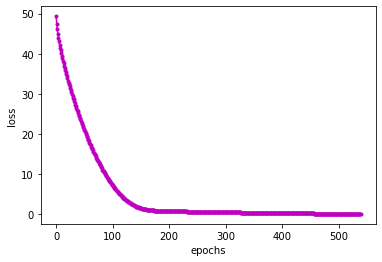

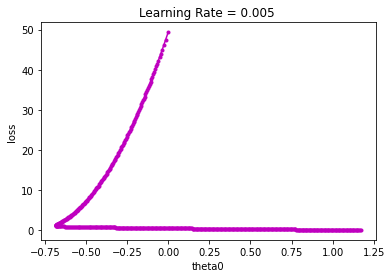

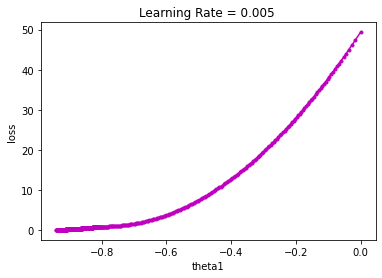

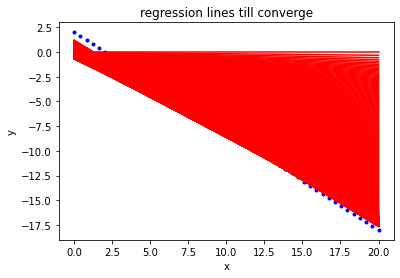

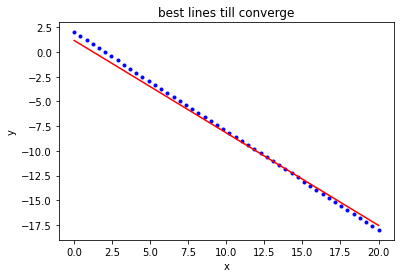

In [ ]:
r2_score(y,h_yhat5[-1])
plot(theta_0s5,theta_1s5,costs5,h_yhat5,lr5)

##### The following results uses alpha = 0.0005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s6,theta_1s6,costs6,h_yhat6,lr6= RMS(x,y,0.0005,1e-08,5000,.9)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

Vt0:6.400000000000001
Vt1: 1315.4685546639826
th


j(mse):45.80271783988519

Gradient Vector:[[  7.67620192]
 [110.43460589]]

Gradient Vector Norm:110.70106708280557

Vt0:59.396992302309506
Vt1: 12280.374396290663
theta_0_new :-0.02992400074358409 
theta_1_new :-0.029935483465889565
****************** Iteration 51 ********************

h(x):[-0.029924   -0.04214257 -0.05436113 -0.06657969 -0.07879826 -0.09101682
 -0.10323539 -0.11545395 -0.12767252 -0.13989108 -0.15210965 -0.16432821
 -0.17654678 -0.18876534 -0.20098391 -0.21320247 -0.22542104 -0.2376396
 -0.24985817 -0.26207673 -0.27429529 -0.28651386 -0.29873242 -0.31095099
 -0.32316955 -0.33538812 -0.34760668 -0.35982525 -0.37204381 -0.38426238
 -0.39648094 -0.40869951 -0.42091807 -0.43313664 -0.4453552  -0.45757376
 -0.46979233 -0.48201089 -0.49422946 -0.50644802 -0.51866659 -0.53088515
 -0.54310372 -0.55532228 -0.56754085 -0.57975941 -0.59197798 -0.60419654
 -0.61641511 -0.62863367]

Error Vector:[-2.029924   -1.6339793  -1.2380346  -0.84208989 -0.4461452  -0.05020049
  0.345744


Error Vector:[-2.06420869 -1.68226579 -1.30032291 -0.91838001 -0.53643713 -0.15449423
  0.22744865  0.60939155  0.99133444  1.37327733  1.75522022  2.13716311
  2.519106    2.90104889  3.28299178  3.66493467  4.04687756  4.42882046
  4.81076335  5.19270624  5.57464913  5.95659202  6.33853491  6.7204778
  7.10242069  7.48436358  7.86630648  8.24824936  8.63019226  9.01213514
  9.39407804  9.77602092 10.15796382 10.53990671 10.9218496  11.3037925
 11.68573538 12.06767828 12.44962116 12.83156406 13.21350694 13.59544984
 13.97739272 14.35933562 14.74127851 15.1232214  15.50516429 15.88710718
 16.26905007 16.65099296]

j(mse):41.78657815216288

Gradient Vector:[[  7.29339214]
 [105.39906709]]

Gradient Vector Norm:105.65110937442333

Vt0:53.91612247872033
Vt1: 11246.226985592953
theta_0_new :-0.06470532801893049 
theta_1_new :-0.06473685665362516
****************** Iteration 121 ********************

h(x):[-0.06470533 -0.09112854 -0.11755174 -0.14397495 -0.17039816 -0.19682136
 -0.22324457


Error Vector:[-2.10095287 -1.73401719 -1.36708152 -1.00014584 -0.63321017 -0.26627449
  0.10066118  0.46759686  0.83453253  1.20146822  1.56840389  1.93533957
  2.30227524  2.66921092  3.03614659  3.40308227  3.77001794  4.13695362
  4.5038893   4.87082497  5.23776066  5.60469633  5.97163201  6.33856768
  6.70550336  7.07243903  7.43937471  7.80631038  8.17324606  8.54018173
  8.90711742  9.27405309  9.64098877 10.00792445 10.37486012 10.7417958
 11.10873147 11.47566715 11.84260282 12.2095385  12.57647417 12.94340986
 13.31034553 13.67728121 14.04421688 14.41115256 14.77808823 15.14502391
 15.51195958 15.87889526]

j(mse):37.748538497079906

Gradient Vector:[[  6.8889712 ]
 [100.07924443]]

Gradient Vector Norm:100.31606595752945

Vt0:48.14063264472169
Vt1: 10146.226334389537
theta_0_new :-0.10144931500235317 
theta_1_new :-0.10150437050190014
****************** Iteration 195 ********************

h(x):[-0.10144932 -0.14287967 -0.18431003 -0.22574038 -0.26717074 -0.30860109
 -0.350031


j(mse):35.140010281652756

Gradient Vector:[[ 6.61579272]
 [96.48580296]]

Gradient Vector Norm:96.71235125665835

Vt0:44.42439295986806
Vt1: 9435.201658342674
theta_0_new :-0.12626775005007318 
theta_1_new :-0.1263402406655404
****************** Iteration 245 ********************

h(x):[-0.12626775 -0.1778352  -0.22940264 -0.28097009 -0.33253753 -0.38410498
 -0.43567242 -0.48723987 -0.53880731 -0.59037476 -0.6419422  -0.69350965
 -0.74507709 -0.79664454 -0.84821198 -0.89977943 -0.95134687 -1.00291432
 -1.05448176 -1.10604921 -1.15761665 -1.2091841  -1.26075154 -1.31231899
 -1.36388643 -1.41545388 -1.46702132 -1.51858877 -1.57015621 -1.62172366
 -1.67329111 -1.72485855 -1.776426   -1.82799344 -1.87956089 -1.93112833
 -1.98269578 -2.03426322 -2.08583067 -2.13739811 -2.18896556 -2.240533
 -2.29210045 -2.34366789 -2.39523534 -2.44680278 -2.49837023 -2.54993767
 -2.60150512 -2.65307256]

Error Vector:[-2.12626775e+00 -1.76967193e+00 -1.41307611e+00 -1.05648029e+00
 -6.99884471e-01 -3.4328

theta_1_new :-0.14918380273399112
****************** Iteration 291 ********************

h(x):[-0.14909403 -0.20998537 -0.27087672 -0.33176807 -0.39265942 -0.45355077
 -0.51444211 -0.57533346 -0.63622481 -0.69711616 -0.75800751 -0.81889885
 -0.8797902  -0.94068155 -1.0015729  -1.06246425 -1.12335559 -1.18424694
 -1.24513829 -1.30602964 -1.36692099 -1.42781233 -1.48870368 -1.54959503
 -1.61048638 -1.67137773 -1.73226908 -1.79316042 -1.85405177 -1.91494312
 -1.97583447 -2.03672581 -2.09761716 -2.15850851 -2.21939986 -2.28029121
 -2.34118256 -2.4020739  -2.46296525 -2.5238566  -2.58474795 -2.6456393
 -2.70653064 -2.76742199 -2.82831334 -2.88920469 -2.95009604 -3.01098738
 -3.07187873 -3.13277008]

Error Vector:[-2.14909403 -1.8018221  -1.45455019 -1.10727827 -0.76000636 -0.41273444
 -0.06546252  0.2818094   0.62908131  0.97635323  1.32362514  1.67089707
  2.01816898  2.3654409   2.71271281  3.05998473  3.40725665  3.75452857
  4.10180049  4.4490724   4.79634432  5.14361624  5.49088816  5.


j(mse):30.54518966827238

Gradient Vector:[[ 6.10786892]
 [89.80446452]]

Gradient Vector Norm:90.01193204569198

Vt0:37.911490324374974
Vt1: 8181.832266135638
theta_0_new :-0.1724093612400706 
theta_1_new :-0.1725181832103738
****************** Iteration 338 ********************

h(x):[-0.17240936 -0.24282495 -0.31324053 -0.38365612 -0.4540717  -0.52448729
 -0.59490287 -0.66531846 -0.73573404 -0.80614963 -0.87656521 -0.9469808
 -1.01739638 -1.08781197 -1.15822755 -1.22864314 -1.29905872 -1.36947431
 -1.43988989 -1.51030548 -1.58072106 -1.65113665 -1.72155223 -1.79196782
 -1.8623834  -1.93279899 -2.00321457 -2.07363016 -2.14404574 -2.21446133
 -2.28487691 -2.35529249 -2.42570808 -2.49612367 -2.56653925 -2.63695484
 -2.70737042 -2.77778601 -2.84820159 -2.91861718 -2.98903276 -3.05944835
 -3.12986393 -3.20027952 -3.2706951  -3.34111069 -3.41152627 -3.48194186
 -3.55235744 -3.62277303]

Error Vector:[-2.17240936 -1.83466168 -1.496914   -1.15916632 -0.82141864 -0.48367096
 -0.14592328  0.


Gradient Vector Norm:87.4911878260136

Vt0:35.59485924165736
Vt1: 7733.416602320453
theta_0_new :-0.18976678318452556 
theta_1_new :-0.18989079528547584
****************** Iteration 373 ********************

h(x):[-0.18976678 -0.26727323 -0.34477968 -0.42228613 -0.49979257 -0.57729902
 -0.65480547 -0.73231191 -0.80981836 -0.88732481 -0.96483125 -1.0423377
 -1.11984415 -1.1973506  -1.27485704 -1.35236349 -1.42986994 -1.50737638
 -1.58488283 -1.66238928 -1.73989573 -1.81740217 -1.89490862 -1.97241507
 -2.04992151 -2.12742796 -2.20493441 -2.28244085 -2.3599473  -2.43745375
 -2.51496019 -2.59246664 -2.66997309 -2.74747954 -2.82498598 -2.90249243
 -2.97999888 -3.05750532 -3.13501177 -3.21251822 -3.29002466 -3.36753111
 -3.44503756 -3.52254401 -3.60005045 -3.6775569  -3.75506335 -3.83256979
 -3.91007624 -3.98758269]

Error Vector:[-2.18976678 -1.85910996 -1.52845315 -1.19779633 -0.86713951 -0.53648269
 -0.20582588  0.12483095  0.45548776  0.78614458  1.1168014   1.44745822
  1.77811503  2.1


j(mse):27.307166707660684

Gradient Vector:[[ 5.72574093]
 [84.77785853]]

Gradient Vector Norm:84.970991560652

Vt0:33.35173378201045
Vt1: 7297.729556303786
theta_0_new :-0.20711957184420074 
theta_1_new :-0.20725972443131266
****************** Iteration 408 ********************

h(x):[-0.20711957 -0.29171538 -0.37631118 -0.46090699 -0.5455028  -0.6300986
 -0.71469441 -0.79929021 -0.88388602 -0.96848183 -1.05307763 -1.13767344
 -1.22226924 -1.30686505 -1.39146085 -1.47605666 -1.56065247 -1.64524827
 -1.72984408 -1.81443988 -1.89903569 -1.9836315  -2.0682273  -2.15282311
 -2.23741891 -2.32201472 -2.40661053 -2.49120633 -2.57580214 -2.66039794
 -2.74499375 -2.82958955 -2.91418536 -2.99878117 -3.08337697 -3.16797278
 -3.25256858 -3.33716439 -3.4217602  -3.506356   -3.59095181 -3.67554761
 -3.76014342 -3.84473923 -3.92933503 -4.01393084 -4.09852664 -4.18312245
 -4.26771825 -4.35231406]

Error Vector:[-2.20711957 -1.88355211 -1.55998465 -1.23641719 -0.91284974 -0.58928227
 -0.26571482  0.


Error Vector:[-2.22000703e+00 -1.90170493e+00 -1.58340283e+00 -1.26510072e+00
 -9.46798617e-01 -6.28496510e-01 -3.10194410e-01  8.10769823e-03
  3.26409798e-01  6.44711906e-01  9.63014006e-01  1.28131611e+00
  1.59961821e+00  1.91792032e+00  2.23622242e+00  2.55452453e+00
  2.87282663e+00  3.19112874e+00  3.50943085e+00  3.82773295e+00
  4.14603505e+00  4.46433715e+00  4.78263926e+00  5.10094136e+00
  5.41924347e+00  5.73754557e+00  6.05584768e+00  6.37414978e+00
  6.69245188e+00  7.01075398e+00  7.32905609e+00  7.64735819e+00
  7.96566030e+00  8.28396241e+00  8.60226451e+00  8.92056662e+00
  9.23886872e+00  9.55717082e+00  9.87547292e+00  1.01937750e+01
  1.05120771e+01  1.08303792e+01  1.11486813e+01  1.14669834e+01
  1.17852855e+01  1.21035877e+01  1.24218898e+01  1.27401919e+01
  1.30584940e+01  1.33767961e+01]

j(mse):26.108795097728517

Gradient Vector:[[ 5.57839452]
 [82.83962403]]

Gradient Vector Norm:83.02723526344165

Vt0:31.671534235524472
Vt1: 6970.32339095775
theta_0_new


j(mse):24.639777431155906

Gradient Vector:[[ 5.39288624]
 [80.39939507]]

Gradient Vector Norm:80.58005925326779

Vt0:29.617920864500697
Vt1: 6568.804869103688
theta_0_new :-0.23735098579190697 
theta_1_new :-0.23752182140477657
****************** Iteration 469 ********************

h(x):[-0.23735099 -0.33429867 -0.43124635 -0.52819403 -0.62514171 -0.7220894
 -0.81903708 -0.91598476 -1.01293244 -1.10988013 -1.20682781 -1.30377549
 -1.40072317 -1.49767085 -1.59461854 -1.69156622 -1.7885139  -1.88546158
 -1.98240927 -2.07935695 -2.17630463 -2.27325231 -2.3702     -2.46714768
 -2.56409536 -2.66104304 -2.75799072 -2.8549384  -2.95188609 -3.04883377
 -3.14578145 -3.24272913 -3.33967682 -3.4366245  -3.53357218 -3.63051986
 -3.72746754 -3.82441523 -3.92136291 -4.01831059 -4.11525827 -4.21220596
 -4.30915364 -4.40610132 -4.503049   -4.59999669 -4.69694437 -4.79389205
 -4.89083973 -4.98778741]

Error Vector:[-2.23735099 -1.9261354  -1.61491982 -1.30370423 -0.99248865 -0.68127307
 -0.37005749 

Vt1: 6179.2904083661115
theta_0_new :-0.2541940726579479 
theta_1_new :-0.25438359664658283
****************** Iteration 503 ********************

h(x):[-0.25419407 -0.35802411 -0.46185415 -0.56568419 -0.66951423 -0.77334427
 -0.87717431 -0.98100435 -1.08483439 -1.18866443 -1.29249447 -1.39632451
 -1.50015455 -1.60398459 -1.70781462 -1.81164466 -1.9154747  -2.01930474
 -2.12313478 -2.22696482 -2.33079486 -2.4346249  -2.53845494 -2.64228498
 -2.74611502 -2.84994506 -2.9537751  -3.05760514 -3.16143518 -3.26526522
 -3.36909526 -3.47292529 -3.57675534 -3.68058538 -3.78441541 -3.88824545
 -3.99207549 -4.09590553 -4.19973557 -4.30356561 -4.40739565 -4.51122569
 -4.61505573 -4.71888577 -4.82271581 -4.92654585 -5.03037589 -5.13420593
 -5.23803596 -5.34186601]

Error Vector:[-2.25419407 -1.94986084 -1.64552762 -1.34119439 -1.03686117 -0.73252794
 -0.42819472 -0.12386149  0.18047173  0.48480496  0.78913818  1.09347141
  1.39780463  1.70213786  2.00647109  2.31080432  2.61513754  2.91947077
  3.2


j(mse):21.835613689463734

Gradient Vector:[[ 5.02201073]
 [75.52078107]]

Gradient Vector Norm:75.6875747063985

Vt0:25.71860752820229
Vt1: 5801.777000626173
theta_0_new :-0.2710315334056256 
theta_1_new :-0.27124102901604313
****************** Iteration 537 ********************

h(x):[-0.27103153 -0.38174216 -0.49245278 -0.60316341 -0.71387403 -0.82458465
 -0.93529528 -1.0460059  -1.15671653 -1.26742715 -1.37813777 -1.4888484
 -1.59955902 -1.71026965 -1.82098027 -1.93169089 -2.04240152 -2.15311214
 -2.26382277 -2.37453339 -2.48524402 -2.59595464 -2.70666526 -2.81737589
 -2.92808651 -3.03879713 -3.14950776 -3.26021838 -3.37092901 -3.48163963
 -3.59235026 -3.70306088 -3.8137715  -3.92448213 -4.03519275 -4.14590338
 -4.256614   -4.36732463 -4.47803525 -4.58874587 -4.6994565  -4.81016712
 -4.92087774 -5.03158837 -5.14229899 -5.25300962 -5.36372024 -5.47443087
 -5.58514149 -5.69585211]

Error Vector:[-2.27103153 -1.97357889 -1.67612625 -1.37867361 -1.08122097 -0.78376832
 -0.48631569 -0.


j(mse):19.35938294830787

Gradient Vector:[[ 4.67314188]
 [70.9316332 ]]

Gradient Vector Norm:71.08540527470048

Vt0:22.301768393753843
Vt1: 5123.708623467666
theta_0_new :-0.30270881296908736 
theta_1_new :-0.30295987884385994
****************** Iteration 601 ********************

h(x):[-0.30270881 -0.42636591 -0.550023   -0.67368009 -0.79733719 -0.92099428
 -1.04465137 -1.16830847 -1.29196556 -1.41562265 -1.53927975 -1.66293684
 -1.78659393 -1.91025103 -2.03390812 -2.15756521 -2.28122231 -2.4048794
 -2.5285365  -2.65219359 -2.77585068 -2.89950777 -3.02316487 -3.14682196
 -3.27047906 -3.39413615 -3.51779324 -3.64145033 -3.76510743 -3.88876452
 -4.01242162 -4.13607871 -4.2597358  -4.3833929  -4.50704999 -4.63070708
 -4.75436418 -4.87802127 -5.00167836 -5.12533546 -5.24899255 -5.37264964
 -5.49630674 -5.61996383 -5.74362092 -5.86727802 -5.99093511 -6.1145922
 -6.2382493  -6.36190639]

Error Vector:[-2.30270881 -2.01820264 -1.73369647 -1.44919029 -1.16468413 -0.88017795
 -0.59567178 -0

j(mse):17.006132399573392

Gradient Vector:[[ 4.31903694]
 [66.27358796]]

Gradient Vector Norm:66.41417424902137

Vt0:19.08257816936786
Vt1: 4478.534108564321
theta_0_new :-0.33485571976625117 
theta_1_new :-0.33515532638159706
****************** Iteration 666 ********************

h(x):[-0.33485572 -0.47165381 -0.6084519  -0.74525    -0.88204809 -1.01884618
 -1.15564427 -1.29244237 -1.42924046 -1.56603855 -1.70283664 -1.83963474
 -1.97643283 -2.11323092 -2.25002901 -2.38682711 -2.5236252  -2.66042329
 -2.79722138 -2.93401948 -3.07081757 -3.20761566 -3.34441375 -3.48121184
 -3.61800994 -3.75480803 -3.89160612 -4.02840421 -4.16520231 -4.3020004
 -4.43879849 -4.57559658 -4.71239468 -4.84919277 -4.98599086 -5.12278896
 -5.25958705 -5.39638514 -5.53318323 -5.66998132 -5.80677942 -5.94357751
 -6.0803756  -6.21717369 -6.35397178 -6.49076988 -6.62756797 -6.76436606
 -6.90116415 -7.03796225]

Error Vector:[-2.33485572 -2.06349054 -1.79212537 -1.5207602  -1.24939503 -0.97802985
 -0.70666468 -0

Vt1: 3993.9305310594914
theta_0_new :-0.3605520300362774 
theta_1_new :-0.36089607965805626
****************** Iteration 718 ********************

h(x):[-0.36055203 -0.50785655 -0.65516107 -0.8024656  -0.94977012 -1.09707464
 -1.24437916 -1.39168369 -1.53898821 -1.68629273 -1.83359725 -1.98090178
 -2.1282063  -2.27551082 -2.42281534 -2.57011986 -2.71742439 -2.86472891
 -3.01203343 -3.15933795 -3.30664248 -3.453947   -3.60125152 -3.74855604
 -3.89586057 -4.04316509 -4.19046961 -4.33777413 -4.48507866 -4.63238318
 -4.7796877  -4.92699222 -5.07429674 -5.22160127 -5.36890579 -5.51621031
 -5.66351483 -5.81081936 -5.95812388 -6.1054284  -6.25273292 -6.40003745
 -6.54734197 -6.69464649 -6.84195101 -6.98925553 -7.13656005 -7.28386458
 -7.4311691  -7.57847362]

Error Vector:[-2.36055203 -2.09969328 -1.83883454 -1.5779758  -1.31711706 -1.05625831
 -0.79539957 -0.53454083 -0.27368209 -0.01282334  0.2480354   0.50889414
  0.76975288  1.03061163  1.29147037  1.55232912  1.81318785  2.0740466
  2.33


Vt0:15.296771851258352
Vt1: 3709.638488910046
theta_0_new :-0.37635451855452584 
theta_1_new :-0.37672887080753276
****************** Iteration 750 ********************

h(x):[-0.37635452 -0.53012141 -0.68388829 -0.83765518 -0.99142206 -1.14518895
 -1.29895583 -1.45272272 -1.60648961 -1.76025649 -1.91402338 -2.06779027
 -2.22155715 -2.37532404 -2.52909092 -2.68285781 -2.83662469 -2.99039158
 -3.14415847 -3.29792535 -3.45169224 -3.60545912 -3.75922601 -3.9129929
 -4.06675978 -4.22052667 -4.37429356 -4.52806044 -4.68182733 -4.83559421
 -4.9893611  -5.14312798 -5.29689487 -5.45066176 -5.60442864 -5.75819553
 -5.91196242 -6.0657293  -6.21949619 -6.37326308 -6.52702996 -6.68079685
 -6.83456373 -6.98833062 -7.1420975  -7.29586439 -7.44963128 -7.60339816
 -7.75716505 -7.91093193]

Error Vector:[-2.37635452 -2.12195814 -1.86756176 -1.61316538 -1.358769   -1.10437262
 -0.84997624 -0.59557986 -0.34118349 -0.0867871   0.16760927  0.42200565
  0.67640203  0.93079841  1.18519479  1.43959117  1.693


Error Vector:[-2.3960949  -2.14977279 -1.90345068 -1.65712857 -1.41080646 -1.16448435
 -0.91816224 -0.67184013 -0.42551802 -0.17919591  0.0671262   0.31344831
  0.55977042  0.80609254  1.05241464  1.29873676  1.54505886  1.79138098
  2.03770309  2.2840252   2.53034731  2.77666942  3.02299153  3.26931364
  3.51563575  3.76195786  4.00827997  4.25460208  4.5009242   4.7472463
  4.99356842  5.23989052  5.48621264  5.73253475  5.97885686  6.22517897
  6.47150108  6.71782319  6.9641453   7.21046741  7.45678952  7.70311163
  7.94943374  8.19575586  8.44207796  8.68840008  8.93472218  9.1810443
  9.4273664   9.67368852]

j(mse):12.938161971797303

Gradient Vector:[[ 3.63879681]
 [57.32534747]]

Gradient Vector Norm:57.44071992263811

Vt0:13.602093790441367
Vt1: 3360.887131935857
theta_0_new :-0.3965882189104599 
theta_1_new :-0.3970052417822071
****************** Iteration 791 ********************

h(x):[-0.39658822 -0.55863118 -0.72067413 -0.88271709 -1.04476004 -1.206803
 -1.36884595 -1.53


j(mse):11.964565014288873

Gradient Vector:[[ 3.45940371]
 [54.96549333]]

Gradient Vector Norm:55.074249256774095

Vt0:12.310996485235183
Vt1: 3092.823626543928
theta_0_new :-0.4128619329693616 
theta_1_new :-0.41331690992560105
****************** Iteration 824 ********************

h(x):[-0.41286193 -0.58156271 -0.75026349 -0.91896427 -1.08766505 -1.25636583
 -1.42506661 -1.59376739 -1.76246817 -1.93116895 -2.09986973 -2.26857051
 -2.43727129 -2.60597207 -2.77467285 -2.94337363 -3.1120744  -3.28077519
 -3.44947597 -3.61817674 -3.78687753 -3.9555783  -4.12427908 -4.29297986
 -4.46168064 -4.63038142 -4.7990822  -4.96778298 -5.13648376 -5.30518454
 -5.47388532 -5.6425861  -5.81128688 -5.97998766 -6.14868844 -6.31738922
 -6.48609    -6.65479078 -6.82349156 -6.99219234 -7.16089311 -7.3295939
 -7.49829467 -7.66699545 -7.83569623 -8.00439701 -8.17309779 -8.34179857
 -8.51049935 -8.67920013]

Error Vector:[-2.41286193 -2.17339944 -1.93393696 -1.69447447 -1.45501199 -1.2155495
 -0.97608702 -


j(mse):10.275121126044706

Gradient Vector:[[ 3.12804912]
 [50.60660582]]

Gradient Vector Norm:50.703187706856816

Vt0:10.095473752612847
Vt1: 2626.9695360268875
theta_0_new :-0.4429114633536028 
theta_1_new :-0.44344685097774983
****************** Iteration 885 ********************

h(x):[-0.44291146 -0.62391018 -0.80490889 -0.98590761 -1.16690632 -1.34790504
 -1.52890375 -1.70990247 -1.89090118 -2.0718999  -2.25289861 -2.43389733
 -2.61489604 -2.79589475 -2.97689347 -3.15789218 -3.3388909  -3.51988961
 -3.70088833 -3.88188704 -4.06288576 -4.24388447 -4.42488319 -4.6058819
 -4.78688062 -4.96787933 -5.14887805 -5.32987676 -5.51087548 -5.69187419
 -5.8728729  -6.05387162 -6.23487033 -6.41586905 -6.59686776 -6.77786648
 -6.95886519 -7.13986391 -7.32086262 -7.50186134 -7.68286005 -7.86385877
 -8.04485748 -8.2258562  -8.40685491 -8.58785362 -8.76885234 -8.94985105
 -9.13084977 -9.31184848]

Error Vector:[-2.44291146 -2.21574691 -1.98858236 -1.76141781 -1.53425326 -1.30708871
 -1.07992416


j(mse):9.37031491849731

Gradient Vector:[[ 2.93809288]
 [48.10775563]]

Gradient Vector Norm:48.19739143465444

Vt0:8.924408403566408
Vt1: 2377.042444665482
theta_0_new :-0.4601313122395543 
theta_1_new :-0.4607201190517338
****************** Iteration 920 ********************

h(x):[-0.46013131 -0.64818034 -0.83622937 -1.0242784  -1.21232742 -1.40037645
 -1.58842548 -1.77647451 -1.96452354 -2.15257257 -2.34062159 -2.52867062
 -2.71671965 -2.90476868 -3.0928177  -3.28086674 -3.46891576 -3.65696479
 -3.84501382 -4.03306285 -4.22111188 -4.4091609  -4.59720993 -4.78525896
 -4.97330799 -5.16135702 -5.34940605 -5.53745507 -5.7255041  -5.91355313
 -6.10160216 -6.28965118 -6.47770021 -6.66574924 -6.85379827 -7.0418473
 -7.22989633 -7.41794536 -7.60599438 -7.79404341 -7.98209244 -8.17014147
 -8.35819049 -8.54623953 -8.73428855 -8.92233758 -9.11038661 -9.29843564
 -9.48648466 -9.67453369]

Error Vector:[-2.46013131 -2.24001707 -2.01990284 -1.7997886  -1.57967436 -1.35956012
 -1.13944589 -0.91


Error Vector:[-2.48322575 -2.27257136 -2.06191698 -1.8512626  -1.64060822 -1.42995384
 -1.21929946 -1.00864508 -0.7979907  -0.58733632 -0.37668194 -0.16602755
  0.04462682  0.25528121  0.46593559  0.67658997  0.88724435  1.09789873
  1.30855311  1.51920749  1.72986187  1.94051625  2.15117064  2.36182501
  2.5724794   2.78313378  2.99378816  3.20444254  3.41509692  3.6257513
  3.83640568  4.04706006  4.25771444  4.46836883  4.6790232   4.88967759
  5.10033197  5.31098635  5.52164073  5.73229511  5.94294949  6.15360387
  6.36425825  6.57491263  6.78556701  6.9962214   7.20687577  7.41753016
  7.62818453  7.83883892]

j(mse):8.205898856866241

Gradient Vector:[[ 2.67780659]
 [44.68368824]]

Gradient Vector Norm:44.76385419880038

Vt0:7.436963057153786
Vt1: 2054.858386651134
theta_0_new :-0.4837167111019051 
theta_1_new :-0.4843896319317538
****************** Iteration 968 ********************

h(x):[ -0.48371671  -0.68142677  -0.87913682  -1.07684687  -1.27455693
  -1.47226698  -1.669977


j(mse):7.634429100408247

Gradient Vector:[[ 2.54235603]
 [42.90181665]]

Gradient Vector Norm:42.977080477007114

Vt0:6.716517085072875
Vt1: 1896.4712702835507
theta_0_new :-0.49598483306356117 
theta_1_new :-0.4967075385560959
****************** Iteration 993 ********************

h(x):[ -0.49598483  -0.69872261  -0.90146037  -1.10419815  -1.30693592
  -1.50967369  -1.71241146  -1.91514923  -2.117887    -2.32062477
  -2.52336254  -2.72610031  -2.92883808  -3.13157585  -3.33431362
  -3.5370514   -3.73978916  -3.94252694  -4.14526471  -4.34800248
  -4.55074025  -4.75347802  -4.95621579  -5.15895356  -5.36169133
  -5.5644291   -5.76716688  -5.96990464  -6.17264242  -6.37538019
  -6.57811796  -6.78085573  -6.9835935   -7.18633127  -7.38906904
  -7.59180681  -7.79454458  -7.99728236  -8.20002012  -8.4027579
  -8.60549567  -8.80823344  -9.01097121  -9.21370898  -9.41644675
  -9.61918452  -9.82192229 -10.02466006 -10.22739783 -10.4301356 ]

Error Vector:[-2.49598483 -2.29055934 -2.08513384


j(mse):6.604331746317635

Gradient Vector:[[ 2.28254358]
 [39.48390124]]

Gradient Vector Norm:39.54982252741792

Vt0:5.437307833350865
Vt1: 1610.4316223491921
theta_0_new :-0.5195035614763103 
theta_1_new :-0.5203361777604277
****************** Iteration 1041 ********************

h(x):[ -0.51950356  -0.73188568  -0.94426779  -1.1566499   -1.36903201
  -1.58141413  -1.79379624  -2.00617836  -2.21856047  -2.43094258
  -2.64332469  -2.85570681  -3.06808892  -3.28047104  -3.49285315
  -3.70523526  -3.91761737  -4.12999949  -4.3423816   -4.55476372
  -4.76714583  -4.97952794  -5.19191006  -5.40429217  -5.61667428
  -5.82905639  -6.04143851  -6.25382062  -6.46620274  -6.67858485
  -6.89096696  -7.10334907  -7.31573119  -7.52811331  -7.74049542
  -7.95287753  -8.16525964  -8.37764176  -8.59002387  -8.80240598
  -9.0147881   -9.22717021  -9.43955232  -9.65193444  -9.86431655
 -10.07669866 -10.28908077 -10.50146289 -10.713845   -10.92622712]

Error Vector:[-2.51950356 -2.32372241 -2.12794126


Error Vector:[-2.5444296  -2.35888083 -2.17333206 -1.98778329 -1.80223453 -1.61668576
 -1.43113699 -1.24558822 -1.06003945 -0.87449068 -0.68894191 -0.50339314
 -0.31784438 -0.13229561  0.05325316  0.23880193  0.4243507   0.60989947
  0.79544824  0.98099701  1.16654578  1.35209454  1.53764332  1.72319208
  1.90874085  2.09428962  2.27983839  2.46538716  2.65093593  2.83648469
  3.02203347  3.20758223  3.393131    3.57867977  3.76422854  3.94977731
  4.13532608  4.32087485  4.50642362  4.69197239  4.87752115  5.06306992
  5.24861869  5.43416746  5.61971623  5.805265    5.99081377  6.17636254
  6.3619113   6.54746007]

j(mse):5.58788310937492

Gradient Vector:[[ 2.00151524]
 [35.78679772]]

Gradient Vector Norm:35.84272526053908

Vt0:4.205648599356941
Vt1: 1327.3317627194936
theta_0_new :-0.5449175926696073 
theta_1_new :-0.5458966537561101
****************** Iteration 1093 ********************

h(x):[ -0.54491759  -0.76773256  -0.99054751  -1.21336248  -1.43617743
  -1.6589924   -1.8818


j(mse):4.75804100934249

Gradient Vector:[[ 1.74797917]
 [32.45126552]]

Gradient Vector Norm:32.49830864698067

Vt0:3.230030172368275
Vt1: 1095.3757353770752
theta_0_new :-0.56781430627621 
theta_1_new :-0.5689595354840273
****************** Iteration 1140 ********************

h(x):[ -0.56781431  -0.80004269  -1.03227107  -1.26449945  -1.49672783
  -1.72895622  -1.9611846   -2.19341298  -2.42564136  -2.65786974
  -2.89009812  -3.12232651  -3.35455489  -3.58678327  -3.81901165
  -4.05124003  -4.28346841  -4.5156968   -4.74792518  -4.98015356
  -5.21238195  -5.44461032  -5.67683871  -5.90906709  -6.14129547
  -6.37352385  -6.60575224  -6.83798061  -7.070209    -7.30243738
  -7.53466576  -7.76689414  -7.99912252  -8.23135091  -8.46357929
  -8.69580767  -8.92803605  -9.16026444  -9.39249281  -9.6247212
  -9.85694958 -10.08917796 -10.32140634 -10.55363473 -10.7858631
 -11.01809149 -11.25031987 -11.48254825 -11.71477663 -11.94700502]

Error Vector:[-2.56781431 -2.39187942 -2.21594454 -2.0


Error Vector:[-2.58480689 -2.41587002 -2.24693315 -2.07799628 -1.90905941 -1.74012254
 -1.57118567 -1.4022488  -1.23331193 -1.06437506 -0.89543819 -0.72650132
 -0.55756446 -0.38862758 -0.21969072 -0.05075385  0.11818302  0.28711989
  0.45605676  0.62499363  0.7939305   0.96286737  1.13180424  1.30074111
  1.46967798  1.63861485  1.80755172  1.97648859  2.14542546  2.31436233
  2.4832992   2.65223606  2.82117294  2.99010981  3.15904667  3.32798355
  3.49692041  3.66585728  3.83479415  4.00373102  4.17266789  4.34160476
  4.51054163  4.6794785   4.84841537  5.01735224  5.18628911  5.35522598
  5.52416285  5.69309972]

j(mse):4.179378246725454

Gradient Vector:[[ 1.55414641]
 [29.90109805]]

Gradient Vector Norm:29.9414601431816

Vt0:2.570883809032708
Vt1: 933.0437515958585
theta_0_new :-0.5852915293221366 
theta_1_new :-0.5865941173160727
****************** Iteration 1176 ********************

h(x):[ -0.58529153  -0.8247177   -1.06414387  -1.30357004  -1.54299621
  -1.78242238  -2.02184


j(mse):3.749098975314165

Gradient Vector:[[ 1.39827706]
 [27.85031649]]

Gradient Vector Norm:27.88539595100735

Vt0:2.0953562886638353
Vt1: 811.9355038825887
theta_0_new :-0.5993221124868654 
theta_1_new :-0.6007770784442861
****************** Iteration 1205 ********************

h(x):[ -0.59932211  -0.84453725  -1.08975238  -1.33496752  -1.58018265
  -1.82539778  -2.07061292  -2.31582805  -2.56104318  -2.80625832
  -3.05147345  -3.29668859  -3.54190372  -3.78711886  -4.03233399
  -4.27754912  -4.52276425  -4.76797939  -5.01319453  -5.25840966
  -5.5036248   -5.74883993  -5.99405506  -6.23927019  -6.48448533
  -6.72970046  -6.9749156   -7.22013073  -7.46534587  -7.710561
  -7.95577613  -8.20099127  -8.4462064   -8.69142154  -8.93663667
  -9.18185181  -9.42706694  -9.67228207  -9.91749721 -10.16271234
 -10.40792747 -10.65314261 -10.89835774 -11.14357288 -11.38878801
 -11.63400315 -11.87921828 -12.12443341 -12.36964854 -12.61486368]

Error Vector:[-2.59932211 -2.43637398 -2.27342585 -


Error Vector:[-2.61426064 -2.4574901  -2.30071957 -2.14394903 -1.9871785  -1.83040797
 -1.67363744 -1.5168669  -1.36009637 -1.20332583 -1.0465553  -0.88978476
 -0.73301423 -0.5762437  -0.41947317 -0.26270263 -0.1059321   0.05083844
  0.20760897  0.3643795   0.52115004  0.67792057  0.83469111  0.99146164
  1.14823218  1.30500271  1.46177324  1.61854377  1.77531431  1.93208484
  2.08885538  2.24562591  2.40239645  2.55916698  2.71593751  2.87270805
  3.02947858  3.18624912  3.34301965  3.49979018  3.65656072  3.81333125
  3.97010178  4.12687232  4.28364285  4.44041339  4.59718392  4.75395445
  4.91072499  5.06749552]

j(mse):3.3113753286063288

Gradient Vector:[[ 1.22661744]
 [25.59166979]]

Gradient Vector Norm:25.62104902415539

Vt0:1.627895936484161
Vt1: 688.2846987352777
theta_0_new :-0.6147413289330065 
theta_1_new :-0.6163999277610915
****************** Iteration 1237 ********************

h(x):[ -0.61474133  -0.86633314  -1.11792494  -1.36951675  -1.62110856
  -1.87270037  -2.124


Error Vector:[-2.62912066 -2.47851495 -2.32790924 -2.17730353 -2.02669783 -1.87609211
 -1.72548641 -1.5748807  -1.42427499 -1.27366928 -1.12306357 -0.97245786
 -0.82185216 -0.67124645 -0.52064074 -0.37003503 -0.21942932 -0.06882361
  0.0817821   0.23238781  0.38299352  0.53359922  0.68420493  0.83481064
  0.98541635  1.13602206  1.28662777  1.43723348  1.58783919  1.73844489
  1.8890506   2.03965631  2.19026202  2.34086773  2.49147344  2.64207915
  2.79268486  2.94329057  3.09389627  3.24450198  3.39510769  3.5457134
  3.69631911  3.84692482  3.99753053  4.14813624  4.29874194  4.44934765
  4.59995336  4.75055907]

j(mse):2.924334145984777

Gradient Vector:[[ 1.06071921]
 [23.4086773 ]]

Gradient Vector Norm:23.432697202027796

Vt0:1.2321460731068514
Vt1: 578.4707837825508
theta_0_new :-0.6295984522255169 
theta_1_new :-0.631502651642203
****************** Iteration 1268 ********************

h(x):[ -0.62959845  -0.88735464  -1.14511082  -1.40286701  -1.66062319
  -1.91837938  -2.1761


Vt0:0.9126007083779956
Vt1: 484.6081354973089
theta_0_new :-0.6434027327580455 
theta_1_new :-0.645597409257137
****************** Iteration 1297 ********************

h(x):[ -0.64340273  -0.90691188  -1.17042103  -1.43393018  -1.69743932
  -1.96094847  -2.22445761  -2.48796676  -2.7514759   -3.01498505
  -3.2784942   -3.54200335  -3.80551249  -4.06902164  -4.33253078
  -4.59603993  -4.85954908  -5.12305823  -5.38656738  -5.65007652
  -5.91358567  -6.17709481  -6.44060396  -6.7041131   -6.96762225
  -7.2311314   -7.49464055  -7.75814969  -8.02165884  -8.28516798
  -8.54867713  -8.81218628  -9.07569543  -9.33920457  -9.60271372
  -9.86622287 -10.12973201 -10.39324116 -10.6567503  -10.92025945
 -11.1837686  -11.44727775 -11.71078689 -11.97429604 -12.23780518
 -12.50131433 -12.76482348 -13.02833263 -13.29184177 -13.55535092]

Error Vector:[-2.64340273 -2.49874861 -2.3540945  -2.20944038 -2.06478626 -1.92013214
 -1.77547802 -1.6308239  -1.48616978 -1.34151566 -1.19686155 -1.05220743
 -0.9

****************** Iteration 1329 ********************

h(x):[ -0.65848878  -0.92832758  -1.19816636  -1.46800516  -1.73784394
  -2.00768273  -2.27752152  -2.54736031  -2.8171991   -3.08703789
  -3.35687668  -3.62671547  -3.89655426  -4.16639305  -4.43623184
  -4.70607063  -4.97590942  -5.24574821  -5.515587    -5.78542579
  -6.05526458  -6.32510337  -6.59494216  -6.86478095  -7.13461974
  -7.40445853  -7.67429732  -7.94413611  -8.2139749   -8.48381369
  -8.75365248  -9.02349126  -9.29333006  -9.56316885  -9.83300764
 -10.10284643 -10.37268522 -10.64252401 -10.9123628  -11.18220159
 -11.45204037 -11.72187917 -11.99171795 -12.26155675 -12.53139553
 -12.80123433 -13.07107311 -13.34091191 -13.61075069 -13.88058948]

Error Vector:[-2.65848878 -2.52016431 -2.38183983 -2.24351536 -2.10519088 -1.9668664
 -1.82854193 -1.69021745 -1.55189298 -1.4135685  -1.27524403 -1.13691955
 -0.99859508 -0.8602706  -0.72194613 -0.58362165 -0.44529718 -0.3069727
 -0.16864822 -0.03032375  0.10800073  0.2463252


Gradient Vector Norm:16.841984749153635

Vt0:0.3730169093626744
Vt1: 305.2545309305374
theta_0_new :-0.6738068166585032 
theta_1_new :-0.6770363548671936
****************** Iteration 1362 ********************

h(x):[ -0.67380682  -0.95014819  -1.22648955  -1.50283093  -1.77917229
  -2.05551367  -2.33185503  -2.6081964   -2.88453777  -3.16087914
  -3.43722051  -3.71356188  -3.98990325  -4.26624462  -4.54258598
  -4.81892736  -5.09526872  -5.3716101   -5.64795147  -5.92429283
  -6.20063421  -6.47697557  -6.75331694  -7.02965831  -7.30599968
  -7.58234105  -7.85868242  -8.13502379  -8.41136516  -8.68770652
  -8.9640479   -9.24038926  -9.51673064  -9.79307201 -10.06941337
 -10.34575475 -10.62209611 -10.89843748 -11.17477885 -11.45112022
 -11.72746159 -12.00380296 -12.28014433 -12.5564857  -12.83282706
 -13.10916844 -13.3855098  -13.66185118 -13.93819254 -14.21453391]

Error Vector:[-2.67380682 -2.54198492 -2.41016302 -2.27834113 -2.14651923 -2.01469734
 -1.88287544 -1.75105354 -1.61923165


j(mse):1.688072818418458

Gradient Vector:[[ 0.36670057]
 [14.27201973]]

Gradient Vector Norm:14.276729891318706

Vt0:0.17377775923088418
Vt1: 222.2477712525477
theta_0_new :-0.6904785782259137 
theta_1_new :-0.6948047382321421
****************** Iteration 1399 ********************

h(x):[ -0.69047858  -0.97407235  -1.25766612  -1.54125989  -1.82485366
  -2.10844743  -2.3920412   -2.67563498  -2.95922874  -3.24282252
  -3.52641628  -3.81001006  -4.09360382  -4.3771976   -4.66079137
  -4.94438514  -5.22797891  -5.51157268  -5.79516645  -6.07876022
  -6.362354    -6.64594776  -6.92954154  -7.2131353   -7.49672908
  -7.78032284  -8.06391662  -8.34751039  -8.63110416  -8.91469793
  -9.1982917   -9.48188547  -9.76547924 -10.04907301 -10.33266678
 -10.61626056 -10.89985432 -11.1834481  -11.46704186 -11.75063564
 -12.0342294  -12.31782318 -12.60141695 -12.88501072 -13.16860449
 -13.45219826 -13.73579203 -14.0193858  -14.30297957 -14.58657334]

Error Vector:[-2.69047858 -2.56590908 -2.441339


Error Vector:[-2.70817889 -2.59196879 -2.4757587  -2.3595486  -2.2433385  -2.12712841
 -2.01091831 -1.89470821 -1.77849812 -1.66228802 -1.54607793 -1.42986783
 -1.31365774 -1.19744764 -1.08123755 -0.96502745 -0.84881735 -0.73260726
 -0.61639716 -0.50018706 -0.38397697 -0.26776687 -0.15155678 -0.03534668
  0.08086342  0.19707351  0.31328361  0.4294937   0.5457038   0.66191389
  0.77812399  0.89433409  1.01054418  1.12675428  1.24296437  1.35917447
  1.47538457  1.59159466  1.70780476  1.82401485  1.94022495  2.05643505
  2.17264514  2.28885524  2.40506533  2.52127543  2.63748552  2.75369562
  2.86990572  2.98611581]

j(mse):1.4158419996700433

Gradient Vector:[[ 0.13896846]
 [11.26754278]]

Gradient Vector Norm:11.26839973428625

Vt0:0.03670556480378969
Vt1: 141.5113451196729
theta_0_new :-0.7085415639295717 
theta_1_new :-0.7157588561850808
****************** Iteration 1443 ********************

h(x):[ -0.70854156  -1.00068804  -1.29283451  -1.58498098  -1.87712745
  -2.16927393  -2.4


Error Vector:[-2.70706505 -2.60007535 -2.49308566 -2.38609596 -2.27910626 -2.17211656
 -2.06512687 -1.95813717 -1.85114747 -1.74415777 -1.63716808 -1.53017838
 -1.42318868 -1.31619898 -1.20920928 -1.10221958 -0.99522989 -0.88824019
 -0.78125049 -0.67426079 -0.56727109 -0.4602814  -0.3532917  -0.246302
 -0.1393123  -0.03232261  0.07466709  0.18165679  0.28864649  0.39563618
  0.50262588  0.60961558  0.71660528  0.82359498  0.93058468  1.03757437
  1.14456407  1.25155377  1.35854347  1.46553317  1.57252286  1.67951256
  1.78650226  1.89349196  2.00048165  2.10747135  2.21446105  2.32145075
  2.42844044  2.53543014]

j(mse):1.19557989459863

Gradient Vector:[[-0.08581745]
 [ 8.23594977]]

Gradient Vector Norm:8.236396862128773

Vt0:0.004109159850009628
Vt1: 77.16902413047039
theta_0_new :-0.7063956791875089 
theta_1_new :-0.7383440127083412
****************** Iteration 1491 ********************

h(x):[ -0.70639568  -1.00776059  -1.30912549  -1.61049039  -1.91185529
  -2.2132202   -2.5145


j(mse):1.065100092712386

Gradient Vector:[[-0.23900151]
 [ 6.0907355 ]]

Gradient Vector Norm:6.09542292773046

Vt0:0.042563562487554045
Vt1: 43.8286916408516
theta_0_new :-0.6828739151018881 
theta_1_new :-0.7560148390122051
****************** Iteration 1529 ********************

h(x):[ -0.68287392  -0.9914514   -1.30002889  -1.60860637  -1.91718386
  -2.22576134  -2.53433883  -2.84291631  -3.1514938   -3.46007128
  -3.76864877  -4.07722625  -4.38580374  -4.69438122  -5.00295871
  -5.3115362   -5.62011368  -5.92869117  -6.23726865  -6.54584614
  -6.85442362  -7.16300111  -7.47157859  -7.78015608  -8.08873356
  -8.39731105  -8.70588853  -9.01446602  -9.3230435   -9.63162099
  -9.94019848 -10.24877596 -10.55735345 -10.86593093 -11.17450842
 -11.4830859  -11.79166339 -12.10024087 -12.40881836 -12.71739584
 -13.02597333 -13.33455081 -13.6431283  -13.95170578 -14.26028327
 -14.56886076 -14.87743824 -15.18601573 -15.49459321 -15.8031707 ]

Error Vector:[-2.68287392 -2.58328813 -2.48370236

theta_1_new :-0.7766934220031072
****************** Iteration 1575 ********************

h(x):[ -0.65723634  -0.97425407  -1.29127179  -1.60828951  -1.92530723
  -2.24232496  -2.55934268  -2.87636041  -3.19337813  -3.51039585
  -3.82741357  -4.1444313   -4.46144902  -4.77846674  -5.09548446
  -5.41250219  -5.72951991  -6.04653764  -6.36355536  -6.68057308
  -6.99759081  -7.31460853  -7.63162626  -7.94864397  -8.2656617
  -8.58267942  -8.89969715  -9.21671487  -9.53373259  -9.85075031
 -10.16776804 -10.48478576 -10.80180349 -11.11882121 -11.43583893
 -11.75285666 -12.06987438 -12.3868921  -12.70390982 -13.02092755
 -13.33794527 -13.654963   -13.97198072 -14.28899844 -14.60601616
 -14.92303389 -15.24005161 -15.55706934 -15.87408705 -16.19110478]

Error Vector:[-2.65723634 -2.5660908  -2.47494526 -2.38379971 -2.29265417 -2.20150863
 -2.11036309 -2.01921755 -1.92807201 -1.83692646 -1.74578092 -1.65463538
 -1.56348984 -1.47234429 -1.38119875 -1.29005321 -1.19890767 -1.10776213
 -1.01661658 

In [ ]:
r2_score(y,h_yhat6[-1])

0.947618484549832

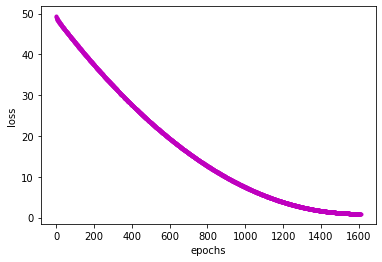

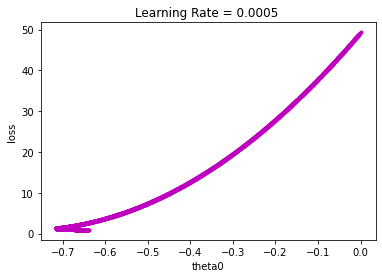

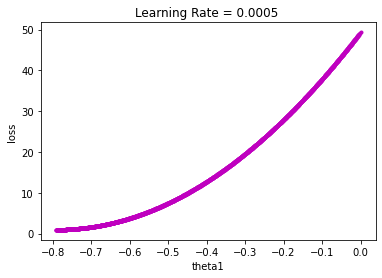

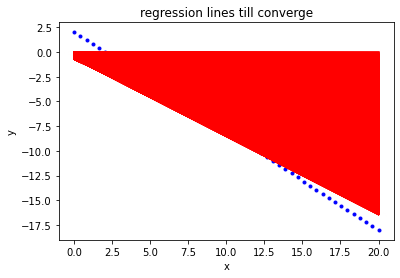

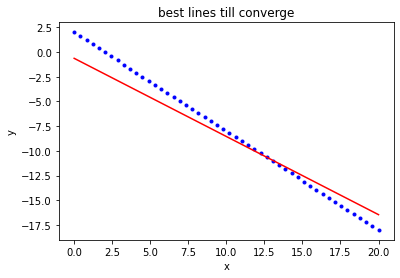

In [ ]:
r2_score(y,h_yhat6[-1])
plot(theta_0s6,theta_1s6,costs6,h_yhat6,lr6)

## Adam

### Update the previos implementation to be Adam.
#### Compare your results with Adagrad and RMSProp results.

In [ ]:
m=len(x)
def Adam (x,y,lr,E,it,B1,B2):
    theta_0s=[0]
    theta_1s=[0]
    vt0=0
    vt1=0
    th0=0
    th1=0
    mt_0=0
    mt_1=0
    costs=[]
    h_yhat=[]
    
    for i in range (it):
        print(f'****************** Iteration {i} ********************\n')
    

        h_yhat.append(theta_0s[i] + theta_1s[i]*x) # calculate y predict (y hat)
        print (f'h(x):{h_yhat[i]}\n')

        errs=( h_yhat[i]-y) # sub y pre from y orginal
        print(f'Error Vector:{errs}\n') 
        
        costs.append(errs@errs/(m*2)) # j or loss or cost with MSE 
        print(f'j(mse):{costs[i]}\n')
        
        theta_0drv = (errs.sum())/m #j/theta0
        theta_1drv= ((errs*x).sum())/m # j/th1
        gradient_vec = np.array([[theta_0drv],[theta_1drv]])
        print(f'Gradient Vector:\n{gradient_vec}\n')

        gradient_vector_norm=np.linalg.norm(gradient_vec,2)
        print(f'Gradient Vector Norm:{gradient_vector_norm}\n') 
        
       
        
        if (gradient_vector_norm<.001  ):
            print('norm')
            break


        if i!=0 and abs(costs[i]-costs[i-1])< 0.001 :
            print('cost')
            break
            
        
        mt_0=(B1*mt_0)+((1-B1)*theta_0drv) 
        mt_1=(B1*mt_1)+((1-B1)*theta_1drv)

        mt_h0=mt_0/(1-(B1)**(i+1))
        mt_h1=mt_1/(1-(B1)**(i+1))

        
        vt0 = B2*vt0 + (1-B2)*(theta_0drv)**2  
        vt1 = B2*vt1 + (1-B2)*(theta_1drv)**2  
        
        vt_h0=vt0/(1-(B2)**(i+1))
        vt_h1=vt1/(1-(B2)**(i+1))
        
        th0=th0 -((lr/(np.sqrt(vt_h0)+E))*mt_h0)
        th1=th1 -((lr/(np.sqrt(vt_h1)+E))*mt_h1)
        
        print(f'M0_{i}:{mt_0}\nM1_{i}: {mt_1}\n')    
        print(f'M0_{i}_corrected:{mt_h0} \nM1_{i}_corrected: {mt_h1} \n')  
        
        print(f'Vt0_{i}:{vt0}\nVt1_{i}: {vt1}\n')
        print(f'Vt0_{i}_corrected:{vt_h0} \nVt1_{i}_corrected: {vt_h1}\n')
        print(f'theta_0_new :{th0} \ntheta_1_new :{th1}')    
            
            
        if i!= (it-1) :

            theta_0s.append(th0) #update eq with nag
            theta_1s.append(th1)        
       
            
    if i != it-1:        #do not print if iter finshed
        print(f'\n\nGradient Descent converged after {i+1} epochs\n')
        print ((f'theta_0_Opt :{theta_0s[-1]} \ntheta_1_Opt:{theta_1s[-1]}\n'))
        print(f'Error Vector:{errs}\n')
        print(f'Cost :{costs[-1]}\n')
        print(f'h(x) = y_predict:{h_yhat[-1]}')
        print(f'y_actual:{y}')
    
    return theta_0s,theta_1s ,costs,h_yhat,lr


def plot(theta_0s,theta_1s ,costs,h_yhat,lr):
    plt.plot(costs,'.m-')
    plt.xlabel('epochs')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(theta_0s,costs,'.m-')
    plt.title(f'Learning Rate = {lr} ')
    plt.xlabel('theta0')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(theta_1s,costs,'.m-')
    plt.title(f'Learning Rate = {lr} ')
    plt.xlabel('theta1')
    plt.ylabel('loss')
    plt.show()
    
    plt.plot(x,y,'.b')
    for i in range( len(h_yhat)):
        plt.plot(x,h_yhat[i],'r')
    plt.title('regression lines till converge')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()
    
    plt.plot(x,y,'.b')
    plt.plot(x,h_yhat[-1],'r')
    plt.title('best lines till converge')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()

##### The following results uses alpha = 0.05, beta1 = 0.2, beta2 = 0.7, epsilon =  1e-08, and max. iterations = 500.

In [ ]:
theta_0s7,theta_1s7,costs7,h_yhat7,lr7= Adam(x,y,0.05,1e-08,500,.2,0.7)


****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:6.400000000000002
M1_0: 91.75510203715918



Error Vector:[-1.0483371  -1.01288044 -0.97742379 -0.94196713 -0.90651048 -0.87105383
 -0.83559717 -0.80014052 -0.76468386 -0.72922721 -0.69377056 -0.6583139
 -0.62285725 -0.58740059 -0.55194394 -0.51648728 -0.48103063 -0.44557397
 -0.41011732 -0.37466067 -0.33920401 -0.30374736 -0.2682907  -0.23283405
 -0.19737739 -0.16192074 -0.12646409 -0.09100743 -0.05555078 -0.02009412
  0.01536253  0.05081918  0.08627584  0.12173249  0.15718915  0.1926458
  0.22810246  0.26355911  0.29901577  0.33447242  0.36992907  0.40538573
  0.44084238  0.47629904  0.51175569  0.54721235  0.582669    0.61812565
  0.65358231  0.68903896]

j(mse):0.14704017128827215

Gradient Vector:
[[-0.17964907]
 [ 1.21732494]]

Gradient Vector Norm:1.2305095667507966

M0_58:-0.21649488275184825
M1_58: 0.7590814740236767

M0_58_corrected:-0.21649488275184825 
M1_58_corrected: 0.7590814740236767 

Vt0_58:0.1053136248149336
Vt1_58: 5.4311723621710755

Vt0_58_corrected:0.10531362489136449 
Vt1_58_corrected: 5.431172366112724



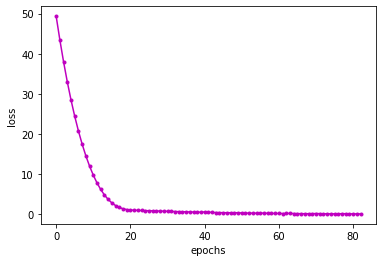

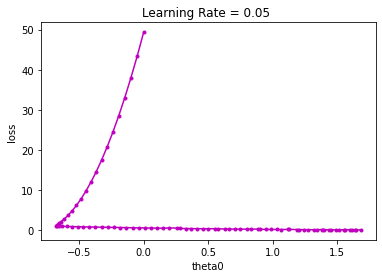

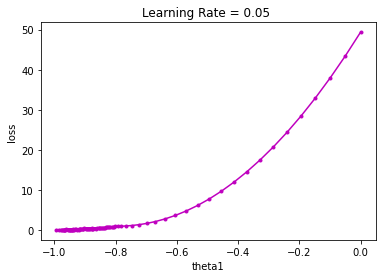

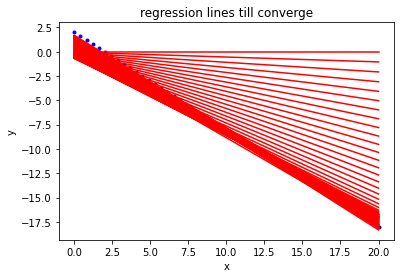

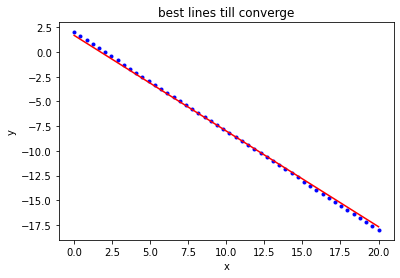

In [ ]:
r2_score(y,h_yhat7[-1])
plot(theta_0s7,theta_1s7,costs7,h_yhat7,lr7)

In [ ]:
r2_score(y,h_yhat7[-1])

0.9989675218211589

##### The following results uses alpha = 0.005, beta1 = 0.5, beta2 = 0.8, epsilon =  1e-08, and max. iterations = 500.

In [ ]:
theta_0s8,theta_1s8,costs8,h_yhat8,lr8= Adam(x,y,0.005,1e-08,500,.5,0.8)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:4.000000000000001
M1_0: 57.34693877322448



M0_67_corrected:4.446405669049437 
M1_67_corrected: 67.94725821991472 

Vt0_67:21.276873978028494
Vt1_67: 4917.3408058940595

Vt0_67_corrected:21.276879448528824 
Vt1_67_corrected: 4917.342070192308

theta_0_new :-0.33192541503683937 
theta_1_new :-0.3328238914843246
****************** Iteration 68 ********************

h(x):[-0.33192542 -0.4677719  -0.60361839 -0.73946488 -0.87531136 -1.01115785
 -1.14700433 -1.28285082 -1.4186973  -1.55454379 -1.69039028 -1.82623677
 -1.96208325 -2.09792974 -2.23377622 -2.36962271 -2.50546919 -2.64131568
 -2.77716217 -2.91300865 -3.04885514 -3.18470163 -3.32054812 -3.4563946
 -3.59224109 -3.72808757 -3.86393406 -3.99978054 -4.13562703 -4.27147352
 -4.40732    -4.54316649 -4.67901298 -4.81485947 -4.95070595 -5.08655244
 -5.22239892 -5.35824541 -5.49409189 -5.62993838 -5.76578487 -5.90163135
 -6.03747784 -6.17332433 -6.30917081 -6.4450173  -6.58086378 -6.71671027
 -6.85255676 -6.98840324]

Error Vector:[-2.33192542 -2.05960863 -1.78729186 -1.51497508 


j(mse):2.8951970481390354

Gradient Vector:
[[ 1.04971764]
 [23.25106966]]

Gradient Vector Norm:23.274753433924957

M0_131:1.1001102884267266
M1_131: 23.914661859260637

M0_131_corrected:1.1001102884267266 
M1_131_corrected: 23.914661859260637 

Vt0_131:1.6208362894024726
Vt1_131: 680.9183704651573

Vt0_131_corrected:1.6208362894027342 
Vt1_131_corrected: 680.9183704652672

theta_0_new :-0.6307250538199802 
theta_1_new :-0.6369701168616709
****************** Iteration 132 ********************

h(x):[ -0.63072505  -0.89071286  -1.15070066  -1.41068846  -1.67067626
  -1.93066407  -2.19065187  -2.45063968  -2.71062747  -2.97061528
  -3.23060308  -3.49059089  -3.75057869  -4.01056649  -4.27055429
  -4.5305421   -4.7905299   -5.0505177   -5.31050551  -5.57049331
  -5.83048111  -6.09046891  -6.35045672  -6.61044452  -6.87043232
  -7.13042012  -7.39040793  -7.65039573  -7.91038353  -8.17037133
  -8.43035914  -8.69034694  -8.95033474  -9.21032255  -9.47031035
  -9.73029815  -9.99028595 -10.2


Error Vector:[-2.61052066 -2.52930074 -2.44808082 -2.3668609  -2.28564099 -2.20442107
 -2.12320116 -2.04198124 -1.96076132 -1.87954141 -1.79832149 -1.71710157
 -1.63588166 -1.55466174 -1.47344182 -1.39222191 -1.31100199 -1.22978207
 -1.14856216 -1.06734224 -0.98612232 -0.90490241 -0.82368249 -0.74246257
 -0.66124266 -0.58002274 -0.49880282 -0.41758291 -0.33636299 -0.25514308
 -0.17392316 -0.09270324 -0.01148333  0.06973659  0.15095651  0.23217643
  0.31339634  0.39461626  0.47583617  0.55705609  0.63827601  0.71949592
  0.80071584  0.88193576  0.96315567  1.04437559  1.12559551  1.20681542
  1.28803534  1.36925526]

j(mse):0.8794712422526874

Gradient Vector:
[[-0.6206327 ]
 [ 0.69736591]]

Gradient Vector Norm:0.9335438736773788

M0_174:-0.6034259384187924
M1_174: 0.9485671431704841

M0_174_corrected:-0.6034259384187924 
M1_174_corrected: 0.9485671431704841 

Vt0_174:0.2994568729359047
Vt1_174: 6.8503492293794475

Vt0_174_corrected:0.2994568729359047 
Vt1_174_corrected: 6.85034922937


j(mse):0.7191604837467562

Gradient Vector:
[[-0.61661649]
 [-0.10730633]]

Gradient Vector Norm:0.6258838132924959

M0_223:-0.6127892379610643
M1_223: -0.038529681317774886

M0_223_corrected:-0.6127892379610643 
M1_223_corrected: -0.038529681317774886 

Vt0_223:0.3775635460338073
Vt1_223: 0.00890449812328897

Vt0_223_corrected:0.3775635460338073 
Vt1_223_corrected: 0.00890449812328897

theta_0_new :-0.3580069985005487 
theta_1_new :-0.823320757699731
****************** Iteration 224 ********************

h(x):[ -0.358007    -0.69405629  -1.03010558  -1.36615487  -1.70220415
  -2.03825345  -2.37430273  -2.71035202  -3.04640131  -3.3824506
  -3.71849988  -4.05454918  -4.39059846  -4.72664775  -5.06269704
  -5.39874633  -5.73479562  -6.07084491  -6.4068942   -6.74294349
  -7.07899278  -7.41504206  -7.75109136  -8.08714064  -8.42318993
  -8.75923922  -9.09528851  -9.43133779  -9.76738709 -10.10343637
 -10.43948566 -10.77553495 -11.11158424 -11.44763353 -11.78368282
 -12.11973211 -12.4557


Error Vector:[-2.19411305 -2.12732924 -2.06054542 -1.9937616  -1.92697779 -1.86019397
 -1.79341015 -1.72662634 -1.65984252 -1.5930587  -1.52627489 -1.45949107
 -1.39270725 -1.32592343 -1.25913962 -1.1923558  -1.12557199 -1.05878817
 -0.99200435 -0.92522053 -0.85843672 -0.7916529  -0.72486908 -0.65808527
 -0.59130145 -0.52451763 -0.45773381 -0.39095    -0.32416618 -0.25738237
 -0.19059855 -0.12381473 -0.05703091  0.0097529   0.07653672  0.14332054
  0.21010435  0.27688817  0.34367199  0.4104558   0.47723962  0.54402344
  0.61080725  0.67759107  0.74437489  0.81115871  0.87794252  0.94472634
  1.01151016  1.07829397]

j(mse):0.6200371702343438

Gradient Vector:
[[-0.55790954]
 [ 0.09752903]]

Gradient Vector Norm:0.566369991413312

M0_257:-0.5634117639642574
M1_257: 0.04065892083559942

M0_257_corrected:-0.5634117639642574 
M1_257_corrected: 0.04065892083559942 

Vt0_257:0.3236422867672106
Vt1_257: 0.01314040687485488

Vt0_257_corrected:0.3236422867672106 
Vt1_257_corrected: 0.013140406


Error Vector:[-1.95091135e+00 -1.89177398e+00 -1.83263662e+00 -1.77349926e+00
 -1.71436189e+00 -1.65522453e+00 -1.59608717e+00 -1.53694980e+00
 -1.47781244e+00 -1.41867508e+00 -1.35953771e+00 -1.30040035e+00
 -1.24126299e+00 -1.18212562e+00 -1.12298826e+00 -1.06385090e+00
 -1.00471353e+00 -9.45576170e-01 -8.86438806e-01 -8.27301444e-01
 -7.68164080e-01 -7.09026717e-01 -6.49889353e-01 -5.90751991e-01
 -5.31614627e-01 -4.72477264e-01 -4.13339900e-01 -3.54202538e-01
 -2.95065174e-01 -2.35927811e-01 -1.76790447e-01 -1.17653085e-01
 -5.85157207e-02  6.21643241e-04  5.97590058e-02  1.18896370e-01
  1.78033732e-01  2.37171096e-01  2.96308459e-01  3.55445823e-01
  4.14583185e-01  4.73720549e-01  5.32857912e-01  5.91995276e-01
  6.51132638e-01  7.10270002e-01  7.69407365e-01  8.28544729e-01
  8.87682091e-01  9.46819455e-01]

j(mse):0.49017390381307896

Gradient Vector:
[[-0.50204595]
 [ 0.00621642]]

Gradient Vector Norm:0.502084430459741

M0_306:-0.5018042338513571
M1_306: 0.02667127078146978


Gradient Vector Norm:0.465782449115895

M0_341:-0.4600452278397612
M1_341: -0.013059096379360667

M0_341_corrected:-0.4600452278397612 
M1_341_corrected: -0.013059096379360667 

Vt0_341:0.21426814494464733
Vt1_341: 0.010511754033765941

Vt0_341_corrected:0.21426814494464733 
Vt1_341_corrected: 0.010511754033765941

theta_0_new :0.2276291875507885 
theta_1_new :-0.867841617331248
****************** Iteration 342 ********************

h(x):[  0.22762919  -0.12659188  -0.48081295  -0.83503402  -1.18925508
  -1.54347616  -1.89769722  -2.25191829  -2.60613936  -2.96036043
  -3.31458149  -3.66880257  -4.02302363  -4.3772447   -4.73146576
  -5.08568684  -5.4399079   -5.79412897  -6.14835005  -6.50257111
  -6.85679218  -7.21101325  -7.56523432  -7.91945538  -8.27367645
  -8.62789752  -8.98211859  -9.33633965  -9.69056073 -10.04478179
 -10.39900286 -10.75322393 -11.107445   -11.46166607 -11.81588713
 -12.17010821 -12.52432927 -12.87855034 -13.23277141 -13.58699248
 -13.94121354 -14.29543461 -1


Error Vector:[-1.55931969 -1.5115094  -1.46369912 -1.41588883 -1.36807854 -1.32026826
 -1.27245797 -1.22464769 -1.1768374  -1.12902712 -1.08121683 -1.03340655
 -0.98559626 -0.93778597 -0.88997569 -0.8421654  -0.79435512 -0.74654483
 -0.69873455 -0.65092426 -0.60311397 -0.55530369 -0.5074934  -0.45968312
 -0.41187283 -0.36406255 -0.31625226 -0.26844198 -0.22063169 -0.1728214
 -0.12501112 -0.07720083 -0.02939055  0.01841974  0.06623002  0.11404031
  0.16185059  0.20966088  0.25747117  0.30528145  0.35309174  0.40090202
  0.44871231  0.49652259  0.54433288  0.59214317  0.63995345  0.68776374
  0.73557402  0.78338431]

j(mse):0.3132708265868618

Gradient Vector:
[[-0.38796769]
 [ 0.18419738]]

Gradient Vector Norm:0.42947363465353455

M0_385:-0.39814320716449203
M1_385: 0.06436792407874928

M0_385_corrected:-0.39814320716449203 
M1_385_corrected: 0.06436792407874928 

Vt0_385:0.16399826737771253
Vt1_385: 0.01891525757862052

Vt0_385_corrected:0.16399826737771253 
Vt1_385_corrected: 0.0189


j(mse):0.2510218163044153

Gradient Vector:
[[-0.36511063]
 [-0.07438342]]

Gradient Vector Norm:0.3726106033976933

M0_418:-0.3622287643597919
M1_418: -0.018428527411766586

M0_418_corrected:-0.3622287643597919 
M1_418_corrected: -0.018428527411766586 

Vt0_418:0.1330973878553391
Vt1_418: 0.011200566548097387

Vt0_418_corrected:0.1330973878553391 
Vt1_418_corrected: 0.011200566548097387

theta_0_new :0.6089160298249796 
theta_1_new :-0.8960355799914687
****************** Iteration 419 ********************

h(x):[  0.60891603   0.24318722  -0.12254159  -0.4882704   -0.8539992
  -1.21972801  -1.58545682  -1.95118563  -2.31691443  -2.68264325
  -3.04837205  -3.41410086  -3.77982966  -4.14555848  -4.51128728
  -4.87701609  -5.2427449   -5.60847371  -5.97420252  -6.33993132
  -6.70566014  -7.07138894  -7.43711775  -7.80284656  -8.16857537
  -8.53430417  -8.90003298  -9.26576179  -9.6314906   -9.9972194
 -10.36294822 -10.72867702 -11.09440583 -11.46013464 -11.82586345
 -12.19159226 -12.557


Error Vector:[-1.21815224 -1.18137699 -1.14460173 -1.10782648 -1.07105122 -1.03427597
 -0.99750071 -0.96072546 -0.9239502  -0.88717495 -0.85039969 -0.81362444
 -0.77684919 -0.74007393 -0.70329868 -0.66652342 -0.62974817 -0.59297291
 -0.55619766 -0.5194224  -0.48264715 -0.44587189 -0.40909664 -0.37232138
 -0.33554613 -0.29877088 -0.26199562 -0.22522037 -0.18844511 -0.15166986
 -0.1148946  -0.07811935 -0.04134409 -0.00456884  0.03220642  0.06898167
  0.10575693  0.14253218  0.17930743  0.21608269  0.25285794  0.2896332
  0.32640845  0.36318371  0.39995896  0.43673422  0.47350947  0.51028473
  0.54705998  0.58383524]

j(mse):0.19111542281396737

Gradient Vector:
[[-0.3171585 ]
 [-0.04568838]]

Gradient Vector Norm:0.32043243250934694

M0_454:-0.31442707735089637
M1_454: 0.008191173987936767

M0_454_corrected:-0.31442707735089637 
M1_454_corrected: 0.008191173987936767 

Vt0_454:0.10130093251802849
Vt1_454: 0.01751017945693205

Vt0_454_corrected:0.10130093251802849 
Vt1_454_corrected: 0.0


Error Vector:[-1.0208585  -0.98956362 -0.95826875 -0.92697387 -0.895679   -0.86438412
 -0.83308924 -0.80179437 -0.77049949 -0.73920461 -0.70790974 -0.67661486
 -0.64531998 -0.61402511 -0.58273023 -0.55143535 -0.52014048 -0.4888456
 -0.45755072 -0.42625585 -0.39496097 -0.36366609 -0.33237122 -0.30107634
 -0.26978146 -0.23848659 -0.20719171 -0.17589683 -0.14460196 -0.11330708
 -0.0820122  -0.05071733 -0.01942245  0.01187243  0.0431673   0.07446218
  0.10575706  0.13705193  0.16834681  0.19964169  0.23093656  0.26223144
  0.29352632  0.32482119  0.35611607  0.38741095  0.41870582  0.4500007
  0.48129557  0.51259045]

j(mse):0.13426887974749455

Gradient Vector:
[[-0.25413402]
 [ 0.11872426]]

Gradient Vector Norm:0.28049875736056656

M0_494:-0.26080679116982186
M1_494: 0.045976939771872574

M0_494_corrected:-0.26080679116982186 
M1_494_corrected: 0.045976939771872574 

Vt0_494:0.07109855044882209
Vt1_494: 0.012428016592227748

Vt0_494_corrected:0.07109855044882209 
Vt1_494_corrected: 0.0

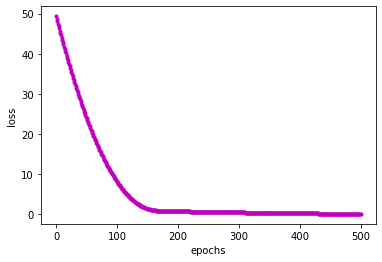

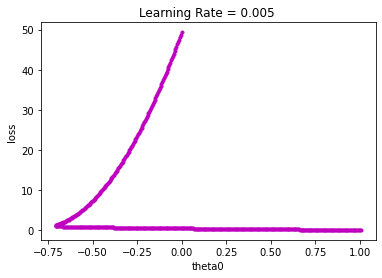

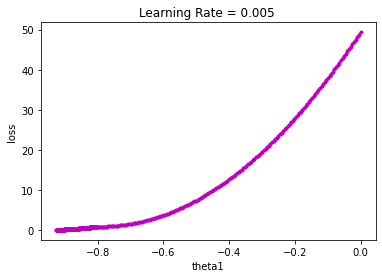

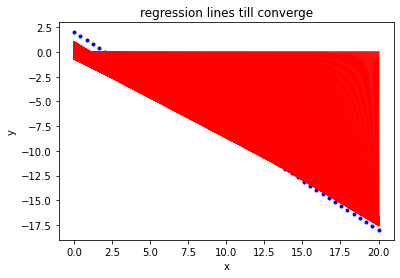

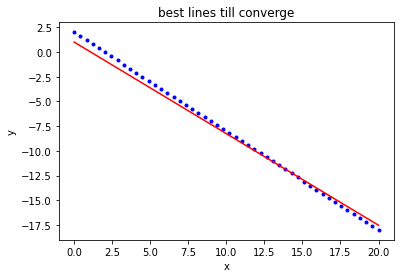

In [ ]:
r2_score(y,h_yhat8[-1])
plot(theta_0s8,theta_1s8,costs8,h_yhat8,lr8)

In [ ]:
r2_score(y,h_yhat8[-1])

0.9926295262112657

##### The following results uses alpha = 0.0005, beta1 = 0.8, beta2 = 0.8, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s9,theta_1s9,costs9,h_yhat9,lr9= Adam(x,y,0.0005,1e-08,5000,.8,0.8)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:1.6
M1_0: 22.938775509289787

M0_0_correct


Error Vector:[-2.02049993 -1.62070399 -1.22090805 -0.82111211 -0.42131617 -0.02152023
  0.37827571  0.77807165  1.17786759  1.57766353  1.97745947  2.37725541
  2.77705135  3.1768473   3.57664323  3.97643918  4.37623511  4.77603106
  5.175827    5.57562294  5.97541888  6.37521482  6.77501076  7.1748067
  7.57460264  7.97439858  8.37419453  8.77399046  9.17378641  9.57358234
  9.97337829 10.37317422 10.77297017 11.17276611 11.57256205 11.97235799
 12.37215393 12.77194987 13.17174581 13.57154176 13.97133769 14.37113364
 14.77092957 15.17072552 15.57052145 15.9703174  16.37011333 16.76990928
 17.16970521 17.56950116]

j(mse):46.86443608048818

Gradient Vector:
[[  7.77450061]
 [111.72766108]]

Gradient Vector Norm:111.99782636321001

M0_41:7.795817617860789
M1_41: 112.00725980155234

M0_41_corrected:7.796480869101737 
M1_41_corrected: 112.01678913608787 

Vt0_41:60.78054332059395
Vt1_41: 12546.797489250783

Vt0_41_corrected:60.78571439728647 
Vt1_41_corrected: 12547.864943546481

theta_0


Error Vector:[-2.03849984 -1.64605081 -1.25360178 -0.86115274 -0.46870371 -0.07625467
  0.31619435  0.70864339  1.10109242  1.49354146  1.88599049  2.27843952
  2.67088855  3.06333759  3.45578662  3.84823566  4.24068468  4.63313372
  5.02558276  5.41803179  5.81048083  6.20292985  6.59537889  6.98782792
  7.38027696  7.77272599  8.16517502  8.55762405  8.95007309  9.34252212
  9.73497116 10.12742018 10.51986922 10.91231826 11.30476729 11.69721632
 12.08966535 12.48211439 12.87456342 13.26701246 13.65946148 14.05191052
 14.44435955 14.83680859 15.22925762 15.62170665 16.01415568 16.40660472
 16.79905375 17.19150279]

j(mse):44.73862864594083

Gradient Vector:
[[  7.57650147]
 [109.12318254]]

Gradient Vector Norm:109.38588730400195

M0_77:7.598501152551352
M1_77: 109.41256584042227

M0_77_corrected:7.598501362323067 
M1_77_corrected: 109.41256886097347 

Vt0_77:57.737826348856416
Vt1_77: 11971.2145740632

Vt0_77_corrected:57.737827942823785 
Vt1_77_corrected: 11971.214904552355

theta_


M0_98:7.48300189041608
M1_98: 107.89329006173824

M0_98_corrected:7.483001892321473 
M1_98_corrected: 107.89329008921106 

Vt0_98:55.99592230067944
Vt1_98: 11641.066723945398

Vt0_98_corrected:55.99592231493765 
Vt1_98_corrected: 11641.066726909557

theta_0_new :-0.04949978451405511 
theta_1_new :-0.049499819778639036
****************** Iteration 99 ********************

h(x):[-0.04949978 -0.06970379 -0.0899078  -0.11011181 -0.13031582 -0.15051983
 -0.17072383 -0.19092784 -0.21113185 -0.23133586 -0.25153987 -0.27174387
 -0.29194788 -0.31215189 -0.3323559  -0.35255991 -0.37276391 -0.39296792
 -0.41317193 -0.43337594 -0.45357995 -0.47378395 -0.49398796 -0.51419197
 -0.53439598 -0.55459999 -0.57480399 -0.595008   -0.61521201 -0.63541602
 -0.65562003 -0.67582403 -0.69602804 -0.71623205 -0.73643606 -0.75664007
 -0.77684408 -0.79704808 -0.81725209 -0.8374561  -0.85766011 -0.87786412
 -0.89806812 -0.91827213 -0.93847614 -0.95868015 -0.97888416 -0.99908816
 -1.01929217 -1.03949618]

Error Vec


Gradient Vector Norm:104.66989461732139

M0_142:7.241003027555776
M1_142: 104.71003965068354

M0_142_corrected:7.241003027555877 
M1_142_corrected: 104.71003965068499 

Vt0_142:52.43272983925965
Vt1_142: 10964.29708423752

Vt0_142_corrected:52.432729839260375 
Vt1_142_corrected: 10964.297084237673

theta_0_new :-0.07149966157328198 
theta_1_new :-0.07149971778393278
****************** Iteration 143 ********************

h(x):[-0.07149966 -0.10068322 -0.12986678 -0.15905034 -0.18823389 -0.21741745
 -0.24660101 -0.27578457 -0.30496813 -0.33415169 -0.36333524 -0.3925188
 -0.42170236 -0.45088592 -0.48006948 -0.50925304 -0.53843659 -0.56762015
 -0.59680371 -0.62598727 -0.65517083 -0.68435439 -0.71353794 -0.7427215
 -0.77190506 -0.80108862 -0.83027218 -0.85945573 -0.88863929 -0.91782285
 -0.94700641 -0.97618997 -1.00537353 -1.03455709 -1.06374064 -1.0929242
 -1.12210776 -1.15129132 -1.18047488 -1.20965843 -1.23884199 -1.26802555
 -1.29720911 -1.32639267 -1.35557623 -1.38475978 -1.41394334 -


Error Vector:[-2.09699951 -1.72842791 -1.35985632 -0.99128472 -0.62271313 -0.25414153
  0.11443006  0.48300166  0.85157325  1.22014485  1.58871644  1.95728804
  2.32585963  2.69443123  3.06300282  3.43157442  3.80014601  4.16871761
  4.53728921  4.9058608   5.2744324   5.64300399  6.01157559  6.38014718
  6.74871878  7.11729037  7.48586197  7.85443356  8.22300516  8.59157675
  8.96014835  9.32871994  9.69729154 10.06586314 10.43443473 10.80300633
 11.17157792 11.54014952 11.90872111 12.27729271 12.6458643  13.0144359
 13.38300749 13.75157909 14.12015068 14.48872228 14.85729387 15.22586547
 15.59443706 15.96300866]

j(mse):38.178139023911136

Gradient Vector:
[[  6.93300458]
 [100.65863136]]

Gradient Vector Norm:100.89710907602883

M0_194:6.955004462048656
M1_194: 100.94801761802113

M0_194_corrected:6.955004462048656 
M1_194_corrected: 100.94801761802113 

Vt0_194:48.372692060860295
Vt1_194: 10190.606941521775

Vt0_194_corrected:48.372692060860295 
Vt1_194_corrected: 10190.6069415217


h(x):[-0.12399933 -0.17461135 -0.22522337 -0.27583539 -0.32644741 -0.37705943
 -0.42767145 -0.47828347 -0.52889549 -0.57950751 -0.63011953 -0.68073154
 -0.73134356 -0.78195558 -0.8325676  -0.88317962 -0.93379164 -0.98440366
 -1.03501568 -1.0856277  -1.13623972 -1.18685174 -1.23746376 -1.28807578
 -1.3386878  -1.38929982 -1.43991183 -1.49052385 -1.54113587 -1.59174789
 -1.64235991 -1.69297193 -1.74358395 -1.79419597 -1.84480799 -1.89542001
 -1.94603203 -1.99664405 -2.04725607 -2.09786809 -2.14848011 -2.19909212
 -2.24970414 -2.30031616 -2.35092818 -2.4015402  -2.45215222 -2.50276424
 -2.55337626 -2.60398828]

Error Vector:[-2.12399933 -1.76644808 -1.40889684 -1.05134559 -0.69379435 -0.3362431
  0.02130814  0.37885939  0.73641063  1.09396188  1.45151312  1.80906438
  2.16661562  2.52416687  2.88171811  3.23926936  3.5968206   3.95437185
  4.3119231   4.66947434  5.02702559  5.38457683  5.74212808  6.09967932
  6.45723057  6.81478181  7.17233307  7.52988431  7.88743556  8.2449868
  8.602


M0_304:6.3500078823243005
M1_304: 92.98989912438473

M0_304_corrected:6.3500078823243005 
M1_304_corrected: 92.98989912438473 

Vt0_304:40.32320509820158
Vt1_304: 8647.226019483927

Vt0_304_corrected:40.32320509820158 
Vt1_304_corrected: 8647.226019483927

theta_0_new :-0.15249912814182698 
theta_1_new :-0.15249928205120974
****************** Iteration 305 ********************

h(x):[-0.15249913 -0.21474373 -0.27698834 -0.33923294 -0.40147755 -0.46372215
 -0.52596676 -0.58821136 -0.65045597 -0.71270057 -0.77494518 -0.83718978
 -0.89943439 -0.96167899 -1.0239236  -1.0861682  -1.14841281 -1.21065741
 -1.27290202 -1.33514662 -1.39739123 -1.45963583 -1.52188044 -1.58412504
 -1.64636965 -1.70861425 -1.77085886 -1.83310346 -1.89534807 -1.95759267
 -2.01983728 -2.08208188 -2.14432649 -2.20657109 -2.2688157  -2.3310603
 -2.39330491 -2.45554951 -2.51779411 -2.58003872 -2.64228332 -2.70452793
 -2.76677253 -2.82901714 -2.89126174 -2.95350635 -3.01575095 -3.07799556
 -3.14024016 -3.20248477]

Err


j(mse):29.926545141339403

Gradient Vector:
[[ 6.0365099 ]
 [88.86614998]]

Gradient Vector Norm:89.07093838057537

M0_357:6.058509750261301
M1_357: 89.15553581203511

M0_357_corrected:6.058509750261301 
M1_357_corrected: 89.15553581203511 

Vt0_357:36.70614538597996
Vt1_357: 7948.8142461398365

Vt0_357_corrected:36.70614538597996 
Vt1_357_corrected: 7948.8142461398365

theta_0_new :-0.1789989195512361 
theta_1_new :-0.17899911461662085
****************** Iteration 358 ********************

h(x):[-0.17899892 -0.25205978 -0.32512065 -0.39818151 -0.47124237 -0.54430324
 -0.6173641  -0.69042496 -0.76348582 -0.83654669 -0.90960755 -0.98266841
 -1.05572928 -1.12879014 -1.201851   -1.27491187 -1.34797273 -1.42103359
 -1.49409446 -1.56715532 -1.64021618 -1.71327704 -1.78633791 -1.85939877
 -1.93245963 -2.0055205  -2.07858136 -2.15164222 -2.22470309 -2.29776395
 -2.37082481 -2.44388568 -2.51694654 -2.5900074  -2.66306827 -2.73612913
 -2.80918999 -2.88225086 -2.95531172 -3.02837258 -3.10143344


Error Vector:[-2.20549869 -1.88121254 -1.55692639 -1.23264024 -0.90835409 -0.58406794
 -0.25978179  0.06450436  0.38879051  0.71307666  1.03736281  1.36164896
  1.68593511  2.01022126  2.33450741  2.65879356  2.98307971  3.30736586
  3.63165202  3.95593816  4.28022432  4.60451046  4.92879662  5.25308276
  5.57736892  5.90165506  6.22594122  6.55022736  6.87451352  7.19879966
  7.52308582  7.84737196  8.17165812  8.49594427  8.82023041  9.14451657
  9.46880271  9.79308887 10.11737501 10.44166117 10.76594731 11.09023347
 11.41451961 11.73880577 12.06309191 12.38737807 12.71166421 13.03595037
 13.36023651 13.68452267]

j(mse):27.420940868885392

Gradient Vector:
[[ 5.73951199]
 [84.95944265]]

Gradient Vector Norm:85.15309091817521

M0_411:5.761511827972868
M1_411: 85.24882829858475

M0_411_corrected:5.761511827972868 
M1_411_corrected: 85.24882829858475 

Vt0_411:33.19562353508228
Vt1_411: 7267.467406360371

Vt0_411_corrected:33.19562353508228 
Vt1_411_corrected: 7267.467406360371

thet


j(mse):26.210701544049087

Gradient Vector:
[[ 5.59101311]
 [83.00608995]]

Gradient Vector Norm:83.19417285556942

M0_438:5.613012940667885
M1_438: 83.29547550461771

M0_438_corrected:5.613012940667885 
M1_438_corrected: 83.29547550461771 

Vt0_438:31.506519262896404
Vt1_438: 6938.240919547173

Vt0_438_corrected:31.506519262896404 
Vt1_438_corrected: 6938.240919547173

theta_0_new :-0.21949855888946693 
theta_1_new :-0.21949882893202677
****************** Iteration 439 ********************

h(x):[-0.21949856 -0.30908992 -0.39868128 -0.48827264 -0.57786399 -0.66745535
 -0.75704671 -0.84663807 -0.93622943 -1.02582079 -1.11541215 -1.20500351
 -1.29459486 -1.38418622 -1.47377758 -1.56336894 -1.6529603  -1.74255166
 -1.83214302 -1.92173437 -2.01132573 -2.10091709 -2.19050845 -2.28009981
 -2.36969117 -2.45928253 -2.54887389 -2.63846524 -2.7280566  -2.81764796
 -2.90723932 -2.99683068 -3.08642204 -3.1760134  -3.26560476 -3.35519612
 -3.44478747 -3.53437883 -3.62397019 -3.71356155 -3.8031529

Gradient Vector Norm:80.50973637588334

M0_475:5.40951455399324
M1_475: 80.61865986665231

M0_475_corrected:5.40951455399324 
M1_475_corrected: 80.61865986665231 

Vt0_475:29.263452700029983
Vt1_475: 6499.472998594467

Vt0_475_corrected:29.263452700029983 
Vt1_475_corrected: 6499.472998594467

theta_0_new :-0.23799837437006263 
theta_1_new :-0.2379986846097259
****************** Iteration 476 ********************

h(x):[-0.23799837 -0.3351407  -0.43228301 -0.52942534 -0.62656766 -0.72370998
 -0.8208523  -0.91799462 -1.01513694 -1.11227926 -1.20942158 -1.3065639
 -1.40370622 -1.50084854 -1.59799086 -1.69513318 -1.7922755  -1.88941782
 -1.98656014 -2.08370246 -2.18084478 -2.2779871  -2.37512942 -2.47227174
 -2.56941406 -2.66655638 -2.7636987  -2.86084102 -2.95798334 -3.05512566
 -3.15226798 -3.2494103  -3.34655262 -3.44369494 -3.54083726 -3.63797958
 -3.7351219  -3.83226422 -3.92940654 -4.02654886 -4.12369118 -4.22083351
 -4.31797582 -4.41511815 -4.51226046 -4.60940279 -4.7065451  -4.803


Error Vector:[-2.25199823 -1.94669152 -1.64138481 -1.3360781  -1.0307714  -0.72546469
 -0.42015799 -0.11485128  0.19045543  0.49576214  0.80106884  1.10637555
  1.41168225  1.71698896  2.02229566  2.32760237  2.63290908  2.93821579
  3.2435225   3.5488292   3.85413591  4.15944261  4.46474932  4.77005602
  5.07536273  5.38066944  5.68597615  5.99128285  6.29658956  6.60189626
  6.90720297  7.21250968  7.51781639  7.8231231   8.1284298   8.43373651
  8.73904321  9.04434992  9.34965662  9.65496333  9.96027004 10.26557675
 10.57088345 10.87619016 11.18149686 11.48680357 11.79211027 12.09741698
 12.40272369 12.7080304 ]

j(mse):23.371794869945102

Gradient Vector:
[[ 5.22801609]
 [78.23123092]]

Gradient Vector Norm:78.40572455681426

M0_504:5.2500158962512335
M1_504: 78.5206161906251

M0_504_corrected:5.2500158962512335 
M1_504_corrected: 78.5206161906251 

Vt0_504:27.563271900519513
Vt1_504: 6165.591846763019

Vt0_504_corrected:27.563271900519513 
Vt1_504_corrected: 6165.591846763019

th


j(mse):22.096890439917637

Gradient Vector:
[[ 5.05751762]
 [75.9884958 ]]

Gradient Vector Norm:76.15661480468059

M0_535:5.07951741369093
M1_535: 76.27788092332612

M0_535_corrected:5.07951741369093 
M1_535_corrected: 76.27788092332612 

Vt0_535:25.802102144994702
Vt1_535: 5818.419797853858

Vt0_535_corrected:25.802102144994702 
Vt1_535_corrected: 5818.419797853858

theta_0_new :-0.2679980437095608 
theta_1_new :-0.2679984290327549
****************** Iteration 536 ********************

h(x):[-0.26799804 -0.37738516 -0.48677227 -0.59615939 -0.7055465  -0.81493361
 -0.92432073 -1.03370784 -1.14309495 -1.25248207 -1.36186918 -1.4712563
 -1.58064341 -1.69003052 -1.79941764 -1.90880475 -2.01819186 -2.12757898
 -2.23696609 -2.34635321 -2.45574032 -2.56512744 -2.67451455 -2.78390166
 -2.89328878 -3.00267589 -3.11206301 -3.22145012 -3.33083723 -3.44022435
 -3.54961146 -3.65899857 -3.76838569 -3.8777728  -3.98715992 -4.09654703
 -4.20593414 -4.31532126 -4.42470837 -4.53409549 -4.6434826  -4.


Error Vector:[-2.2879978  -1.99738483 -1.70677187 -1.41615891 -1.12554595 -0.83493298
 -0.54432002 -0.25370706  0.0369059   0.32751887  0.61813182  0.90874479
  1.19935775  1.48997072  1.78058367  2.07119664  2.3618096   2.65242256
  2.94303553  3.23364849  3.52426145  3.81487441  4.10548738  4.39610034
  4.6867133   4.97732626  5.26793923  5.55855219  5.84916515  6.13977811
  6.43039108  6.72100404  7.011617    7.30222997  7.59284293  7.88345589
  8.17406885  8.46468182  8.75529478  9.04590774  9.3365207   9.62713367
  9.91774663 10.20835959 10.49897255 10.78958552 11.08019847 11.37081144
 11.6614244  11.95203736]

j(mse):20.468177552486853

Gradient Vector:
[[ 4.83201978]
 [73.02229964]]

Gradient Vector Norm:73.1819968320972

M0_576:4.854019564996985
M1_576: 73.31168454627728

M0_576_corrected:4.854019564996985 
M1_576_corrected: 73.31168454627728 

Vt0_576:23.5621109254637
Vt1_576: 5374.707770556903

Vt0_576_corrected:23.5621109254637 
Vt1_576_corrected: 5374.707770556903

theta_0

M0_608:4.678021370599842
M1_608: 70.99660609388533

M0_608_corrected:4.678021370599842 
M1_608_corrected: 70.99660609388533 

Vt0_608:21.884488931082764
Vt1_608: 5040.622756258066

Vt0_608_corrected:21.884488931082764 
Vt1_608_corrected: 5040.622756258066

theta_0_new :-0.30449757846949665 
theta_1_new :-0.30449807591825556
****************** Iteration 609 ********************

h(x):[-0.30449758 -0.42878251 -0.55306744 -0.67735237 -0.80163729 -0.92592222
 -1.05020715 -1.17449208 -1.29877701 -1.42306194 -1.54734687 -1.6716318
 -1.79591672 -1.92020166 -2.04448658 -2.16877151 -2.29305644 -2.41734137
 -2.5416263  -2.66591123 -2.79019616 -2.91448109 -3.03876602 -3.16305094
 -3.28733587 -3.4116208  -3.53590573 -3.66019066 -3.78447559 -3.90876052
 -4.03304545 -4.15733037 -4.2816153  -4.40590024 -4.53018516 -4.65447009
 -4.77875502 -4.90303995 -5.02732488 -5.15160981 -5.27589474 -5.40017967
 -5.52446459 -5.64874952 -5.77303445 -5.89731938 -6.02160431 -6.14588924
 -6.27017417 -6.3944591 ]

Erro

Vt0_639_corrected:20.31837072150183 
Vt1_639_corrected: 4727.200057966483

theta_0_new :-0.3199973558187055 
theta_1_new :-0.31999790954770746
****************** Iteration 640 ********************

h(x):[-0.31999736 -0.45060875 -0.58122014 -0.71183153 -0.84244292 -0.97305432
 -1.10366571 -1.2342771  -1.36488849 -1.49549988 -1.62611127 -1.75672266
 -1.88733405 -2.01794545 -2.14855684 -2.27916823 -2.40977962 -2.54039101
 -2.67100241 -2.8016138  -2.93222519 -3.06283658 -3.19344797 -3.32405936
 -3.45467076 -3.58528215 -3.71589354 -3.84650493 -3.97711632 -4.10772771
 -4.23833911 -4.3689505  -4.49956189 -4.63017328 -4.76078467 -4.89139607
 -5.02200745 -5.15261885 -5.28323024 -5.41384163 -5.54445302 -5.67506441
 -5.8056758  -5.9362872  -6.06689859 -6.19750998 -6.32812137 -6.45873276
 -6.58934415 -6.71995555]

Error Vector:[-2.31999736 -2.04244548 -1.76489361 -1.48734173 -1.20978986 -0.93223799
 -0.65468612 -0.37713424 -0.09958237  0.17796951  0.45552138  0.73307326
  1.01062513  1.288177    1


j(mse):16.875395964558187

Gradient Vector:
[[ 4.2985257 ]
 [66.00472385]]

Gradient Vector Norm:66.14454545499729

M0_673:4.320525432049364
M1_673: 66.29410810941226

M0_673_corrected:4.320525432049364 
M1_673_corrected: 66.29410810941226 

Vt0_673:18.66754499439434
Vt1_673: 4395.0134491078

Vt0_673_corrected:18.66754499439434 
Vt1_673_corrected: 4395.0134491078

theta_0_new :-0.33699709140485357 
theta_1_new :-0.33699771412696394
****************** Iteration 674 ********************

h(x):[-0.33699709 -0.47454718 -0.61209727 -0.74964735 -0.88719744 -1.02474753
 -1.16229762 -1.2998477  -1.43739779 -1.57494788 -1.71249796 -1.85004805
 -1.98759814 -2.12514823 -2.26269831 -2.4002484  -2.53779849 -2.67534858
 -2.81289867 -2.95044875 -3.08799884 -3.22554893 -3.36309902 -3.5006491
 -3.63819919 -3.77574928 -3.91329936 -4.05084945 -4.18839954 -4.32594962
 -4.46349971 -4.6010498  -4.73859989 -4.87614998 -5.01370006 -5.15125015
 -5.28880024 -5.42635033 -5.56390041 -5.7014505  -5.83900059 -5.97


j(mse):15.872378557128155

Gradient Vector:
[[ 4.13902772]
 [63.90668905]]

Gradient Vector Norm:64.04058444640806

M0_702:4.161027438958957
M1_702: 64.19607308000653

M0_702_corrected:4.161027438958957 
M1_702_corrected: 64.19607308000653 

Vt0_702:17.314754332198895
Vt1_702: 4121.240477811504

Vt0_702_corrected:17.314754332198895 
Vt1_702_corrected: 4121.240477811504

theta_0_new :-0.3514968470850385 
theta_1_new :-0.3514975356043458
****************** Iteration 703 ********************

h(x):[-0.35149685 -0.49496523 -0.63843361 -0.78190199 -0.92537037 -1.06883876
 -1.21230714 -1.35577552 -1.4992439  -1.64271228 -1.78618066 -1.92964905
 -2.07311743 -2.21658581 -2.36005419 -2.50352258 -2.64699096 -2.79045934
 -2.93392772 -3.0773961  -3.22086449 -3.36433287 -3.50780125 -3.65126963
 -3.79473801 -3.93820639 -4.08167478 -4.22514316 -4.36861154 -4.51207992
 -4.6555483  -4.79901668 -4.94248507 -5.08595345 -5.22942183 -5.37289021
 -5.51635859 -5.65982698 -5.80329536 -5.94676374 -6.09023212 


Error Vector:[-2.36549659 -2.10651592 -1.84753525 -1.58855457 -1.3295739  -1.07059323
 -0.81161256 -0.55263188 -0.29365121 -0.03467054  0.22431013  0.48329081
  0.74227148  1.00125215  1.26023282  1.5192135   1.77819417  2.03717484
  2.29615552  2.55513619  2.81411686  3.07309753  3.33207821  3.59105888
  3.85003955  4.10902022  4.3680009   4.62698157  4.88596224  5.14494291
  5.40392359  5.66290426  5.92188493  6.18086561  6.43984628  6.69882696
  6.95780763  7.2167883   7.47576897  7.73474965  7.99373032  8.25271099
  8.51169166  8.77067234  9.02965301  9.28863368  9.54761435  9.80659503
 10.0655757  10.32455637]

j(mse):14.902095783001348

Gradient Vector:
[[ 3.97952989]
 [61.80865607]]

Gradient Vector Norm:61.936633938461384

M0_731:4.001529583670732
M1_731: 62.0980398404125

M0_731_corrected:4.001529583670732 
M1_731_corrected: 62.0980398404125 

Vt0_731:16.012843992339803
Vt1_731: 3856.2712307546312

Vt0_731_corrected:16.012843992339803 
Vt1_731_corrected: 3856.2712307546312

t


Error Vector:[-2.37999631 -2.12693392 -1.87387153 -1.62080914 -1.36774675 -1.11468436
 -0.86162198 -0.60855959 -0.3554972  -0.10243481  0.15062757  0.40368997
  0.65675235  0.90981474  1.16287713  1.41593952  1.6690019   1.9220643
  2.17512669  2.42818907  2.68125146  2.93431385  3.18737624  3.44043862
  3.69350102  3.9465634   4.19962579  4.45268818  4.70575057  4.95881295
  5.21187535  5.46493773  5.71800012  5.97106251  6.2241249   6.47718729
  6.73024967  6.98331207  7.23637445  7.48943684  7.74249923  7.99556162
  8.248624    8.5016864   8.75474878  9.00781117  9.26087356  9.51393595
  9.76699833 10.02006073]

j(mse):13.964547641700715

Gradient Vector:
[[ 3.82003221]
 [59.7106251 ]]

Gradient Vector Norm:59.83269504147896

M0_760:3.842031880933749
M1_760: 60.00000858108642

M0_760_corrected:3.842031880933749 
M1_760_corrected: 60.00000858108642 

Vt0_760:14.761813956260031
Vt1_760: 3600.105708258921

Vt0_760_corrected:14.761813956260031 
Vt1_760_corrected: 3600.105708258921

the


Error Vector:[-2.40099585 -2.15650476 -1.91201367 -1.66752258 -1.42303149 -1.17854039
 -0.93404931 -0.68955821 -0.44506712 -0.20057603  0.04391506  0.28840615
  0.53289724  0.77738833  1.02187942  1.26637051  1.5108616   1.7553527
  1.99984379  2.24433488  2.48882597  2.73331706  2.97780815  3.22229924
  3.46679033  3.71128142  3.95577252  4.2002636   4.4447547   4.68924578
  4.93373688  5.17822797  5.42271906  5.66721015  5.91170124  6.15619234
  6.40068342  6.64517452  6.8896656   7.1341567   7.37864779  7.62313888
  7.86762997  8.11212106  8.35661215  8.60110324  8.84559433  9.09008542
  9.33457651  9.57906761]

j(mse):12.664754182110181

Gradient Vector:
[[ 3.58903588]
 [56.67210151]]

Gradient Vector Norm:56.78563434334082

M0_802:3.6110355135684107
M1_802: 56.96148451403006

M0_802_corrected:3.6110355135684107 
M1_802_corrected: 56.96148451403006 

Vt0_802:13.04018246041992
Vt1_802: 3244.7153962326274

Vt0_802_corrected:13.04018246041992 
Vt1_802_corrected: 3244.7153962326274

t


Gradient Vector Norm:53.520961747089004

M0_847:3.3635398710543614
M1_847: 53.70592904471758

M0_847_corrected:3.3635398710543614 
M1_847_corrected: 53.70592904471758 

Vt0_847:11.31400544182609
Vt1_847: 2884.4314923184083

Vt0_847_corrected:11.31400544182609 
Vt1_847_corrected: 2884.4314923184083

theta_0_new :-0.42399527768348866 
theta_1_new :-0.42399643364301687
****************** Iteration 848 ********************

h(x):[-0.42399528 -0.59705505 -0.77011482 -0.94317459 -1.11623435 -1.28929412
 -1.46235389 -1.63541366 -1.80847343 -1.9815332  -2.15459296 -2.32765274
 -2.5007125  -2.67377227 -2.84683204 -3.01989181 -3.19295158 -3.36601135
 -3.53907112 -3.71213089 -3.88519066 -4.05825042 -4.23131019 -4.40436996
 -4.57742973 -4.7504895  -4.92354927 -5.09660903 -5.26966881 -5.44272857
 -5.61578834 -5.78884811 -5.96190788 -6.13496765 -6.30802742 -6.48108719
 -6.65414696 -6.82720673 -7.00026649 -7.17332626 -7.34638603 -7.5194458
 -7.69250557 -7.86556534 -8.0386251  -8.21168488 -8.38474464


j(mse):10.568970588689558

Gradient Vector:
[[ 3.18754331]
 [51.39087178]]

Gradient Vector Norm:51.48963133162946

M0_875:3.20954286549197
M1_875: 51.68025375130538

M0_875_corrected:3.20954286549197 
M1_875_corrected: 51.68025375130538 

Vt0_875:10.301770381269444
Vt1_875: 2670.9533052525844

Vt0_875_corrected:10.301770381269444 
Vt1_875_corrected: 2670.9533052525844

theta_0_new :-0.4379948847193236 
theta_1_new :-0.43799616928438606
****************** Iteration 876 ********************

h(x):[-0.43799488 -0.61676883 -0.79554278 -0.97431673 -1.15309067 -1.33186462
 -1.51063856 -1.68941251 -1.86818646 -2.04696041 -2.22573435 -2.4045083
 -2.58328224 -2.76205619 -2.94083014 -3.11960408 -3.29837803 -3.47715198
 -3.65592593 -3.83469987 -4.01347382 -4.19224776 -4.37102171 -4.54979566
 -4.72856961 -4.90734355 -5.0861175  -5.26489144 -5.44366539 -5.62243934
 -5.80121328 -5.97998723 -6.15876118 -6.33753513 -6.51630907 -6.69508302
 -6.87385696 -7.05263091 -7.23140486 -7.41017881 -7.58895275 


Error Vector:[-2.45149447 -2.22761524 -2.00373601 -1.77985679 -1.55597756 -1.33209833
 -1.10821911 -0.88433988 -0.66046065 -0.43658142 -0.2127022   0.01117703
  0.23505625  0.45893548  0.68281471  0.90669394  1.13057316  1.35445239
  1.57833162  1.80221084  2.02609007  2.2499693   2.47384853  2.69772775
  2.92160698  3.1454862   3.36936543  3.59324466  3.81712389  4.04100311
  4.26488234  4.48876156  4.71264079  4.93652002  5.16039925  5.38427848
  5.6081577   5.83203693  6.05591616  6.27979538  6.50367461  6.72755384
  6.95143306  7.17531229  7.39919152  7.62307075  7.84694997  8.0708292
  8.29470842  8.51858765]

j(mse):9.820146160459718

Gradient Vector:
[[ 3.03354659]
 [49.36520021]]

Gradient Vector Norm:49.458319792572205

M0_903:3.0555461099830588
M1_903: 49.65458169187028

M0_903_corrected:3.0555461099830588 
M1_903_corrected: 49.65458169187028 

Vt0_903:9.336967004025242
Vt1_903: 2465.6821600998583

Vt0_903_corrected:9.336967004025242 
Vt1_903_corrected: 2465.6821600998583

t


j(mse):9.202584888208131

Gradient Vector:
[[ 2.90154963]
 [47.62891324]]

Gradient Vector Norm:47.717212474435875

M0_927:2.9235491147753616
M1_927: 47.918294247006095

M0_927_corrected:2.9235491147753616 
M1_927_corrected: 47.918294247006095 

Vt0_927:8.547744398326733
Vt1_927: 2296.267600313216

Vt0_927_corrected:8.547744398326733 
Vt1_927_corrected: 2296.267600313216

theta_0_new :-0.46399404500839764 
theta_1_new :-0.46399561899487424
****************** Iteration 928 ********************

h(x):[-0.46399405 -0.65338001 -0.84276598 -1.03215195 -1.22153791 -1.41092388
 -1.60030985 -1.78969581 -1.97908178 -2.16846775 -2.35785371 -2.54723968
 -2.73662565 -2.92601162 -3.11539758 -3.30478355 -3.49416951 -3.68355548
 -3.87294145 -4.06232742 -4.25171339 -4.44109935 -4.63048532 -4.81987128
 -5.00925725 -5.19864322 -5.38802919 -5.57741515 -5.76680112 -5.95618708
 -6.14557305 -6.33495902 -6.52434499 -6.71373096 -6.90311692 -7.09250289
 -7.28188885 -7.47127482 -7.66066079 -7.85004676 -8.03943


j(mse):8.41404527528326

Gradient Vector:
[[ 2.72555406]
 [45.31386874]]

Gradient Vector Norm:45.39576351967305

M0_959:2.7475534867840254
M1_959: 45.60324903971249

M0_959_corrected:2.7475534867840254 
M1_959_corrected: 45.60324903971249 

Vt0_959:7.549655131567839
Vt1_959: 2079.760999240421

Vt0_959_corrected:7.549655131567839 
Vt1_959_corrected: 2079.760999240421

theta_0_new :-0.479993441300719 
theta_1_new :-0.4799952351969183
****************** Iteration 960 ********************

h(x):[ -0.47999344  -0.67590987  -0.87182629  -1.06774271  -1.26365913
  -1.45957556  -1.65549198  -1.8514084   -2.04732482  -2.24324125
  -2.43915767  -2.63507409  -2.83099051  -3.02690693  -3.22282335
  -3.41873978  -3.6146562   -3.81057262  -4.00648905  -4.20240547
  -4.39832189  -4.59423831  -4.79015474  -4.98607116  -5.18198758
  -5.377904    -5.57382043  -5.76973685  -5.96565327  -6.16156969
  -6.35748612  -6.55340254  -6.74931896  -6.94523539  -7.14115181
  -7.33706823  -7.53298465  -7.72890108 

Vt0_995:6.500855982661059
Vt1_995: 1849.0041131519215

Vt0_995_corrected:6.500855982661059 
Vt1_995_corrected: 1849.0041131519215

theta_0_new :-0.4979926624115796 
theta_1_new :-0.4979947539888057
****************** Iteration 996 ********************

h(x):[ -0.49799266  -0.70125583  -0.90451899  -1.10778216  -1.31104532
  -1.51430849  -1.71757165  -1.92083482  -2.12409798  -2.32736115
  -2.53062431  -2.73388748  -2.93715064  -3.14041381  -3.34367697
  -3.54694014  -3.7502033   -3.95346647  -4.15672963  -4.35999279
  -4.56325596  -4.76651912  -4.96978229  -5.17304545  -5.37630862
  -5.57957178  -5.78283495  -5.98609811  -6.18936128  -6.39262444
  -6.59588761  -6.79915077  -7.00241394  -7.20567711  -7.40894027
  -7.61220344  -7.8154666   -8.01872977  -8.22199293  -8.42525609
  -8.62851926  -8.83178242  -9.03504559  -9.23830875  -9.44157192
  -9.64483508  -9.84809825 -10.05136141 -10.25462457 -10.45788774]

Error Vector:[-2.49799266 -2.29309256 -2.08819246 -1.88329236 -1.67839226 -1.473


j(mse):6.785560554356075

Gradient Vector:
[[ 2.32956595]
 [40.1050435 ]]

Gradient Vector Norm:40.17264481915475

M0_1031:2.351565216064751
M1_1031: 40.394421697930674

M0_1031_corrected:2.351565216064751 
M1_1031_corrected: 40.394421697930674 

Vt0_1031:5.530463925447905
Vt1_1031: 1631.8139790852301

Vt0_1031_corrected:5.530463925447905 
Vt1_1031_corrected: 1631.8139790852301

theta_0_new :-0.5159917522317704 
theta_1_new :-0.5159942106806877
****************** Iteration 1032 ********************

h(x):[ -0.51599175  -0.72660164  -0.93721152  -1.1478214   -1.35843128
  -1.56904116  -1.77965104  -1.99026093  -2.20087081  -2.41148069
  -2.62209057  -2.83270045  -3.04331033  -3.25392022  -3.4645301
  -3.67513998  -3.88574986  -4.09635974  -4.30696963  -4.51757951
  -4.72818939  -4.93879927  -5.14940916  -5.36001904  -5.57062892
  -5.7812388   -5.99184868  -6.20245856  -6.41306845  -6.62367833
  -6.83428821  -7.04489809  -7.25550797  -7.46611786  -7.67672774
  -7.88733762  -8.0979475   


Error Vector:[-2.52949096 -2.33744759 -2.14540423 -1.95336086 -1.7613175  -1.56927413
 -1.37723077 -1.1851874  -0.99314404 -0.80110067 -0.60905731 -0.41701394
 -0.22497058 -0.03292721  0.15911615  0.35115952  0.54320288  0.73524625
  0.92728962  1.11933298  1.31137635  1.50341971  1.69546308  1.88750644
  2.07954981  2.27159317  2.46363654  2.6556799   2.84772327  3.03976663
  3.23181     3.42385336  3.61589673  3.8079401   3.99998346  4.19202683
  4.38407019  4.57611356  4.76815692  4.96020029  5.15224365  5.34428702
  5.53633038  5.72837375  5.92041711  6.11246048  6.30450384  6.49654721
  6.68859057  6.88063394]

j(mse):6.206753768936742

Gradient Vector:
[[ 2.17557149]
 [38.07940095]]

Gradient Vector Norm:38.14149823847849

M0_1059:2.197570669253638
M1_1059: 38.368778080439654

M0_1059_corrected:2.197570669253638 
M1_1059_corrected: 38.368778080439654 

Vt0_1059:4.829921801944959
Vt1_1059: 1472.2678054079674

Vt0_1059_corrected:4.829921801944959 
Vt1_1059_corrected: 1472.26780540


j(mse):5.544942266881589

Gradient Vector:
[[ 1.98857909]
 [35.61970344]]

Gradient Vector Norm:35.67516951922771

M0_1093:2.0105781533591527
M1_1093: 35.90907902291117

M0_1093_corrected:2.0105781533591527 
M1_1093_corrected: 35.90907902291117 

Vt0_1093:4.043029459831727
Vt1_1093: 1289.5666291985563

Vt0_1093_corrected:4.043029459831727 
Vt1_1093_corrected: 1289.5666291985563

theta_0_new :-0.546989763998148 
theta_1_new :-0.5469930900817571
****************** Iteration 1094 ********************

h(x):[ -0.54698976  -0.77025225  -0.99351474  -1.21677722  -1.44003971
  -1.66330219  -1.88656468  -2.10982717  -2.33308965  -2.55635214
  -2.77961462  -3.00287711  -3.22613959  -3.44940208  -3.67266456
  -3.89592705  -4.11918953  -4.34245202  -4.56571451  -4.78897699
  -5.01223948  -5.23550196  -5.45876445  -5.68202694  -5.90528942
  -6.12855191  -6.35181439  -6.57507688  -6.79833937  -7.02160185
  -7.24486434  -7.46812682  -7.69138931  -7.9146518   -8.13791428
  -8.36117677  -8.58443925  


Error Vector:[-2.5634884  -2.38532202 -2.20715565 -2.02898926 -1.85082289 -1.67265651
 -1.49449013 -1.31632375 -1.13815737 -0.95999099 -0.78182461 -0.60365823
 -0.42549186 -0.24732547 -0.0691591   0.10900728  0.28717366  0.46534004
  0.64350642  0.8216728   0.99983918  1.17800556  1.35617194  1.53433832
  1.7125047   1.89067107  2.06883745  2.24700383  2.42517021  2.60333659
  2.78150297  2.95966935  3.13783573  3.31600211  3.49416849  3.67233487
  3.85050124  4.02866762  4.206834    4.38500038  4.56316676  4.74133314
  4.91949952  5.0976659   5.27583228  5.45399866  5.63216503  5.81033141
  5.98849779  6.16666417]

j(mse):4.928126258045392

Gradient Vector:
[[ 1.80158788]
 [33.16002107]]

Gradient Vector Norm:33.208925246176875

M0_1127:1.8235867921397881
M1_1127: 33.449394719636366

M0_1127_corrected:1.8235867921397881 
M1_1127_corrected: 33.449394719636366 

Vt0_1127:3.3260737294452265
Vt1_1127: 1118.9666786770133

Vt0_1127_corrected:3.3260737294452265 
Vt1_1127_corrected: 1118.966


j(mse):4.421243330480838

Gradient Vector:
[[ 1.63659687]
 [30.98972868]]

Gradient Vector Norm:31.032913708717253

M0_1157:1.6585956069592445
M1_1157: 31.279100225187708

M0_1157_corrected:1.6585956069592445 
M1_1157_corrected: 31.279100225187708 

Vt0_1157:2.751544319514556
Vt1_1157: 978.4867809772876

Vt0_1157_corrected:2.751544319514556 
Vt1_1157_corrected: 978.4867809772876

theta_0_new :-0.5789868529354886 
theta_1_new :-0.5789915959049787
****************** Iteration 1158 ********************

h(x):[ -0.57898685  -0.81530996  -1.05163305  -1.28795616  -1.52427925
  -1.76060236  -1.99692545  -2.23324856  -2.46957165  -2.70589476
  -2.94221785  -3.17854096  -3.41486406  -3.65118716  -3.88751026
  -4.12383336  -4.36015646  -4.59647956  -4.83280266  -5.06912576
  -5.30544886  -5.54177196  -5.77809506  -6.01441816  -6.25074126
  -6.48706436  -6.72338746  -6.95971056  -7.19603366  -7.43235676
  -7.66867986  -7.90500296  -8.14132606  -8.37764917  -8.61397227
  -8.85029537  -9.08661847


M0_1194:1.455108447038889
M1_1194: 28.602428641146883

M0_1194_corrected:1.455108447038889 
M1_1194_corrected: 28.602428641146883 

Vt0_1194:2.117945510617388
Vt1_1194: 818.2035919013435

Vt0_1194_corrected:2.117945510617388 
Vt1_1194_corrected: 818.2035919013435

theta_0_new :-0.5974845265160404 
theta_1_new :-0.597490511184364
****************** Iteration 1195 ********************

h(x):[ -0.59748453  -0.84135821  -1.08523188  -1.32910556  -1.57297924
  -1.81685292  -2.06072659  -2.30460027  -2.54847395  -2.79234763
  -3.03622131  -3.28009499  -3.52396866  -3.76784234  -4.01171602
  -4.2555897   -4.49946337  -4.74333705  -4.98721073  -5.23108441
  -5.47495809  -5.71883176  -5.96270545  -6.20657912  -6.4504528
  -6.69432648  -6.93820016  -7.18207383  -7.42594751  -7.66982119
  -7.91369487  -8.15756854  -8.40144222  -8.6453159   -8.88918958
  -9.13306326  -9.37693694  -9.62081062  -9.86468429 -10.10855797
 -10.35243165 -10.59630533 -10.840179   -11.08405268 -11.32792636
 -11.57180004 


j(mse):3.201398563952107

Gradient Vector:
[[ 1.18013053]
 [24.9853645 ]]

Gradient Vector Norm:25.013219448374727

M0_1240:1.202128539753218
M1_1240: 25.274726791234798

M0_1240_corrected:1.202128539753218 
M1_1240_corrected: 25.274726791234798 

Vt0_1240:1.4457179191029297
Vt1_1240: 638.9164779781613

Vt0_1240_corrected:1.4457179191029297 
Vt1_1240_corrected: 638.9164779781613

theta_0_new :-0.6204805338975417 
theta_1_new :-0.6204888418691338
****************** Iteration 1241 ********************

h(x):[ -0.62048053  -0.87374129  -1.12700204  -1.38026279  -1.63352354
  -1.88678429  -2.14004504  -2.3933058   -2.64656655  -2.8998273
  -3.15308805  -3.4063488   -3.65960955  -3.91287031  -4.16613106
  -4.41939181  -4.67265256  -4.92591331  -5.17917407  -5.43243482
  -5.68569557  -5.93895632  -6.19221708  -6.44547782  -6.69873858
  -6.95199933  -7.20526008  -7.45852083  -7.71178158  -7.96504233
  -8.21830309  -8.47156384  -8.72482459  -8.97808535  -9.23134609
  -9.48460685  -9.7378676  


Error Vector:[-2.63997554 -2.49303148 -2.34608741 -2.19914334 -2.05219928 -1.90525521
 -1.75831115 -1.61136708 -1.46442302 -1.31747895 -1.17053489 -1.02359082
 -0.87664675 -0.72970269 -0.58275862 -0.43581455 -0.28887049 -0.14192642
  0.00501764  0.15196171  0.29890578  0.44584984  0.59279391  0.73973797
  0.88668204  1.0336261   1.18057017  1.32751424  1.4744583   1.62140237
  1.76834643  1.9152905   2.06223457  2.20917863  2.3561227   2.50306677
  2.65001083  2.7969549   2.94389896  3.09084303  3.23778709  3.38473116
  3.53167522  3.67861929  3.82556336  3.97250742  4.11945149  4.26639556
  4.41333962  4.56028369]

j(mse):2.70927307504284

Gradient Vector:
[[ 0.96015407]
 [22.09178632]]

Gradient Vector Norm:22.112641601364537

M0_1280:0.9821514533375801
M1_1280: 22.381140866401903

M0_1280_corrected:0.9821514533375801 
M1_1280_corrected: 22.381140866401903 

Vt0_1280:0.9652263373359342
Vt1_1280: 501.02012470605143

Vt0_1280_corrected:0.9652263373359342 
Vt1_1280_corrected: 501.02012


j(mse):2.2794248790340945

Gradient Vector:
[[ 0.740186  ]
 [19.19831102]]

Gradient Vector Norm:19.21257456260349

M0_1320:0.7621823730880514
M1_1320: 19.48765325945422

M0_1320_corrected:0.7621823730880514 
M1_1320_corrected: 19.48765325945422 

Vt0_1320:0.5815267770376649
Vt1_1320: 379.87327930493615

Vt0_1320_corrected:0.5815267770376649 
Vt1_1320_corrected: 379.87327930493615

theta_0_new :-0.6604672595731166 
theta_1_new :-0.6604845789011379
****************** Iteration 1321 ********************

h(x):[ -0.66046726  -0.93005281  -1.19963834  -1.46922389  -1.73880943
  -2.00839497  -2.27798051  -2.54756606  -2.8171516   -3.08673714
  -3.35632268  -3.62590823  -3.89549377  -4.16507931  -4.43466485
  -4.7042504   -4.97383593  -5.24342148  -5.51300703  -5.78259256
  -6.05217811  -6.32176365  -6.59134919  -6.86093473  -7.13052028
  -7.40010582  -7.66969136  -7.9392769   -8.20886245  -8.47844799
  -8.74803353  -9.01761907  -9.28720462  -9.55679016  -9.8263757
 -10.09596125 -10.3655467


j(mse):1.8951100002330015

Gradient Vector:
[[ 0.50923566]
 [16.16035456]]

Gradient Vector Norm:16.168375938860425

M0_1362:0.5312300093886562
M1_1362: 16.449672963795418

M0_1362_corrected:0.5312300093886562 
M1_1362_corrected: 16.449672963795418 

Vt0_1362:0.28281002629717594
Vt1_1362: 270.69637419844753

Vt0_1362_corrected:0.28281002629717594 
Vt1_1362_corrected: 270.69637419844753

theta_0_new :-0.681451456540696 
theta_1_new :-0.6814811383037397
****************** Iteration 1363 ********************

h(x):[ -0.68145146  -0.95960703  -1.23776259  -1.51591816  -1.79407372
  -2.07222929  -2.35038486  -2.62854043  -2.90669599  -3.18485156
  -3.46300712  -3.74116269  -4.01931825  -4.29747382  -4.57562939
  -4.85378496  -5.13194052  -5.41009609  -5.68825166  -5.96640722
  -6.24456279  -6.52271836  -6.80087393  -7.07902949  -7.35718506
  -7.63534062  -7.91349619  -8.19165175  -8.46980732  -8.74796289
  -9.02611846  -9.30427402  -9.58242959  -9.86058516 -10.13874072
 -10.41689629 -10.69


Gradient Vector Norm:13.415453510202887

M0_1400:0.3223022455358872
M1_1400: 13.701358336256503

M0_1400_corrected:0.3223022455358872 
M1_1400_corrected: 13.701358336256503 

Vt0_1400:0.10448321227003587
Vt1_1400: 187.83181998580358

Vt0_1400_corrected:0.10448321227003587 
Vt1_1400_corrected: 187.83181998580358

theta_0_new :-0.700417545730134 
theta_1_new :-0.7004767087507859
****************** Iteration 1401 ********************

h(x):[ -0.70041755  -0.98632641  -1.27223527  -1.55814413  -1.84405299
  -2.12996185  -2.41587071  -2.70177957  -2.98768843  -3.27359729
  -3.55950615  -3.84541501  -4.13132387  -4.41723274  -4.70314159
  -4.98905046  -5.27495931  -5.56086818  -5.84677704  -6.1326859
  -6.41859476  -6.70450362  -6.99041248  -7.27632134  -7.5622302
  -7.84813906  -8.13404793  -8.41995678  -8.70586565  -8.9917745
  -9.27768337  -9.56359222  -9.84950109 -10.13540995 -10.42131881
 -10.70722767 -10.99313653 -11.27904539 -11.56495425 -11.85086312
 -12.13677197 -12.42268084 -12.70


j(mse):1.4184558855377873

Gradient Vector:
[[ 0.135448  ]
 [11.24320941]]

Gradient Vector Norm:11.244025260333762

M0_1430:0.1574224415792701
M1_1430: 11.532315947815922

M0_1430_corrected:0.1574224415792701 
M1_1430_corrected: 11.532315947815922 

Vt0_1430:0.02538561472326766
Vt1_1430: 133.09881575102577

Vt0_1430_corrected:0.02538561472326766 
Vt1_1430_corrected: 133.09881575102577

theta_0_new :-0.7153268644738673 
theta_1_new :-0.7154717194195973
****************** Iteration 1431 ********************

h(x):[ -0.71532686  -1.00735614  -1.29938541  -1.59141469  -1.88344396
  -2.17547323  -2.4675025   -2.75953178  -3.05156105  -3.34359033
  -3.63561959  -3.92764887  -4.21967814  -4.51170742  -4.80373669
  -5.09576596  -5.38779523  -5.67982451  -5.97185379  -6.26388306
  -6.55591233  -6.8479416   -7.13997088  -7.43200015  -7.72402942
  -8.01605869  -8.30808797  -8.60011724  -8.89214652  -9.18417579
  -9.47620506  -9.76823433 -10.06026361 -10.35229288 -10.64432215
 -10.93635143 -11.2


Error Vector:[-2.72675687 -2.6171503  -2.50754373 -2.39793716 -2.28833059 -2.17872401
 -2.06911745 -1.95951087 -1.8499043  -1.74029773 -1.63069116 -1.52108459
 -1.41147802 -1.30187145 -1.19226488 -1.08265831 -0.97305174 -0.86344516
 -0.75383859 -0.64423202 -0.53462545 -0.42501888 -0.31541231 -0.20580574
 -0.09619917  0.0134074   0.12301398  0.23262055  0.34222712  0.45183369
  0.56144026  0.67104683  0.7806534   0.89025997  0.99986654  1.10947312
  1.21907969  1.32868626  1.43829283  1.5478994   1.65750597  1.76711254
  1.87671911  1.98632568  2.09593225  2.20553882  2.31514539  2.42475197
  2.53435854  2.64396511]

j(mse):1.2517729518660945

Gradient Vector:
[[-0.04139588]
 [ 8.90259972]]

Gradient Vector Norm:8.902695964643922

M0_1463:-0.021372208330580747
M1_1463: 9.172185501124885

M0_1463_corrected:-0.021372208330580747 
M1_1463_corrected: 9.172185501124885 

Vt0_1463:0.0010010230385485278
Vt1_1463: 84.22558397780917

Vt0_1463_corrected:0.0010010230385485278 
Vt1_1463_corrected:


Error Vector:[-2.69173392 -2.59680776 -2.50188161 -2.40695545 -2.31202929 -2.21710314
 -2.12217698 -2.02725082 -1.93232467 -1.83739851 -1.74247236 -1.6475462
 -1.55262004 -1.45769389 -1.36276773 -1.26784157 -1.17291542 -1.07798926
 -0.9830631  -0.88813695 -0.79321079 -0.69828463 -0.60335848 -0.50843232
 -0.41350616 -0.31858001 -0.22365385 -0.1287277  -0.03380154  0.06112462
  0.15605077  0.25097693  0.34590309  0.44082924  0.5357554   0.63068156
  0.72560771  0.82053387  0.91546003  1.01038618  1.10531234  1.2002385
  1.29516465  1.39009081  1.48501696  1.57994312  1.67486928  1.76979543
  1.86472159  1.95964775]

j(mse):1.0052615614171732

Gradient Vector:
[[-0.36604309]
 [ 4.40829243]]

Gradient Vector Norm:4.423463542392506

M0_1535:-0.34807083337767
M1_1535: 4.657293079458215

M0_1535_corrected:-0.34807083337767 
M1_1535_corrected: 4.657293079458215 

Vt0_1535:0.12155720501749048
Vt1_1535: 21.767906831847025

Vt0_1535_corrected:0.12155720501749048 
Vt1_1535_corrected: 21.767906831

Gradient Vector:
[[-0.55869523]
 [ 1.73887461]]

Gradient Vector Norm:1.8264241745121113

M0_1578:-0.5408430026719216
M1_1578: 1.9862668017760867

M0_1578_corrected:-0.5408430026719216 
M1_1578_corrected: 1.9862668017760867 

Vt0_1578:0.292910622470235
Vt1_1578: 4.0219628565873515

Vt0_1578_corrected:0.292910622470235 
Vt1_1578_corrected: 4.0219628565873515

theta_0_new :-0.6697574553412692 
theta_1_new :-0.7893390208776196
****************** Iteration 1579 ********************

h(x):[ -0.66975746  -0.99193665  -1.31411584  -1.63629504  -1.95847422
  -2.28065342  -2.60283261  -2.9250118   -3.24719099  -3.56937019
  -3.89154937  -4.21372857  -4.53590776  -4.85808695  -5.18026614
  -5.50244534  -5.82462453  -6.14680372  -6.46898292  -6.79116211
  -7.1133413   -7.43552049  -7.75769969  -8.07987887  -8.40205807
  -8.72423726  -9.04641645  -9.36859564  -9.69077484 -10.01295403
 -10.33513322 -10.65731241 -10.97949161 -11.3016708  -11.62384999
 -11.94602919 -12.26820837 -12.59038757 -12.91256

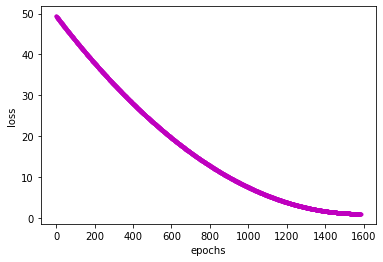

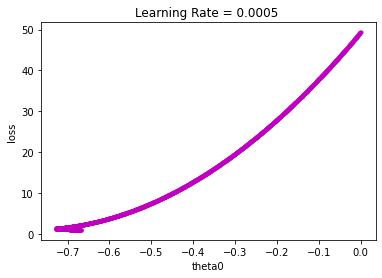

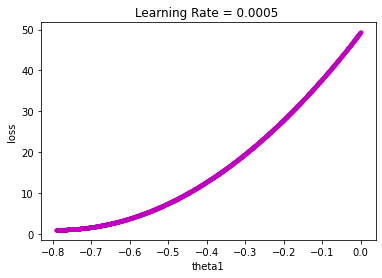

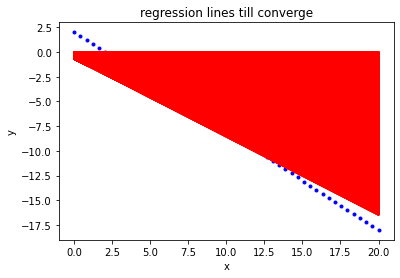

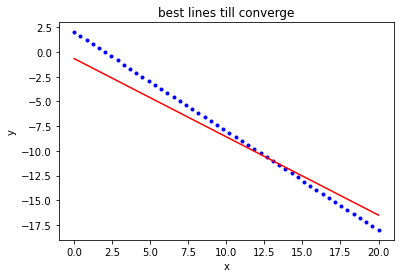

In [ ]:
r2_score(y,h_yhat9[-1])
plot(theta_0s9,theta_1s9,costs9,h_yhat9,lr9)

In [ ]:
r2_score(y,h_yhat9[-1])

0.9467806664053489

### Play with the parameters and see the results

##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s10,theta_1s10,costs10,h_yhat10,lr10= Adam(x,y,0.001,1e-08,5000,.9,0.99)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:0.8
M1_0: 11.469387754644893

M0_0_correct


j(mse):43.559946287984964

Gradient Vector:
[[  7.46464998]
 [107.65179267]]

Gradient Vector Norm:107.91028432656942

M0_49:7.520559156546318
M1_49: 108.3384909881686

M0_49_corrected:7.559519219277892 
M1_49_corrected: 108.8997357463418 

Vt0_49:23.48198608174107
Vt1_49: 4856.340455005241

Vt0_49_corrected:59.44897915664306 
Vt1_49_corrected: 12294.721642461815

theta_0_new :-0.04962077157914091 
theta_1_new :-0.04965309595928499
****************** Iteration 50 ********************

h(x):[-0.04962077 -0.06988734 -0.09015391 -0.11042048 -0.13068705 -0.15095362
 -0.17122019 -0.19148676 -0.21175333 -0.2320199  -0.25228647 -0.27255304
 -0.29281961 -0.31308618 -0.33335275 -0.35361932 -0.37388589 -0.39415246
 -0.41441903 -0.4346856  -0.45495217 -0.47521874 -0.49548531 -0.51575188
 -0.53601845 -0.55628502 -0.57655159 -0.59681816 -0.61708473 -0.63735129
 -0.65761786 -0.67788443 -0.698151   -0.71841757 -0.73868414 -0.75895071
 -0.77921728 -0.79948385 -0.81975042 -0.84001699 -0.86028356 -0.88


j(mse):38.57732171989717

Gradient Vector:
[[  6.97375455]
 [101.19414487]]

Gradient Vector Norm:101.4341570109839

M0_95:7.068780604217558
M1_95: 102.44383475989176

M0_95_corrected:7.069066786663349 
M1_95_corrected: 102.44798224003428 

Vt0_95:33.954991895808824
Vt1_95: 7070.813682926727

Vt0_95_corrected:54.858766941720596 
Vt1_95_corrected: 11423.83190990794

theta_0_new :-0.09410204062336806 
theta_1_new :-0.09426829470607836
****************** Iteration 96 ********************

h(x):[-0.09410204 -0.1325789  -0.17105575 -0.20953261 -0.24800946 -0.28648632
 -0.32496317 -0.36344003 -0.40191688 -0.44039374 -0.47887059 -0.51734745
 -0.5558243  -0.59430116 -0.63277801 -0.67125487 -0.70973172 -0.74820858
 -0.78668543 -0.82516229 -0.86363914 -0.902116   -0.94059285 -0.97906971
 -1.01754656 -1.05602341 -1.09450027 -1.13297712 -1.17145398 -1.20993083
 -1.24840769 -1.28688454 -1.3253614  -1.36383826 -1.40231511 -1.44079197
 -1.47926882 -1.51774568 -1.55622253 -1.59469939 -1.63317624 -1.6


j(mse):35.84835796687713

Gradient Vector:
[[ 6.69104318]
 [97.47495606]]

Gradient Vector Norm:97.70433520747216

M0_122:6.785075773187697
M1_122: 98.71197898233407

M0_122_corrected:6.785091746110234 
M1_122_corrected: 98.71221136275935 

Vt0_122:36.942454812611835
Vt1_122: 7728.302022115852

Vt0_122_corrected:52.067449951616226 
Vt1_122_corrected: 10892.426634575408

theta_0_new :-0.11967179136584592 
theta_1_new :-0.11996835475557503
****************** Iteration 123 ********************

h(x):[-0.11967179 -0.16863847 -0.21760514 -0.26657182 -0.31553849 -0.36450517
 -0.41347184 -0.46243852 -0.51140519 -0.56037187 -0.60933855 -0.65830522
 -0.7072719  -0.75623857 -0.80520525 -0.85417192 -0.9031386  -0.95210527
 -1.00107195 -1.05003862 -1.0990053  -1.14797197 -1.19693865 -1.24590533
 -1.294872   -1.34383868 -1.39280535 -1.44177203 -1.4907387  -1.53970538
 -1.58867205 -1.63763873 -1.6866054  -1.73557208 -1.78453876 -1.83350543
 -1.88247211 -1.93143878 -1.98040546 -2.02937213 -2.0783388


Error Vector:[-2.1420905  -1.79210477 -1.44211904 -1.09213331 -0.74214759 -0.39216185
 -0.04217613  0.30780961  0.65779533  1.00778106  1.35776679  1.70775252
  2.05773825  2.40772398  2.7577097   3.10769544  3.45768116  3.8076669
  4.15765263  4.50763835  4.85762409  5.20760981  5.55759554  5.90758127
  6.257567    6.60755273  6.95753846  7.30752419  7.65750992  8.00749564
  8.35748138  8.7074671   9.05745284  9.40743857  9.75742429 10.10741003
 10.45739575 10.80738148 11.15736721 11.50735294 11.85733867 12.2073244
 12.55731013 12.90729586 13.25728158 13.60726732 13.95725304 14.30723877
 14.6572245  15.00721023]

j(mse):33.44318557419086

Gradient Vector:
[[ 6.43255987]
 [94.07438564]]

Gradient Vector Norm:94.29404997099718

M0_147:6.525483398464016
M1_147: 95.29687781697587

M0_147_corrected:6.525484501282812 
M1_147_corrected: 95.29689392232495 

Vt0_147:38.27073740257877
Vt1_147: 8043.395789631679

Vt0_147_corrected:49.44208540576531 
Vt1_147_corrected: 10391.288189721316

theta_


Error Vector:[-2.1733822  -1.83627537 -1.49916856 -1.16206174 -0.82495493 -0.48784811
 -0.15074129  0.18636553  0.52347234  0.86057916  1.19768598  1.5347928
  1.87189961  2.20900643  2.54611325  2.88322007  3.22032688  3.5574337
  3.89454052  4.23164734  4.56875416  4.90586097  5.24296779  5.58007461
  5.91718143  6.25428824  6.59139506  6.92850188  7.2656087   7.60271551
  7.93982233  8.27692915  8.61403597  8.95114279  9.2882496   9.62535642
  9.96246324 10.29957006 10.63667687 10.97378369 11.31089051 11.64799733
 11.98510414 12.32221096 12.65931778 12.9964246  13.33353141 13.67063823
 14.00774505 14.34485187]

j(mse):30.3509540452812

Gradient Vector:
[[ 6.08573484]
 [89.51142785]]

Gradient Vector Norm:89.71806888644176

M0_181:6.17723761245932
M1_181: 90.71528411585906

M0_181_corrected:6.177237641494934 
M1_181_corrected: 90.71528454225906 

Vt0_181:38.480242655636744
Vt1_181: 8143.878602100021

Vt0_181_corrected:45.83972807987624 
Vt1_181_corrected: 9701.424805882902

theta_0_


j(mse):28.286968737860917

Gradient Vector:
[[ 5.84397802]
 [86.33066059]]

Gradient Vector Norm:86.52823260463616

M0_205:5.934543333762164
M1_205: 87.52222242626196

M0_205_corrected:5.934543335987238 
M1_205_corrected: 87.52222245907718 

Vt0_205:37.83382703904876
Vt1_205: 8050.382139602778

Vt0_205_corrected:43.29502733765231 
Vt1_205_corrected: 9212.430834790151

theta_0_new :-0.1960600092750571 
theta_1_new :-0.19699825538667207
****************** Iteration 206 ********************

h(x):[-0.19606001 -0.27646746 -0.35687491 -0.43728236 -0.51768981 -0.59809727
 -0.67850472 -0.75891217 -0.83931962 -0.91972707 -1.00013452 -1.08054197
 -1.16094942 -1.24135687 -1.32176432 -1.40217178 -1.48257923 -1.56298668
 -1.64339413 -1.72380158 -1.80420903 -1.88461648 -1.96502394 -2.04543139
 -2.12583884 -2.20624629 -2.28665374 -2.36706119 -2.44746864 -2.52787609
 -2.60828354 -2.68869099 -2.76909845 -2.8495059  -2.92991335 -3.0103208
 -3.09072825 -3.1711357  -3.25154315 -3.33195061 -3.41235806 -3


Gradient Vector Norm:82.97713331685746

M0_232:5.664415809134558
M1_232: 83.96810154584995

M0_232_corrected:5.664415809258057 
M1_232_corrected: 83.96810154768066 

Vt0_232:36.560153013564616
Vt1_232: 7830.777842144539

Vt0_232_corrected:40.449864727873475 
Vt1_232_corrected: 8663.910796851778

theta_0_new :-0.2202527922992383 
theta_1_new :-0.22148086649757115
****************** Iteration 233 ********************

h(x):[-0.22025279 -0.31065315 -0.4010535  -0.49145385 -0.58185421 -0.67225456
 -0.76265491 -0.85305527 -0.94345562 -1.03385598 -1.12425633 -1.21465668
 -1.30505704 -1.39545739 -1.48585774 -1.5762581  -1.66665845 -1.7570588
 -1.84745916 -1.93785951 -2.02825987 -2.11866022 -2.20906057 -2.29946093
 -2.38986128 -2.48026163 -2.57066199 -2.66106234 -2.7514627  -2.84186305
 -2.9322634  -3.02266376 -3.11306411 -3.20346446 -3.29386482 -3.38426517
 -3.47466552 -3.56506588 -3.65546623 -3.74586659 -3.83626694 -3.92666729
 -4.01706765 -4.107468   -4.19786835 -4.28826871 -4.37866906 -4.


Error Vector:[-2.24678295 -1.94000042 -1.6332179  -1.32643538 -1.01965286 -0.71287034
 -0.40608782 -0.0993053   0.20747722  0.51425975  0.82104226  1.12782479
  1.4346073   1.74138983  2.04817235  2.35495487  2.66173739  2.96851991
  3.27530244  3.58208495  3.88886748  4.19565     4.50243252  4.80921504
  5.11599756  5.42278008  5.72956261  6.03634512  6.34312765  6.64991016
  6.95669269  7.26347521  7.57025773  7.87704026  8.18382277  8.4906053
  8.79738781  9.10417034  9.41095286  9.71773538 10.0245179  10.33130042
 10.63808294 10.94486546 11.25164798 11.55843051 11.86521302 12.17199555
 12.47877807 12.78556059]

j(mse):23.68300730471904

Gradient Vector:
[[ 5.26938882]
 [78.77040251]]

Gradient Vector Norm:78.94645508461055

M0_263:5.357864850747072
M1_263: 79.93457641189423

M0_263_corrected:5.357864850751529 
M1_263_corrected: 79.93457641196072 

Vt0_263:34.60720171909385
Vt1_263: 7474.223958671346

Vt0_263_corrected:37.22882771505876 
Vt1_263_corrected: 8040.42460062922

theta_0


Error Vector:[-2.27382081 -1.97825482 -1.68268884 -1.38712285 -1.09155687 -0.79599089
 -0.50042491 -0.20485892  0.09070706  0.38627305  0.68183903  0.97740501
  1.27297099  1.56853698  1.86410296  2.15966895  2.45523493  2.75080091
  3.0463669   3.34193288  3.63749887  3.93306485  4.22863083  4.52419681
  4.8197628   5.11532878  5.41089477  5.70646075  6.00202673  6.29759271
  6.5931587   6.88872468  7.18429067  7.47985666  7.77542264  8.07098862
  8.3665546   8.66212059  8.95768657  9.25325256  9.54881854  9.84438452
 10.1399505  10.43551649 10.73108247 11.02664846 11.32221444 11.61778042
 11.9133464  12.20891239]

j(mse):21.434537568240277

Gradient Vector:
[[ 4.96754579]
 [74.79856651]]

Gradient Vector Norm:74.96333813086439

M0_294:5.05497902858944
M1_294: 75.94907868578434

M0_294_corrected:5.0549790285896 
M1_294_corrected: 75.94907868578676 

Vt0_294:32.322775636277434
Vt1_294: 7045.038163195112

Vt0_294_corrected:34.080233698990725 
Vt1_294_corrected: 7428.091873104043

theta

h(x):[-0.29962778 -0.42295829 -0.5462888  -0.66961931 -0.79294981 -0.91628032
 -1.03961082 -1.16294133 -1.28627184 -1.40960235 -1.53293285 -1.65626336
 -1.77959386 -1.90292437 -2.02625488 -2.14958539 -2.27291589 -2.3962464
 -2.51957691 -2.64290741 -2.76623792 -2.88956843 -3.01289893 -3.13622944
 -3.25955995 -3.38289045 -3.50622096 -3.62955147 -3.75288197 -3.87621248
 -3.99954299 -4.12287349 -4.246204   -4.36953451 -4.49286501 -4.61619552
 -4.73952603 -4.86285654 -4.98618704 -5.10951755 -5.23284805 -5.35617856
 -5.47950907 -5.60283958 -5.72617008 -5.84950059 -5.97283109 -6.0961616
 -6.21949211 -6.34282262]

Error Vector:[-2.29962778 -2.01479502 -1.72996227 -1.44512951 -1.16029675 -0.87546399
 -0.59063123 -0.30579847 -0.02096572  0.26386704  0.5486998   0.83353256
  1.11836532  1.40319808  1.68803083  1.97286359  2.25769635  2.54252911
  2.82736187  3.11219463  3.39702739  3.68186014  3.96669291  4.25152566
  4.53635842  4.82119118  5.10602394  5.39085669  5.67568946  5.96052221
  6.2453


Error Vector:[-2.32339614 -2.04847534 -1.77355454 -1.49863374 -1.22371294 -0.94879214
 -0.67387134 -0.39895054 -0.12402974  0.15089107  0.42581186  0.70073267
  0.97565346  1.25057427  1.52549506  1.80041587  2.07533666  2.35025747
  2.62517827  2.90009907  3.17501987  3.44994067  3.72486147  3.99978227
  4.27470307  4.54962387  4.82454467  5.09946547  5.37438627  5.64930707
  5.92422788  6.19914867  6.47406948  6.74899028  7.02391108  7.29883188
  7.57375268  7.84867348  8.12359428  8.39851508  8.67343588  8.94835668
  9.22327748  9.49819828  9.77311908 10.04803988 10.32296068 10.59788148
 10.87280228 11.14772308]

j(mse):17.603511372380318

Gradient Vector:
[[ 4.41216347]
 [67.48990276]]

Gradient Vector Norm:67.63397194337124

M0_352:4.4977156786320585
M1_352: 68.61578849381006

M0_352_corrected:4.497715678632059 
M1_352_corrected: 68.61578849381007 

Vt0_352:27.63707458625015
Vt1_352: 6143.894560159805

Vt0_352_corrected:28.456297489240782 
Vt1_352_corrected: 6326.012936022444

th


Error Vector:[-2.34435479 -2.07819818 -1.81204158 -1.54588497 -1.27972836 -1.01357175
 -0.74741515 -0.48125854 -0.21510193  0.05105468  0.31721128  0.58336789
  0.8495245   1.11568111  1.38183771  1.64799432  1.91415092  2.18030754
  2.44646415  2.71262075  2.97877736  3.24493396  3.51109058  3.77724718
  4.04340379  4.30956039  4.575717    4.84187361  5.10803022  5.37418682
  5.64034343  5.90650004  6.17265665  6.43881326  6.70496986  6.97112647
  7.23728308  7.50343969  7.76959629  8.0357529   8.30190951  8.56806612
  8.83422272  9.10037933  9.36653594  9.63269255  9.89884915 10.16500576
 10.43116237 10.69731898]

j(mse):16.09764758182714

Gradient Vector:
[[ 4.17648209]
 [64.38813256]]

Gradient Vector Norm:64.5234423833718

M0_377:4.261230664046929
M1_377: 65.50350485643371

M0_377_corrected:4.261230664046929 
M1_377_corrected: 65.50350485643371 

Vt0_377:25.57625491758323
Vt1_377: 5741.26942793999

Vt0_377_corrected:26.16209085218595 
Vt1_377_corrected: 5872.775856537984

theta_0


Error Vector:[-2.36752593 -2.11108852 -1.85465111 -1.59821369 -1.34177628 -1.08533887
 -0.82890146 -0.57246404 -0.31602663 -0.05958921  0.1968482   0.45328561
  0.70972302  0.96616044  1.22259785  1.47903527  1.73547268  1.99191009
  2.24834751  2.50478492  2.76122233  3.01765974  3.27409716  3.53053457
  3.78697199  4.0434094   4.29984681  4.55628422  4.81272164  5.06915905
  5.32559647  5.58203388  5.83847129  6.09490871  6.35134612  6.60778353
  6.86422094  7.12065836  7.37709577  7.63353319  7.8899706   8.14640801
  8.40284542  8.65928284  8.91572025  9.17215767  9.42859508  9.68503249
  9.9414699  10.19790732]

j(mse):14.511634376119346

Gradient Vector:
[[ 3.91519069]
 [60.94908705]]

Gradient Vector Norm:61.074707775431236

M0_405:3.99902976340949
M1_405: 62.0525670997352

M0_405_corrected:3.99902976340949 
M1_405_corrected: 62.0525670997352 

Vt0_405:23.297401510143935
Vt1_405: 5292.141149650564

Vt0_405_corrected:23.69789811106008 
Vt1_405_corrected: 5383.116297290127

theta_


j(mse):12.081603363779788

Gradient Vector:
[[ 3.48312148]
 [55.261695  ]]

Gradient Vector Norm:55.37135604197166

M0_452:3.5653799854962513
M1_452: 56.344524710609114

M0_452_corrected:3.5653799854962513 
M1_452_corrected: 56.344524710609114 

Vt0_452:19.62218072472014
Vt1_452: 4559.091050209401

Vt0_452_corrected:19.8311541897674 
Vt1_452_corrected: 4607.644728701821

theta_0_new :-0.4064646081704132 
theta_1_new :-0.41195151908159244
****************** Iteration 453 ********************

h(x):[-0.40646461 -0.57460809 -0.74275156 -0.91089504 -1.07903852 -1.247182
 -1.41532547 -1.58346895 -1.75161242 -1.9197559  -2.08789938 -2.25604286
 -2.42418633 -2.59232981 -2.76047329 -2.92861677 -3.09676024 -3.26490372
 -3.4330472  -3.60119067 -3.76933415 -3.93747763 -4.10562111 -4.27376458
 -4.44190806 -4.61005154 -4.77819502 -4.94633849 -5.11448197 -5.28262544
 -5.45076892 -5.6189124  -5.78705588 -5.95519936 -6.12334283 -6.29148631
 -6.45962979 -6.62777327 -6.79591674 -6.96406022 -7.13220369 

theta_0_new :-0.446648862578257 
theta_1_new :-0.45381419298065234
****************** Iteration 504 ********************

h(x):[-0.44664886 -0.63187915 -0.81710943 -1.00233971 -1.18756999 -1.37280028
 -1.55803056 -1.74326084 -1.92849112 -2.11372141 -2.29895169 -2.48418197
 -2.66941226 -2.85464254 -3.03987282 -3.22510311 -3.41033339 -3.59556367
 -3.78079396 -3.96602424 -4.15125452 -4.3364848  -4.52171509 -4.70694537
 -4.89217565 -5.07740593 -5.26263622 -5.4478665  -5.63309678 -5.81832706
 -6.00355735 -6.18878763 -6.37401791 -6.5592482  -6.74447848 -6.92970876
 -7.11493904 -7.30016933 -7.48539961 -7.6706299  -7.85586018 -8.04109046
 -8.22632074 -8.41155103 -8.59678131 -8.78201159 -8.96724187 -9.15247216
 -9.33770244 -9.52293272]

Error Vector:[-2.44664886e+00 -2.22371588e+00 -2.00078290e+00 -1.77784991e+00
 -1.55491693e+00 -1.33198395e+00 -1.10905097e+00 -8.86117984e-01
 -6.63185004e-01 -4.40252019e-01 -2.17319040e-01  5.61394534e-03
  2.28546925e-01  4.51479910e-01  6.74412889e-01  8.97


j(mse):8.28049095798559

Gradient Vector:
[[ 2.69807398]
 [44.92529376]]

Gradient Vector Norm:45.00623981723536

M0_540:2.777008366156534
M1_540: 45.9647662641822

M0_540_corrected:2.777008366156534 
M1_540_corrected: 45.9647662641822 

Vt0_540:13.508428879560645
Vt1_540: 3311.465844414776

Vt0_540_corrected:13.56746789137597 
Vt1_540_corrected: 3325.938709679682

theta_0_new :-0.4749337288653058 
theta_1_new :-0.483571639085663
****************** Iteration 541 ********************

h(x):[ -0.47493373  -0.67230991  -0.86968609  -1.06706227  -1.26443845
  -1.46181463  -1.6591908   -1.85656698  -2.05394316  -2.25131934
  -2.44869552  -2.6460717   -2.84344788  -3.04082406  -3.23820024
  -3.43557642  -3.63295259  -3.83032878  -4.02770496  -4.22508113
  -4.42245732  -4.61983349  -4.81720967  -5.01458585  -5.21196203
  -5.40933821  -5.60671439  -5.80409057  -6.00146675  -6.19884292
  -6.39621911  -6.59359528  -6.79097146  -6.98834765  -7.18572382
  -7.3831      -7.58047618  -7.77785236  -7


Error Vector:[-2.49652204 -2.29509352 -2.093665   -1.89223648 -1.69080796 -1.48937944
 -1.28795092 -1.0865224  -0.88509388 -0.68366535 -0.48223684 -0.28080831
 -0.0793798   0.12204873  0.32347725  0.52490577  0.72633429  0.92776281
  1.12919133  1.33061985  1.53204837  1.73347689  1.93490541  2.13633393
  2.33776246  2.53919097  2.7406195   2.94204801  3.14347654  3.34490506
  3.54633358  3.7477621   3.94919062  4.15061914  4.35204766  4.55347618
  4.7549047   4.95633322  5.15776174  5.35919027  5.56061878  5.76204731
  5.96347582  6.16490435  6.36633287  6.56776139  6.76918991  6.97061843
  7.17204695  7.37347547]

j(mse):7.197794713268455

Gradient Vector:
[[ 2.43847671]
 [41.5061914 ]]

Gradient Vector Norm:41.577759596060076

M0_570:2.5161080043555466
M1_570: 42.528695543380934

M0_570_corrected:2.5161080043555466 
M1_570_corrected: 42.528695543380934 

Vt0_570:11.695645197130219
Vt1_570: 2932.5680777651264

Vt0_570_corrected:11.733412891127402 
Vt1_570_corrected: 2942.03795581974


Error Vector:[-2.5182483  -2.32633855 -2.13442882 -1.94251907 -1.75060934 -1.55869959
 -1.36678985 -1.17488011 -0.98297037 -0.79106063 -0.59915089 -0.40724115
 -0.21533141 -0.02342167  0.16848807  0.36039781  0.55230755  0.74421729
  0.93612703  1.12803677  1.31994652  1.51185625  1.703766    1.89567573
  2.08758548  2.27949522  2.47140496  2.6633147   2.85522444  3.04713418
  3.23904392  3.43095366  3.6228634   3.81477314  4.00668288  4.19859262
  4.39050236  4.5824121   4.77432184  4.96623159  5.15814132  5.35005107
  5.5419608   5.73387055  5.92578029  6.11769003  6.30959977  6.50150951
  6.69341925  6.88532899]

j(mse):6.218780135296702

Gradient Vector:
[[ 2.18354035]
 [38.14773141]]

Gradient Vector Norm:38.21017220320625

M0_600:2.25974976506323
M1_600: 39.15173942377404

M0_600_corrected:2.25974976506323 
M1_600_corrected: 39.15173942377404 

Vt0_600:10.02961976512205
Vt1_600: 2579.3397592034876

Vt0_600_corrected:10.05355687383743 
Vt1_600_corrected: 2585.495719018102

theta_


M0_633:1.9835239617674079
M1_633: 35.51207528178079

M0_633_corrected:1.9835239617674079 
M1_633_corrected: 35.51207528178079 

Vt0_633:8.368146358604568
Vt1_633: 2221.015975319687

Vt0_633_corrected:8.382471055370887 
Vt1_633_corrected: 2224.8179380239953

theta_0_new :-0.5420220498845103 
theta_1_new :-0.5557148046644805
****************** Iteration 634 ********************

h(x):[ -0.54202205  -0.76884442  -0.99566679  -1.22248916  -1.44931153
  -1.6761339   -1.90295626  -2.12977864  -2.356601    -2.58342337
  -2.81024574  -3.03706811  -3.26389048  -3.49071285  -3.71753522
  -3.94435759  -4.17117996  -4.39800233  -4.6248247   -4.85164707
  -5.07846944  -5.3052918   -5.53211418  -5.75893654  -5.98575891
  -6.21258128  -6.43940365  -6.66622602  -6.89304839  -7.11987076
  -7.34669313  -7.57351549  -7.80033787  -8.02716024  -8.2539826
  -8.48080498  -8.70762734  -8.93444971  -9.16127208  -9.38809445
  -9.61491682  -9.84173919 -10.06856156 -10.29538393 -10.52220629
 -10.74902867 -10.975


j(mse):4.559258798182884

Gradient Vector:
[[ 1.68957304]
 [31.6374267 ]]

Gradient Vector Norm:31.682509771441477

M0_660:1.762485189804568
M1_660: 32.59862224235562

M0_660_corrected:1.762485189804568 
M1_660_corrected: 32.59862224235562 

Vt0_660:7.141729208476682
Vt1_660: 1951.520837313527

Vt0_660_corrected:7.151045287363535 
Vt1_660_corrected: 1954.066512392914

theta_0_new :-0.5601632276655669 
theta_1_new :-0.5758297268703645
****************** Iteration 661 ********************

h(x):[ -0.56016323  -0.79519577  -1.03022831  -1.26526085  -1.50029339
  -1.73532594  -1.97035848  -2.20539102  -2.44042356  -2.6754561
  -2.91048864  -3.14552119  -3.38055372  -3.61558627  -3.85061881
  -4.08565135  -4.32068389  -4.55571643  -4.79074898  -5.02578152
  -5.26081406  -5.4958466   -5.73087914  -5.96591168  -6.20094423
  -6.43597677  -6.67100931  -6.90604185  -7.14107439  -7.37610693
  -7.61113948  -7.84617201  -8.08120456  -8.3162371   -8.55126964
  -8.78630219  -9.02133472  -9.25636727 


Error Vector:[-2.58005528 -2.41612967 -2.25220406 -2.08827844 -1.92435283 -1.76042722
 -1.59650161 -1.432576   -1.26865039 -1.10472478 -0.94079917 -0.77687355
 -0.61294795 -0.44902233 -0.28509672 -0.12117111  0.0427545   0.20668011
  0.37060572  0.53453133  0.69845695  0.86238256  1.02630817  1.19023378
  1.35415939  1.518085    1.68201061  1.84593622  2.00986184  2.17378744
  2.33771306  2.50163867  2.66556428  2.82948989  2.9934155   3.15734111
  3.32126672  3.48519234  3.64911795  3.81304356  3.97696917  4.14089478
  4.30482039  4.468746    4.63267161  4.79659723  4.96052283  5.12444845
  5.28837406  5.45229967]

j(mse):3.8292294553812063

Gradient Vector:
[[ 1.4361222 ]
 [28.29489891]]

Gradient Vector Norm:28.331321025822934

M0_692:1.506963989328756
M1_692: 29.229272203792682

M0_692_corrected:1.506963989328756 
M1_692_corrected: 29.229272203792682 

Vt0_692:5.841073518870623
Vt1_692: 1659.5661791352109

Vt0_692_corrected:5.846595474367001 
Vt1_692_corrected: 1661.1350774815292



M0_720_corrected:1.2897849032587134 
M1_720_corrected: 26.363955409397697 

Vt0_720:4.836125972905653
Vt1_720: 1428.200584401065

Vt0_720_corrected:4.839575682930277 
Vt1_720_corrected: 1429.2193498138736

theta_0_new :-0.5976070202863175 
theta_1_new :-0.6188976559889015
****************** Iteration 721 ********************

h(x):[ -0.59760702  -0.85021831  -1.1028296   -1.35544089  -1.60805217
  -1.86066346  -2.11327475  -2.36588604  -2.61849732  -2.87110862
  -3.1237199   -3.37633119  -3.62894248  -3.88155377  -4.13416505
  -4.38677634  -4.63938763  -4.89199892  -5.14461021  -5.39722149
  -5.64983279  -5.90244407  -6.15505536  -6.40766665  -6.66027794
  -6.91288922  -7.16550051  -7.4181118   -7.67072309  -7.92333437
  -8.17594567  -8.42855695  -8.68116824  -8.93377953  -9.18639082
  -9.43900211  -9.69161339  -9.94422468 -10.19683597 -10.44944726
 -10.70205855 -10.95466984 -11.20728112 -11.45989241 -11.7125037
 -11.96511499 -12.21772627 -12.47033756 -12.72294885 -12.97556014]

Error


j(mse):2.714812811134118

Gradient Vector:
[[ 0.97639869]
 [22.22589706]]

Gradient Vector Norm:22.247333652152513

M0_753:1.042495826269212
M1_753: 23.09899029420645

M0_753_corrected:1.042495826269212 
M1_753_corrected: 23.09899029420645 

Vt0_753:3.8061883621453525
Vt1_753: 1183.7461360444647

Vt0_753_corrected:3.808136632618451 
Vt1_753_corrected: 1184.352059195152

theta_0_new :-0.6160978835753352 
theta_1_new :-0.6414749657518477
****************** Iteration 754 ********************

h(x):[ -0.61609788  -0.8779244   -1.13975092  -1.40157744  -1.66340395
  -1.92523047  -2.18705698  -2.4488835   -2.71071002  -2.97253653
  -3.23436305  -3.49618957  -3.75801608  -4.0198426   -4.28166911
  -4.54349563  -4.80532215  -5.06714867  -5.32897519  -5.5908017
  -5.85262822  -6.11445473  -6.37628125  -6.63810776  -6.89993428
  -7.1617608   -7.42358732  -7.68541383  -7.94724035  -8.20906686
  -8.47089338  -8.7327199   -8.99454642  -9.25637294  -9.51819945
  -9.78002597 -10.04185248 -10.303679 


j(mse):2.264692224282453

Gradient Vector:
[[ 0.74980497]
 [19.22991879]]

Gradient Vector Norm:19.244531277621373

M0_785:0.8128877909340061
M1_785: 20.06422700557094

M0_785_corrected:0.8128877909340061 
M1_785_corrected: 20.06422700557094 

Vt0_785:2.9604892922185626
Vt1_785: 974.9811669285687

Vt0_785_corrected:2.9615877605991536 
Vt1_785_corrected: 975.3429267181946

theta_0_new :-0.6322061053579453 
theta_1_new :-0.6624885840552999
****************** Iteration 786 ********************

h(x):[ -0.63220611  -0.90260961  -1.17301311  -1.44341662  -1.71382012
  -1.98422363  -2.25462713  -2.52503063  -2.79543413  -3.06583764
  -3.33624114  -3.60664465  -3.87704815  -4.14745165  -4.41785515
  -4.68825866  -4.95866216  -5.22906567  -5.49946917  -5.76987268
  -6.04027618  -6.31067968  -6.58108319  -6.85148669  -7.1218902
  -7.3922937   -7.6626972   -7.9331007   -8.20350421  -8.47390771
  -8.74431122  -9.01471472  -9.28511822  -9.55552173  -9.82592523
 -10.09632874 -10.36673224 -10.63713


M0_812:0.6280491295529842
M1_812: 17.617896276140968

M0_812_corrected:0.6280491295529842 
M1_812_corrected: 17.617896276140968 

Vt0_812:2.358157002386705
Vt1_812: 819.6743174893

Vt0_812_corrected:2.358823976135964 
Vt1_812_corrected: 819.9061516089765

theta_0_new :-0.6440978263216292 
theta_1_new :-0.6794607796428358
****************** Iteration 813 ********************

h(x):[ -0.64409783  -0.92142876  -1.19875969  -1.47609062  -1.75342155
  -2.03075248  -2.30808341  -2.58541434  -2.86274527  -3.1400762
  -3.41740713  -3.69473806  -3.97206899  -4.24939992  -4.52673085
  -4.80406178  -5.08139271  -5.35872364  -5.63605458  -5.9133855
  -6.19071644  -6.46804737  -6.7453783   -7.02270923  -7.30004016
  -7.57737109  -7.85470202  -8.13203295  -8.40936388  -8.68669481
  -8.96402574  -9.24135667  -9.5186876   -9.79601854 -10.07334946
 -10.3506804  -10.62801132 -10.90534226 -11.18267318 -11.46000412
 -11.73733504 -12.01466598 -12.2919969  -12.56932784 -12.84665876
 -13.1239897  -13.401320


Error Vector:[-2.65602926 -2.53323107 -2.41043288 -2.28763468 -2.1648365  -2.0420383
 -1.91924012 -1.79644192 -1.67364373 -1.55084554 -1.42804735 -1.30524916
 -1.18245097 -1.05965278 -0.93685459 -0.8140564  -0.69125821 -0.56846002
 -0.44566183 -0.32286364 -0.20006545 -0.07726726  0.04553093  0.16832912
  0.29112731  0.4139255   0.53672369  0.65952188  0.78232008  0.90511826
  1.02791646  1.15071464  1.27351284  1.39631103  1.51910922  1.64190741
  1.7647056   1.88750379  2.01030198  2.13310017  2.25589836  2.37869655
  2.50149474  2.62429293  2.74709112  2.86988931  2.9926875   3.11548569
  3.23828388  3.36108207]

j(mse):1.6322794977123585

Gradient Vector:
[[ 0.35252641]
 [13.96311027]]

Gradient Vector Norm:13.967559671628505

M0_846:0.40855448104161585
M1_846: 14.70713403186696

M0_846_corrected:0.40855448104161585 
M1_846_corrected: 14.70713403186696 

Vt0_846:1.7351999031531256
Vt1_846: 649.944115045218

Vt0_846_corrected:1.7355485988624322 
Vt1_846_corrected: 650.0747240452494



j(mse):1.280239727609459

Gradient Vector:
[[0.04799317]
 [9.90081538]]

Gradient Vector Norm:9.900931696708074

M0_900:0.09599217176042868
M1_900: 10.542970076587359

M0_900_corrected:0.09599217176042868 
M1_900_corrected: 10.542970076587359 

Vt0_900:1.0251149015400287
Vt1_900: 435.22330811611204

Vt0_900_corrected:1.0252346124114313 
Vt1_900_corrected: 435.27413262504365

theta_0_new :-0.6675328003866721 
theta_1_new :-0.7289622205497612
****************** Iteration 901 ********************

h(x):[ -0.6675328   -0.9650684   -1.262604    -1.5601396   -1.8576752
  -2.1552108   -2.4527464   -2.750282    -3.0478176   -3.3453532
  -3.6428888   -3.9404244   -4.23796     -4.5354956   -4.8330312
  -5.1305668   -5.4281024   -5.725638    -6.02317361  -6.3207092
  -6.61824481  -6.9157804   -7.21331601  -7.5108516   -7.80838721
  -8.1059228   -8.40345841  -8.700994    -8.99852961  -9.2960652
  -9.59360081  -9.8911364  -10.18867201 -10.48620761 -10.78374321
 -11.08127881 -11.37881441 -11.676350


theta_0_new :-0.6640178443946191 
theta_1_new :-0.755258363906978
****************** Iteration 958 ********************

h(x):[ -0.66401784  -0.97228657  -1.28055528  -1.58882401  -1.89709272
  -2.20536145  -2.51363016  -2.82189889  -3.1301676   -3.43843633
  -3.74670504  -4.05497377  -4.36324248  -4.6715112   -4.97977992
  -5.28804864  -5.59631736  -5.90458608  -6.21285481  -6.52112352
  -6.82939225  -7.13766096  -7.44592969  -7.7541984   -8.06246713
  -8.37073584  -8.67900456  -8.98727328  -9.295542    -9.60381072
  -9.91207944 -10.22034816 -10.52861688 -10.83688561 -11.14515432
 -11.45342305 -11.76169176 -12.06996049 -12.3782292  -12.68649793
 -12.99476664 -13.30303536 -13.61130408 -13.9195728  -14.22784152
 -14.53611024 -14.84437896 -15.15264768 -15.4609164  -15.76918512]

Error Vector:[-2.66401784 -2.5641233  -2.46422875 -2.36433421 -2.26443966 -2.16454512
 -2.06465057 -1.96475603 -1.86486148 -1.76496694 -1.66507239 -1.56517785
 -1.4652833  -1.36538875 -1.26549421 -1.16559966 -1.


j(mse):0.9492801677610371

Gradient Vector:
[[-0.40274576]
 [ 3.73404547]]

Gradient Vector Norm:3.7557022888018374

M0_1015:-0.37734999047600554
M1_1015: 4.093318120412267

M0_1015_corrected:-0.37734999047600554 
M1_1015_corrected: 4.093318120412267 

Vt0_1015:0.3745614592949952
Vt1_1015: 162.87097126347888

Vt0_1015_corrected:0.3745752281163063 
Vt1_1015_corrected: 162.87695837519163

theta_0_new :-0.6392683016843818 
theta_1_new :-0.7766068239334574
****************** Iteration 1016 ********************

h(x):[ -0.6392683   -0.95625068  -1.27323306  -1.59021544  -1.90719781
  -2.22418019  -2.54116256  -2.85814494  -3.17512732  -3.4921097
  -3.80909207  -4.12607445  -4.44305682  -4.7600392   -5.07702158
  -5.39400396  -5.71098633  -6.02796871  -6.34495109  -6.66193347
  -6.97891585  -7.29589822  -7.6128806   -7.92986297  -8.24684535
  -8.56382773  -8.88081011  -9.19779248  -9.51477486  -9.83175724
 -10.14873962 -10.46572199 -10.78270437 -11.09968675 -11.41666912
 -11.7336515  -12.05

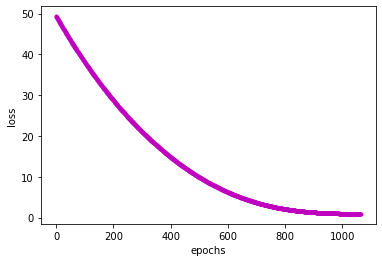

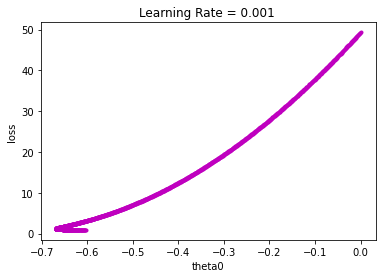

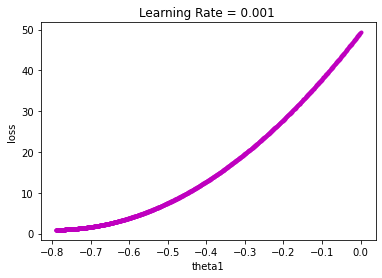

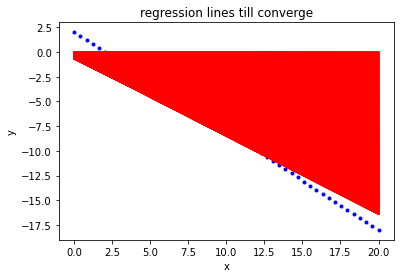

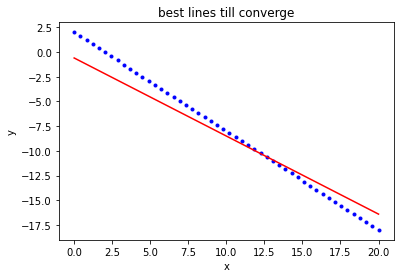

In [ ]:
r2_score(y,h_yhat10[-1])
plot(theta_0s10,theta_1s10,costs10,h_yhat10,lr10)

r2 score =  0.9485667803280174


##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.5, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s11,theta_1s11,costs11,h_yhat11,lr11= Adam(x,y,0.001,1e-08,5000,.9,0.5)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:0.8
M1_0: 11.469387754644893

M0_0_correct


Error Vector:[-2.04835545 -1.65991667 -1.2714779  -0.88303913 -0.49460036 -0.10616158
  0.28227719  0.67071596  1.05915473  1.44759351  1.83603228  2.22447105
  2.61290982  3.0013486   3.38978737  3.77822614  4.16666491  4.55510369
  4.94354246  5.33198123  5.72042001  6.10885878  6.49729755  6.88573632
  7.2741751   7.66261387  8.05105264  8.43949141  8.82793019  9.21636896
  9.60480773  9.9932465  10.38168528 10.77012406 11.15856282 11.5470016
 11.93544037 12.32387915 12.71231791 13.10075669 13.48919546 13.87763424
 14.266073   14.65451178 15.04295055 15.43138933 15.81982809 16.20826687
 16.59670564 16.98514441]

j(mse):43.599325396417534

Gradient Vector:
[[  7.46839448]
 [107.70124051]]

Gradient Vector Norm:107.95987274455075

M0_48:7.521903245477079
M1_48: 108.35088535984914

M0_48_corrected:7.56522487704275 
M1_48_corrected: 108.97492118990269 

Vt0_48:55.943306524454954
Vt1_48: 11631.11341516874

Vt0_48_corrected:55.94330652445505 
Vt1_48_corrected: 11631.11341516876

theta_0_


Error Vector:[-2.09694216 -1.72831297 -1.35968379 -0.9910546  -0.62242541 -0.25379622
  0.11483296  0.48346215  0.85209133  1.22072052  1.5893497   1.9579789
  2.32660808  2.69523727  3.06386645  3.43249564  3.80112482  4.16975401
  4.53838321  4.90701239  5.27564158  5.64427076  6.01289995  6.38152913
  6.75015832  7.11878751  7.4874167   7.85604588  8.22467507  8.59330425
  8.96193344  9.33056262  9.69919181 10.06782101 10.43645019 10.80507938
 11.17370856 11.54233775 11.91096693 12.27959612 12.64822531 13.0168545
 13.38548368 13.75411287 14.12274205 14.49137124 14.86000042 15.22862962
 15.5972588  15.96588799]

j(mse):38.19274087079771

Gradient Vector:
[[  6.93447291]
 [100.67821001]]

Gradient Vector Norm:100.91674234413183

M0_96:7.034318144850491
M1_96: 101.99119525421692

M0_96_corrected:7.034574452310069 
M1_96_corrected: 101.99491147853556 

Vt0_96:48.24162623295055
Vt1_96: 10165.64079672737

Vt0_96_corrected:48.24162623295055 
Vt1_96_corrected: 10165.64079672737

theta_0_ne


Gradient Vector Norm:95.33634952655314

M0_134:6.611640233850854
M1_134: 96.43178173764915

M0_134_corrected:6.611644629755637 
M1_134_corrected: 96.43184585259121 

Vt0_134:42.54418161412097
Vt1_134: 9074.549857474347

Vt0_134_corrected:42.54418161412097 
Vt1_134_corrected: 9074.549857474347

theta_0_new :-0.13645785753643744 
theta_1_new :-0.1363243872396928
****************** Iteration 135 ********************

h(x):[-0.13645786 -0.19210047 -0.24774307 -0.30338568 -0.35902829 -0.41467089
 -0.4703135  -0.52595611 -0.58159871 -0.63724132 -0.69288393 -0.74852654
 -0.80416914 -0.85981175 -0.91545436 -0.97109696 -1.02673957 -1.08238218
 -1.13802478 -1.19366739 -1.24931    -1.30495261 -1.36059521 -1.41623782
 -1.47188043 -1.52752303 -1.58316564 -1.63880825 -1.69445085 -1.75009346
 -1.80573607 -1.86137868 -1.91702128 -1.97266389 -2.0283065  -2.0839491
 -2.13959171 -2.19523432 -2.25087692 -2.30651953 -2.36216214 -2.41780475
 -2.47344735 -2.52908996 -2.58473257 -2.64037517 -2.69601778 -2.75


Error Vector:[-2.16890769 -1.82961314 -1.49031859 -1.15102404 -0.81172949 -0.47243494
 -0.13314039  0.20615416  0.5454487   0.88474326  1.2240378   1.56333236
  1.9026269   2.24192146  2.581216    2.92051056  3.2598051   3.59909966
  3.93839421  4.27768876  4.61698331  4.95627786  5.29557241  5.63486695
  5.97416151  6.31345605  6.65275061  6.99204515  7.33133971  7.67063425
  8.00992881  8.34922335  8.68851791  9.02781246  9.36710701  9.70640156
 10.04569611 10.38499066 10.7242852  11.06357976 11.4028743  11.74216886
 12.0814634  12.42075796 12.7600525  13.09934706 13.4386416  13.77793616
 14.1172307  14.45652526]

j(mse):30.86014559891706

Gradient Vector:
[[ 6.14380878]
 [90.27812456]]

Gradient Vector Norm:90.48693916753149

M0_167:6.2440846961979375
M1_167: 91.5971110380654

M0_167_corrected:6.244084824493129 
M1_167_corrected: 91.59711292008166 

Vt0_167:37.883687551109944
Vt1_167: 8176.669883552453

Vt0_167_corrected:37.883687551109944 
Vt1_167_corrected: 8176.669883552453

the


Error Vector:[-2.20341546 -1.87818341 -1.55295137 -1.22771932 -0.90248728 -0.57725523
 -0.25202319  0.07320886  0.39844091  0.72367296  1.048905    1.37413705
  1.69936909  2.02460114  2.34983318  2.67506523  3.00029727  3.32552932
  3.65076137  3.97599341  4.30122546  4.6264575   4.95168955  5.27692159
  5.60215364  5.92738568  6.25261773  6.57784978  6.90308183  7.22831387
  7.55354592  7.87877796  8.20401001  8.52924206  8.8544741   9.17970615
  9.50493819  9.83017024 10.15540228 10.48063433 10.80586637 11.13109842
 11.45633046 11.78156251 12.10679456 12.4320266  12.75725865 13.0824907
 13.40772274 13.73295479]

j(mse):27.63019852201013

Gradient Vector:
[[ 5.76476966]
 [85.29242053]]

Gradient Vector Norm:85.48701404044327

M0_201:5.865120825050668
M1_201: 86.61239173522236

M0_201_corrected:5.865120828402358 
M1_201_corrected: 86.612391784718 

Vt0_201:33.36152208667673
Vt1_201: 7299.884734048694

Vt0_201_corrected:33.36152208667673 
Vt1_201_corrected: 7299.884734048694

theta_0_

M0_227_corrected:5.575123319070657 
M1_227_corrected: 82.79791003640491 

Vt0_227:30.09499590028836
Vt1_227: 6662.5027033045

Vt0_227_corrected:30.09499590028836 
Vt1_227_corrected: 6662.5027033045

theta_0_new :-0.23084329353199637 
theta_1_new :-0.23056083290938087
****************** Iteration 228 ********************

h(x):[-0.23084329 -0.32494976 -0.41905622 -0.51316268 -0.60726914 -0.70137561
 -0.79548207 -0.88958853 -0.98369499 -1.07780146 -1.17190792 -1.26601438
 -1.36012084 -1.45422731 -1.54833377 -1.64244023 -1.73654669 -1.83065315
 -1.92475962 -2.01886608 -2.11297254 -2.207079   -2.30118547 -2.39529193
 -2.48939839 -2.58350485 -2.67761132 -2.77171778 -2.86582424 -2.9599307
 -3.05403717 -3.14814363 -3.24225009 -3.33635655 -3.43046302 -3.52456948
 -3.61867594 -3.7127824  -3.80688886 -3.90099533 -3.99510179 -4.08920825
 -4.18331471 -4.27742118 -4.37152764 -4.4656341  -4.55974056 -4.65384703
 -4.74795349 -4.84205995]

Error Vector:[-2.23084329 -1.91678649 -1.60272969 -1.28867288 


j(mse):22.62468872525491

Gradient Vector:
[[ 5.12860347]
 [76.92464026]]

Gradient Vector Norm:77.09541394906266

M0_258:5.229102709350292
M1_258: 78.24654788021539

M0_258_corrected:5.229102709357658 
M1_258_corrected: 78.24654788032561 

Vt0_258:26.41751191072867
Vt1_258: 5940.067324080534

Vt0_258_corrected:26.41751191072867 
Vt1_258_corrected: 5940.067324080534

theta_0_new :-0.26236490739704726 
theta_1_new :-0.26202014131792506
****************** Iteration 259 ********************

h(x):[-0.26236491 -0.36931191 -0.4762589  -0.5832059  -0.69015289 -0.79709989
 -0.90404689 -1.01099388 -1.11794088 -1.22488788 -1.33183487 -1.43878187
 -1.54572886 -1.65267586 -1.75962286 -1.86656985 -1.97351685 -2.08046385
 -2.18741084 -2.29435784 -2.40130484 -2.50825183 -2.61519883 -2.72214583
 -2.82909282 -2.93603982 -3.04298682 -3.14993381 -3.25688081 -3.3638278
 -3.4707748  -3.5777218  -3.68466879 -3.79161579 -3.89856279 -4.00550978
 -4.11245678 -4.21940378 -4.32635077 -4.43329777 -4.54024477 -4


M0_288:4.893950033517497
M1_288: 73.83816026074172

M0_288_corrected:4.893950033517789 
M1_288_corrected: 73.83816026074612 

Vt0_288:23.08384070932365
Vt1_288: 5279.8241769232845

Vt0_288_corrected:23.08384070932365 
Vt1_288_corrected: 5279.8241769232845

theta_0_new :-0.29290479488359 
theta_1_new :-0.2924916730558827
****************** Iteration 289 ********************

h(x):[-0.29290479 -0.41228915 -0.53167351 -0.65105787 -0.77044222 -0.88982658
 -1.00921093 -1.12859529 -1.24797964 -1.367364   -1.48674836 -1.60613272
 -1.72551707 -1.84490143 -1.96428578 -2.08367014 -2.2030545  -2.32243885
 -2.44182321 -2.56120757 -2.68059192 -2.79997628 -2.91936064 -3.03874499
 -3.15812935 -3.2775137  -3.39689806 -3.51628242 -3.63566677 -3.75505113
 -3.87443549 -3.99381984 -4.1132042  -4.23258856 -4.35197291 -4.47135727
 -4.59074162 -4.71012598 -4.82951034 -4.94889469 -5.06827905 -5.18766341
 -5.30704776 -5.42643212 -5.54581647 -5.66520083 -5.78458519 -5.90396954
 -6.0233539  -6.14273826]

Error 


j(mse):18.058514764050003

Gradient Vector:
[[ 4.48015921]
 [68.39545373]]

Gradient Vector Norm:68.54203030195673

M0_316:4.5808470297309976
M1_316: 69.7198255965763

M0_316_corrected:4.580847029731012 
M1_316_corrected: 69.71982559657651 

Vt0_316:20.17247507603621
Vt1_316: 4698.137983772893

Vt0_316_corrected:20.17247507603621 
Vt1_316_corrected: 4698.137983772893

theta_0_new :-0.3214443742480788 
theta_1_new :-0.3209588036885897
****************** Iteration 317 ********************

h(x):[-0.32144437 -0.45244797 -0.58345156 -0.71445516 -0.84545875 -0.97646234
 -1.10746593 -1.23846953 -1.36947312 -1.50047672 -1.63148031 -1.7624839
 -1.89348749 -2.02449109 -2.15549468 -2.28649827 -2.41750187 -2.54850546
 -2.67950906 -2.81051265 -2.94151624 -3.07251983 -3.20352343 -3.33452702
 -3.46553062 -3.59653421 -3.7275378  -3.85854139 -3.98954499 -4.12054858
 -4.25155217 -4.38255577 -4.51355936 -4.64456296 -4.77556655 -4.90657014
 -5.03757373 -5.16857733 -5.29958092 -5.43058452 -5.56158811 -5.


j(mse):16.044755179056338

Gradient Vector:
[[ 4.1666263 ]
 [64.27150465]]

Gradient Vector Norm:64.40642114885863

M0_344:4.267423459582265
M1_344: 65.5973041710733

M0_344_corrected:4.2674234595822655 
M1_344_corrected: 65.59730417107332 

Vt0_344:17.454511640805844
Vt1_344: 4149.833420433051

Vt0_344_corrected:17.454511640805844 
Vt1_344_corrected: 4149.833420433051

theta_0_new :-0.35002362179150015 
theta_1_new :-0.3494554398379267
****************** Iteration 345 ********************

h(x):[-0.35002362 -0.4926585  -0.63529337 -0.77792824 -0.92056311 -1.06319799
 -1.20583286 -1.34846774 -1.49110261 -1.63373748 -1.77637235 -1.91900723
 -2.0616421  -2.20427698 -2.34691185 -2.48954672 -2.63218159 -2.77481647
 -2.91745134 -3.06008622 -3.20272109 -3.34535596 -3.48799084 -3.63062571
 -3.77326058 -3.91589546 -4.05853033 -4.2011652  -4.34380008 -4.48643495
 -4.62906982 -4.7717047  -4.91433957 -5.05697445 -5.19960932 -5.34224419
 -5.48487906 -5.62751394 -5.77014881 -5.91278369 -6.05541856

M0_374_corrected:3.9312071285654695 
M1_374_corrected: 61.175025658131574 

Vt0_374:14.75733213568354
Vt1_374: 3599.4478019033627

Vt0_374_corrected:14.75733213568354 
Vt1_374_corrected: 3599.4478019033627

theta_0_new :-0.3806954972860863 
theta_1_new :-0.3800248758882234
****************** Iteration 375 ********************

h(x):[-0.3806955  -0.53580769 -0.69091989 -0.84603208 -1.00114427 -1.15625647
 -1.31136866 -1.46648086 -1.62159305 -1.77670525 -1.93181744 -2.08692963
 -2.24204183 -2.39715402 -2.55226622 -2.70737841 -2.8624906  -3.0176028
 -3.172715   -3.32782719 -3.48293938 -3.63805158 -3.79316377 -3.94827596
 -4.10338816 -4.25850035 -4.41361255 -4.56872474 -4.72383694 -4.87894913
 -5.03406132 -5.18917352 -5.34428571 -5.49939791 -5.6545101  -5.8096223
 -5.96473449 -6.11984669 -6.27495888 -6.43007107 -6.58518327 -6.74029546
 -6.89540765 -7.05051985 -7.20563204 -7.36074424 -7.51585643 -7.67096863
 -7.82608082 -7.98119302]

Error Vector:[-2.3806955  -2.12764442 -1.87459336 -1.6215


j(mse):12.329531573016439

Gradient Vector:
[[ 3.52712991]
 [55.86023519]]

Gradient Vector Norm:55.97147952686659

M0_401:3.628200813454637
M1_401: 57.18960557211184

M0_401_corrected:3.628200813454637 
M1_401_corrected: 57.18960557211184 

Vt0_401:12.520278584091795
Vt1_401: 3136.9404862393994

Vt0_401_corrected:12.520278584091795 
Vt1_401_corrected: 3136.9404862393994

theta_0_new :-0.4083535149125553 
theta_1_new :-0.4075752851657783
****************** Iteration 402 ********************

h(x):[-0.40835351 -0.57471078 -0.74106803 -0.90742529 -1.07378255 -1.24013981
 -1.40649707 -1.57285433 -1.73921159 -1.90556885 -2.07192611 -2.23828337
 -2.40464062 -2.57099789 -2.73735514 -2.9037124  -3.07006966 -3.23642692
 -3.40278418 -3.56914144 -3.7354987  -3.90185596 -4.06821322 -4.23457048
 -4.40092774 -4.567285   -4.73364226 -4.89999951 -5.06635677 -5.23271403
 -5.39907129 -5.56542855 -5.73178581 -5.89814307 -6.06450033 -6.23085759
 -6.39721485 -6.56357211 -6.72992937 -6.89628663 -7.0626438


Error Vector:[-2.43298857 -2.20119235 -1.96939614 -1.73759992 -1.50580371 -1.27400749
 -1.04221127 -0.81041505 -0.57861884 -0.34682262 -0.1150264   0.11676982
  0.34856603  0.58036225  0.81215846  1.04395468  1.2757509   1.50754712
  1.73934334  1.97113955  2.20293577  2.43473199  2.6665282   2.89832442
  3.13012064  3.36191685  3.59371307  3.82550929  4.05730551  4.28910172
  4.52089794  4.75269415  4.98449037  5.21628659  5.44808281  5.67987903
  5.91167524  6.14347146  6.37526768  6.6070639   6.83886011  7.07065633
  7.30245254  7.53424876  7.76604498  7.9978412   8.22963741  8.46143363
  8.69322984  8.92502606]

j(mse):10.86290160438941

Gradient Vector:
[[ 3.24601875]
 [52.16286591]]

Gradient Vector Norm:52.26376581613848

M0_426:3.3472383490676854
M1_426: 53.4941739036931

M0_426_corrected:3.3472383490676854 
M1_426_corrected: 53.4941739036931 

Vt0_426:10.610067506536886
Vt1_426: 2736.470111332087

Vt0_426_corrected:10.610067506536886 
Vt1_426_corrected: 2736.470111332087

the

h(x):[-0.4731445  -0.66581126 -0.85847802 -1.05114478 -1.24381153 -1.4364783
 -1.62914505 -1.82181181 -2.01447857 -2.20714533 -2.39981209 -2.59247885
 -2.78514561 -2.97781237 -3.17047912 -3.36314589 -3.55581264 -3.7484794
 -3.94114617 -4.13381292 -4.32647968 -4.51914644 -4.7118132  -4.90447996
 -5.09714672 -5.28981348 -5.48248024 -5.675147   -5.86781376 -6.06048051
 -6.25314727 -6.44581403 -6.63848079 -6.83114755 -7.02381431 -7.21648107
 -7.40914783 -7.60181459 -7.79448135 -7.98714811 -8.17981487 -8.37248163
 -8.56514838 -8.75781515 -8.9504819  -9.14314866 -9.33581542 -9.52848218
 -9.72114894 -9.9138157 ]

Error Vector:[-2.4731445  -2.25764799 -2.04215149 -1.82665498 -1.61115847 -1.39566197
 -1.18016546 -0.96466895 -0.74917245 -0.53367594 -0.31817944 -0.10268293
  0.11281357  0.32831008  0.54380659  0.75930309  0.9747996   1.19029611
  1.40579261  1.62128912  1.83678563  2.05228213  2.26777864  2.48327514
  2.69877165  2.91426815  3.12976466  3.34526116  3.56075767  3.77625418
  3.9917


Gradient Vector Norm:41.249173628602094

M0_500:2.5126781571567838
M1_500: 42.51780684953469

M0_500_corrected:2.5126781571567838 
M1_500_corrected: 42.51780684953469 

Vt0_500:5.867205067653513
Vt1_500: 1708.0126712498534

Vt0_500_corrected:5.867205067653513 
Vt1_500_corrected: 1708.0126712498534

theta_0_new :-0.5103877843296148 
theta_1_new :-0.5090081663995535
****************** Iteration 501 ********************

h(x):[ -0.51038778  -0.71814622  -0.92590465  -1.13366309  -1.34142152
  -1.54917996  -1.75693839  -1.96469683  -2.17245527  -2.3802137
  -2.58797214  -2.79573057  -3.00348901  -3.21124744  -3.41900588
  -3.62676431  -3.83452275  -4.04228118  -4.25003962  -4.45779805
  -4.66555649  -4.87331492  -5.08107336  -5.28883179  -5.49659023
  -5.70434866  -5.9121071   -6.11986553  -6.32762397  -6.53538241
  -6.74314084  -6.95089928  -7.15865771  -7.36641615  -7.57417458
  -7.78193302  -7.98969145  -8.19744989  -8.40520832  -8.61296676
  -8.82072519  -9.02848363  -9.23624206  -9.4


Error Vector:[-2.54368789 -2.3567453  -2.16980271 -1.98286012 -1.79591753 -1.60897493
 -1.42203234 -1.23508975 -1.04814716 -0.86120456 -0.67426197 -0.48731938
 -0.30037679 -0.1134342   0.07350839  0.26045099  0.44739358  0.63433617
  0.82127877  1.00822136  1.19516395  1.38210654  1.56904913  1.75599172
  1.94293432  2.12987691  2.3168195   2.50376209  2.69070469  2.87764728
  3.06458987  3.25153246  3.43847505  3.62541765  3.81236024  3.99930283
  4.18624542  4.37318802  4.5601306   4.7470732   4.93401579  5.12095838
  5.30790097  5.49484357  5.68178616  5.86872875  6.05567134  6.24261393
  6.42955652  6.61649912]

j(mse):5.712385754925641

Gradient Vector:
[[ 2.03640561]
 [36.25417645]]

Gradient Vector Norm:36.311324100324995

M0_533:2.1386202810339814
M1_533: 37.59840798802161

M0_533_corrected:2.1386202810339814 
M1_533_corrected: 37.59840798802161 

Vt0_533:4.1936397331374184
Vt1_533: 1325.273331516712

Vt0_533_corrected:4.1936397331374184 
Vt1_533_corrected: 1325.273331516712




j(mse):4.392339413747451

Gradient Vector:
[[ 1.62584122]
 [30.85519866]]

Gradient Vector Norm:30.89800388583406

M0_569:1.7286356852454912
M1_569: 32.20692242375036

M0_569_corrected:1.7286356852454912 
M1_569_corrected: 32.20692242375036 

Vt0_569:2.680945915218157
Vt1_569: 961.3928279574667

Vt0_569_corrected:2.680945915218157 
Vt1_569_corrected: 961.3928279574667

theta_0_new :-0.5825235595288644 
theta_1_new :-0.5803078171970527
****************** Iteration 570 ********************

h(x):[ -0.58252356  -0.8193839   -1.05624423  -1.29310456  -1.52996489
  -1.76682523  -2.00368556  -2.2405459   -2.47740623  -2.71426656
  -2.95112689  -3.18798723  -3.42484756  -3.6617079   -3.89856823
  -4.13542856  -4.37228889  -4.60914923  -4.84600957  -5.0828699
  -5.31973023  -5.55659056  -5.7934509   -6.03031123  -6.26717157
  -6.5040319   -6.74089223  -6.97775256  -7.2146129   -7.45147323
  -7.68833357  -7.9251939   -8.16205423  -8.39891457  -8.6357749
  -8.87263524  -9.10949557  -9.3463559  


Error Vector:[-2.61227291 -2.45287688 -2.29348085 -2.13408482 -1.97468879 -1.81529276
 -1.65589673 -1.49650069 -1.33710466 -1.17770863 -1.0183126  -0.85891657
 -0.69952054 -0.5401245  -0.38072848 -0.22133244 -0.06193641  0.09745962
  0.25685565  0.41625168  0.57564772  0.73504375  0.89443978  1.05383581
  1.21323184  1.37262787  1.5320239   1.69141993  1.85081597  2.010212
  2.16960803  2.32900406  2.48840009  2.64779613  2.80719216  2.96658819
  3.12598422  3.28538025  3.44477628  3.60417231  3.76356834  3.92296438
  4.08236041  4.24175644  4.40115247  4.5605485   4.71994453  4.87934056
  5.03873659  5.19813263]

j(mse):3.4813475573011305

Gradient Vector:
[[ 1.29292986]
 [26.47796124]]

Gradient Vector Norm:26.50950959316598

M0_598:1.3963778021427682
M1_598: 27.838090924148553

M0_598_corrected:1.3963778021427682 
M1_598_corrected: 27.838090924148553 

Vt0_598:1.7018478659257195
Vt1_598: 709.1699582916917

Vt0_598_corrected:1.7018478659257195 
Vt1_598_corrected: 709.1699582916917




Error Vector:[-2.64362967e+00 -2.49665775e+00 -2.34968583e+00 -2.20271391e+00
 -2.05574199e+00 -1.90877006e+00 -1.76179814e+00 -1.61482622e+00
 -1.46785430e+00 -1.32088237e+00 -1.17391045e+00 -1.02693853e+00
 -8.79966611e-01 -7.32994687e-01 -5.86022767e-01 -4.39050843e-01
 -2.92078923e-01 -1.45107000e-01  1.86492405e-03  1.48836844e-01
  2.95808768e-01  4.42780688e-01  5.89752612e-01  7.36724532e-01
  8.83696455e-01  1.03066838e+00  1.17764030e+00  1.32461222e+00
  1.47158414e+00  1.61855606e+00  1.76552799e+00  1.91249991e+00
  2.05947183e+00  2.20644375e+00  2.35341567e+00  2.50038760e+00
  2.64735952e+00  2.79433144e+00  2.94130336e+00  3.08827529e+00
  3.23524721e+00  3.38221913e+00  3.52919105e+00  3.67616297e+00
  3.82313489e+00  3.97010682e+00  4.11707874e+00  4.26405066e+00
  4.41102258e+00  4.55799450e+00]

j(mse):2.7072767501807715

Gradient Vector:
[[ 0.95718242]
 [22.06443752]]

Gradient Vector Norm:22.08518963842706

M0_627:1.061574640305274
M1_627: 23.436631112448506

M0


j(mse):2.0136303998185223

Gradient Vector:
[[ 0.5814251 ]
 [17.12764348]]

Gradient Vector Norm:17.137509342652848

M0_659:0.6875455694869055
M1_659: 18.521606475969325

M0_659_corrected:0.6875455694869055 
M1_659_corrected: 18.521606475969325 

Vt0_659:0.3522612659155523
Vt1_659: 298.76148698148245

Vt0_659_corrected:0.3522612659155523 
Vt1_659_corrected: 298.76148698148245

theta_0_new :-0.6806523314134579 
theta_1_new :-0.674979659108471
****************** Iteration 660 ********************

h(x):[ -0.68065233  -0.95615424  -1.23165613  -1.50715804  -1.78265994
  -2.05816184  -2.33366374  -2.60916565  -2.88466754  -3.16016945
  -3.43567135  -3.71117325  -3.98667515  -4.26217705  -4.53767895
  -4.81318086  -5.08868275  -5.36418466  -5.63968656  -5.91518846
  -6.19069037  -6.46619227  -6.74169417  -7.01719607  -7.29269797
  -7.56819987  -7.84370178  -8.11920367  -8.39470558  -8.67020748
  -8.94570938  -9.22121128  -9.49671319  -9.77221509 -10.04771699
 -10.32321889 -10.59872079 -10.


j(mse):1.5614985499323684

Gradient Vector:
[[ 0.25597281]
 [12.85903213]]

Gradient Vector Norm:12.861579586186528

M0_686:0.36512754200666464
M1_686: 14.289904729742778

M0_686_corrected:0.36512754200666464 
M1_686_corrected: 14.289904729742778 

Vt0_686:0.07225814773056419
Vt1_686: 169.5662969935268

Vt0_686_corrected:0.07225814773056419 
Vt1_686_corrected: 169.5662969935268

theta_0_new :-0.71400844291767 
theta_1_new :-0.704235093015552
****************** Iteration 687 ********************

h(x):[ -0.71400844  -1.00145134  -1.28889423  -1.57633713  -1.86378002
  -2.15122292  -2.43866581  -2.72610871  -3.0135516   -3.3009945
  -3.58843739  -3.87588029  -4.16332318  -4.45076608  -4.73820897
  -5.02565187  -5.31309476  -5.60053766  -5.88798056  -6.17542345
  -6.46286635  -6.75030924  -7.03775214  -7.32519503  -7.61263793
  -7.90008082  -8.18752372  -8.47496661  -8.76240951  -9.0498524
  -9.3372953   -9.62473819  -9.91218109 -10.19962398 -10.48706688
 -10.77450977 -11.06195267 -11.34


Gradient Vector Norm:8.060988646797286

M0_714:0.005146280809450364
M1_714: 9.612995389044722

M0_714_corrected:0.005146280809450364 
M1_714_corrected: 9.612995389044722 

Vt0_714:0.01079825785757662
Vt1_714: 67.65859269401251

Vt0_714_corrected:0.01079825785757662 
Vt1_714_corrected: 67.65859269401251

theta_0_new :-0.7679589979832507 
theta_1_new :-0.7358316828860946
****************** Iteration 715 ********************

h(x):[ -0.767959    -1.06829846  -1.36863792  -1.66897739  -1.96931685
  -2.26965631  -2.56999577  -2.87033524  -3.1706747   -3.47101416
  -3.77135362  -4.07169309  -4.37203254  -4.67237201  -4.97271147
  -5.27305093  -5.57339039  -5.87372986  -6.17406932  -6.47440878
  -6.77474825  -7.07508771  -7.37542717  -7.67576663  -7.9761061
  -8.27644556  -8.57678502  -8.87712448  -9.17746395  -9.4778034
  -9.77814287 -10.07848233 -10.3788218  -10.67916126 -10.97950072
 -11.27984019 -11.58017964 -11.88051911 -12.18085857 -12.48119803
 -12.78153749 -13.08187696 -13.38221642 -


j(mse):1.0140585296525721

Gradient Vector:
[[-0.4667583 ]
 [ 3.25736005]]

Gradient Vector Norm:3.2906318259238967

M0_744:-0.35772290192739187
M1_744: 4.744417538645787

M0_744_corrected:-0.35772290192739187 
M1_744_corrected: 4.744417538645787 

Vt0_744:0.20652283637982416
Vt1_744: 11.827067876536319

Vt0_744_corrected:0.20652283637982416 
Vt1_744_corrected: 11.827067876536319

theta_0_new :-0.7502194223409077 
theta_1_new :-0.7729547435238214
****************** Iteration 745 ********************

h(x):[ -0.75021942  -1.06571116  -1.38120289  -1.69669462  -2.01218635
  -2.32767809  -2.64316981  -2.95866155  -3.27415328  -3.58964501
  -3.90513674  -4.22062848  -4.5361202   -4.85161194  -5.16710367
  -5.4825954   -5.79808713  -6.11357887  -6.4290706   -6.74456233
  -7.06005407  -7.37554579  -7.69103753  -8.00652926  -8.32202099
  -8.63751272  -8.95300446  -9.26849619  -9.58398792  -9.89947965
 -10.21497138 -10.53046311 -10.84595485 -11.16144658 -11.47693831
 -11.79243005 -12.10792178

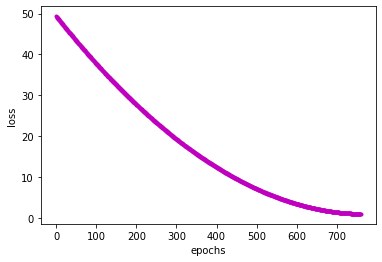

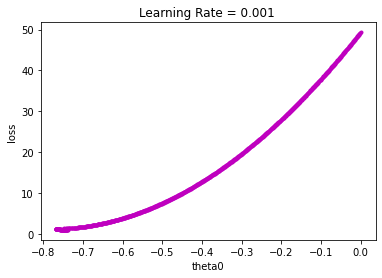

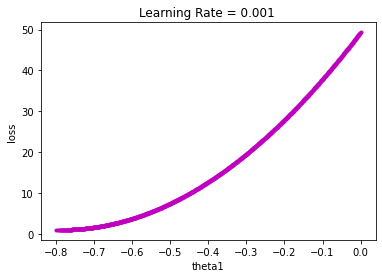

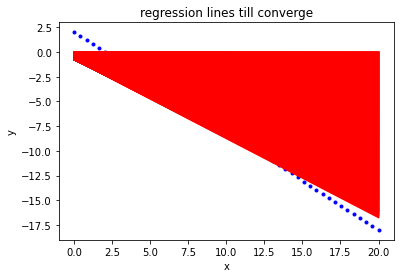

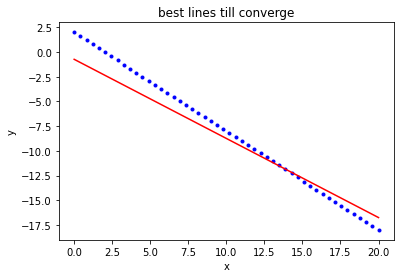

In [ ]:

plot(theta_0s11,theta_1s11,costs11,h_yhat11,lr11)

In [ ]:
r2_score(y,h_yhat11[-1])

0.9442458789164115

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s12,theta_1s12,costs12,h_yhat12,lr12= Adam(x,y,0.001,1e-08,5000,.5,0.99)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:4.000000000000001
M1_0: 57.34693877322448



theta_0_new :-0.04440423215878886 
theta_1_new :-0.044454564169841775
****************** Iteration 45 ********************

h(x):[-0.04440423 -0.06254895 -0.08069367 -0.09883839 -0.11698311 -0.13512783
 -0.15327255 -0.17141727 -0.18956199 -0.20770671 -0.22585143 -0.24399615
 -0.26214087 -0.28028559 -0.29843031 -0.31657503 -0.33471975 -0.35286447
 -0.37100919 -0.38915391 -0.40729863 -0.42544335 -0.44358807 -0.46173279
 -0.47987751 -0.49802223 -0.51616695 -0.53431167 -0.55245639 -0.57060111
 -0.58874583 -0.60689055 -0.62503527 -0.64317999 -0.66132471 -0.67946943
 -0.69761415 -0.71575887 -0.73390359 -0.75204831 -0.77019303 -0.78833776
 -0.80648247 -0.8246272  -0.84277192 -0.86091664 -0.87906136 -0.89720608
 -0.9153508  -0.93349552]

Error Vector:[-2.04440423 -1.65438568 -1.26436714 -0.87434859 -0.48433005 -0.0943115
  0.29570704  0.68572559  1.07574413  1.46576268  1.85578122  2.24579977
  2.63581831  3.02583686  3.4158554   3.80587395  4.19589249  4.58591104
  4.97592959  5.36594813  5.


h(x):[-0.07903142 -0.1113584  -0.14368539 -0.17601237 -0.20833935 -0.24066634
 -0.27299332 -0.3053203  -0.33764728 -0.36997427 -0.40230125 -0.43462823
 -0.46695522 -0.4992822  -0.53160918 -0.56393617 -0.59626315 -0.62859013
 -0.66091712 -0.6932441  -0.72557108 -0.75789806 -0.79022505 -0.82255203
 -0.85487901 -0.887206   -0.91953298 -0.95185996 -0.98418695 -1.01651393
 -1.04884091 -1.08116789 -1.11349488 -1.14582186 -1.17814884 -1.21047583
 -1.24280281 -1.27512979 -1.30745678 -1.33978376 -1.37211074 -1.40443772
 -1.43676471 -1.46909169 -1.50141867 -1.53374566 -1.56607264 -1.59839962
 -1.63072661 -1.66305359]

Error Vector:[-2.07903142 -1.70319513 -1.32735886 -0.95152257 -0.57568629 -0.19985001
  0.17598627  0.55182256  0.92765884  1.30349512  1.6793314   2.05516769
  2.43100396  2.80684025  3.18267653  3.55851281  3.93434909  4.31018538
  4.68602166  5.06185794  5.43769423  5.81353051  6.18936679  6.56520307
  6.94103936  7.31687563  7.69271192  8.0685482   8.44438448  8.82022076
  9.1


j(mse):36.546809147798214

Gradient Vector:
[[ 6.76445195]
 [98.44038252]]

Gradient Vector Norm:98.67252262703768

M0_116:6.774781962277201
M1_116: 98.57628246643563

M0_116_corrected:6.774781962277201 
M1_116_corrected: 98.57628246643563 

Vt0_116:36.49197322354238
Vt1_116: 7624.926867105302

Vt0_116_corrected:52.77558956978255 
Vt1_116_corrected: 11027.356848391719

theta_0_new :-0.11293524886021589 
theta_1_new :-0.11329325787599702
****************** Iteration 117 ********************

h(x):[-0.11293525 -0.1591774  -0.20541954 -0.25166169 -0.29790383 -0.34414598
 -0.39038813 -0.43663027 -0.48287242 -0.52911456 -0.57535671 -0.62159886
 -0.667841   -0.71408315 -0.76032529 -0.80656744 -0.85280959 -0.89905173
 -0.94529388 -0.99153602 -1.03777817 -1.08402032 -1.13026246 -1.17650461
 -1.22274675 -1.2689889  -1.31523105 -1.36147319 -1.40771534 -1.45395748
 -1.50019963 -1.54644178 -1.59268392 -1.63892607 -1.68516822 -1.73141036
 -1.77765251 -1.82389465 -1.8701368  -1.91637895 -1.96262109


Error Vector:[-2.13424559 -1.78108634 -1.42792709 -1.07476784 -0.72160859 -0.36844934
 -0.01529009  0.33786916  0.69102841  1.04418766  1.3973469   1.75050616
  2.1036654   2.45682466  2.8099839   3.16314316  3.5163024   3.86946166
  4.22262091  4.57578015  4.92893941  5.28209865  5.63525791  5.98841715
  6.34157641  6.69473565  7.04789491  7.40105415  7.7542134   8.10737265
  8.4605319   8.81369115  9.1668504   9.52000966  9.8731689  10.22632816
 10.5794874  10.93264666 11.2858059  11.63896515 11.9921244  12.34528365
 12.6984429  13.05160215 13.4047614  13.75792065 14.1110799  14.46423915
 14.8173984  15.17055765]

j(mse):34.229800587641705

Gradient Vector:
[[ 6.51815603]
 [95.20009652]]

Gradient Vector Norm:95.42297803016399

M0_140:6.528366797698558
M1_140: 95.33443195654964

M0_140_corrected:6.528366797698558 
M1_140_corrected: 95.33443195654964 

Vt0_140:38.09578953949909
Vt1_140: 7994.39030149443

Vt0_140_corrected:50.28593796391789 
Vt1_140_corrected: 10552.48938582785

theta


Gradient Vector:
[[ 6.17393608]
 [90.6713395 ]]

Gradient Vector Norm:90.88129232054261

M0_174:6.183989535914108
M1_174: 90.80361145208843

M0_174_corrected:6.183989535914108 
M1_174_corrected: 90.80361145208843 

Vt0_174:38.67255518189613
Vt1_174: 8170.095691098505

Vt0_174_corrected:46.720086886665065 
Vt1_174_corrected: 9870.24464158447

theta_0_new :-0.1661860497386083 
theta_1_new :-0.1669922451101674
****************** Iteration 175 ********************

h(x):[-0.16618605 -0.23434615 -0.30250625 -0.37066635 -0.43882645 -0.50698655
 -0.57514665 -0.64330675 -0.71146685 -0.77962695 -0.84778705 -0.91594715
 -0.98410725 -1.05226735 -1.12042745 -1.18858755 -1.25674765 -1.32490775
 -1.39306785 -1.46122795 -1.52938805 -1.59754815 -1.66570825 -1.73386835
 -1.80202845 -1.87018855 -1.93834865 -2.00650875 -2.07466885 -2.14282895
 -2.21098905 -2.27914915 -2.34730925 -2.41546935 -2.48362945 -2.55178955
 -2.61994965 -2.68810975 -2.75626985 -2.82442995 -2.89259005 -2.96075015
 -3.02891025 -3.0


Error Vector:[-2.19312148 -1.86423621 -1.53535094 -1.20646566 -0.8775804  -0.54869512
 -0.21980986  0.10907542  0.43796069  0.76684596  1.09573123  1.4246165
  1.75350177  2.08238705  2.41127231  2.74015759  3.06904286  3.39792813
  3.72681341  4.05569867  4.38458395  4.71346922  5.04235449  5.37123976
  5.70012504  6.0290103   6.35789558  6.68678084  7.01566612  7.34455139
  7.67343666  8.00232193  8.3312072   8.66009248  8.98897775  9.31786302
  9.64674829  9.97563357 10.30451883 10.63340411 10.96228937 11.29117465
 11.62005992 11.94894519 12.27783046 12.60671574 12.935601   13.26448628
 13.59337154 13.92225682]

j(mse):28.45931192605123

Gradient Vector:
[[ 5.86456767]
 [86.60092476]]

Gradient Vector Norm:86.7992702911621

M0_205:5.874487812606821
M1_205: 86.73144849194293

M0_205_corrected:5.874487812606821 
M1_205_corrected: 86.73144849194293 

Vt0_205:37.97823862267509
Vt1_205: 8078.15693209583

Vt0_205_corrected:43.46028430344968 
Vt1_205_corrected: 9244.214835891684

theta_0_


Gradient Vector Norm:83.15753010803537

M0_233:5.598384977167628
M1_233: 83.09856209488248

M0_233_corrected:5.598384977167628 
M1_233_corrected: 83.09856209488248 

Vt0_233:36.67542080295146
Vt1_233: 7853.850529450178

Vt0_233_corrected:40.534270835420095 
Vt1_233_corrected: 8680.203184908563

theta_0_new :-0.2187915907515062 
theta_1_new :-0.22024285145901604
****************** Iteration 234 ********************

h(x):[-0.21879159 -0.30868663 -0.39858167 -0.48847672 -0.57837176 -0.6682668
 -0.75816184 -0.84805688 -0.93795192 -1.02784696 -1.117742   -1.20763705
 -1.29753209 -1.38742713 -1.47732217 -1.56721721 -1.65711225 -1.74700729
 -1.83690234 -1.92679738 -2.01669242 -2.10658746 -2.1964825  -2.28637754
 -2.37627259 -2.46616763 -2.55606267 -2.64595771 -2.73585275 -2.82574779
 -2.91564283 -3.00553787 -3.09543292 -3.18532796 -3.275223   -3.36511804
 -3.45501308 -3.54490812 -3.63480316 -3.72469821 -3.81459325 -3.90448829
 -3.99438333 -4.08427837 -4.17417341 -4.26406845 -4.35396349 -4.4


Error Vector:[-2.24411448 -1.93634193 -1.62856939 -1.32079684 -1.0130243  -0.70525175
 -0.39747921 -0.08970666  0.21806588  0.52583843  0.83361097  1.14138352
  1.44915606  1.75692861  2.06470115  2.3724737   2.68024624  2.98801879
  3.29579134  3.60356388  3.91133643  4.21910897  4.52688152  4.83465406
  5.14242661  5.45019915  5.7579717   6.06574424  6.37351679  6.68128933
  6.98906188  7.29683442  7.60460697  7.91237952  8.22015206  8.52792461
  8.83569715  9.1434697   9.45124224  9.75901479 10.06678733 10.37455988
 10.68233242 10.99010497 11.29787751 11.60565006 11.9134226  12.22119515
 12.52896769 12.83674024]

j(mse):23.888595274863242

Gradient Vector:
[[ 5.29631288]
 [79.12379514]]

Gradient Vector Norm:79.30085679218597

M0_263:5.306003206499106
M1_263: 79.25130670508936

M0_263_corrected:5.306003206499106 
M1_263_corrected: 79.25130670508936 

Vt0_263:34.80546746900851
Vt1_263: 7512.686460681126

Vt0_263_corrected:37.44211284297182 
Vt1_263_corrected: 8081.800782166087

thet


M0_293:5.017037100438782
M1_293: 75.4488026372261

M0_293_corrected:5.017037100438782 
M1_293_corrected: 75.4488026372261 

Vt0_293:32.623238996976504
Vt1_293: 7103.212769811312

Vt0_293_corrected:34.4159355848489 
Vt1_293_corrected: 7493.5451122421955

theta_0_new :-0.2708102677926416 
theta_1_new :-0.2731302042921804
****************** Iteration 294 ********************

h(x):[-0.27081027 -0.38229199 -0.4937737  -0.60525542 -0.71673713 -0.82821885
 -0.93970056 -1.05118228 -1.162664   -1.27414571 -1.38562743 -1.49710914
 -1.60859086 -1.72007258 -1.83155429 -1.94303601 -2.05451772 -2.16599944
 -2.27748116 -2.38896287 -2.50044459 -2.6119263  -2.72340802 -2.83488974
 -2.94637145 -3.05785317 -3.16933489 -3.2808166  -3.39229832 -3.50378003
 -3.61526175 -3.72674346 -3.83822518 -3.9497069  -4.06118861 -4.17267033
 -4.28415204 -4.39563376 -4.50711548 -4.61859719 -4.73007891 -4.84156063
 -4.95304234 -5.06452406 -5.17600577 -5.28748749 -5.3989692  -5.51045092
 -5.62193264 -5.73341435]

Error V


j(mse):20.153596285474126

Gradient Vector:
[[ 4.78824953]
 [72.43803846]]

Gradient Vector Norm:72.59612076295191

M0_316:4.797743964596279
M1_316: 72.56298447171207

M0_316_corrected:4.797743964596279 
M1_316_corrected: 72.56298447171207 

Vt0_316:30.823619920522653
Vt1_316: 6760.208375115599

Vt0_316_corrected:32.15277338307333 
Vt1_316_corrected: 7051.717107461681

theta_0_new :-0.29037079455628895 
theta_1_new :-0.2930866862409442
****************** Iteration 317 ********************

h(x):[-0.29037079 -0.40999801 -0.52962523 -0.64925245 -0.76887967 -0.88850689
 -1.00813411 -1.12776133 -1.24738854 -1.36701577 -1.48664298 -1.6062702
 -1.72589742 -1.84552464 -1.96515186 -2.08477908 -2.2044063  -2.32403352
 -2.44366074 -2.56328795 -2.68291517 -2.80254239 -2.92216961 -3.04179683
 -3.16142405 -3.28105127 -3.40067849 -3.5203057  -3.63993292 -3.75956014
 -3.87918736 -3.99881458 -4.1184418  -4.23806902 -4.35769624 -4.47732346
 -4.59695067 -4.71657789 -4.83620511 -4.95583233 -5.07545955 -


j(mse):17.782743462648018

Gradient Vector:
[[ 4.4396286]
 [67.8500243]]

Gradient Vector Norm:67.99511820095026

M0_353:4.448989491673132
M1_353: 67.97322262764638

M0_353_corrected:4.448989491673132 
M1_353_corrected: 67.97322262764638 

Vt0_353:27.820120691032187
Vt1_353: 6180.232042089113

Vt0_353_corrected:28.636281062515582 
Vt1_353_corrected: 6361.54184068215

theta_0_new :-0.3213979558433723 
theta_1_new :-0.32483271309952727
****************** Iteration 354 ********************

h(x):[-0.32139796 -0.45398274 -0.58656752 -0.7191523  -0.85173708 -0.98432186
 -1.11690664 -1.24949142 -1.3820762  -1.51466098 -1.64724576 -1.77983055
 -1.91241532 -2.04500011 -2.17758489 -2.31016967 -2.44275445 -2.57533923
 -2.70792401 -2.84050879 -2.97309357 -3.10567835 -3.23826314 -3.37084791
 -3.5034327  -3.63601748 -3.76860226 -3.90118704 -4.03377182 -4.1663566
 -4.29894138 -4.43152616 -4.56411094 -4.69669573 -4.8292805  -4.96186529
 -5.09445007 -5.22703485 -5.35961963 -5.49220441 -5.62478919 -5.


Error Vector:[-2.34205088 -2.07512605 -1.80820122 -1.54127638 -1.27435155 -1.00742672
 -0.74050189 -0.47357705 -0.20665222  0.06027262  0.32719745  0.59412228
  0.86104711  1.12797195  1.39489678  1.66182161  1.92874644  2.19567128
  2.46259612  2.72952095  2.99644578  3.26337061  3.53029545  3.79722028
  4.06414512  4.33106994  4.59799478  4.86491961  5.13184445  5.39876928
  5.66569411  5.93261894  6.19954378  6.46646862  6.73339345  7.00031828
  7.26724311  7.53416795  7.80109278  8.06801761  8.33494244  8.60186728
  8.86879211  9.13571695  9.40264178  9.66956661  9.93649144 10.20341628
 10.47034111 10.73726594]

j(mse):16.228742721989434

Gradient Vector:
[[ 4.19760753]
 [64.66468612]]

Gradient Vector Norm:64.80078348530627

M0_379:4.206874356568413
M1_379: 64.7866540713966

M0_379_corrected:4.206874356568413 
M1_379_corrected: 64.7866540713966 

Vt0_379:25.692548358093553
Vt1_379: 5764.706459226859

Vt0_379_corrected:26.269074112637544 
Vt1_379_corrected: 5894.063099712987

thet


Error Vector:[-2.36649286 -2.10984353 -1.85319421 -1.59654488 -1.33989556 -1.08324624
 -0.82659692 -0.56994759 -0.31329827 -0.05664894  0.20000038  0.4566497
  0.71329902  0.96994835  1.22659767  1.483247    1.73989632  1.99654564
  2.25319497  2.50984429  2.76649361  3.02314293  3.27979226  3.53644158
  3.79309091  4.04974023  4.30638955  4.56303887  4.8196882   5.07633752
  5.33298685  5.58963617  5.84628549  6.10293482  6.35958414  6.61623346
  6.87288278  7.12953211  7.38618143  7.64283076  7.89948008  8.1561294
  8.41277872  8.66942805  8.92607737  9.1827267   9.43937602  9.69602534
  9.95267466 10.20932399]

j(mse):14.547346651102071

Gradient Vector:
[[ 3.92141557]
 [61.02934815]]

Gradient Vector Norm:61.15520285155293

M0_409:3.9305721411854115
M1_409: 61.14987482506304

M0_409_corrected:3.9305721411854115 
M1_409_corrected: 61.14987482506304 

Vt0_409:23.271176332288487
Vt1_409: 5287.484359062161

Vt0_409_corrected:23.65519857815702 
Vt1_409_corrected: 5374.738719974913

the


Error Vector:[-2.39689215 -2.15308397 -1.90927579 -1.66546761 -1.42165943 -1.17785124
 -0.93404306 -0.69023488 -0.4464267  -0.20261852  0.04118966  0.28499785
  0.52880603  0.77261421  1.01642239  1.26023057  1.50403875  1.74784694
  1.99165512  2.2354633   2.47927148  2.72307966  2.96688785  3.21069603
  3.45450421  3.69831239  3.94212057  4.18592875  4.42973694  4.67354512
  4.9173533   5.16116148  5.40496966  5.64877785  5.89258603  6.13639421
  6.38020239  6.62401057  6.86781875  7.11162694  7.35543512  7.5992433
  7.84305148  8.08685966  8.33066784  8.57447603  8.8182842   9.06209239
  9.30590057  9.54970875]

j(mse):12.584791132107446

Gradient Vector:
[[ 3.5764083 ]
 [56.48777844]]

Gradient Vector Norm:56.60088170377015

M0_447:3.5854202695536035
M1_447: 56.60641613203215

M0_447_corrected:3.5854202695536035 
M1_447_corrected: 56.60641613203215 

Vt0_447:20.310595121862793
Vt1_447: 4697.727351805904

Vt0_447_corrected:20.538172440207717 
Vt1_447_corrected: 4750.364716030095

t


j(mse):10.937849671404054

Gradient Vector:
[[ 3.26363707]
 [52.3700222 ]]

Gradient Vector Norm:52.47161663098367

M0_482:3.2725083728712754
M1_482: 52.48682393628307

M0_482_corrected:3.2725083728712754 
M1_482_corrected: 52.48682393628307 

Vt0_482:17.73010353442757
Vt1_482: 4177.612717647893

Vt0_482_corrected:17.86938993530218 
Vt1_482_corrected: 4210.431738617472

theta_0_new :-0.425071943627446 
theta_1_new :-0.4320153996079278
****************** Iteration 483 ********************

h(x):[-0.42507194 -0.60140476 -0.77773758 -0.95407039 -1.13040321 -1.30673603
 -1.48306884 -1.65940166 -1.83573447 -2.01206729 -2.1884001  -2.36473292
 -2.54106574 -2.71739855 -2.89373137 -3.07006419 -3.246397   -3.42272982
 -3.59906264 -3.77539545 -3.95172827 -4.12806108 -4.3043939  -4.48072671
 -4.65705953 -4.83339235 -5.00972516 -5.18605798 -5.3623908  -5.53872361
 -5.71505643 -5.89138924 -6.06772206 -6.24405488 -6.42038769 -6.59672051
 -6.77305333 -6.94938614 -7.12571896 -7.30205178 -7.47838459 -


Error Vector:[-2.44805326e+00 -2.22605676e+00 -2.00406027e+00 -1.78206377e+00
 -1.56006727e+00 -1.33807077e+00 -1.11607428e+00 -8.94077775e-01
 -6.72081280e-01 -4.50084780e-01 -2.28088284e-01 -6.09178381e-03
  2.15904711e-01  4.37901212e-01  6.59897707e-01  8.81894208e-01
  1.10389070e+00  1.32588720e+00  1.54788370e+00  1.76988020e+00
  1.99187670e+00  2.21387319e+00  2.43586970e+00  2.65786619e+00
  2.87986269e+00  3.10185919e+00  3.32385569e+00  3.54585218e+00
  3.76784868e+00  3.98984518e+00  4.21184168e+00  4.43383817e+00
  4.65583467e+00  4.87783117e+00  5.09982767e+00  5.32182417e+00
  5.54382067e+00  5.76581717e+00  5.98781366e+00  6.20981016e+00
  6.43180666e+00  6.65380316e+00  6.87579965e+00  7.09779615e+00
  7.31979265e+00  7.54178915e+00  7.76378564e+00  7.98578214e+00
  8.20777864e+00  8.42977514e+00]

j(mse):9.60415917521241

Gradient Vector:
[[ 2.99086094]
 [48.77831171]]

Gradient Vector Norm:48.86991858781685

M0_513:2.9995994868187776
M1_513: 48.89338208724482

M0_5


Error Vector:[-2.47349046 -2.26246572 -2.05144099 -1.84041626 -1.62939153 -1.41836679
 -1.20734206 -0.99631732 -0.78529259 -0.57426786 -0.36324313 -0.15221839
  0.05880634  0.26983108  0.48085581  0.69188055  0.90290528  1.11393001
  1.32495475  1.53597948  1.74700422  1.95802895  2.16905368  2.38007841
  2.59110315  2.80212788  3.01315262  3.22417735  3.43520208  3.64622681
  3.85725155  4.06827628  4.27930102  4.49032575  4.70135048  4.91237522
  5.12339995  5.33442469  5.54544942  5.75647415  5.96749889  6.17852362
  6.38954835  6.60057309  6.81159782  7.02262256  7.23364729  7.44467202
  7.65569675  7.86672149]

j(mse):8.272703621185398

Gradient Vector:
[[ 2.69661551]
 [44.90325751]]

Gradient Vector Norm:44.984155765838366

M0_547:2.7051971832295734
M1_547: 45.01628379331606

M0_547_corrected:2.7051971832295734 
M1_547_corrected: 45.01628379331606 

Vt0_547:13.394293581052487
Vt1_547: 3288.2611916419996

Vt0_547_corrected:13.448840658610768 
Vt1_547_corrected: 3301.652344909396



j(mse):7.04138578516468

Gradient Vector:
[[ 2.39956552]
 [40.99040633]]

Gradient Vector Norm:41.060581165065656

M0_582:2.407970438235422
M1_582: 41.10113205333627

M0_582_corrected:2.407970438235422 
M1_582_corrected: 41.10113205333627 

Vt0_582:11.329534818977137
Vt1_582: 2855.9671080446524

Vt0_582_corrected:11.361951712131477 
Vt1_582_corrected: 2864.138809890585

theta_0_new :-0.4996359313008302 
theta_1_new :-0.5109192839151994
****************** Iteration 583 ********************

h(x):[ -0.49963593  -0.70817442  -0.9167129   -1.12525138  -1.33378986
  -1.54232835  -1.75086683  -1.95940532  -2.1679438   -2.37648228
  -2.58502076  -2.79355925  -3.00209773  -3.21063621  -3.41917469
  -3.62771318  -3.83625166  -4.04479015  -4.25332863  -4.46186711
  -4.6704056   -4.87894408  -5.08748256  -5.29602104  -5.50455953
  -5.71309801  -5.9216365   -6.13017498  -6.33871346  -6.54725194
  -6.75579043  -6.96432891  -7.17286739  -7.38140588  -7.58994436
  -7.79848285  -8.00702133  -8.215559


j(mse):5.946764278238304

Gradient Vector:
[[ 2.10905133]
 [37.16256584]]

Gradient Vector Norm:37.22236420520894

M0_617:2.117260523676566
M1_617: 37.270747298361485

M0_617_corrected:2.117260523676566 
M1_617_corrected: 37.270747298361485 

Vt0_617:9.461243387989908
Vt1_617: 2458.186705092203

Vt0_617_corrected:9.480270417279135 
Vt1_617_corrected: 2463.1302403674445

theta_0_new :-0.5241691092094206 
theta_1_new :-0.5374976937902924
****************** Iteration 618 ********************

h(x):[ -0.52416911  -0.74355593  -0.96294274  -1.18232955  -1.40171636
  -1.62110318  -1.84048999  -2.05987681  -2.27926362  -2.49865043
  -2.71803725  -2.93742406  -3.15681087  -3.37619769  -3.5955845
  -3.81497132  -4.03435813  -4.25374494  -4.47313176  -4.69251857
  -4.91190539  -5.1312922   -5.35067901  -5.57006583  -5.78945264
  -6.00883945  -6.22822627  -6.44761308  -6.6669999   -6.88638671
  -7.10577352  -7.32516033  -7.54454715  -7.76393397  -7.98332078
  -8.20270759  -8.42209441  -8.6414812


Error Vector:[-2.54703475 -2.36855122 -2.19006768 -2.01158415 -1.83310061 -1.65461708
 -1.47613355 -1.29765001 -1.11916648 -0.94068294 -0.76219941 -0.58371587
 -0.40523234 -0.2267488  -0.04826527  0.13021827  0.3087018   0.48718534
  0.66566887  0.84415241  1.02263594  1.20111947  1.37960301  1.55808654
  1.73657008  1.91505361  2.09353715  2.27202068  2.45050422  2.62898775
  2.80747129  2.98595482  3.16443836  3.34292189  3.52140542  3.69988896
  3.87837249  4.05685603  4.23533956  4.4138231   4.59230663  4.77079017
  4.9492737   5.12775724  5.30624077  5.48472431  5.66320784  5.84169137
  6.02017491  6.19865844]

j(mse):4.983839195013117

Gradient Vector:
[[ 1.82581185]
 [33.4292189 ]]

Gradient Vector Norm:33.47904217451112

M0_652:1.8338023115151318
M1_652: 33.534561119772064

M0_652_corrected:1.8338023115151318 
M1_652_corrected: 33.534561119772064 

Vt0_652:7.790272087809301
Vt1_652: 2095.427107099732

Vt0_652_corrected:7.8012861691963895 
Vt1_652_corrected: 2098.389674316662




Error Vector:[-2.5675427  -2.39850129 -2.22945989 -2.06041848 -1.89137707 -1.72233567
 -1.55329426 -1.38425285 -1.21521145 -1.04617004 -0.87712864 -0.70808723
 -0.53904582 -0.37000442 -0.20096301 -0.0319216   0.1371198   0.30616121
  0.47520262  0.64424402  0.81328543  0.98232684  1.15136824  1.32040965
  1.48945106  1.65849246  1.82753387  1.99657527  2.16561668  2.33465809
  2.50369949  2.6727409   2.84178231  3.01082371  3.17986512  3.34890653
  3.51794793  3.68698934  3.85603074  4.02507215  4.19411356  4.36315496
  4.53219637  4.70123778  4.87027918  5.03932059  5.20836199  5.3774034
  5.54644481  5.71548621]

j(mse):4.214065117004766

Gradient Vector:
[[ 1.57397176]
 [30.10823712]]

Gradient Vector Norm:30.1493504001786

M0_684:1.581738121407251
M1_684: 30.210675106228237

M0_684_corrected:1.581738121407251 
M1_684_corrected: 30.210675106228237 

Vt0_684:6.433446618652308
Vt1_684: 1794.371696933984

Vt0_684_corrected:6.440038308277374 
Vt1_684_corrected: 1796.2102046576508

thet


Error Vector:[-2.58395858e+00 -2.42267922e+00 -2.26139987e+00 -2.10012051e+00
 -1.93884115e+00 -1.77756179e+00 -1.61628244e+00 -1.45500308e+00
 -1.29372372e+00 -1.13244436e+00 -9.71165006e-01 -8.09885647e-01
 -6.48606291e-01 -4.87326931e-01 -3.26047576e-01 -1.64768216e-01
 -3.48886008e-03  1.57790500e-01  3.19069859e-01  4.80349215e-01
  6.41628575e-01  8.02907931e-01  9.64187290e-01  1.12546665e+00
  1.28674601e+00  1.44802536e+00  1.60930472e+00  1.77058408e+00
  1.93186344e+00  2.09314279e+00  2.25442215e+00  2.41570151e+00
  2.57698087e+00  2.73826023e+00  2.89953958e+00  3.06081894e+00
  3.22209830e+00  3.38337766e+00  3.54465701e+00  3.70593637e+00
  3.86721573e+00  4.02849509e+00  4.18977444e+00  4.35105380e+00
  4.51233316e+00  4.67361252e+00  4.83489188e+00  4.99617124e+00
  5.15745059e+00  5.31872995e+00]

j(mse):3.643270434601879

Gradient Vector:
[[ 1.36738568]
 [27.38260225]]

Gradient Vector Norm:27.41672208192364

M0_711:1.3749418771449586
M1_711: 27.482321167008266

M0


j(mse):3.141293759387977

Gradient Vector:
[[ 1.1668024 ]
 [24.73455035]]

Gradient Vector Norm:24.762055830045142

M0_738:1.1741260831714393
M1_738: 24.83126667965781

M0_738_corrected:1.1741260831714393 
M1_738_corrected: 24.83126667965781 

Vt0_738:4.503748696094017
Vt1_738: 1351.510180651796

Vt0_738_corrected:4.506429353876524 
Vt1_738_corrected: 1352.3146074811714

theta_0_new :-0.5999847677242087 
theta_1_new :-0.624051835631515
****************** Iteration 739 ********************

h(x):[ -0.59998477  -0.85469981  -1.10941484  -1.36412988  -1.61884491
  -1.87355994  -2.12827498  -2.38299001  -2.63770505  -2.89242008
  -3.14713512  -3.40185015  -3.65656518  -3.91128022  -4.16599525
  -4.42071029  -4.67542532  -4.93014036  -5.1848554   -5.43957043
  -5.69428547  -5.9490005   -6.20371554  -6.45843057  -6.71314561
  -6.96786064  -7.22257568  -7.47729071  -7.73200575  -7.98672078
  -8.24143582  -8.49615085  -8.75086589  -9.00558092  -9.26029596
  -9.51501099  -9.76972603 -10.024441


Error Vector:[-2.61733722 -2.47280222 -2.32826722 -2.18373222 -2.03919722 -1.89466222
 -1.75012722 -1.60559222 -1.46105722 -1.31652222 -1.17198722 -1.02745222
 -0.88291722 -0.73838222 -0.59384722 -0.44931222 -0.30477722 -0.16024222
 -0.01570722  0.12882778  0.27336278  0.41789778  0.56243278  0.70696778
  0.85150278  0.99603778  1.14057278  1.28510778  1.42964278  1.57417778
  1.71871278  1.86324778  2.00778278  2.15231778  2.29685278  2.44138778
  2.58592278  2.73045778  2.87499278  3.01952778  3.16406278  3.30859778
  3.45313278  3.59766778  3.74220278  3.88673778  4.03127278  4.17580778
  4.32034278  4.46487778]

j(mse):2.6018851530565006

Gradient Vector:
[[ 0.92377028]
 [21.52317781]]

Gradient Vector Norm:21.54299270585367

M0_772:0.9307643426197039
M1_772: 21.615647928796395

M0_772_corrected:0.9307643426197039 
M1_772_corrected: 21.615647928796395 

Vt0_772:3.5109564091295167
Vt1_772: 1113.3968639660611

Vt0_772_corrected:3.5124410262520476 
Vt1_772_corrected: 1113.86766674906


Gradient Vector Norm:18.48002851396304

M0_806:0.6994265751450046
M1_806: 18.554659986541427

M0_806_corrected:0.6994265751450046 
M1_806_corrected: 18.554659986541427 

Vt0_806:2.679978575384894
Vt1_806: 905.3956802264372

Vt0_806_corrected:2.6807837013163924 
Vt1_806_corrected: 905.6676814831309

theta_0_new :-0.6335459168079093 
theta_1_new :-0.6680236699834341
****************** Iteration 807 ********************

h(x):[ -0.63354592  -0.90620864  -1.17887136  -1.45153409  -1.72419681
  -1.99685953  -2.26952225  -2.54218498  -2.81484769  -3.08751042
  -3.36017314  -3.63283586  -3.90549858  -4.17816131  -4.45082403
  -4.72348675  -4.99614947  -5.2688122   -5.54147492  -5.81413764
  -6.08680037  -6.35946309  -6.63212581  -6.90478853  -7.17745126
  -7.45011398  -7.7227767   -7.99543942  -8.26810215  -8.54076487
  -8.81342759  -9.08609031  -9.35875304  -9.63141576  -9.90407848
 -10.17674121 -10.44940392 -10.72206665 -10.99472937 -11.26739209
 -11.54005481 -11.81271754 -12.08538026 -12.


Error Vector:[-2.64558053 -2.51767716 -2.38977379 -2.26187042 -2.13396705 -2.00606368
 -1.87816031 -1.75025694 -1.62235358 -1.49445021 -1.36654684 -1.23864347
 -1.1107401  -0.98283673 -0.85493336 -0.72702999 -0.59912663 -0.47122326
 -0.34331988 -0.21541652 -0.08751315  0.04039022  0.16829359  0.29619696
  0.42410033  0.55200369  0.67990706  0.80781043  0.9357138   1.06361717
  1.19152054  1.31942391  1.44732728  1.57523065  1.70313401  1.83103739
  1.95894075  2.08684412  2.21474749  2.34265086  2.47055423  2.5984576
  2.72636096  2.85426433  2.9821677   3.11007107  3.23797444  3.36587781
  3.49378118  3.62168455]

j(mse):1.8225065542964967

Gradient Vector:
[[ 0.48805201]
 [15.75230646]]

Gradient Vector Norm:15.759865276903655

M0_838:0.49426213191356516
M1_838: 15.83473224864672

M0_838_corrected:0.49426213191356516 
M1_838_corrected: 15.83473224864672 

Vt0_838:2.0366163975549307
Vt1_838: 735.8631998718317

Vt0_838_corrected:2.037059936822387 
Vt1_838_corrected: 736.0234579474375



Error Vector:[-2.65612774 -2.53651032 -2.41689291 -2.29727549 -2.17765808 -2.05804066
 -1.93842325 -1.81880583 -1.69918842 -1.579571   -1.45995359 -1.34033617
 -1.22071876 -1.10110134 -0.98148392 -0.86186651 -0.74224909 -0.62263168
 -0.50301426 -0.38339685 -0.26377943 -0.14416202 -0.0245446   0.09507281
  0.21469023  0.33430764  0.45392506  0.57354247  0.69315989  0.81277731
  0.93239472  1.05201214  1.17162955  1.29124697  1.41086438  1.5304818
  1.65009921  1.76971663  1.88933404  2.00895146  2.12856887  2.24818629
  2.3678037   2.48742112  2.60703854  2.72665595  2.84627337  2.96589078
  3.0855082   3.20512561]

j(mse):1.5275292829973697

Gradient Vector:
[[ 0.27449894]
 [12.91246968]]

Gradient Vector Norm:12.915387056770907

M0_874:0.2801839362179832
M1_874: 12.98821434589997

M0_874_corrected:0.2801839362179832 
M1_874_corrected: 12.98821434589997 

Vt0_874:1.4610994174222474
Vt1_874: 573.7746623557334

Vt0_874_corrected:1.461321002698366 
Vt1_874_corrected: 573.8616790333613

t


j(mse):1.30888710463197

Gradient Vector:
[[ 0.08138705]
 [10.33179735]]

Gradient Vector Norm:10.332117897525611

M0_910:0.08646715789149828
M1_910: 10.399895780603227

M0_910_corrected:0.08646715789149828 
M1_910_corrected: 10.399895780603227 

Vt0_910:1.026992831831367
Vt1_910: 439.8010595163966

Vt0_910_corrected:1.0271012933184065 
Vt1_910_corrected: 439.84750723778103

theta_0_new :-0.6621006984343462 
theta_1_new :-0.7261556381744529
****************** Iteration 911 ********************

h(x):[ -0.6621007   -0.95849076  -1.25488081  -1.55127087  -1.84766092
  -2.14405098  -2.44044104  -2.7368311   -3.03322115  -3.32961121
  -3.62600126  -3.92239132  -4.21878137  -4.51517143  -4.81156148
  -5.10795154  -5.4043416   -5.70073166  -5.99712172  -6.29351177
  -6.58990183  -6.88629188  -7.18268194  -7.47907199  -7.77546205
  -8.07185211  -8.36824217  -8.66463222  -8.96102228  -9.25741233
  -9.55380239  -9.85019244 -10.1465825  -10.44297256 -10.73936262
 -11.03575268 -11.33214273 -11.6

Gradient Vector Norm:8.224273571754992

M0_943:-0.07071036441682074
M1_943: 8.284165481045793

M0_943_corrected:-0.07071036441682074 
M1_943_corrected: 8.284165481045793 

Vt0_943:0.7376812910730594
Vt1_943: 339.47825220663367

Vt0_943_corrected:0.7377372056941882 
Vt1_943_corrected: 339.5039839122948

theta_0_new :-0.6621578930188972 
theta_1_new :-0.7417419816293617
****************** Iteration 944 ********************

h(x):[ -0.66215789  -0.96490973  -1.26766155  -1.57041338  -1.87316521
  -2.17591704  -2.47866887  -2.7814207   -3.08417253  -3.38692436
  -3.68967618  -3.99242802  -4.29517984  -4.59793167  -4.9006835
  -5.20343533  -5.50618716  -5.80893899  -6.11169082  -6.41444265
  -6.71719448  -7.01994631  -7.32269814  -7.62544996  -7.9282018
  -8.23095362  -8.53370545  -8.83645728  -9.13920911  -9.44196094
  -9.74471277 -10.0474646  -10.35021643 -10.65296826 -10.95572009
 -11.25847192 -11.56122374 -11.86397558 -12.1667274  -12.46947924
 -12.77223106 -13.07498289 -13.37773472 -13


theta_0_new :-0.6555496859681266 
theta_1_new :-0.7565486775864152
****************** Iteration 979 ********************

h(x):[ -0.65554969  -0.96434507  -1.27314044  -1.58193582  -1.8907312
  -2.19952658  -2.50832196  -2.81711734  -3.12591271  -3.4347081
  -3.74350347  -4.05229885  -4.36109423  -4.66988961  -4.97868498
  -5.28748037  -5.59627574  -5.90507112  -6.2138665   -6.52266188
  -6.83145726  -7.14025264  -7.44904802  -7.75784339  -8.06663877
  -8.37543415  -8.68422953  -8.99302491  -9.30182029  -9.61061566
  -9.91941104 -10.22820642 -10.5370018  -10.84579718 -11.15459256
 -11.46338794 -11.77218332 -12.0809787  -12.38977407 -12.69856945
 -13.00736483 -13.31616021 -13.62495559 -13.93375097 -14.24254634
 -14.55134172 -14.8601371  -15.16893248 -15.47772786 -15.78652324]

Error Vector:[-2.65554969 -2.5561818  -2.45681391 -2.35744602 -2.25807814 -2.15871025
 -2.05934237 -1.95997448 -1.86060659 -1.76123871 -1.66187082 -1.56250293
 -1.46313505 -1.36376716 -1.26439927 -1.16503139 -1.0


Error Vector:[-2.64558668 -2.55022141 -2.45485615 -2.35949088 -2.26412562 -2.16876035
 -2.07339509 -1.97802983 -1.88266456 -1.7872993  -1.69193404 -1.59656877
 -1.50120351 -1.40583824 -1.31047298 -1.21510771 -1.11974245 -1.02437719
 -0.92901192 -0.83364666 -0.73828139 -0.64291613 -0.54755087 -0.4521856
 -0.35682034 -0.26145507 -0.16608981 -0.07072455  0.02464072  0.12000598
  0.21537125  0.31073651  0.40610178  0.50146704  0.5968323   0.69219757
  0.78756283  0.8829281   0.97829336  1.07365862  1.16902389  1.26438915
  1.35975442  1.45511968  1.55048494  1.64585021  1.74121547  1.83658074
  1.931946    2.02731126]

j(mse):0.9947513711655702

Gradient Vector:
[[-0.30913771]
 [ 5.01467039]]

Gradient Vector Norm:5.024190009163954

M0_1005:-0.30599994810317477
M1_1005: 5.058528557918134

M0_1005_corrected:-0.30599994810317477 
M1_1005_corrected: 5.058528557918134 

Vt0_1005:0.4186470597252612
Vt1_1005: 201.0977118760298

Vt0_1005_corrected:0.41866407627324576 
Vt1_1005_corrected: 201.105


j(mse):0.9457945664450347

Gradient Vector:
[[-0.39011162]
 [ 3.86719137]]

Gradient Vector Norm:3.886818257723005

M0_1034:-0.3875961158077512
M1_1034: 3.9033212497348835

M0_1034_corrected:-0.3875961158077512 
M1_1034_corrected: 3.9033212497348835 

Vt0_1034:0.34470525618913017
Vt1_1034: 155.120839401126

Vt0_1034_corrected:0.3447157247625527 
Vt1_1034_corrected: 155.12555036467378

theta_0_new :-0.6285518665830309 
theta_1_new :-0.7764033545035203
****************** Iteration 1035 ********************

h(x):[ -0.62855187  -0.9454512   -1.26235052  -1.57924985  -1.89614918
  -2.21304851  -2.52994784  -2.84684717  -3.16374649  -3.48064582
  -3.79754515  -4.11444448  -4.4313438   -4.74824314  -5.06514246
  -5.38204179  -5.69894112  -6.01584045  -6.33273978  -6.6496391
  -6.96653844  -7.28343776  -7.60033709  -7.91723642  -8.23413575
  -8.55103507  -8.86793441  -9.18483373  -9.50173306  -9.81863239
 -10.13553172 -10.45243104 -10.76933037 -11.08622971 -11.40312903
 -11.72002836 -12.0369


Error Vector:[-2.60691873 -2.51910903 -2.43129933 -2.34348963 -2.25567993 -2.16787023
 -2.08006053 -1.99225083 -1.90444113 -1.81663143 -1.72882173 -1.64101203
 -1.55320233 -1.46539263 -1.37758293 -1.28977323 -1.20196353 -1.11415383
 -1.02634413 -0.93853443 -0.85072473 -0.76291503 -0.67510533 -0.58729563
 -0.49948593 -0.41167623 -0.32386653 -0.23605683 -0.14824713 -0.06043743
  0.02737227  0.11518196  0.20299167  0.29080137  0.37861107  0.46642077
  0.55423047  0.64204017  0.72984986  0.81765957  0.90546926  0.99327897
  1.08108866  1.16889837  1.25670806  1.34451777  1.43232746  1.52013716
  1.60794686  1.69575656]

j(mse):0.9066373934105968

Gradient Vector:
[[-0.45558108]
 [ 2.90801366]]

Gradient Vector Norm:2.9434839134324675

M0_1064:-0.453661184533514
M1_1064: 2.9367013820854195

M0_1064_corrected:-0.453661184533514 
M1_1064_corrected: 2.9367013820854195 

Vt0_1064:0.30254056673920443
Vt1_1064: 117.64760441696816

Vt0_1064_corrected:0.3025473630873629 
Vt1_1064_corrected: 117.65

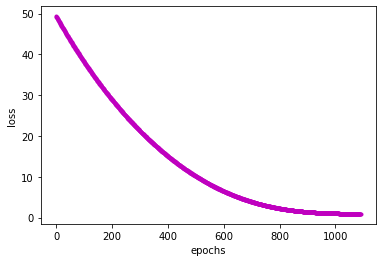

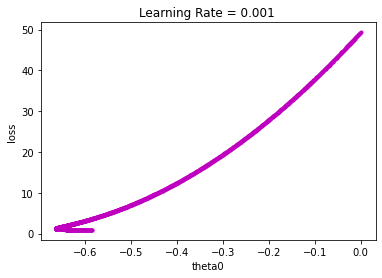

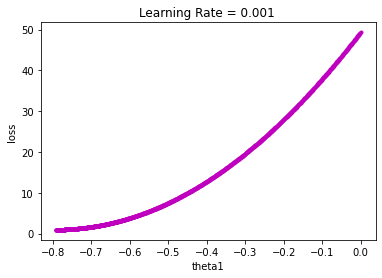

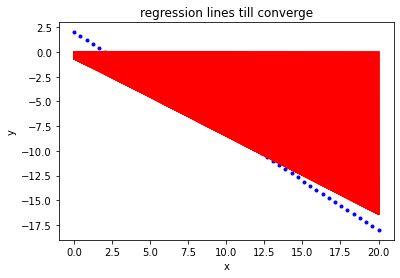

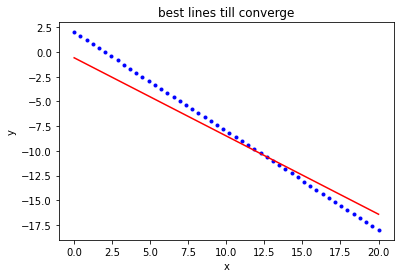

In [ ]:
plot(theta_0s12,theta_1s12,costs12,h_yhat12,lr12)

In [ ]:
r2_score(y,h_yhat12[-1])

0.9493447336396929

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.5, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s13,theta_1s13,costs13,h_yhat13,lr13= Adam(x,y,0.001,1e-08,5000,.5,0.5)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:4.000000000000001
M1_0: 57.34693877322448



j(mse):44.563745817866035

Gradient Vector:
[[  7.56000067]
 [108.9061312 ]]

Gradient Vector Norm:109.16821434748387

M0_40:7.571000649042205
M1_40: 109.05082482407457

M0_40_corrected:7.571000649045647 
M1_40_corrected: 109.05082482412416 

Vt0_40:57.32029282696278
Vt1_40: 11892.124267304502

Vt0_40_corrected:57.32029282698884 
Vt1_40_corrected: 11892.12426730991

theta_0_new :-0.04099992653600856 
theta_1_new :-0.040999938508656165
****************** Iteration 41 ********************

h(x):[-0.04099993 -0.0577346  -0.07446926 -0.09120393 -0.1079386  -0.12467327
 -0.14140794 -0.15814261 -0.17487728 -0.19161195 -0.20834661 -0.22508128
 -0.24181595 -0.25855062 -0.27528529 -0.29201996 -0.30875463 -0.3254893
 -0.34222396 -0.35895863 -0.3756933  -0.39242797 -0.40916264 -0.42589731
 -0.44263198 -0.45936665 -0.47610131 -0.49283598 -0.50957065 -0.52630532
 -0.54303999 -0.55977466 -0.57650933 -0.593244   -0.60997867 -0.62671333
 -0.643448   -0.66018267 -0.67691734 -0.69365201 -0.71038668 -0.


j(mse):40.361079071942974

Gradient Vector:
[[  7.15300144]
 [103.55246777]]

Gradient Vector Norm:103.79922452286762

M0_77:7.164001413543835
M1_77: 103.6971613669596

M0_77_corrected:7.164001413543835 
M1_77_corrected: 103.6971613669596 

Vt0_77:51.32315825230561
Vt1_77: 10753.143148037598

Vt0_77_corrected:51.32315825230561 
Vt1_77_corrected: 10753.143148037598

theta_0_new :-0.07799984382029866 
theta_1_new :-0.07799986990985282
****************** Iteration 78 ********************

h(x):[-0.07799984 -0.10983653 -0.14167321 -0.17350989 -0.20534657 -0.23718325
 -0.26901993 -0.30085662 -0.3326933  -0.36452998 -0.39636666 -0.42820334
 -0.46004002 -0.4918767  -0.52371339 -0.55555007 -0.58738675 -0.61922343
 -0.65106011 -0.68289679 -0.71473348 -0.74657016 -0.77840684 -0.81024352
 -0.8420802  -0.87391688 -0.90575357 -0.93759025 -0.96942693 -1.00126361
 -1.03310029 -1.06493697 -1.09677365 -1.12861034 -1.16044702 -1.1922837
 -1.22412038 -1.25595706 -1.28779374 -1.31963043 -1.35146711 -1.38


Error Vector:[-2.11299976 -1.75095885 -1.38891796 -1.02687706 -0.66483616 -0.30279526
  0.05924563  0.42128654  0.78332743  1.14536833  1.50740923  1.86945013
  2.23149102  2.59353193  2.95557282  3.31761372  3.67965462  4.04169552
  4.40373642  4.76577732  5.12781822  5.48985912  5.85190002  6.21394091
  6.57598181  6.93802271  7.30006361  7.66210451  8.02414541  8.3861863
  8.74822721  9.1102681   9.472309    9.83434991 10.1963908  10.5584317
 10.9204726  11.2825135  11.64455439 12.0065953  12.36863619 12.73067709
 13.09271799 13.45475889 13.81679978 14.17884069 14.54088158 14.90292248
 15.26496338 15.62700428]

j(mse):36.47657966709325

Gradient Vector:
[[ 6.75700226]
 [98.34349901]]

Gradient Vector Norm:98.57535633364917

M0_113:6.768002237882237
M1_113: 98.48819256822142

M0_113_corrected:6.768002237882237 
M1_113_corrected: 98.48819256822142 

Vt0_113:45.80609629092235
Vt1_113: 9699.965947809513

Vt0_113_corrected:45.80609629092235 
Vt1_113_corrected: 9699.965947809513

theta_0


Vt0_142_corrected:41.58988129056819 
Vt1_142_corrected: 8891.038164106776

theta_0_new :-0.14299967321430906 
theta_1_new :-0.14299973052197437
****************** Iteration 143 ********************

h(x):[-0.14299967 -0.20136691 -0.25973415 -0.31810138 -0.37646862 -0.43483586
 -0.49320309 -0.55157033 -0.60993757 -0.66830481 -0.72667204 -0.78503928
 -0.84340652 -0.90177375 -0.96014099 -1.01850823 -1.07687546 -1.1352427
 -1.19360994 -1.25197718 -1.31034441 -1.36871165 -1.42707889 -1.48544612
 -1.54381336 -1.6021806  -1.66054783 -1.71891507 -1.77728231 -1.83564954
 -1.89401678 -1.95238402 -2.01075126 -2.06911849 -2.12748573 -2.18585297
 -2.2442202  -2.30258744 -2.36095468 -2.41932191 -2.47768915 -2.53605639
 -2.59442362 -2.65279086 -2.7111581  -2.76952534 -2.82789257 -2.88625981
 -2.94462705 -3.00299428]

Error Vector:[-2.14299967 -1.79320364 -1.44340762 -1.09361158 -0.74381556 -0.39401953
 -0.0442235   0.30557253  0.65536855  1.00516458  1.35496061  1.70475664
  2.05455266  2.4043487   


Gradient Vector Norm:90.01405250652816

M0_172:6.119003797446705
M1_172: 89.951274204031

M0_172_corrected:6.119003797446705 
M1_172_corrected: 89.951274204031 

Vt0_172:37.44244947189877
Vt1_172: 8091.273603346859

Vt0_172_corrected:37.44244947189877 
Vt1_172_corrected: 8091.273603346859

theta_0_new :-0.17299958101767215 
theta_1_new :-0.1729996563505092
****************** Iteration 173 ********************

h(x):[-0.17299958 -0.24361169 -0.31422379 -0.3848359  -0.455448   -0.5260601
 -0.59667221 -0.66728431 -0.73789642 -0.80850852 -0.87912063 -0.94973273
 -1.02034484 -1.09095694 -1.16156905 -1.23218115 -1.30279325 -1.37340536
 -1.44401747 -1.51462957 -1.58524167 -1.65585378 -1.72646588 -1.79707799
 -1.86769009 -1.9383022  -2.0089143  -2.07952641 -2.15013851 -2.22075061
 -2.29136272 -2.36197482 -2.43258693 -2.50319903 -2.57381114 -2.64442324
 -2.71503535 -2.78564745 -2.85625956 -2.92687166 -2.99748377 -3.06809587
 -3.13870798 -3.20932008 -3.27993218 -3.35054429 -3.42115639 -3.491768


j(mse):27.64811543102655

Gradient Vector:
[[ 5.76700478]
 [85.32108291]]

Gradient Vector Norm:85.51576190144424

M0_203:5.778004743114469
M1_203: 85.46577637142923

M0_203_corrected:5.778004743114469 
M1_203_corrected: 85.46577637142923 

Vt0_203:33.38558081004703
Vt1_203: 7304.440803165593

Vt0_203_corrected:33.38558081004703 
Vt1_203_corrected: 7304.440803165593

theta_0_new :-0.20399947467668064 
theta_1_new :-0.20399957178497954
****************** Iteration 204 ********************

h(x):[-0.20399947 -0.28726461 -0.37052974 -0.45379487 -0.53706    -0.62032513
 -0.70359026 -0.78685539 -0.87012052 -0.95338566 -1.03665079 -1.11991592
 -1.20318105 -1.28644618 -1.36971131 -1.45297644 -1.53624158 -1.61950671
 -1.70277184 -1.78603697 -1.8693021  -1.95256723 -2.03583236 -2.1190975
 -2.20236263 -2.28562776 -2.36889289 -2.45215802 -2.53542315 -2.61868828
 -2.70195342 -2.78521855 -2.86848368 -2.95174881 -3.03501394 -3.11827907
 -3.2015442  -3.28480934 -3.36807447 -3.4513396  -3.53460473 -3


Error Vector:[-2.23999933 -1.92979503 -1.61959073 -1.30938643 -0.99918213 -0.68897782
 -0.37877353 -0.06856922  0.24163507  0.55183938  0.86204368  1.17224798
  1.48245228  1.79265658  2.10286088  2.41306519  2.72326948  3.03347379
  3.34367809  3.65388239  3.9640867   4.27429099  4.5844953   4.8946996
  5.2049039   5.5151082   5.8253125   6.1355168   6.4457211   6.7559254
  7.06612971  7.376334    7.68653831  7.99674261  8.30694691  8.61715122
  8.92735551  9.23755982  9.54776412  9.85796842 10.16817272 10.47837702
 10.78858132 11.09878562 11.40898992 11.71919423 12.02939852 12.33960283
 12.64980713 12.96001143]

j(mse):24.38443844966174

Gradient Vector:
[[ 5.36000605]
 [79.9674261 ]]

Gradient Vector Norm:80.14685833827161

M0_240:5.371006012118411
M1_240: 80.11211949713302

M0_240_corrected:5.371006012118411 
M1_240_corrected: 80.11211949713302 

Vt0_240:28.847947580609706
Vt1_240: 6417.993562683736

Vt0_240_corrected:28.847947580609706 
Vt1_240_corrected: 6417.993562683736

theta


j(mse):21.814107728107093

Gradient Vector:
[[ 5.01900726]
 [75.48193168]]

Gradient Vector Norm:75.64861164828001

M0_271:5.030007215486009
M1_271: 75.62662502295254

M0_271_corrected:5.030007215486009 
M1_271_corrected: 75.62662502295254 

Vt0_271:25.301214586041098
Vt1_271: 5719.428284689197

Vt0_271_corrected:25.301214586041098 
Vt1_271_corrected: 5719.428284689197

theta_0_new :-0.27199919086938906 
theta_1_new :-0.2719993511181644
****************** Iteration 272 ********************

h(x):[-0.27199919 -0.38301934 -0.49403948 -0.60505962 -0.71607976 -0.82709991
 -0.93812005 -1.04914019 -1.16016034 -1.27118048 -1.38220062 -1.49322077
 -1.60424091 -1.71526105 -1.8262812  -1.93730134 -2.04832148 -2.15934163
 -2.27036177 -2.38138191 -2.49240206 -2.6034222  -2.71444234 -2.82546249
 -2.93648263 -3.04750277 -3.15852292 -3.26954306 -3.3805632  -3.49158335
 -3.60260349 -3.71362363 -3.82464378 -3.93566392 -4.04668406 -4.15770421
 -4.26872435 -4.37974449 -4.49076464 -4.60178478 -4.71280492


j(mse):18.570402878743984

Gradient Vector:
[[ 4.55700915]
 [69.40481351]]

Gradient Vector Norm:69.55425558647883

M0_313:4.568009097124943
M1_313: 69.54950674812699

M0_313_corrected:4.568009097124943 
M1_313_corrected: 69.54950674812699 

Vt0_313:20.866949109283624
Vt1_313: 4837.175761177796

Vt0_313_corrected:20.866949109283624 
Vt1_313_corrected: 4837.175761177796

theta_0_new :-0.3139989690999814 
theta_1_new :-0.3139991836019065
****************** Iteration 314 ********************

h(x):[-0.31399897 -0.4421619  -0.57032483 -0.69848777 -0.8266507  -0.95481363
 -1.08297656 -1.21113949 -1.33930242 -1.46746536 -1.59562829 -1.72379122
 -1.85195415 -1.98011709 -2.10828002 -2.23644295 -2.36460588 -2.49276881
 -2.62093175 -2.74909468 -2.87725761 -3.00542054 -3.13358348 -3.26174641
 -3.38990934 -3.51807227 -3.6462352  -3.77439813 -3.90256107 -4.030724
 -4.15888693 -4.28704986 -4.4152128  -4.54337573 -4.67153866 -4.79970159
 -4.92786452 -5.05602746 -5.18419039 -5.31235332 -5.44051625 -5


Gradient Vector:
[[ 4.20501083]
 [64.77463137]]

Gradient Vector Norm:64.9109773901545

M0_345:4.216010771088407
M1_345: 64.91932452133531

M0_345_corrected:4.216010771088407 
M1_345_corrected: 64.91932452133531 

Vt0_345:17.77498881948147
Vt1_345: 4214.560568521874

Vt0_345_corrected:17.77498881948147 
Vt1_345_corrected: 4214.560568521874

theta_0_new :-0.34599876747462477 
theta_1_new :-0.34599903489717515
****************** Iteration 346 ********************

h(x):[-0.34599877 -0.48722286 -0.62844696 -0.76967106 -0.91089515 -1.05211925
 -1.19334334 -1.33456744 -1.47579153 -1.61701563 -1.75823973 -1.89946382
 -2.04068792 -2.18191201 -2.32313611 -2.46436021 -2.6055843  -2.7468084
 -2.88803249 -3.02925659 -3.17048069 -3.31170478 -3.45292888 -3.59415297
 -3.73537707 -3.87660116 -4.01782526 -4.15904936 -4.30027345 -4.44149755
 -4.58272164 -4.72394574 -4.86516984 -5.00639393 -5.14761803 -5.28884212
 -5.43006622 -5.57129032 -5.71251441 -5.85373851 -5.9949626  -6.1361867
 -6.27741079 -6.41


M0_369:3.95201219509547
M1_369: 61.44669004068518

M0_369_corrected:3.95201219509547 
M1_369_corrected: 61.44669004068518 

Vt0_369:15.618642387442048
Vt1_369: 3775.737589122057

Vt0_369_corrected:15.618642387442048 
Vt1_369_corrected: 3775.737589122057

theta_0_new :-0.36999859265731755 
theta_1_new :-0.3699989086448443
****************** Iteration 370 ********************

h(x):[-0.36999859 -0.52101856 -0.67203852 -0.82305848 -0.97407844 -1.12509841
 -1.27611837 -1.42713833 -1.57815829 -1.72917826 -1.88019822 -2.03121818
 -2.18223814 -2.33325811 -2.48427807 -2.63529803 -2.78631799 -2.93733796
 -3.08835792 -3.23937788 -3.39039785 -3.54141781 -3.69243777 -3.84345773
 -3.9944777  -4.14549766 -4.29651762 -4.44753758 -4.59855755 -4.74957751
 -4.90059747 -5.05161744 -5.2026374  -5.35365736 -5.50467732 -5.65569729
 -5.80671725 -5.95773721 -6.10875718 -6.25977714 -6.4107971  -6.56181706
 -6.71283703 -6.86385699 -7.01487695 -7.16589692 -7.31691688 -7.46793684
 -7.6189568  -7.76997677]

Error


Error Vector:[-2.41599818 -2.17763027 -1.93926236 -1.70089445 -1.46252655 -1.22415863
 -0.98579073 -0.74742281 -0.50905491 -0.270687   -0.03231909  0.20604882
  0.44441673  0.68278464  0.92115255  1.15952046  1.39788837  1.63625628
  1.87462419  2.1129921   2.35136001  2.58972791  2.82809583  3.06646373
  3.30483165  3.54319955  3.78156746  4.01993537  4.25830328  4.49667119
  4.7350391   4.97340701  5.21177492  5.45014283  5.68851074  5.92687865
  6.16524656  6.40361447  6.64198238  6.88035029  7.11871819  7.35708611
  7.59545401  7.83382192  8.07218983  8.31055774  8.54892565  8.78729356
  9.02566147  9.26402938]

j(mse):11.778246882815525

Gradient Vector:
[[ 3.4240156 ]
 [54.50142829]]

Gradient Vector Norm:54.60887810679807

M0_416:3.4350155191651592
M1_416: 54.64612112825901

M0_416_corrected:3.4350155191651592 
M1_416_corrected: 54.64612112825901 

Vt0_416:11.799573613425991
Vt1_416: 2986.24042640448

Vt0_416_corrected:11.799573613425991 
Vt1_416_corrected: 2986.24042640448

th


j(mse):9.951496277054629

Gradient Vector:
[[ 3.0610185 ]
 [49.72656815]]

Gradient Vector Norm:49.82069263301844

M0_449:3.0720184081423376
M1_449: 49.87126078204062

M0_449_corrected:3.0720184081423376 
M1_449_corrected: 49.87126078204062 

Vt0_449:9.437539095772443
Vt1_449: 2487.1845239090235

Vt0_449_corrected:9.437539095772443 
Vt1_449_corrected: 2487.1845239090235

theta_0_new :-0.449997792589279 
theta_1_new :-0.4499983606409555
****************** Iteration 450 ********************

h(x):[-0.44999779 -0.63367059 -0.81734339 -1.0010162  -1.18468899 -1.3683618
 -1.55203459 -1.7357074  -1.91938019 -2.103053   -2.28672579 -2.4703986
 -2.65407139 -2.8377442  -3.02141699 -3.2050898  -3.38876259 -3.5724354
 -3.7561082  -3.939781   -4.1234538  -4.3071266  -4.4907994  -4.6744722
 -4.858145   -5.0418178  -5.2254906  -5.4091634  -5.5928362  -5.776509
 -5.9601818  -6.1438546  -6.3275274  -6.5112002  -6.694873   -6.8785458
 -7.0622186  -7.2458914  -7.4295642  -7.613237   -7.7969098  -7.9805


j(mse):7.597073359551616

Gradient Vector:
[[ 2.53302392]
 [42.78133246]]

Gradient Vector Norm:42.856255291041755

M0_497:2.544023793413569
M1_497: 42.92602464740713

M0_497_corrected:2.544023793413569 
M1_497_corrected: 42.92602464740713 

Vt0_497:6.4722990557521305
Vt1_497: 1842.6854636925023

Vt0_497_corrected:6.4722990557521305 
Vt1_497_corrected: 1842.6854636925023

theta_0_new :-0.4979970463485329 
theta_1_new :-0.4979978897429018
****************** Iteration 498 ********************

h(x):[ -0.49799705  -0.70126149  -0.90452594  -1.10779038  -1.31105482
  -1.51431927  -1.71758371  -1.92084816  -2.1241126   -2.32737705
  -2.53064149  -2.73390594  -2.93717038  -3.14043483  -3.34369927
  -3.54696372  -3.75022816  -3.95349261  -4.15675705  -4.3600215
  -4.56328594  -4.76655039  -4.96981483  -5.17307928  -5.37634372
  -5.57960816  -5.78287261  -5.98613705  -6.1894015   -6.39266594
  -6.59593039  -6.79919483  -7.00245928  -7.20572373  -7.40898817
  -7.61225262  -7.81551706  -8.01878


h(x):[ -0.54399597  -0.76603567  -0.98807537  -1.21011507  -1.43215477
  -1.65419448  -1.87623418  -2.09827388  -2.32031358  -2.54235328
  -2.76439298  -2.98643269  -3.20847238  -3.43051209  -3.65255179
  -3.87459149  -4.09663119  -4.31867089  -4.5407106   -4.7627503
  -4.98479     -5.2068297   -5.4288694   -5.6509091   -5.87294881
  -6.09498851  -6.31702821  -6.53906791  -6.76110761  -6.98314731
  -7.20518702  -7.42722671  -7.64926642  -7.87130612  -8.09334582
  -8.31538553  -8.53742522  -8.75946493  -8.98150463  -9.20354433
  -9.42558403  -9.64762373  -9.86966343 -10.09170314 -10.31374284
 -10.53578254 -10.75782224 -10.97986194 -11.20190164 -11.42394135]

Error Vector:[-2.54399597 -2.3578724  -2.17174884 -1.98562527 -1.79950171 -1.61337815
 -1.42725459 -1.24113102 -1.05500746 -0.86888389 -0.68276033 -0.49663677
 -0.3105132  -0.12438964  0.06173392  0.24785749  0.43398105  0.62010462
  0.80622818  0.99235174  1.17847531  1.36459887  1.55072244  1.736846
  1.92296956  2.10909312  2.29


Vt0_575:2.8429655913104526
Vt1_575: 1001.1367800870398

Vt0_575_corrected:2.8429655913104526 
Vt1_575_corrected: 1001.1367800870398

theta_0_new :-0.5759948338306171 
theta_1_new :-0.5759966826388361
****************** Iteration 576 ********************

h(x):[ -0.57599483  -0.81109552  -1.04619621  -1.2812969   -1.51639758
  -1.75149827  -1.98659895  -2.22169964  -2.45680033  -2.69190102
  -2.9270017   -3.16210239  -3.39720307  -3.63230376  -3.86740445
  -4.10250514  -4.33760582  -4.57270651  -4.8078072   -5.04290788
  -5.27800857  -5.51310926  -5.74820995  -5.98331063  -6.21841132
  -6.453512    -6.68861269  -6.92371338  -7.15881406  -7.39391475
  -7.62901544  -7.86411612  -8.09921681  -8.3343175   -8.56941818
  -8.80451887  -9.03961956  -9.27472025  -9.50982093  -9.74492162
  -9.9800223  -10.21512299 -10.45022368 -10.68532437 -10.92042505
 -11.15552574 -11.39062642 -11.62572711 -11.8608278  -12.09592849]

Error Vector:[-2.57599483 -2.40293225 -2.22986968 -2.0568071  -1.88374452 -1.


M0_611_corrected:1.2900486788739918 
M1_611_corrected: 26.431243490006622 

Vt0_611:1.6644675780543663
Vt1_611: 698.6525024021344

Vt0_611_corrected:1.6644675780543663 
Vt1_611_corrected: 698.6525024021344

theta_0_new :-0.6119928160490727 
theta_1_new :-0.6119957769153538
****************** Iteration 612 ********************

h(x):[ -0.61199282  -0.86178701  -1.1115812   -1.3613754   -1.61116959
  -1.86096379  -2.11075798  -2.36055218  -2.61034637  -2.86014057
  -3.10993476  -3.35972896  -3.60952315  -3.85931735  -4.10911154
  -4.35890574  -4.60869993  -4.85849413  -5.10828832  -5.35808251
  -5.60787671  -5.8576709   -6.1074651   -6.35725929  -6.60705349
  -6.85684768  -7.10664188  -7.35643607  -7.60623027  -7.85602446
  -8.10581866  -8.35561285  -8.60540705  -8.85520124  -9.10499543
  -9.35478963  -9.60458382  -9.85437802 -10.10417221 -10.35396641
 -10.6037606  -10.8535548  -11.10334899 -11.35314319 -11.60293738
 -11.85273158 -12.10252577 -12.35231997 -12.60211416 -12.85190835]

Err


j(mse):2.778937511658498

Gradient Vector:
[[ 0.99306048]
 [22.52465913]]

Gradient Vector Norm:22.546539379241054

M0_637:1.0040599652741227
M1_637: 22.669346505938865

M0_637_corrected:1.0040599652741227 
M1_637_corrected: 22.669346505938865 

Vt0_637:1.0083783916468565
Vt1_637: 513.94113993213

Vt0_637_corrected:1.0083783916468565 
Vt1_637_corrected: 513.94113993213

theta_0_new :-0.6379903637857794 
theta_1_new :-0.6379948631372176
****************** Iteration 638 ********************

h(x):[ -0.63799036  -0.89839643  -1.1588025   -1.41920857  -1.67961463
  -1.9400207   -2.20042676  -2.46083283  -2.72123889  -2.98164496
  -3.24205103  -3.5024571   -3.76286316  -4.02326923  -4.28367529
  -4.54408136  -4.80448743  -5.0648935   -5.32529957  -5.58570563
  -5.8461117   -6.10651776  -6.36692383  -6.62732989  -6.88773596
  -7.14814203  -7.4085481   -7.66895416  -7.92936023  -8.18976629
  -8.45017236  -8.71057843  -8.97098449  -9.23139056  -9.49179663
  -9.7522027  -10.01260876 -10.273014


Error Vector:[-2.66098663 -2.52261673 -2.38424684 -2.24587694 -2.10750705 -1.96913715
 -1.83076726 -1.69239736 -1.55402747 -1.41565757 -1.27728768 -1.13891778
 -1.00054789 -0.86217799 -0.7238081  -0.5854382  -0.44706831 -0.30869841
 -0.17032852 -0.03195862  0.10641127  0.24478117  0.38315106  0.52152096
  0.65989085  0.79826075  0.93663064  1.07500053  1.21337043  1.35174032
  1.49011022  1.62848011  1.76685001  1.90521991  2.0435898   2.1819597
  2.32032959  2.45869949  2.59706938  2.73543928  2.87380917  3.01217907
  3.15054896  3.28891886  3.42728875  3.56565864  3.70402854  3.84239843
  3.98076833  4.11913822]

j(mse):2.25937673155388

Gradient Vector:
[[ 0.7290758 ]
 [19.05219905]]

Gradient Vector Norm:19.066143822369376

M0_661:0.7400750386269866
M1_661: 19.196883417318844

M0_661_corrected:0.7400750386269866 
M1_661_corrected: 19.196883417318844 

Vt0_661:0.5479530299597287
Vt1_661: 368.56220016354973

Vt0_661_corrected:0.5479530299597287 
Vt1_661_corrected: 368.56220016354973


Gradient Vector Norm:10.951357430274925

M0_717:0.12419257502503407
M1_717: 11.095386874587845

M0_717_corrected:0.12419257502503407 
M1_717_corrected: 11.095386874587845 

Vt0_717:0.015665502196850496
Vt1_717: 123.14944076036332

Vt0_717_corrected:0.015665502196850496 
Vt1_717_corrected: 123.14944076036332

theta_0_new :-0.7179091848091099 
theta_1_new :-0.7179881420743729
****************** Iteration 718 ********************

h(x):[ -0.71790918  -1.01096557  -1.30402195  -1.59707834  -1.89013472
  -2.18319111  -2.47624749  -2.76930388  -3.06236026  -3.35541665
  -3.64847303  -3.94152942  -4.2345858   -4.52764218  -4.82069857
  -5.11375495  -5.40681133  -5.69986772  -5.99292411  -6.28598049
  -6.57903688  -6.87209326  -7.16514965  -7.45820603  -7.75126242
  -8.0443188   -8.33737518  -8.63043156  -8.92348795  -9.21654433
  -9.50960072  -9.8026571  -10.09571349 -10.38876988 -10.68182626
 -10.97488265 -11.26793903 -11.56099541 -11.8540518  -12.14710818
 -12.44016456 -12.73322095 -13.026


M0_768:-0.3603809406631465
M1_768: 4.480826001927561

M0_768_corrected:-0.3603809406631465 
M1_768_corrected: 4.480826001927561 

Vt0_768:0.1300362101764507
Vt1_768: 20.10885791205808

Vt0_768_corrected:0.1300362101764507 
Vt1_768_corrected: 20.10885791205808

theta_0_new :-0.6886595207847609 
theta_1_new :-0.7689708049304016
****************** Iteration 769 ********************

h(x):[ -0.68865952  -1.00252516  -1.31639079  -1.63025643  -1.94412206
  -2.2579877   -2.57185333  -2.88571897  -3.1995846   -3.51345023
  -3.82731587  -4.1411815   -4.45504713  -4.76891277  -5.0827784
  -5.39664404  -5.71050967  -6.02437531  -6.33824095  -6.65210658
  -6.96597222  -7.27983785  -7.59370349  -7.90756912  -8.22143475
  -8.53530039  -8.84916602  -9.16303165  -9.47689729  -9.79076292
 -10.10462856 -10.41849419 -10.73235983 -11.04622547 -11.3600911
 -11.67395674 -11.98782237 -12.30168801 -12.61555364 -12.92941928
 -13.24328491 -13.55715054 -13.87101617 -14.18488181 -14.49874744
 -14.81261308 -15.1


Cost :0.909248293890603

h(x) = y_predict:[ -0.65667033  -0.98350114  -1.31033194  -1.63716275  -1.96399355
  -2.29082436  -2.61765516  -2.94448597  -3.27131677  -3.59814758
  -3.92497838  -4.25180919  -4.57863999  -4.9054708   -5.2323016
  -5.55913241  -5.88596321  -6.21279402  -6.53962482  -6.86645562
  -7.19328643  -7.52011723  -7.84694804  -8.17377884  -8.50060965
  -8.82744045  -9.15427126  -9.48110206  -9.80793287 -10.13476367
 -10.46159448 -10.78842528 -11.11525609 -11.4420869  -11.7689177
 -12.09574851 -12.42257931 -12.74941012 -13.07624092 -13.40307173
 -13.72990253 -14.05673334 -14.38356414 -14.71039494 -15.03722575
 -15.36405655 -15.69088735 -16.01771816 -16.34454896 -16.67137977]
y_actual:[  2.           1.59183673   1.18367347   0.7755102    0.36734694
  -0.04081633  -0.44897959  -0.85714286  -1.26530612  -1.67346939
  -2.08163265  -2.48979592  -2.89795918  -3.30612245  -3.71428571
  -4.12244898  -4.53061224  -4.93877551  -5.34693878  -5.75510204
  -6.16326531  -6.5714285

In [ ]:
r2_score(y,h_yhat13[-1])

0.9475845101099881

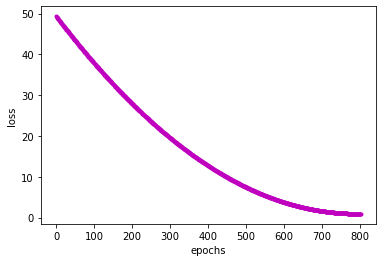

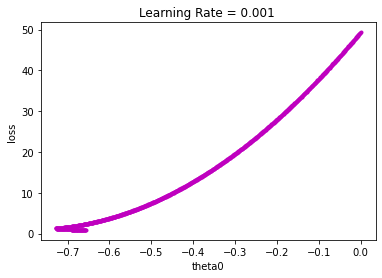

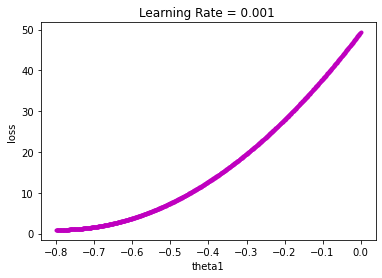

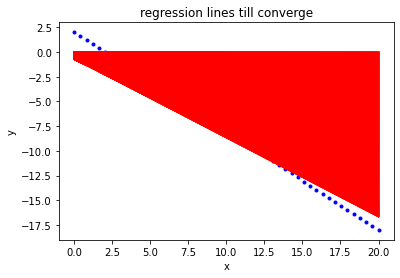

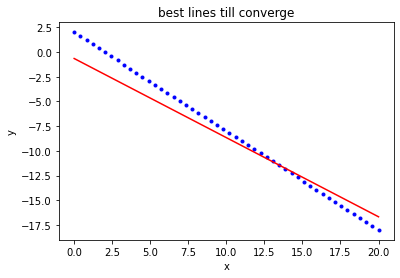

In [ ]:
plot(theta_0s13,theta_1s13,costs13,h_yhat13,lr13)

##### The following results uses alpha = 0.01, beta1 = 0.9, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
theta_0s14,theta_1s14,costs14,h_yhat14,lr14= Adam(x,y,0.01,1e-08,5000,.9,0.99)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:0.8
M1_0: 11.469387754644893

M0_0_correct


Error Vector:[-2.50239206 -2.30311555 -2.10383905 -1.90456254 -1.70528603 -1.50600952
 -1.30673301 -1.1074565  -0.90817999 -0.70890348 -0.50962698 -0.31035046
 -0.11107396  0.08820255  0.28747906  0.48675557  0.68603208  0.88530859
  1.0845851   1.28386161  1.48313812  1.68241463  1.88169114  2.08096764
  2.28024415  2.47952066  2.67879717  2.87807368  3.07735019  3.2766267
  3.47590321  3.67517972  3.87445623  4.07373274  4.27300924  4.47228576
  4.67156226  4.87083877  5.07011528  5.26939179  5.4686683   5.66794481
  5.86722132  6.06649783  6.26577433  6.46505085  6.66432735  6.86360386
  7.06288037  7.26215688]

j(mse):6.966841244390736

Gradient Vector:
[[ 2.37988241]
 [40.73732735]]

Gradient Vector Norm:40.80678473031412

M0_58:3.1063594134152654
M1_58: 50.28474894522625

M0_58_corrected:3.1125742222337123 
M1_58_corrected: 50.385352275230034 

Vt0_58:11.210587415445591
Vt1_58: 2506.0259410730546

Vt0_58_corrected:25.061867476590542 
Vt1_58_corrected: 5602.354961483937

theta_0_


M0_88:1.0938609735381912
M1_88: 23.769238172712782

M0_88_corrected:1.0939535674066916 
M1_88_corrected: 23.77125020693556 

Vt0_88:8.831465057597919
Vt1_88: 2056.7971443596425

Vt0_88_corrected:14.938711836067052 
Vt1_88_corrected: 3479.139604181538

theta_0_new :-0.6430130237824143 
theta_1_new :-0.678380102961917
****************** Iteration 89 ********************

h(x):[ -0.64301302  -0.91990286  -1.1967927   -1.47368254  -1.75057237
  -2.02746222  -2.30435205  -2.58124189  -2.85813173  -3.13502157
  -3.4119114   -3.68880124  -3.96569108  -4.24258092  -4.51947075
  -4.79636059  -5.07325043  -5.35014027  -5.62703011  -5.90391994
  -6.18080979  -6.45769962  -6.73458946  -7.0114793   -7.28836914
  -7.56525897  -7.84214881  -8.11903865  -8.39592849  -8.67281832
  -8.94970816  -9.226598    -9.50348784  -9.78037768 -10.05726751
 -10.33415735 -10.61104719 -10.88793703 -11.16482686 -11.44171671
 -11.71860654 -11.99549638 -12.27238622 -12.54927606 -12.82616589
 -13.10305573 -13.37994557 -


Gradient Vector Norm:3.093528506307433

M0_130:-0.30736117402117485
M1_130: 5.138605634485702

M0_130_corrected:-0.3073614854925807 
M1_130_corrected: 5.1386108418080845 

Vt0_130:5.823908770777646
Vt1_130: 1376.691437814263

Vt0_130_corrected:7.956667324786411 
Vt1_130_corrected: 1880.846045276794

theta_0_new :-0.6706665626694487 
theta_1_new :-0.7801166342970731
****************** Iteration 131 ********************

h(x):[ -0.67066656  -0.98908152  -1.30749647  -1.62591142  -1.94432637
  -2.26274133  -2.58115628  -2.89957123  -3.21798618  -3.53640114
  -3.85481609  -4.17323104  -4.49164599  -4.81006095  -5.1284759
  -5.44689085  -5.7653058   -6.08372076  -6.40213572  -6.72055066
  -7.03896562  -7.35738057  -7.67579553  -7.99421047  -8.31262543
  -8.63104038  -8.94945534  -9.26787029  -9.58628524  -9.90470019
 -10.22311515 -10.5415301  -10.85994505 -11.17836001 -11.49677496
 -11.81518991 -12.13360486 -12.45201982 -12.77043477 -13.08884972
 -13.40726467 -13.72567963 -14.04409458 -14.


M0_136:-0.3970199526582574
M1_136: 3.9191897281242727

M0_136_corrected:-0.3970201664723667 
M1_136_corrected: 3.9191918387941653 

Vt0_136:5.497514931803162
Vt1_136: 1296.5176009976426

Vt0_136_corrected:7.353164367353426 
Vt1_136_corrected: 1734.1484549957304

theta_0_new :-0.6627931633562666 
theta_1_new :-0.7863518508897814
****************** Iteration 137 ********************

h(x):[ -0.66279316  -0.98375311  -1.30471304  -1.62567298  -1.94663292
  -2.26759286  -2.5885528   -2.90951274  -3.23047267  -3.55143262
  -3.87239255  -4.1933525   -4.51431243  -4.83527237  -5.15623231
  -5.47719225  -5.79815219  -6.11911213  -6.44007207  -6.76103201
  -7.08199195  -7.40295188  -7.72391183  -8.04487176  -8.3658317
  -8.68679164  -9.00775158  -9.32871152  -9.64967146  -9.9706314
 -10.29159134 -10.61255127 -10.93351122 -11.25447116 -11.57543109
 -11.89639104 -12.21735097 -12.53831091 -12.85927085 -13.18023079
 -13.50119073 -13.82215067 -14.1431106  -14.46407055 -14.78503048
 -15.10599043 -15


M0_170_corrected:-0.6082335976193658 
M1_170_corrected: 0.8686709715813666 

Vt0_170:4.009755494022398
Vt1_170: 921.6332781813787

Vt0_170_corrected:4.885868309980237 
Vt1_170_corrected: 1123.00583763835

theta_0_new :-0.5869718349059115 
theta_1_new :-0.8034759460865505
****************** Iteration 171 ********************

h(x):[ -0.58697183  -0.9149212   -1.24287057  -1.57081994  -1.8987693
  -2.22671867  -2.55466803  -2.8826174   -3.21056676  -3.53851613
  -3.86646549  -4.19441486  -4.52236422  -4.85031359  -5.17826295
  -5.50621232  -5.83416168  -6.16211105  -6.49006042  -6.81800978
  -7.14595915  -7.47390851  -7.80185788  -8.12980725  -8.45775662
  -8.78570598  -9.11365535  -9.44160471  -9.76955408 -10.09750344
 -10.42545281 -10.75340217 -11.08135154 -11.40930091 -11.73725027
 -12.06519964 -12.393149   -12.72109837 -13.04904773 -13.3769971
 -13.70494646 -14.03289583 -14.36084519 -14.68879456 -15.01674393
 -15.34469329 -15.67264266 -16.00059203 -16.32854139 -16.65649076]

Error V


j(mse):0.8163488261315075

Gradient Vector:
[[-0.60281121]
 [ 0.6079639 ]]

Gradient Vector Norm:0.8561550405179581

M0_195:-0.6095003675098737
M1_195: 0.611603750740179

M0_195_corrected:-0.6095003681652728 
M1_195_corrected: 0.61160375139784 

Vt0_195:3.202467629388889
Vt1_195: 716.9426049129165

Vt0_195_corrected:3.721530166006852 
Vt1_195_corrected: 833.1461361213184

theta_0_new :-0.5124030545745443 
theta_1_new :-0.8089367585840888
****************** Iteration 196 ********************

h(x):[ -0.51240305  -0.84258133  -1.17275959  -1.50293786  -1.83311613
  -2.1632944   -2.49347267  -2.82365094  -3.1538292   -3.48400748
  -3.81418574  -4.14436401  -4.47454228  -4.80472055  -5.13489881
  -5.46507709  -5.79525535  -6.12543362  -6.4556119   -6.78579016
  -7.11596843  -7.4461467   -7.77632497  -8.10650324  -8.43668151
  -8.76685977  -9.09703805  -9.42721631  -9.75739458 -10.08757285
 -10.41775112 -10.74792938 -11.07810766 -11.40828593 -11.73846419
 -12.06864247 -12.39882073 -12.7289


Error Vector:[-2.41906712 -2.34379073 -2.26851434 -2.19323794 -2.11796155 -2.04268516
 -1.96740877 -1.89213237 -1.81685598 -1.74157959 -1.6663032  -1.5910268
 -1.51575041 -1.44047402 -1.36519763 -1.28992123 -1.21464484 -1.13936845
 -1.06409206 -0.98881566 -0.91353927 -0.83826288 -0.76298649 -0.68771009
 -0.6124337  -0.53715731 -0.46188092 -0.38660452 -0.31132813 -0.23605174
 -0.16077535 -0.08549896 -0.01022256  0.06505383  0.14033022  0.21560662
  0.29088301  0.3661594   0.44143579  0.51671219  0.59198858  0.66726497
  0.74254136  0.81781776  0.89309415  0.96837054  1.04364693  1.11892333
  1.19419972  1.26947611]

j(mse):0.7552229202217582

Gradient Vector:
[[-0.57479551]
 [ 0.65053831]]

Gradient Vector Norm:0.8680955942173684

M0_224:-0.5830101783545195
M1_224: 0.6455658161367621

M0_224_corrected:-0.583010178384048 
M1_224_corrected: 0.6455658161694589 

Vt0_224:2.47997668671861
Vt1_224: 535.7831935593998

Vt0_224_corrected:2.768486948557941 
Vt1_224_corrected: 598.1140010588311




j(mse):0.6878331153079509

Gradient Vector:
[[-0.54951705]
 [ 0.6081663 ]]

Gradient Vector Norm:0.8196555648676692

M0_254:-0.5571535444420583
M1_254: 0.6222490869406508

M0_254_corrected:-0.5571535444432546 
M1_254_corrected: 0.6222490869419869 

Vt0_254:1.916406108595606
Vt1_254: 396.4225975899963

Vt0_254_corrected:2.076472760406628 
Vt1_254_corrected: 429.5335533596791

theta_0_new :-0.3048476968363228 
theta_1_new :-0.8243805292295956
****************** Iteration 255 ********************

h(x):[ -0.3048477   -0.64132955  -0.97781139  -1.31429325  -1.65077509
  -1.98725694  -2.32373879  -2.66022064  -2.99670248  -3.33318434
  -3.66966618  -4.00614803  -4.34262988  -4.67911173  -5.01559357
  -5.35207543  -5.68855727  -6.02503912  -6.36152098  -6.69800282
  -7.03448467  -7.37096652  -7.70744837  -8.04393021  -8.38041207
  -8.71689391  -9.05337576  -9.38985761  -9.72633946 -10.0628213
 -10.39930316 -10.735785   -11.07226685 -11.40874871 -11.74523055
 -12.0817124  -12.41819425 -12.75


j(mse):0.619841872980172

Gradient Vector:
[[-0.52298554]
 [ 0.55980602]]

Gradient Vector Norm:0.7660918062954253

M0_283:-0.5313888944525037
M1_283: 0.574346467784757

M0_283_corrected:-0.5313888944525574 
M1_283_corrected: 0.574346467784815 

Vt0_283:1.5043745110938225
Vt1_283: 296.28142213837856

Vt0_283_corrected:1.5963165840419287 
Vt1_283_corrected: 314.38909939994613

theta_0_new :-0.18756445612114472 
theta_1_new :-0.8334454458887474
****************** Iteration 284 ********************

h(x):[ -0.18756446  -0.52774627  -0.86792808  -1.2081099   -1.54829171
  -1.88847353  -2.22865534  -2.56883716  -2.90901897  -3.24920079
  -3.5893826   -3.92956442  -4.26974623  -4.60992805  -4.95010986
  -5.29029168  -5.63047349  -5.9706553   -6.31083712  -6.65101893
  -6.99120075  -7.33138256  -7.67156438  -8.01174619  -8.35192801
  -8.69210982  -9.03229164  -9.37247345  -9.71265527 -10.05283708
 -10.3930189  -10.73320071 -11.07338253 -11.41356434 -11.75374615
 -12.09392797 -12.43410978 -12


Error Vector:[-2.04275956 -1.9793262  -1.91589283 -1.85245946 -1.78902609 -1.72559272
 -1.66215936 -1.59872599 -1.53529262 -1.47185925 -1.40842588 -1.34499252
 -1.28155915 -1.21812578 -1.15469241 -1.09125904 -1.02782568 -0.96439231
 -0.90095894 -0.83752557 -0.7740922  -0.71065883 -0.64722547 -0.5837921
 -0.52035873 -0.45692536 -0.39349199 -0.33005863 -0.26662526 -0.20319189
 -0.13975852 -0.07632515 -0.01289179  0.05054158  0.11397495  0.17740832
  0.24084169  0.30427506  0.36770842  0.43114179  0.49457516  0.55800853
  0.6214419   0.68487526  0.74830863  0.811742    0.87517537  0.93860874
  1.0020421   1.06547547]

j(mse):0.5383628862893184

Gradient Vector:
[[-0.48864205]
 [ 0.50541583]]

Gradient Vector Norm:0.703005125779794

M0_317:-0.4978960379226791
M1_317: 0.5200392430551329

M0_317_corrected:-0.4978960379226805 
M1_317_corrected: 0.5200392430551344 

Vt0_317:1.14265752604801
Vt1_317: 210.60526155199858

Vt0_317_corrected:1.191416609374843 
Vt1_317_corrected: 219.5921358017131



Gradient Vector Norm:0.6463538677809345

M0_346:-0.46706485752550353
M1_346: 0.4719584259105705

M0_346_corrected:-0.4670648575255036 
M1_346_corrected: 0.4719584259105706 

Vt0_346:0.9100558413699401
Vt1_346: 157.41647960567417

Vt0_346_corrected:0.9387615190704403 
Vt1_346_corrected: 162.3818306565565

theta_0_new :0.09808106317771048 
theta_1_new :-0.8554174785045301
****************** Iteration 347 ********************

h(x):[  0.09808106  -0.25106893  -0.60021892  -0.94936891  -1.2985189
  -1.6476689   -1.99681888  -2.34596888  -2.69511886  -3.04426886
  -3.39341885  -3.74256884  -4.09171883  -4.44086882  -4.79001881
  -5.13916881  -5.48831879  -5.83746879  -6.18661878  -6.53576877
  -6.88491876  -7.23406875  -7.58321875  -7.93236873  -8.28151873
  -8.63066872  -8.97981871  -9.3289687   -9.67811869 -10.02726868
 -10.37641867 -10.72556866 -11.07471866 -11.42386865 -11.77301864
 -12.12216863 -12.47131862 -12.82046862 -13.1696186  -13.5187686
 -13.86791858 -14.21706858 -14.56621857 


Gradient Vector Norm:0.5946444675930604

M0_372:-0.4378589106183167
M1_372: 0.42836525723967955

M0_372_corrected:-0.4378589106183167 
M1_372_corrected: 0.42836525723967955 

Vt0_372:0.7455741159317953
Vt1_372: 121.26068712985975

Vt0_372_corrected:0.7635531713120317 
Vt1_372_corrected: 124.18481306552017

theta_0_new :0.2260778982900002 
theta_1_new :-0.8652435919268197
****************** Iteration 373 ********************

h(x):[  0.2260779   -0.12708276  -0.4802434   -0.83340405  -1.1865647
  -1.53972535  -1.892886    -2.24604665  -2.5992073   -2.95236795
  -3.3055286   -3.65868925  -4.0118499   -4.36501055  -4.71817119
  -5.07133185  -5.42449249  -5.77765315  -6.1308138   -6.48397445
  -6.8371351   -7.19029575  -7.5434564   -7.89661704  -8.2497777
  -8.60293834  -8.956099    -9.30925964  -9.6624203  -10.01558094
 -10.3687416  -10.72190224 -11.07506289 -11.42822355 -11.78138419
 -12.13454485 -12.48770549 -12.84086615 -13.19402679 -13.54718745
 -13.90034809 -14.25350874 -14.60666939


M0_403_corrected:-0.40140823631836964 
M1_403_corrected: 0.3769724707003249 

Vt0_403:0.590499551766379
Vt1_403: 88.83945112175901

Vt0_403_corrected:0.6008603244506098 
Vt1_403_corrected: 90.3982082041497

theta_0_new :0.3842713948576358 
theta_1_new :-0.8773671108342403
****************** Iteration 404 ********************

h(x):[  0.38427139   0.02616237  -0.33194665  -0.69005568  -1.0481647
  -1.40627373  -1.76438275  -2.12249178  -2.4806008   -2.83870983
  -3.19681885  -3.55492788  -3.9130369   -4.27114593  -4.62925495
  -4.98736398  -5.345473    -5.70358203  -6.06169106  -6.41980008
  -6.77790911  -7.13601813  -7.49412715  -7.85223617  -8.2103452
  -8.56845422  -8.92656325  -9.28467227  -9.6427813  -10.00089032
 -10.35899935 -10.71710837 -11.0752174  -11.43332643 -11.79143545
 -12.14954448 -12.5076535  -12.86576253 -13.22387155 -13.58198058
 -13.9400896  -14.29819863 -14.65630765 -15.01441667 -15.37252569
 -15.73063472 -16.08874374 -16.44685277 -16.80496179 -17.16307082]

Error 


j(mse):0.264567778444682

Gradient Vector:
[[-0.34625634]
 [ 0.30548584]]

Gradient Vector Norm:0.4617521559449102

M0_439:-0.3574148638707832
M1_439: 0.31946206013145445

M0_439_corrected:-0.3574148638707832 
M1_439_corrected: 0.31946206013145445 

Vt0_439:0.4520792332319481
Vt1_439: 61.90232604132986

Vt0_439_corrected:0.4575739705359127 
Vt1_439_corrected: 62.65470968361709

theta_0_new :0.572942610862182 
theta_1_new :-0.8917951127262508
****************** Iteration 440 ********************

h(x):[  0.57294261   0.2089446   -0.1550534   -0.51905141  -0.88304941
  -1.24704742  -1.61104542  -1.97504343  -2.33904143  -2.70303944
  -3.06703744  -3.43103545  -3.79503345  -4.15903146  -4.52302946
  -4.88702747  -5.25102547  -5.61502348  -5.97902149  -6.34301949
  -6.7070175   -7.0710155   -7.43501351  -7.79901151  -8.16300952
  -8.52700752  -8.89100553  -9.25500353  -9.61900154  -9.98299954
 -10.34699755 -10.71099555 -11.07499356 -11.43899156 -11.80298957
 -12.16698757 -12.53098558 -12.


Error Vector:[-1.2523429  -1.21361863 -1.17489436 -1.13617009 -1.09744582 -1.05872155
 -1.01999729 -0.98127302 -0.94254875 -0.90382448 -0.86510021 -0.82637594
 -0.78765167 -0.74892741 -0.71020314 -0.67147887 -0.6327546  -0.59403033
 -0.55530606 -0.51658179 -0.47785752 -0.43913326 -0.40040899 -0.36168472
 -0.32296045 -0.28423618 -0.24551191 -0.20678764 -0.16806337 -0.12933911
 -0.09061484 -0.05189057 -0.0131663   0.02555797  0.06428224  0.10300651
  0.14173077  0.18045504  0.21917931  0.25790358  0.29662785  0.33535212
  0.37407639  0.41280066  0.45152492  0.49024919  0.52897346  0.56769773
  0.606422    0.64514627]

j(mse):0.20222858911486277

Gradient Vector:
[[-0.30359832]
 [ 0.25557969]]

Gradient Vector Norm:0.39685376773693276

M0_473:-0.31490674067200003
M1_473: 0.26854893318787526

M0_473_corrected:-0.31490674067200003 
M1_473_corrected: 0.26854893318787526 

Vt0_473:0.3514897580633074
Vt1_473: 44.00733405474239

Vt0_473_corrected:0.354514696096557 
Vt1_473_corrected: 44.386063


j(mse):0.16497645978792805

Gradient Vector:
[[-0.27471212]
 [ 0.22426102]]

Gradient Vector Norm:0.3546262134247073

M0_496:-0.2860061285021771
M1_496: 0.23644211494613976

M0_496_corrected:-0.2860061285021771 
M1_496_corrected: 0.23644211494613976 

Vt0_496:0.296075378364135
Vt1_496: 34.93660190340289

Vt0_496_corrected:0.2980939533243939 
Vt1_496_corrected: 35.17479175285403

theta_0_new :0.8740690653965386 
theta_1_new :-0.9147529440043688
****************** Iteration 497 ********************

h(x):[  0.87406907   0.50070051   0.12733197  -0.24603658  -0.61940513
  -0.99277368  -1.36614222  -1.73951078  -2.11287932  -2.48624787
  -2.85961642  -3.23298497  -3.60635351  -3.97972207  -4.35309061
  -4.72645916  -5.09982771  -5.47319626  -5.84656481  -6.21993336
  -6.59330191  -6.96667045  -7.34003901  -7.71340755  -8.0867761
  -8.46014465  -8.8335132   -9.20688174  -9.5802503   -9.95361884
 -10.32698739 -10.70035594 -11.07372449 -11.44709304 -11.82046159
 -12.19383014 -12.56719868 -12


Gradient Vector Norm:0.30887454465974246

M0_522:-0.2535506401818728
M1_522: 0.20266977121087137

M0_522_corrected:-0.2535506401818728 
M1_522_corrected: 0.20266977121087137 

Vt0_522:0.24322099599794028
Vt1_522: 26.91249582720041

Vt0_522_corrected:0.24449590256984458 
Vt1_522_corrected: 27.053564724873763

theta_0_new :1.0088977717172312 
theta_1_new :-0.925005814496009
****************** Iteration 523 ********************

h(x):[  1.00889777   0.63134437   0.25379098  -0.12376241  -0.5013158
  -0.8788692   -1.25642259  -1.63397599  -2.01152938  -2.38908277
  -2.76663616  -3.14418956  -3.52174295  -3.89929635  -4.27684974
  -4.65440313  -5.03195652  -5.40950992  -5.78706332  -6.16461671
  -6.54217011  -6.91972349  -7.29727689  -7.67483028  -8.05238368
  -8.42993707  -8.80749047  -9.18504385  -9.56259725  -9.94015064
 -10.31770404 -10.69525743 -11.07281083 -11.45036422 -11.82791761
 -12.20547101 -12.5830244  -12.9605778  -13.33813119 -13.71568458
 -14.09323797 -14.47079137 -14.848344

In [ ]:
r2_score(y,h_yhat14[-1])

0.9952892444618006

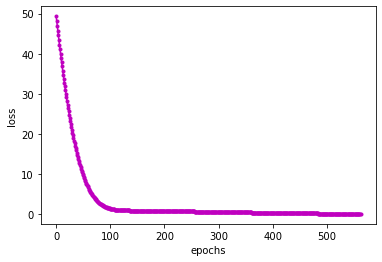

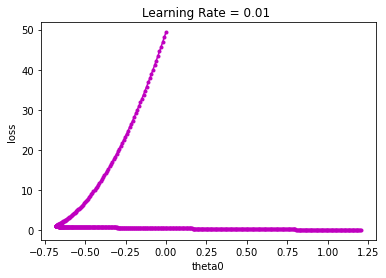

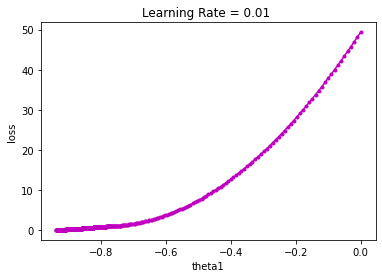

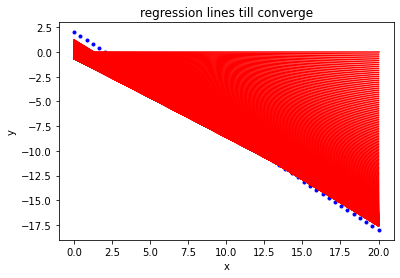

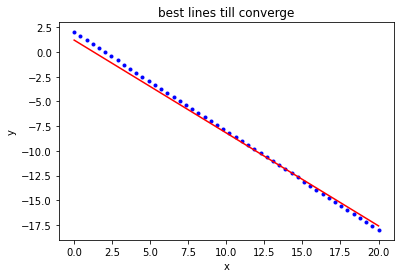

In [ ]:
plot(theta_0s14,theta_1s14,costs14,h_yhat14,lr14)

In [ ]:
theta_0s15,theta_1s15,costs15,h_yhat15,lr15= Adam(x,y,0.05,1e-08,500,.05,0.7)

****************** Iteration 0 ********************

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j(mse):49.34693877322448

Gradient Vector:
[[  8.        ]
 [114.69387755]]

Gradient Vector Norm:114.9725425770859

M0_0:7.600000000000001
M1_0: 108.9591836691265



Error Vector:[-1.30942782 -1.27745244 -1.24547706 -1.21350168 -1.18152631 -1.14955093
 -1.11757555 -1.08560018 -1.0536248  -1.02164942 -0.98967405 -0.95769867
 -0.92572329 -0.89374791 -0.86177254 -0.82979716 -0.79782178 -0.76584641
 -0.73387103 -0.70189565 -0.66992027 -0.6379449  -0.60596952 -0.57399414
 -0.54201877 -0.51004339 -0.47806801 -0.44609264 -0.41411726 -0.38214188
 -0.3501665  -0.31819113 -0.28621575 -0.25424037 -0.222265   -0.19028962
 -0.15831424 -0.12633887 -0.09436349 -0.06238811 -0.03041273  0.00156264
  0.03353802  0.0655134   0.09748877  0.12946415  0.16143953  0.19341491
  0.22539028  0.25736566]

j(mse):0.24481432353200386

Gradient Vector:
[[-0.52603108]
 [-2.54240374]]

Gradient Vector Norm:2.596252193406427

M0_53:-0.5078875340544822
M1_53: -2.2939101328020257

M0_53_corrected:-0.5078875340544822 
M1_53_corrected: -2.2939101328020257 

Vt0_53:0.19017200198118367
Vt1_53: 8.316214397204906

Vt0_53_corrected:0.19017200280236815 
Vt1_53_corrected: 8.316214433115272


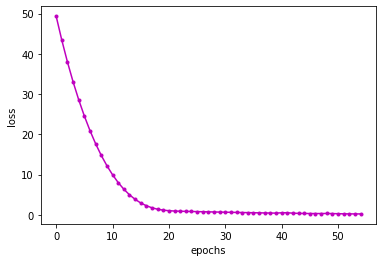

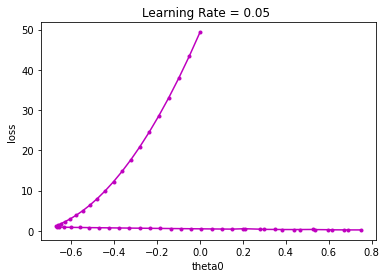

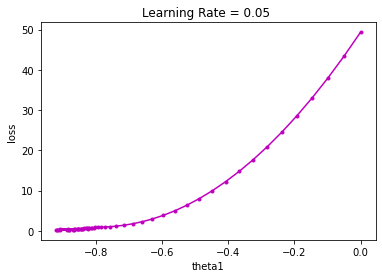

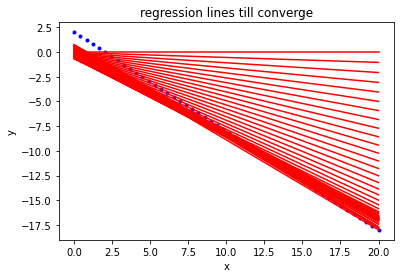

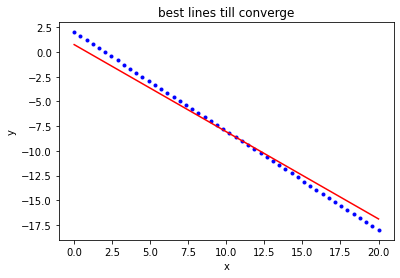

In [ ]:
plot(theta_0s15,theta_1s15,costs15,h_yhat15,lr15)

In [ ]:
r2_score(y,h_yhat15[-1])

0.9859079693461551

## Congratulations 
![image.png](attachment:image.png)